# Assemblge xypressure files

This notebook is based on the previous `sync_dtag_video_batch.ipynb` updated in Dec 2020.

In this notebook we get depth info from Dtag by syncing video track and Dtag recording.

A few quick notes:
- some videos were not possible to track due to weather condition or sun glare
- starting on 20190702_s1 we had the LED flash at the beginning of trial, which pushes the starting point of the vid_time to be much earlier than when the animal was actually in view of the video
- 20190702_s2 did not have Dtag tap sync so were not included (Initial experiment back in May to sync using Dtag and hydrophone recordings were not successful but need to come back to this later.)

Found out that `LEFT_EYE` and `RIGHT_EYE` were switched in the original notebook. Now we use the column labels from the DLC-generated files directly so that we have confidence on what the labels are.

In [1]:
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr

In [2]:
from pp_utils.file_handling import get_fs_video

## Set paths

In [3]:
# Set paths
data_path = Path('../data_raw/')
analysis_path = Path('../data_processed/')

dlc_export_path = analysis_path.joinpath('video_dlc_apr2020/dlc_cleaned_h5')
track_path = analysis_path.joinpath('tracks/dlc_cleaned')
nc_path = analysis_path.joinpath('dtag/dtag_nc')

In [4]:
out_path = analysis_path.joinpath('tracks/xypressure')

for out_folder in ["csv", "fig_alignment", "fig_track_interp"]:
    if not out_path.joinpath(out_folder).exists():
        out_path.joinpath(out_folder).mkdir()

In [5]:
main_csv_path = analysis_path.joinpath('all_info_csv/main_info_append_02.csv')
df_all = pd.read_csv(main_csv_path, index_col=0)
df_all.head()

,DATE,SESSION,PERSONNEL,TRIAL,LEFT,RIGHT,ANGLE,SPHEROID,ASPECT_RATIO,SEQUENCE,...,tap_sync_video_frame,tap_sync_comments,tap_sync_time_dtag2video,target_marker_exist,target_marker_checked,target_position_assembled_in_csv,target_csv_filename,targets_entry_exist,extrinsic_file_exist,cal_obj_record_exist
0,20190625,1,"WJ, ML",0,T,X,1,X,0.0,1,...,"169, 186, 200",NaN,-44.734711,True,False,False,NaN,False,NaN,NaN
1,20190625,1,"WJ, ML",0,T,X,1,X,0.0,1,...,"169, 186, 200",NaN,-44.734711,True,True,False,NaN,False,NaN,NaN
2,20190625,1,"WJ, ML",1,T,C,1,L,2.9,1,...,"169, 186, 200",NaN,-44.734711,True,True,True,GOPR1466_20190625_s1_t01_xypts.csv,True,True,True
3,20190625,1,"WJ, ML",2,C,T,1,L,2.9,1,...,"169, 186, 200",NaN,-44.734711,True,True,True,GOPR1466_20190625_s1_t02_xypts.csv,True,True,True
4,20190625,1,"WJ, ML",3,T,C,1,L,2.9,1,...,"169, 186, 200",NaN,-44.734711,True,True,True,GOPR1466_20190625_s1_t03_xypts.csv,True,True,True


In [6]:
df_all['track_csv_fname'] = (df_all['DATE'].astype(str) + "_s" +
                          df_all['SESSION'].astype(str) + "_t" +
                          df_all['TRIAL'].astype(str) + "_" +
                          df_all['VIDEO_FILENAME'].str[-12:-4] + "_xypts.csv")

In [7]:
df_all['track_csv_fname']

0       20190625_s1_t0_GOPR1466_xypts.csv
1       20190625_s1_t0_GOPR1466_xypts.csv
2       20190625_s1_t1_GOPR1466_xypts.csv
3       20190625_s1_t2_GOPR1466_xypts.csv
4       20190625_s1_t3_GOPR1466_xypts.csv
                      ...                
242     20190704_s3_t8_GOPR1489_xypts.csv
243     20190704_s3_t9_GOPR1489_xypts.csv
244    20190704_s3_t10_GOPR1489_xypts.csv
245    20190704_s3_t11_GOPR1489_xypts.csv
246    20190704_s3_t12_GP011489_xypts.csv
Name: track_csv_fname, Length: 247, dtype: object

## Wrangle filenames

Trials that require combining 2 videos

In [8]:
df_all['need_to_combined_videos'] = df_all['VIDEO_FILENAME'].apply(lambda x: '+' in x)

In [9]:
df_all['need_to_combined_videos']

0      False
1      False
2      False
3      False
4      False
       ...  
242    False
243    False
244    False
245    False
246     True
Name: need_to_combined_videos, Length: 247, dtype: bool

Trials that do not have corresponding files exist (base on simplistic assembly of track_fname)

In [10]:
# Trials that do not have corresponding files exist (base on simplistic assembly of track_fname)
df_all['track_file_exist'] = df_all['track_csv_fname'].apply(
    lambda x: track_path.joinpath(x).is_file())

Clean up dataframe before more operation

In [11]:
df_all = df_all.loc[:, ['DATE', 'SESSION', 'TRIAL', 'VIDEO_FILENAME', 'WJ_COMMENTS',
                        'gopro_video', 'tap_sync_time_dtag2video',
                        'FRAME_NUM_START', 'FRAME_NUM_END',
                        'dtag_wav_file', 'DLC_labeled_h5',
                        'KAVIN_TRACK_COMMENTS', 'TRACK_CHECKED', 'TARGETS_CHECKED',
                        'track_csv_fname', 'need_to_combined_videos', 'track_file_exist']]

In [12]:
df_all

,DATE,SESSION,TRIAL,VIDEO_FILENAME,WJ_COMMENTS,gopro_video,tap_sync_time_dtag2video,FRAME_NUM_START,FRAME_NUM_END,dtag_wav_file,DLC_labeled_h5,KAVIN_TRACK_COMMENTS,TRACK_CHECKED,TARGETS_CHECKED,track_csv_fname,need_to_combined_videos,track_file_exist
0,20190625,1,0,GOPR1466.MP4,"no eyecups, no DTAG, target only",20190625/session1/gopro_overhead/GOPR1466.MP4,-44.734711,7996,8269,20190625/session1/dtag/pp19_176a_027.wav,GOPR1466_20190625_s1_t00_1DLC_resnet50_muri-fb...,NaN,NO,NO,20190625_s1_t0_GOPR1466_xypts.csv,False,False
1,20190625,1,0,GOPR1466.MP4,"with DTAG and eyecups, target only",20190625/session1/gopro_overhead/GOPR1466.MP4,-44.734711,11826,12273,20190625/session1/dtag/pp19_176a_027.wav,GOPR1466_20190625_s1_t00_2DLC_resnet50_muri-fb...,NaN,x,x,20190625_s1_t0_GOPR1466_xypts.csv,False,False
2,20190625,1,1,GOPR1466.MP4,"with DTAG and eyecups, with clutter also",20190625/session1/gopro_overhead/GOPR1466.MP4,-44.734711,15693,16170,20190625/session1/dtag/pp19_176a_027.wav,GOPR1466_20190625_s1_t01DLC_resnet50_muri-fb-j...,NaN,x,x,20190625_s1_t1_GOPR1466_xypts.csv,False,True
3,20190625,1,2,GOPR1466.MP4,NaN,20190625/session1/gopro_overhead/GOPR1466.MP4,-44.734711,20105,20568,20190625/session1/dtag/pp19_176a_027.wav,GOPR1466_20190625_s1_t02DLC_resnet50_muri-fb-j...,NaN,x,x,20190625_s1_t2_GOPR1466_xypts.csv,False,True
4,20190625,1,3,GOPR1466.MP4,NaN,20190625/session1/gopro_overhead/GOPR1466.MP4,-44.734711,22798,23221,20190625/session1/dtag/pp19_176a_027.wav,GOPR1466_20190625_s1_t03DLC_resnet50_muri-fb-j...,NaN,x,x,20190625_s1_t3_GOPR1466_xypts.csv,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242,20190704,3,8,GOPR1489.MP4,NaN,20190704/session3/gopro_overhead/GOPR1489.MP4,20.514301,22761,23428,20190704/session3/dtag/pp19_185c_055.wav,GOPR1489_20190704_s3_t08DLC_resnet50_muri-fb-j...,NaN,x,x,20190704_s3_t8_GOPR1489_xypts.csv,False,True
243,20190704,3,9,GOPR1489.MP4,NaN,20190704/session3/gopro_overhead/GOPR1489.MP4,20.514301,24544,25138,20190704/session3/dtag/pp19_185c_055.wav,GOPR1489_20190704_s3_t09DLC_resnet50_muri-fb-j...,NaN,x,x,20190704_s3_t9_GOPR1489_xypts.csv,False,True
244,20190704,3,10,GOPR1489.MP4,NaN,20190704/session3/gopro_overhead/GOPR1489.MP4,20.514301,26262,26750,20190704/session3/dtag/pp19_185c_055.wav,GOPR1489_20190704_s3_t10DLC_resnet50_muri-fb-j...,NaN,x,x,20190704_s3_t10_GOPR1489_xypts.csv,False,True
245,20190704,3,11,GOPR1489.MP4,Bad trial. The porpoise lost an eyecup just a ...,20190704/session3/gopro_overhead/GOPR1489.MP4,20.514301,27606,28233,20190704/session3/dtag/pp19_185c_055.wav,GOPR1489_20190704_s3_t11DLC_resnet50_muri-fb-j...,NaN,x,x,20190704_s3_t11_GOPR1489_xypts.csv,False,True


In [13]:
df_all['track_file_checked'] = df_all['TRACK_CHECKED'].apply(lambda x: x=='x')

In [14]:
# Trials to be processed involving only 1 video
df_all['file_wanted_1video'] = ((df_all['track_file_exist']) 
                                & (df_all['track_file_checked']) 
                                & (~df_all['need_to_combined_videos']))

In [15]:
df_all['file_wanted_1video'] 

0      False
1      False
2       True
3       True
4       True
       ...  
242     True
243     True
244     True
245     True
246    False
Name: file_wanted_1video, Length: 247, dtype: bool

In [16]:
# Sanity check: all files with file_wanted_1video==True should exist, so below should print out nothing
for tf in df_all.loc[df_all['file_wanted_1video']==True, 'track_csv_fname'].values:
    if not track_path.joinpath(tf).is_file():
        print('this file does not exist: ' + Path(fpath).name)

## Assemble column names for output

Get label names from DLC-generated files and use them to generate column names.

In [17]:
df_tmp = pd.read_hdf(dlc_export_path.joinpath(df_all.loc[0, 'DLC_labeled_h5']))

In [18]:
df_tmp

scorer    DLC_resnet50_muri-fb-juneNov2shuffle1_232200               \
bodyparts                                     left_eye                
coords                                               x            y   
0                                            -0.851389     0.962945   
1                                            -0.684638     0.419112   
2                                            -0.746655     0.451898   
3                                            -0.730688     0.423486   
4                                            -0.804090     0.500746   
..                                                 ...          ...   
269                                        1908.444702  1011.866028   
270                                         245.806412  1039.880005   
271                                         246.125351  1039.444702   
272                                         245.804871  1039.320312   
273                                          -1.354375     0.615964   

scorer                                                                  \
bodyparts               right_eye                              nostril   
coords    likelihood            x            y likelihood            x   
0           0.000040    -0.491511    -1.974907   0.000036    66.165039   
1           0.000040    -0.508198    -2.362587   0.000036    66.224075   
2           0.000043    -0.343036    -2.405359   0.000037    64.330772   
3           0.000044    -0.418007    -2.368321   0.000038    64.404686   
4           0.000038    -0.245886    -2.325779   0.000035    65.527672   
..               ...          ...          ...        ...          ...   
269         0.000218  1909.719482  1013.613708   0.000142  1911.275757   
270         0.000073    -0.490385    -1.849755   0.000035   976.897644   
271         0.000067    -0.332264    -2.035342   0.000034   693.043030   
272         0.000039    -0.312202    -1.872645   0.000028   608.736206   
273         0.000037    -0.459588    -2.262584   0.000036   865.063293   

scorer                                                                  \
bodyparts                                 back                           
coords               y likelihood            x            y likelihood   
0           981.504517   0.000053   301.010040   385.497864   0.003625   
1           981.623657   0.000033   199.158066  1008.510498   0.014603   
2           981.195007   0.000087   198.799683  1008.839355   0.014949   
3           981.961914   0.000050   198.914871  1009.529053   0.016981   
4           981.808838   0.000041   198.645447  1009.614807   0.006066   
..                 ...        ...          ...          ...        ...   
269        1016.200928   0.000666  1911.029053  1015.672363   0.376128   
270         691.365051   0.000067   251.438110  1043.633423   0.001321   
271         188.096619   0.000039   253.646408  1045.306152   0.001933   
272         815.767578   0.000061   251.299789  1042.486938   0.001232   
273         802.583618   0.000030   252.198395  1042.415649   0.000486   

scorer                                          
bodyparts         dtag                          
coords               x            y likelihood  
0             0.435780     0.535645   0.000039  
1             0.100013     0.938625   0.000048  
2            -0.064786     1.047811   0.000054  
3             0.061066     0.986870   0.000053  
4            -0.049870     0.949739   0.000044  
..                 ...          ...        ...  
269        1897.978271  1021.140930   0.000042  
270          -0.241818     1.442408   0.000039  
271          -0.278805     1.502321   0.000037  
272          -0.268866     1.388336   0.000034  
273          -0.074052     1.731906   0.000045  

[274 rows x 15 columns]

In [19]:
label_list = df_tmp.columns.get_level_values(1).unique().str.upper().to_list()
label_list

['LEFT_EYE', 'RIGHT_EYE', 'NOSTRIL', 'BACK', 'DTAG']

In [20]:
col_list = []
for col in label_list:
    col_list = col_list + [col+'_X', col+'_Y']
col_list

['LEFT_EYE_X',
 'LEFT_EYE_Y',
 'RIGHT_EYE_X',
 'RIGHT_EYE_Y',
 'NOSTRIL_X',
 'NOSTRIL_Y',
 'BACK_X',
 'BACK_Y',
 'DTAG_X',
 'DTAG_Y']

## Create xypressure csv for 1 video trials

In [21]:
# Get video sampling rate
tmp_video_path = str(Path(data_path).joinpath(df_all.loc[0, 'gopro_video']))
fs_video = get_fs_video(tmp_video_path)
fs_video

29.97002997002997

In [22]:
def sync(trial_idx):
    # get sync info
    dtag2vid_sync_time = s['tap_sync_time_dtag2video']
    f_start = s['FRAME_NUM_START']
    f_end = s['FRAME_NUM_END']

    # account for non video 1
    offset = 31830
    if f_start < offset:
        offset = 0
    elif f_start > offset * 2:
        offset *= 2

    # Load trajectory
    track = pd.read_csv(track_path.joinpath(df_all.loc[trial_idx, 'track_csv_fname']))
    f_start_track = f_start - offset

    # Load pressure
    dtag_nc_fname = Path(s['dtag_wav_file']).stem + 'sens50.nc'
    nc = xr.open_dataset(nc_path.joinpath(dtag_nc_fname))
    fs_dtag = nc.P.attrs['sampling_rate']

    # Interpolate dtag time to video time
    vid_time = np.arange(f_start, f_end + offset) / fs_video - dtag2vid_sync_time   # [sec]
    dtag_time = np.arange(len(nc.P)) / fs_dtag
    
    # Extracted portion
    track_extract = track.iloc[f_start_track:f_end, :]
    pressure_interp = -np.interp(vid_time, dtag_time, nc.P)
    
    # Plot interp check
    fig,ax = plt.subplots(1,2,figsize=(12,3.5))
    ax[0].plot(dtag_time, -nc.P)
    ax[0].plot(vid_time, pressure_interp)
    ax[0].set_xlabel('Video time (sec)')
    ax[0].set_title('Trajectory overall')
    ax[1].plot(dtag_time, -nc.P, label='all depth')
    ax[1].plot(vid_time, pressure_interp, label='gated portion')
    ax[1].set_xlim(vid_time[0]-50, vid_time[-1]+50)
    ax[1].set_xlabel('Video time (sec)')
    ax[1].legend(fontsize=12)
    ax[1].set_title('Trajectory interpolation check')
    plt.show()
        
    return track_extract, pressure_interp, vid_time, fig

In [23]:
def plot_alignment_check():
    fig = plt.figure()
    plt.plot(vid_time, df_t.values)
    plt.plot(vid_time, df_p.values*1000+1000, 'k')
    plt.legend(df_t.columns.to_list() + ['Depth*1000+1000'], bbox_to_anchor=(1,1))
    plt.title('Alignment sanity check')
    plt.xlabel('Video time (sec)')
    plt.show()
    return fig

In [24]:
df_all.loc[df_all['file_wanted_1video'], :]

,DATE,SESSION,TRIAL,VIDEO_FILENAME,WJ_COMMENTS,gopro_video,tap_sync_time_dtag2video,FRAME_NUM_START,FRAME_NUM_END,dtag_wav_file,DLC_labeled_h5,KAVIN_TRACK_COMMENTS,TRACK_CHECKED,TARGETS_CHECKED,track_csv_fname,need_to_combined_videos,track_file_exist,track_file_checked,file_wanted_1video
2,20190625,1,1,GOPR1466.MP4,"with DTAG and eyecups, with clutter also",20190625/session1/gopro_overhead/GOPR1466.MP4,-44.734711,15693,16170,20190625/session1/dtag/pp19_176a_027.wav,GOPR1466_20190625_s1_t01DLC_resnet50_muri-fb-j...,NaN,x,x,20190625_s1_t1_GOPR1466_xypts.csv,False,True,True,True
3,20190625,1,2,GOPR1466.MP4,NaN,20190625/session1/gopro_overhead/GOPR1466.MP4,-44.734711,20105,20568,20190625/session1/dtag/pp19_176a_027.wav,GOPR1466_20190625_s1_t02DLC_resnet50_muri-fb-j...,NaN,x,x,20190625_s1_t2_GOPR1466_xypts.csv,False,True,True,True
4,20190625,1,3,GOPR1466.MP4,NaN,20190625/session1/gopro_overhead/GOPR1466.MP4,-44.734711,22798,23221,20190625/session1/dtag/pp19_176a_027.wav,GOPR1466_20190625_s1_t03DLC_resnet50_muri-fb-j...,NaN,x,x,20190625_s1_t3_GOPR1466_xypts.csv,False,True,True,True
5,20190625,1,4,GOPR1466.MP4,NaN,20190625/session1/gopro_overhead/GOPR1466.MP4,-44.734711,26093,26518,20190625/session1/dtag/pp19_176a_027.wav,GOPR1466_20190625_s1_t04DLC_resnet50_muri-fb-j...,NaN,x,x,20190625_s1_t4_GOPR1466_xypts.csv,False,True,True,True
6,20190625,1,5,GOPR1466.MP4,NaN,20190625/session1/gopro_overhead/GOPR1466.MP4,-44.734711,29971,30382,20190625/session1/dtag/pp19_176a_027.wav,GOPR1466_20190625_s1_t05DLC_resnet50_muri-fb-j...,NaN,x,x,20190625_s1_t5_GOPR1466_xypts.csv,False,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,20190704,3,7,GOPR1489.MP4,NaN,20190704/session3/gopro_overhead/GOPR1489.MP4,20.514301,20820,21492,20190704/session3/dtag/pp19_185c_055.wav,GOPR1489_20190704_s3_t07DLC_resnet50_muri-fb-j...,NaN,x,x,20190704_s3_t7_GOPR1489_xypts.csv,False,True,True,True
242,20190704,3,8,GOPR1489.MP4,NaN,20190704/session3/gopro_overhead/GOPR1489.MP4,20.514301,22761,23428,20190704/session3/dtag/pp19_185c_055.wav,GOPR1489_20190704_s3_t08DLC_resnet50_muri-fb-j...,NaN,x,x,20190704_s3_t8_GOPR1489_xypts.csv,False,True,True,True
243,20190704,3,9,GOPR1489.MP4,NaN,20190704/session3/gopro_overhead/GOPR1489.MP4,20.514301,24544,25138,20190704/session3/dtag/pp19_185c_055.wav,GOPR1489_20190704_s3_t09DLC_resnet50_muri-fb-j...,NaN,x,x,20190704_s3_t9_GOPR1489_xypts.csv,False,True,True,True
244,20190704,3,10,GOPR1489.MP4,NaN,20190704/session3/gopro_overhead/GOPR1489.MP4,20.514301,26262,26750,20190704/session3/dtag/pp19_185c_055.wav,GOPR1489_20190704_s3_t10DLC_resnet50_muri-fb-j...,NaN,x,x,20190704_s3_t10_GOPR1489_xypts.csv,False,True,True,True





---------------------------------------------------------
20190625_s1_t0, video: GOPR1466.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190625_s1_t0, video: GOPR1466.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190625_s1_t1, video: GOPR1466.MP4


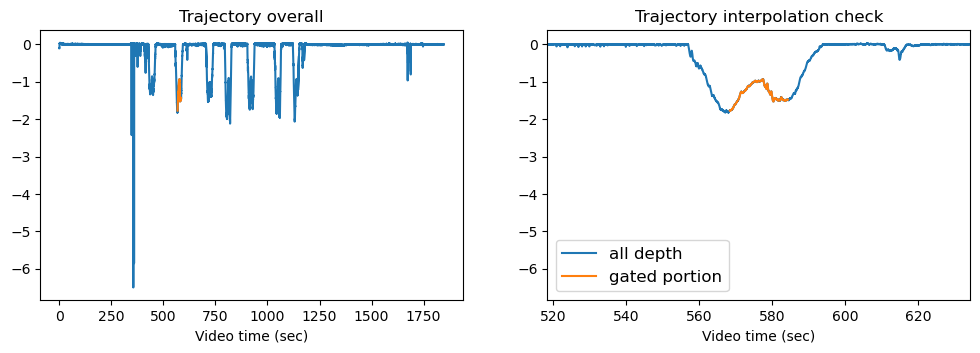

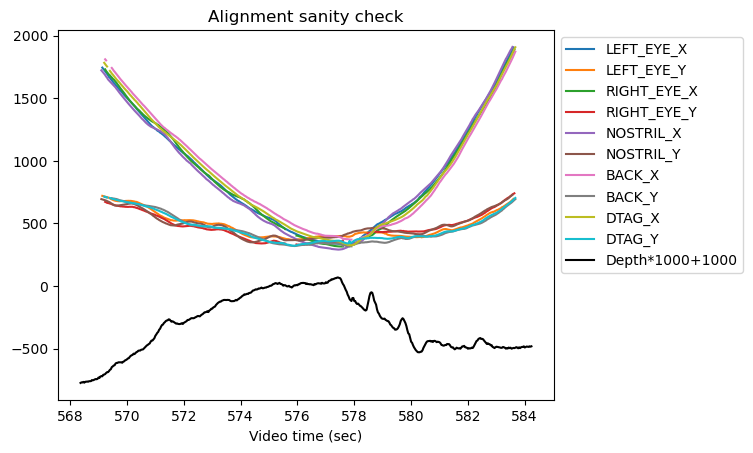

Save xypressure data to: 20190625_s1_t1_GOPR1466_xypressure.csv



---------------------------------------------------------
20190625_s1_t2, video: GOPR1466.MP4


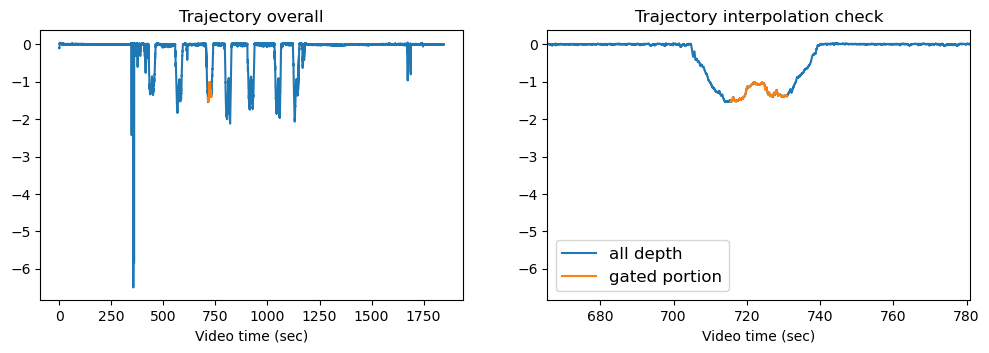

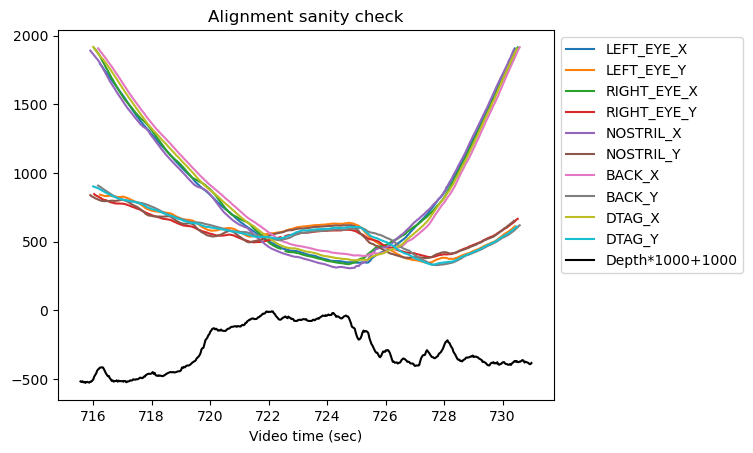

Save xypressure data to: 20190625_s1_t2_GOPR1466_xypressure.csv



---------------------------------------------------------
20190625_s1_t3, video: GOPR1466.MP4


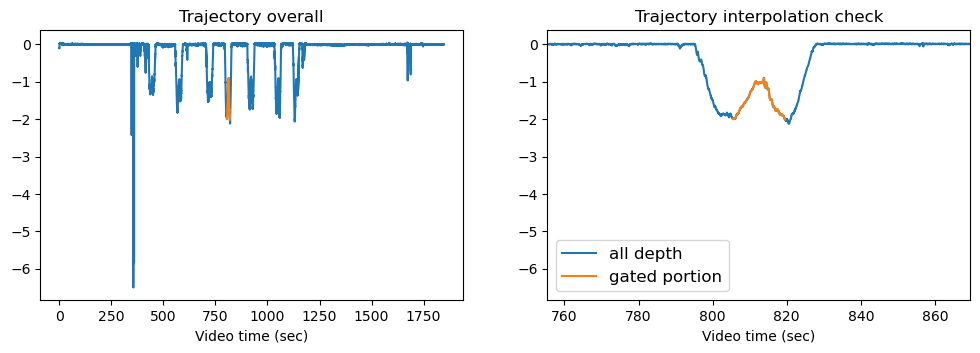

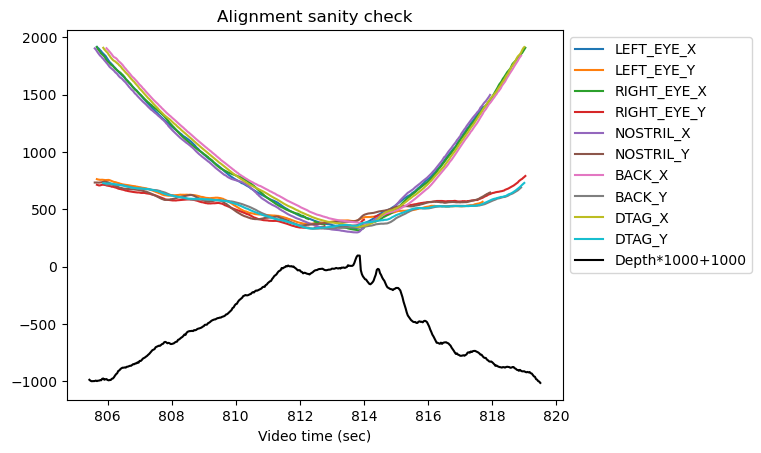

Save xypressure data to: 20190625_s1_t3_GOPR1466_xypressure.csv



---------------------------------------------------------
20190625_s1_t4, video: GOPR1466.MP4


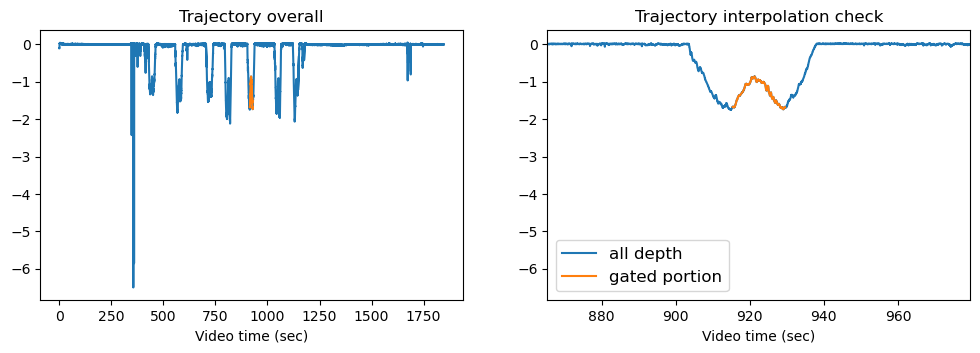

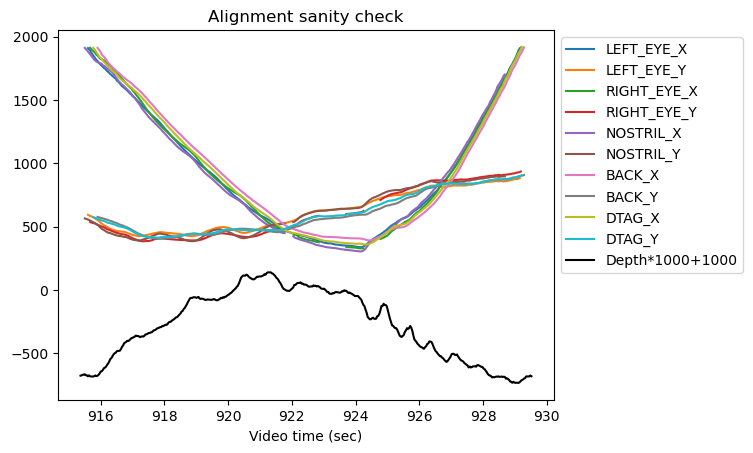

Save xypressure data to: 20190625_s1_t4_GOPR1466_xypressure.csv



---------------------------------------------------------
20190625_s1_t5, video: GOPR1466.MP4


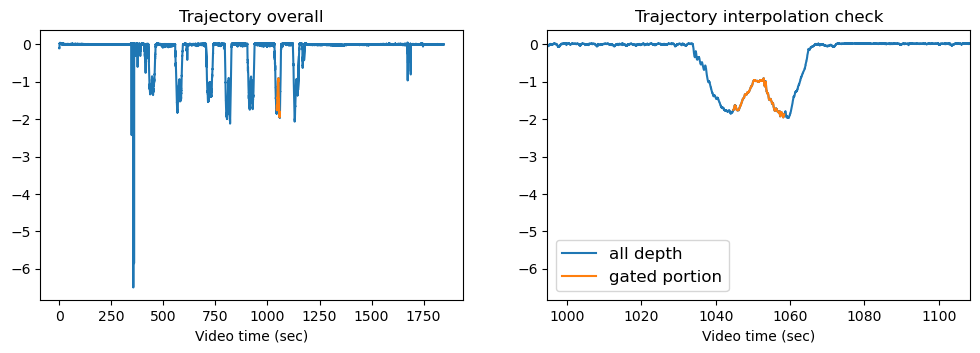

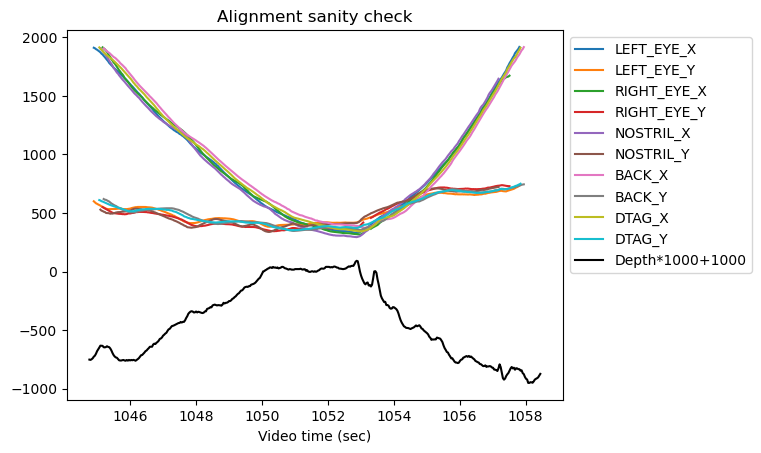

Save xypressure data to: 20190625_s1_t5_GOPR1466_xypressure.csv



---------------------------------------------------------
20190625_s1_t6, video: GP011466.MP4


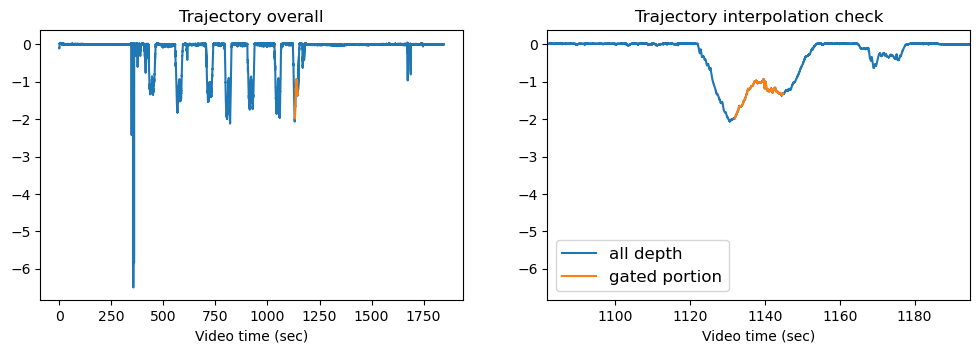

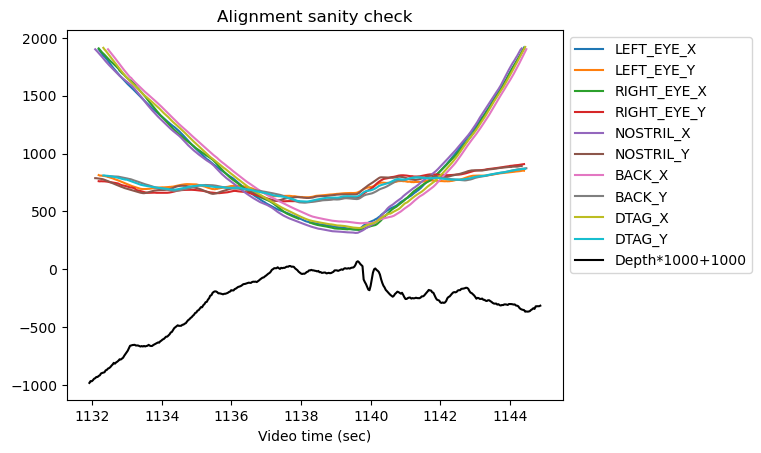

Save xypressure data to: 20190625_s1_t6_GP011466_xypressure.csv



---------------------------------------------------------
20190625_s2_t1, video: GOPR1467.MP4


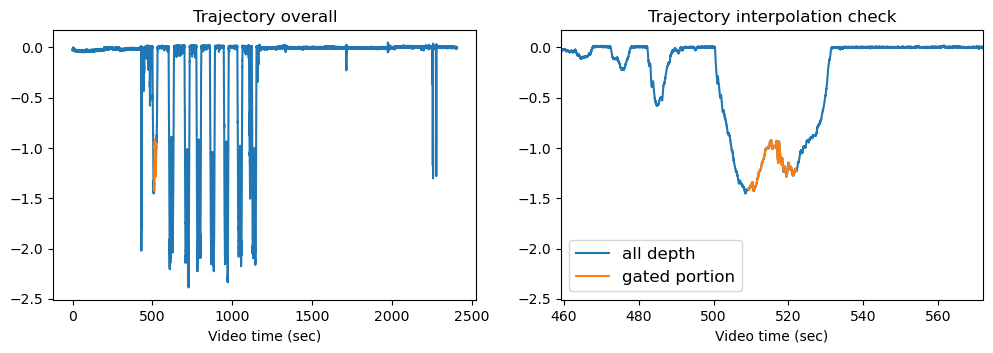

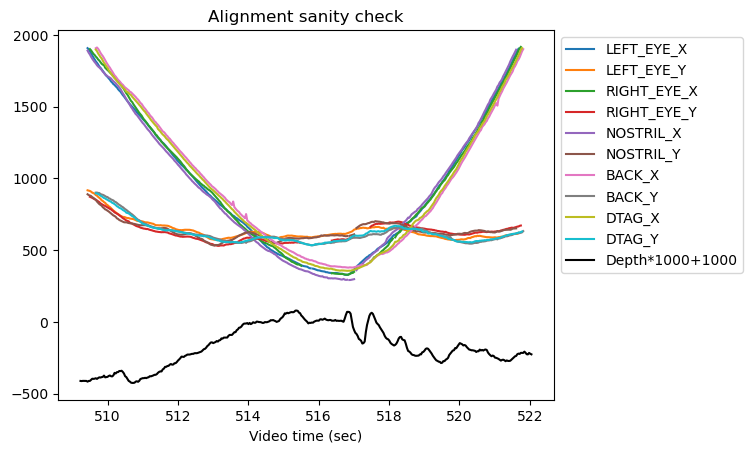

Save xypressure data to: 20190625_s2_t1_GOPR1467_xypressure.csv



---------------------------------------------------------
20190625_s2_t2, video: GOPR1467.MP4


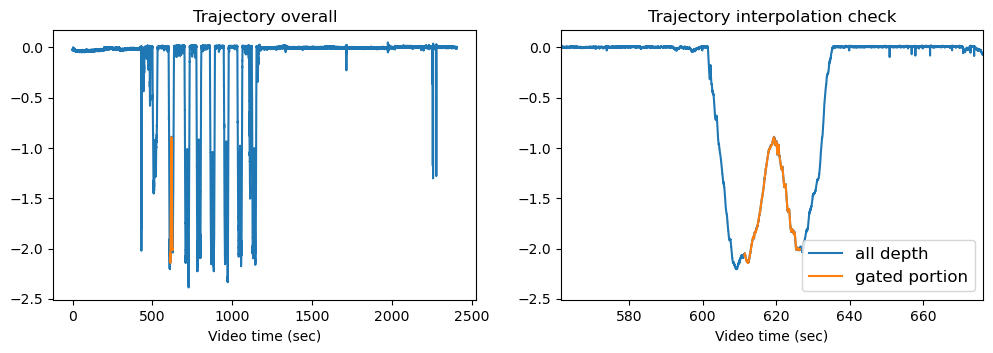

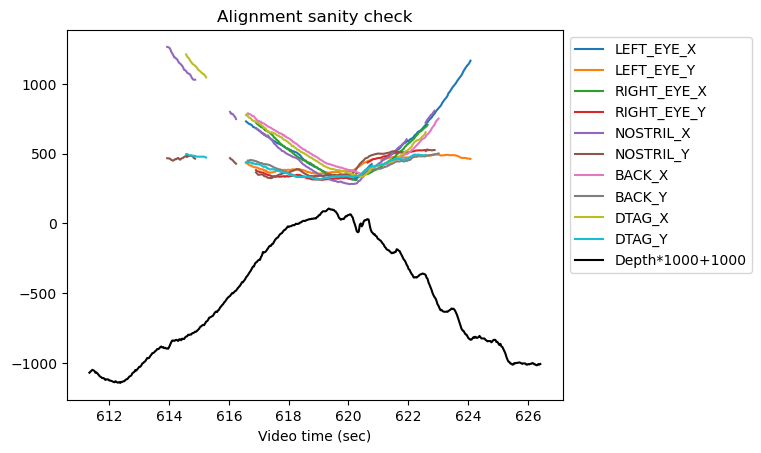

Save xypressure data to: 20190625_s2_t2_GOPR1467_xypressure.csv



---------------------------------------------------------
20190625_s2_t3, video: GOPR1467.MP4


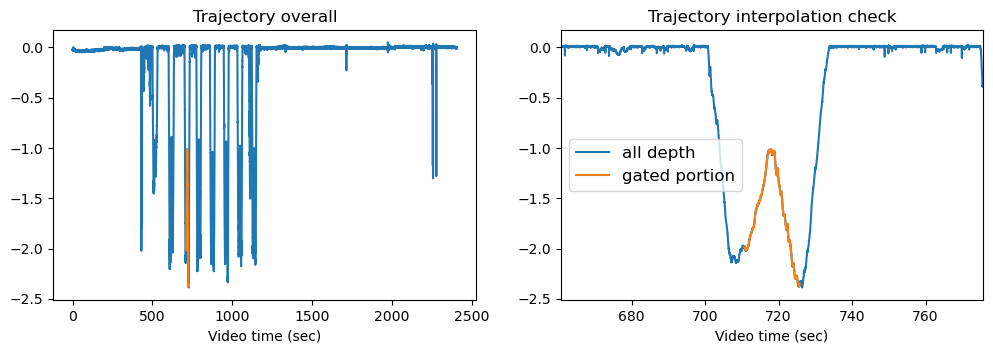

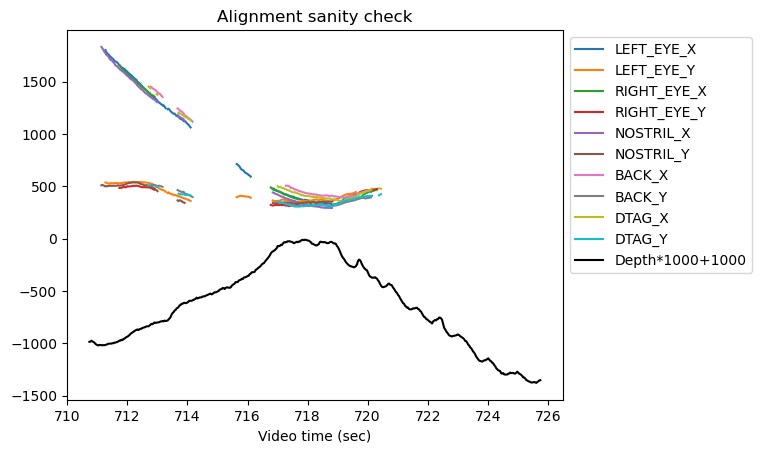

Save xypressure data to: 20190625_s2_t3_GOPR1467_xypressure.csv



---------------------------------------------------------
20190625_s2_t4, video: GOPR1467.MP4


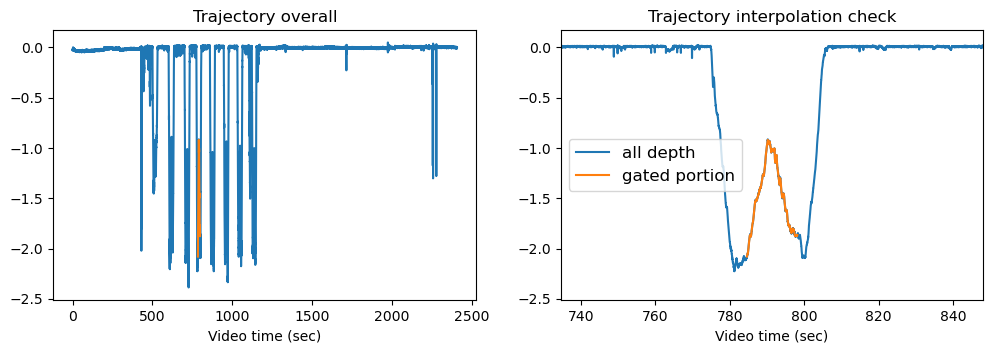

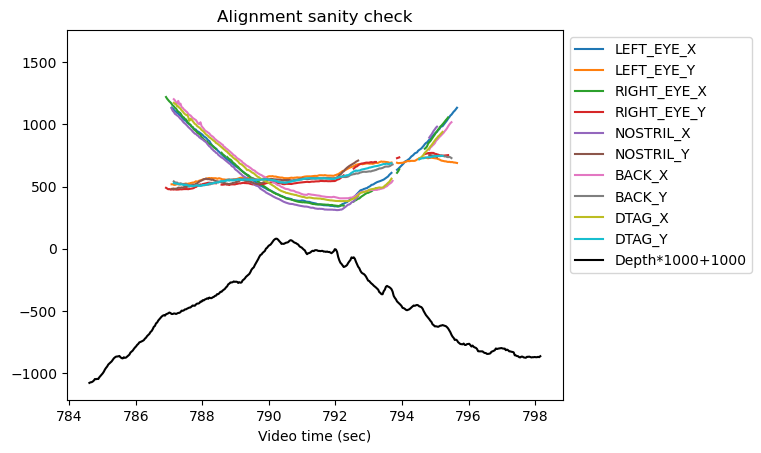

Save xypressure data to: 20190625_s2_t4_GOPR1467_xypressure.csv



---------------------------------------------------------
20190625_s2_t5, video: GOPR1467.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190625_s2_t6, video: GOPR1467.MP4


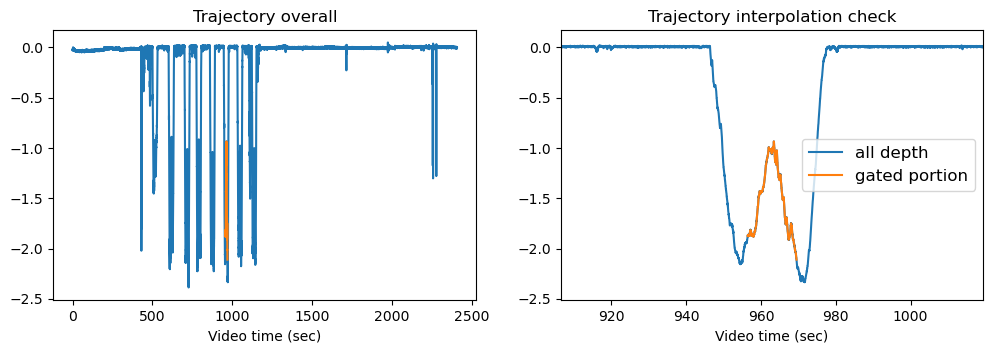

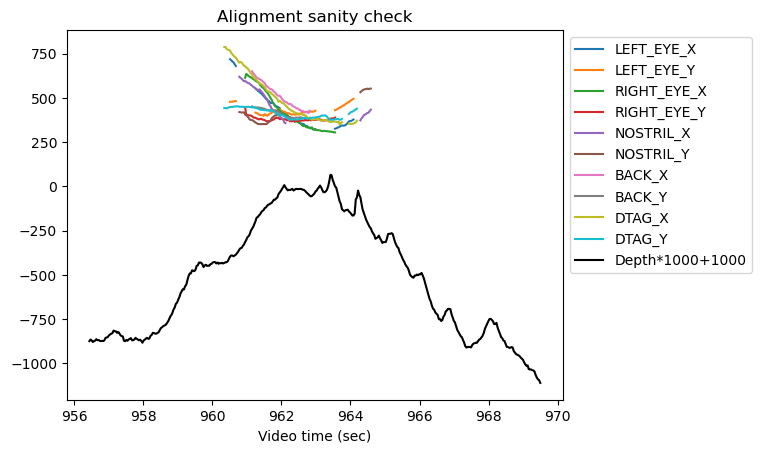

Save xypressure data to: 20190625_s2_t6_GOPR1467_xypressure.csv



---------------------------------------------------------
20190625_s2_t7, video: GOPR1467.MP4


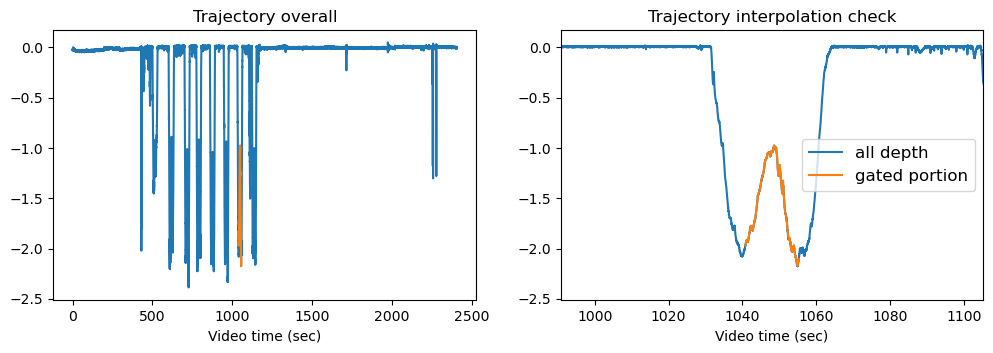

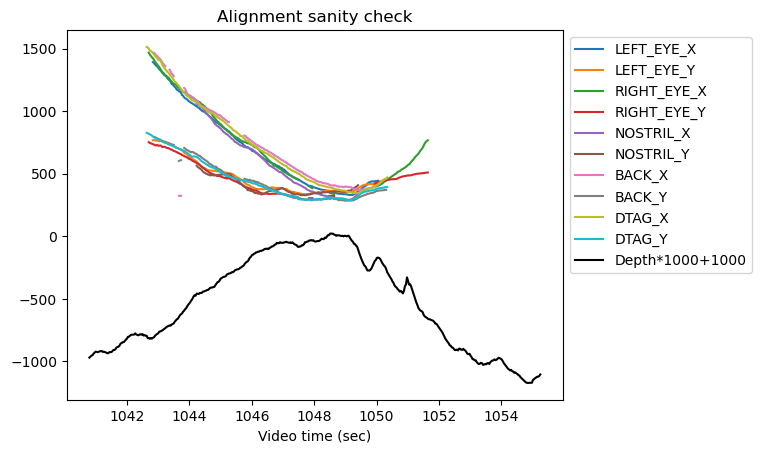

Save xypressure data to: 20190625_s2_t7_GOPR1467_xypressure.csv



---------------------------------------------------------
20190625_s2_t8, video: GP011467.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190625_s3_t1, video: GOPR1468.MP4


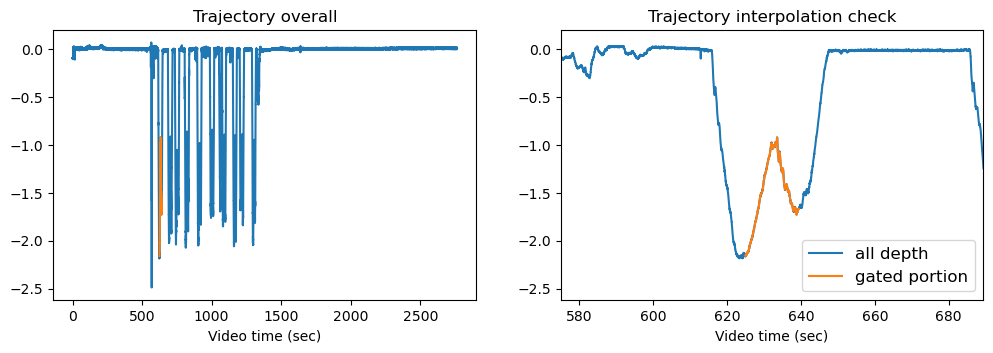

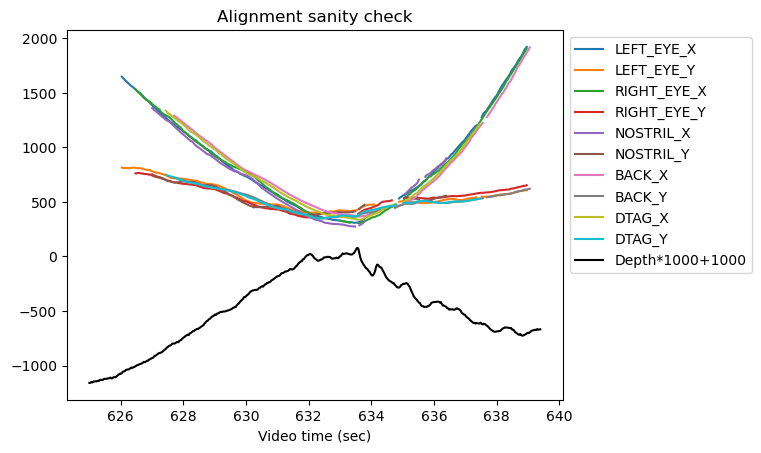

Save xypressure data to: 20190625_s3_t1_GOPR1468_xypressure.csv



---------------------------------------------------------
20190625_s3_t2, video: GOPR1468.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190625_s3_t3, video: GOPR1468.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190625_s3_t4, video: GOPR1468.MP4


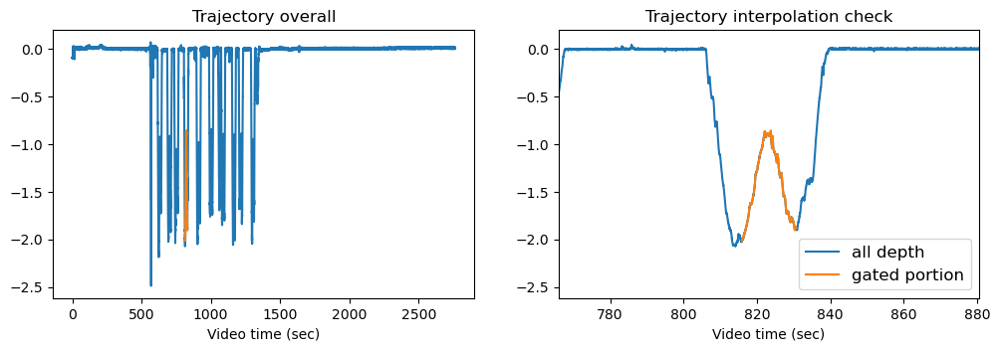

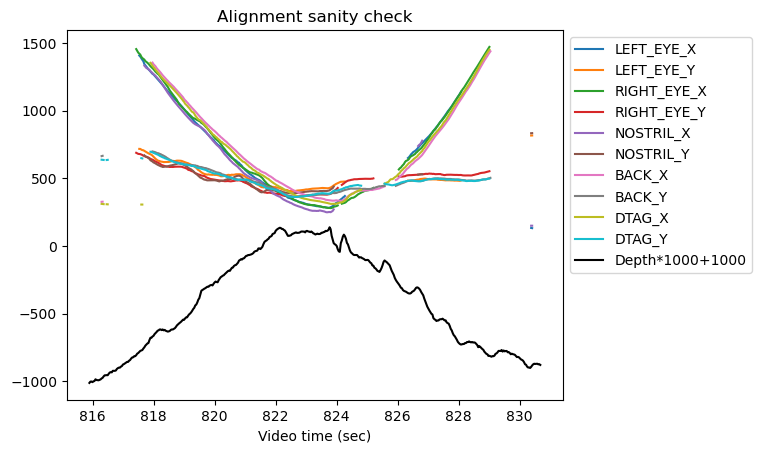

Save xypressure data to: 20190625_s3_t4_GOPR1468_xypressure.csv



---------------------------------------------------------
20190625_s3_t5, video: GOPR1468.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190625_s3_t6, video: GOPR1468.MP4


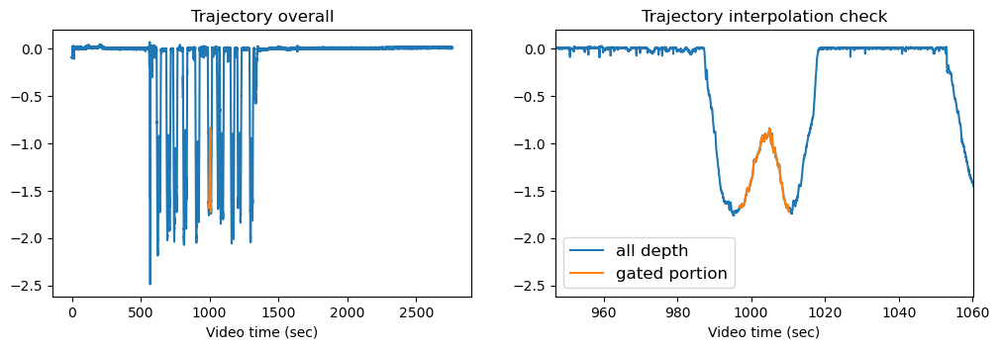

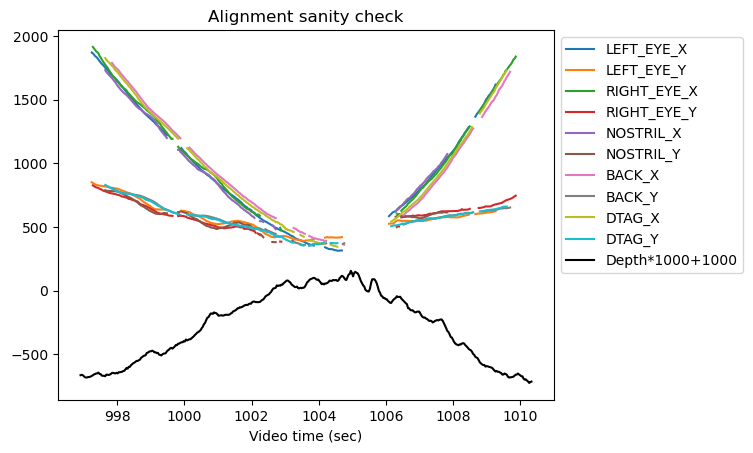

Save xypressure data to: 20190625_s3_t6_GOPR1468_xypressure.csv



---------------------------------------------------------
20190625_s3_t7, video: GOPR1468.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190625_s3_t8, video: GP011468.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190625_s3_t9, video: GP011468.MP4


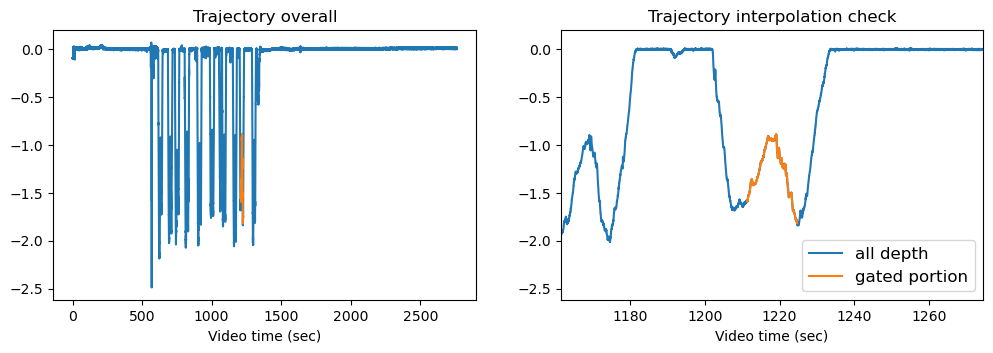

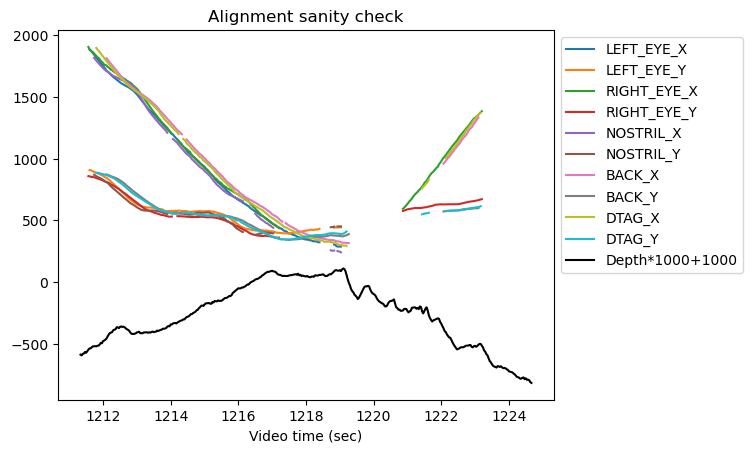

Save xypressure data to: 20190625_s3_t9_GP011468_xypressure.csv



---------------------------------------------------------
20190625_s3_t10, video: GP011468.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190626_s1_t1, video: GOPR1469.MP4


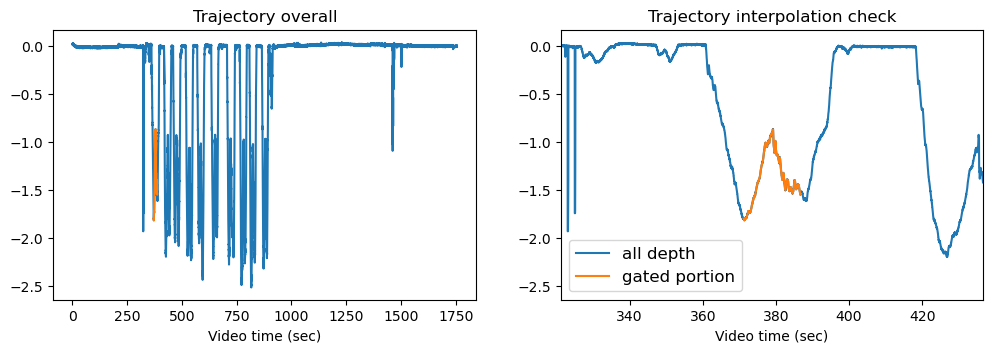

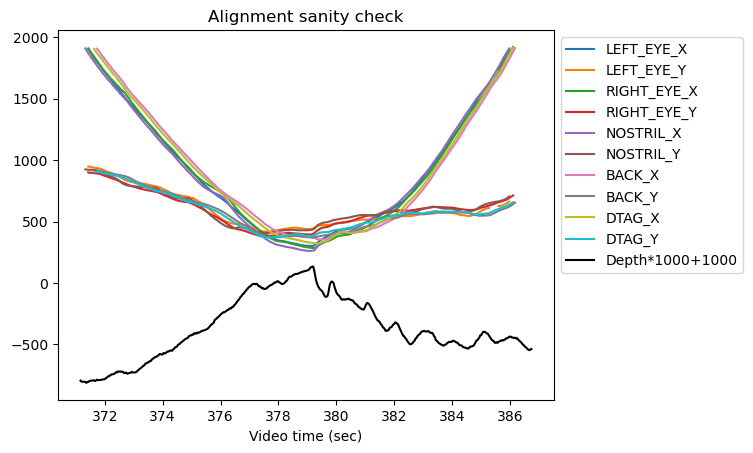

Save xypressure data to: 20190626_s1_t1_GOPR1469_xypressure.csv



---------------------------------------------------------
20190626_s1_t2, video: GOPR1469.MP4


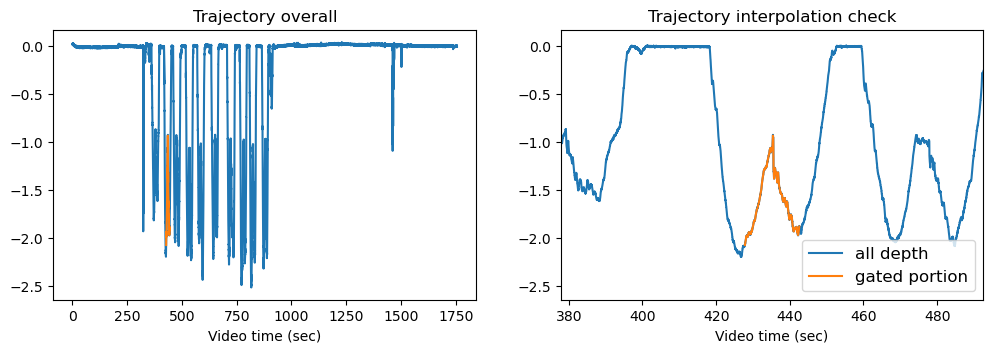

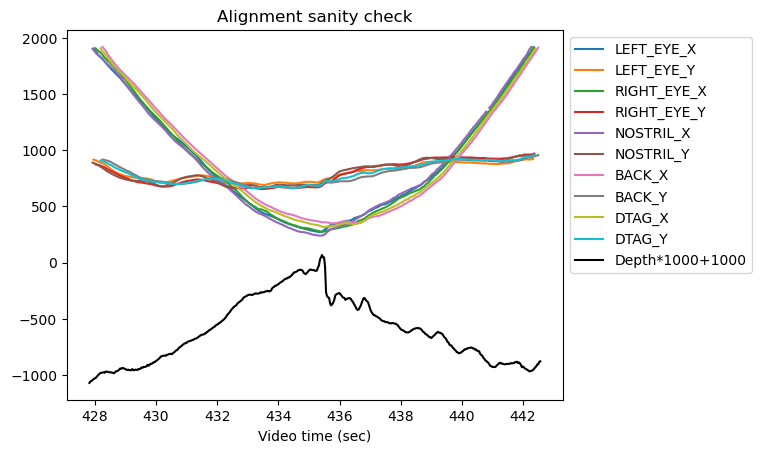

Save xypressure data to: 20190626_s1_t2_GOPR1469_xypressure.csv



---------------------------------------------------------
20190626_s1_t3, video: GOPR1469.MP4


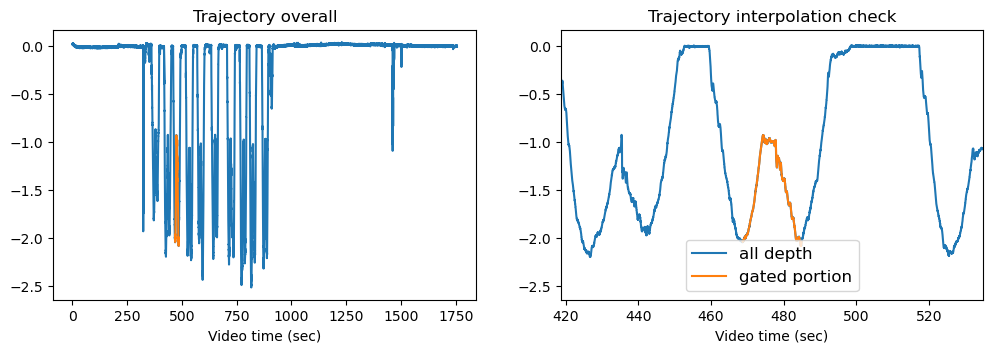

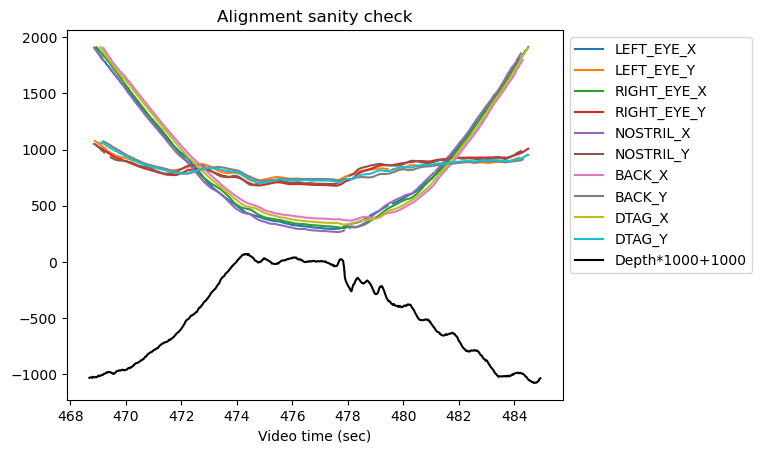

Save xypressure data to: 20190626_s1_t3_GOPR1469_xypressure.csv



---------------------------------------------------------
20190626_s1_t4, video: GOPR1469.MP4


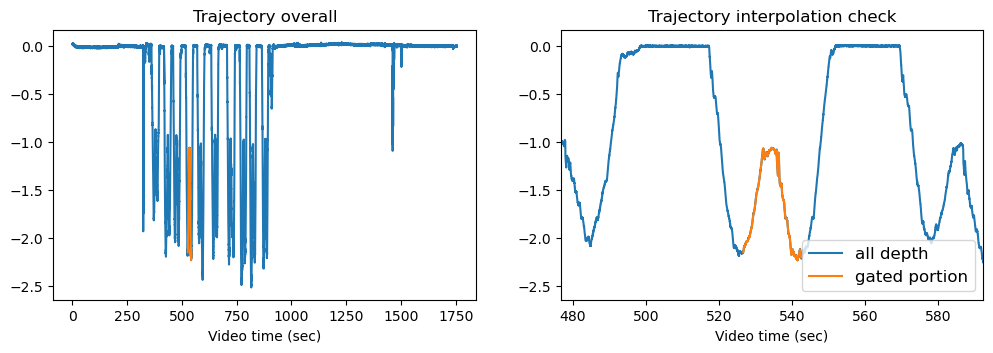

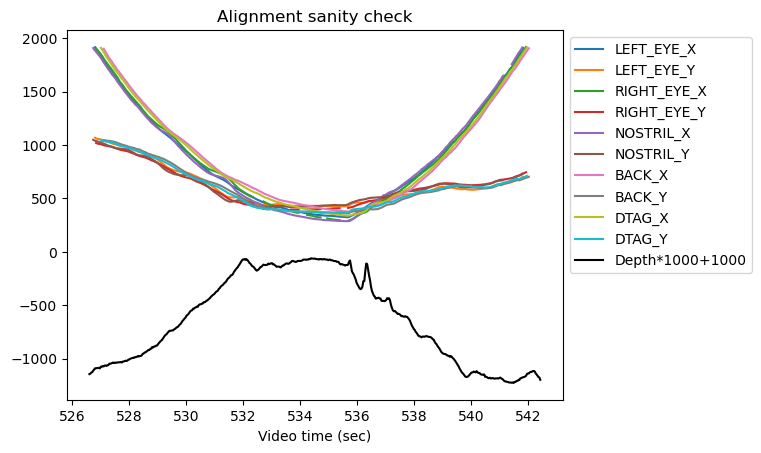

Save xypressure data to: 20190626_s1_t4_GOPR1469_xypressure.csv



---------------------------------------------------------
20190626_s1_t5, video: GOPR1469.MP4


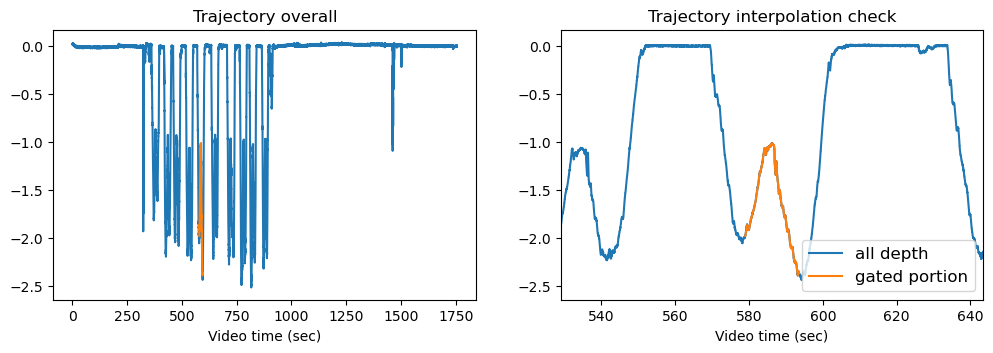

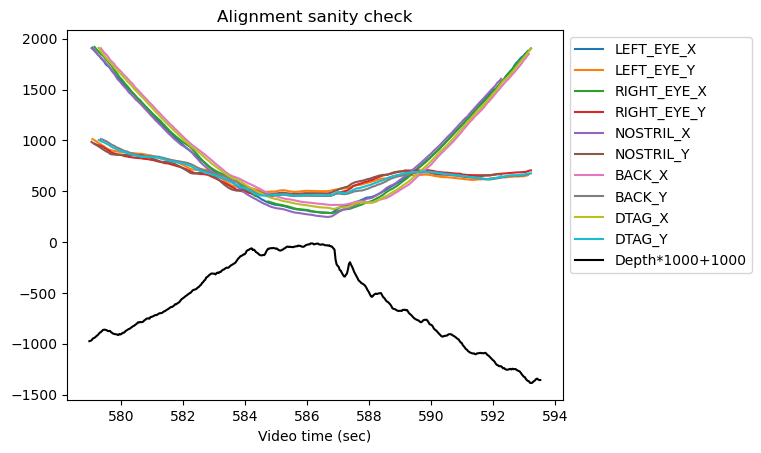

Save xypressure data to: 20190626_s1_t5_GOPR1469_xypressure.csv



---------------------------------------------------------
20190626_s1_t6, video: GOPR1469.MP4


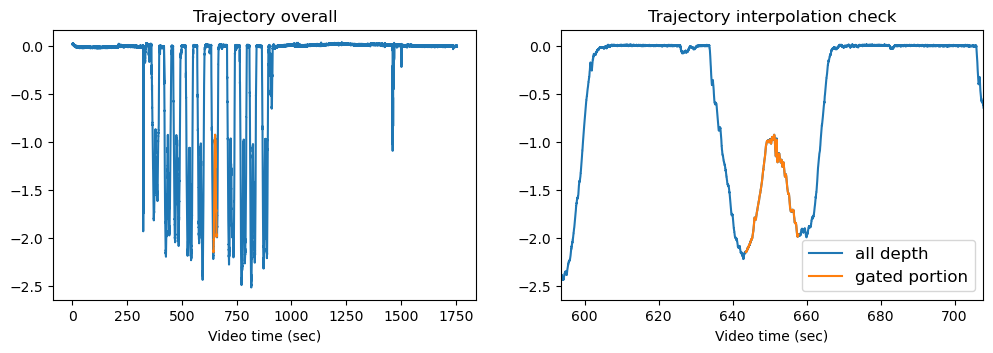

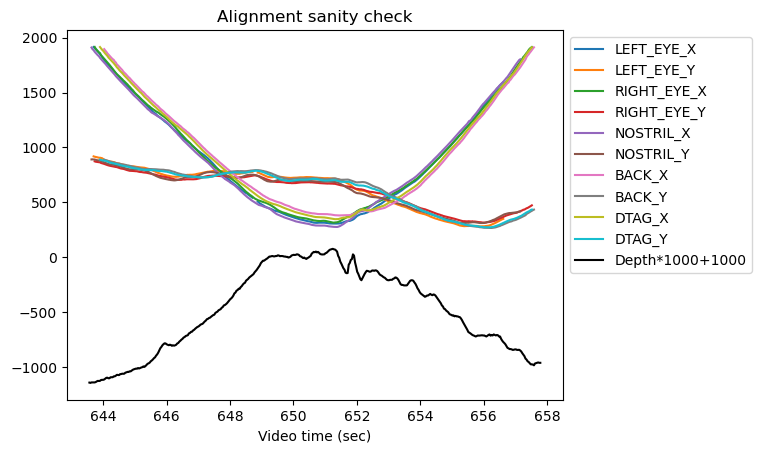

Save xypressure data to: 20190626_s1_t6_GOPR1469_xypressure.csv



---------------------------------------------------------
20190626_s1_t7, video: GOPR1469.MP4


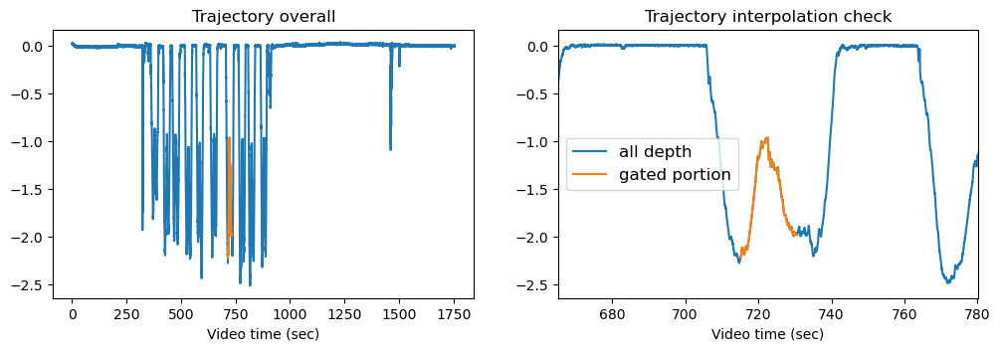

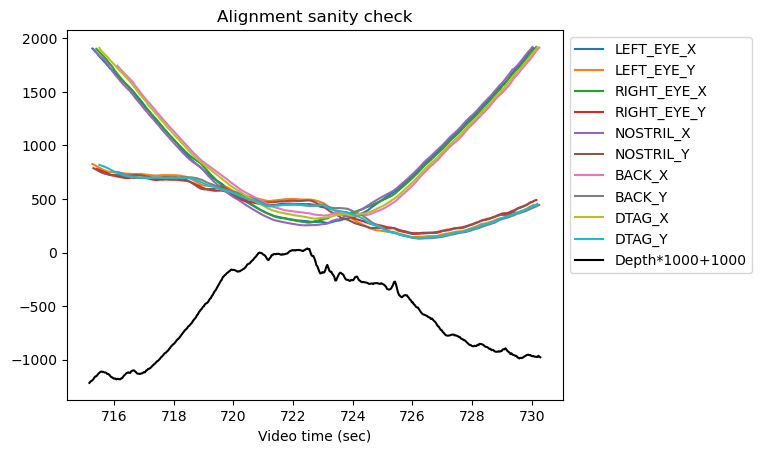

Save xypressure data to: 20190626_s1_t7_GOPR1469_xypressure.csv



---------------------------------------------------------
20190626_s1_t8, video: GOPR1469.MP4


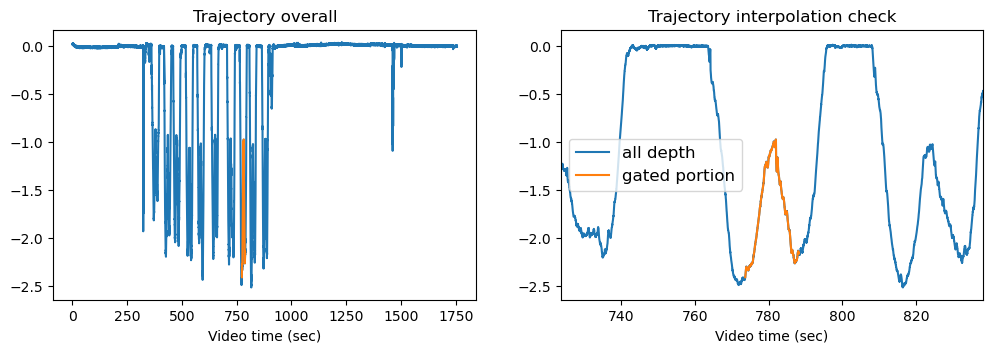

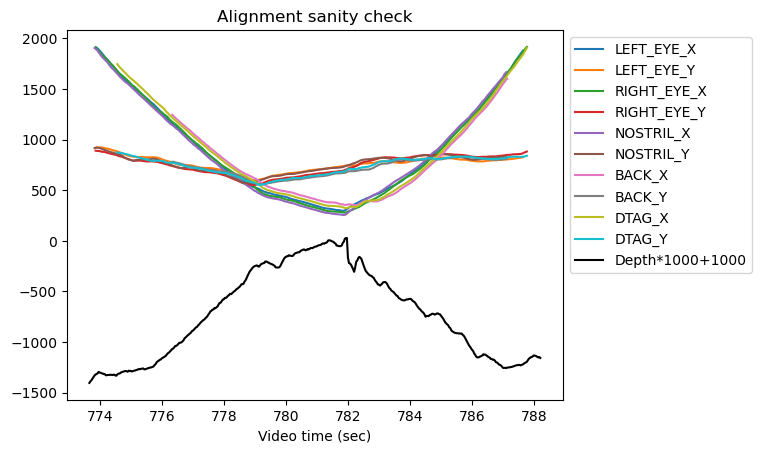

Save xypressure data to: 20190626_s1_t8_GOPR1469_xypressure.csv



---------------------------------------------------------
20190626_s1_t9, video: GOPR1469.MP4


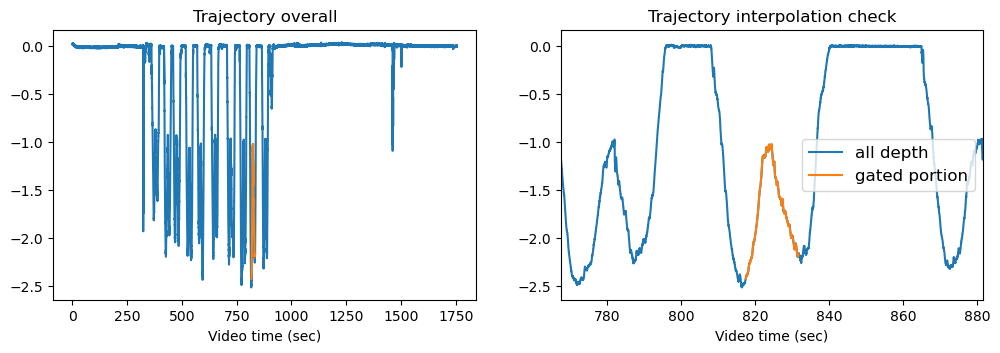

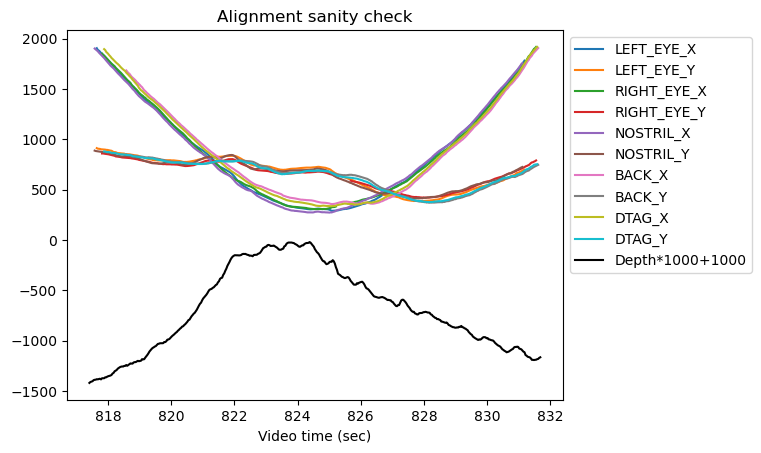

Save xypressure data to: 20190626_s1_t9_GOPR1469_xypressure.csv



---------------------------------------------------------
20190626_s1_t10, video: GOPR1469.MP4


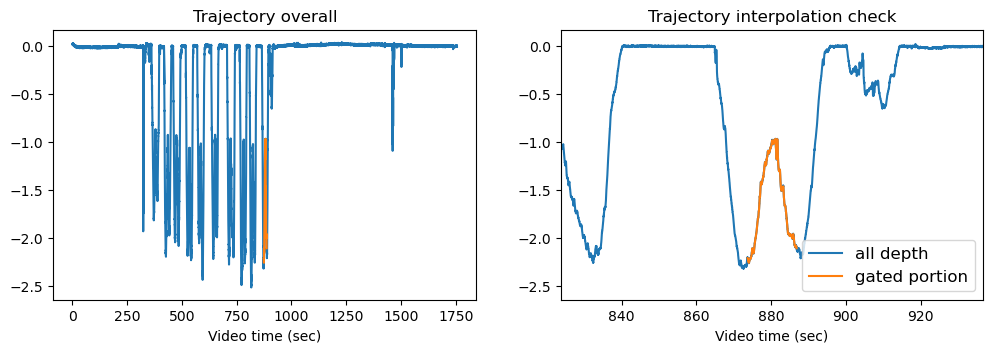

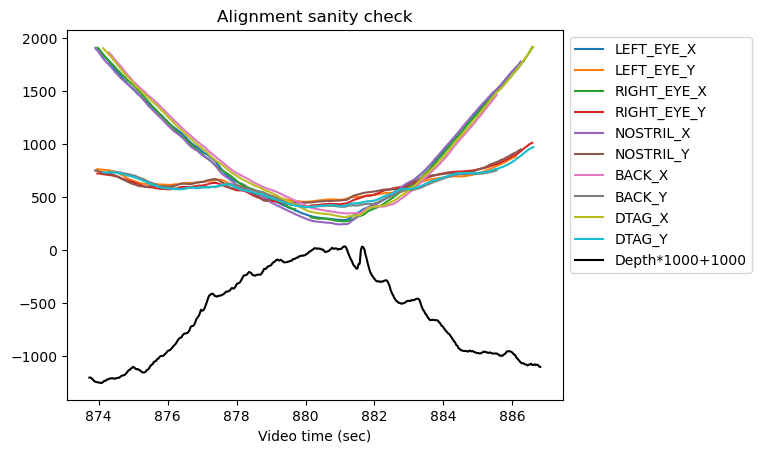

Save xypressure data to: 20190626_s1_t10_GOPR1469_xypressure.csv



---------------------------------------------------------
20190626_s2_t1, video: GOPR1470.MP4


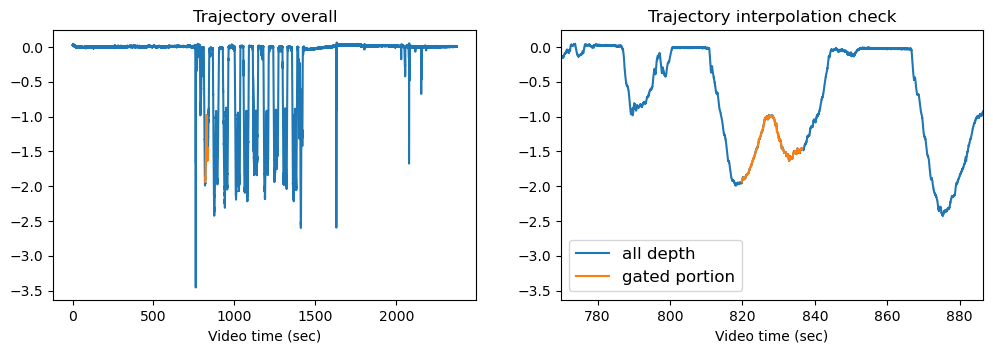

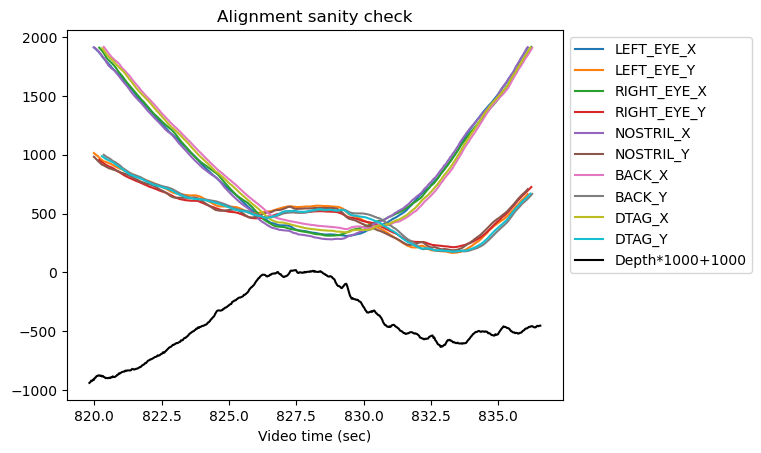

Save xypressure data to: 20190626_s2_t1_GOPR1470_xypressure.csv



---------------------------------------------------------
20190626_s2_t2, video: GOPR1470.MP4


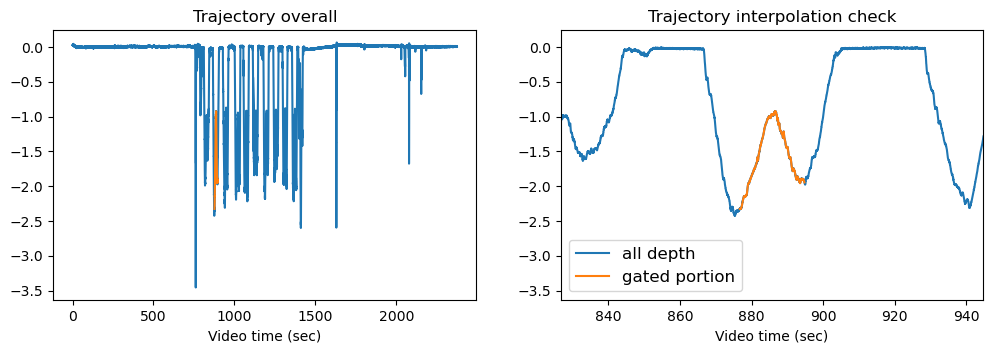

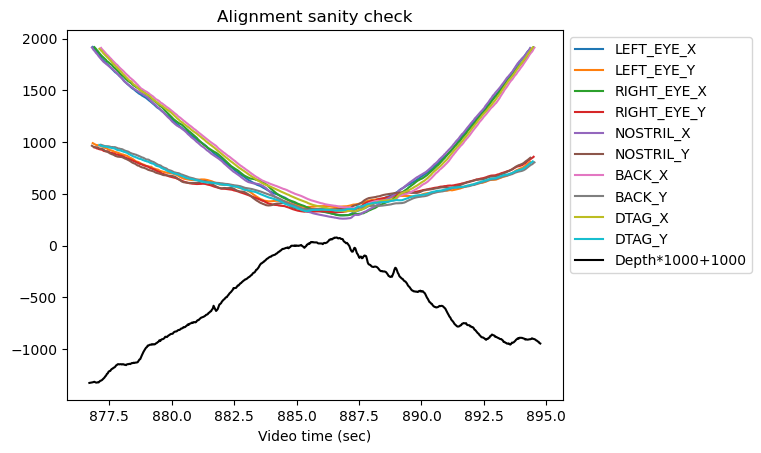

Save xypressure data to: 20190626_s2_t2_GOPR1470_xypressure.csv



---------------------------------------------------------
20190626_s2_t3, video: GOPR1470.MP4


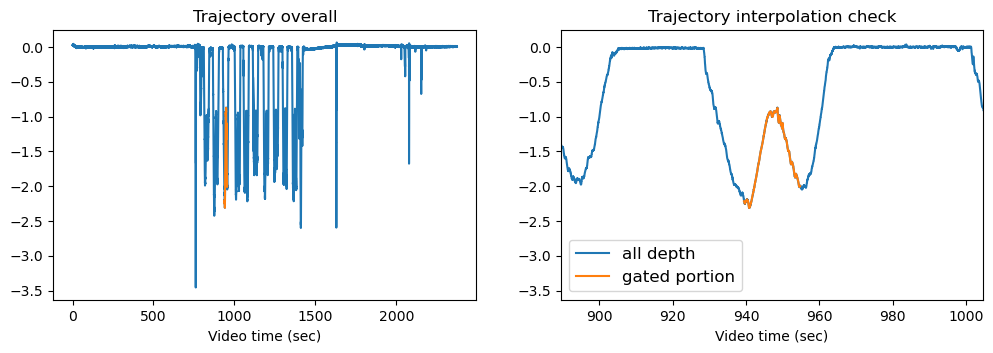

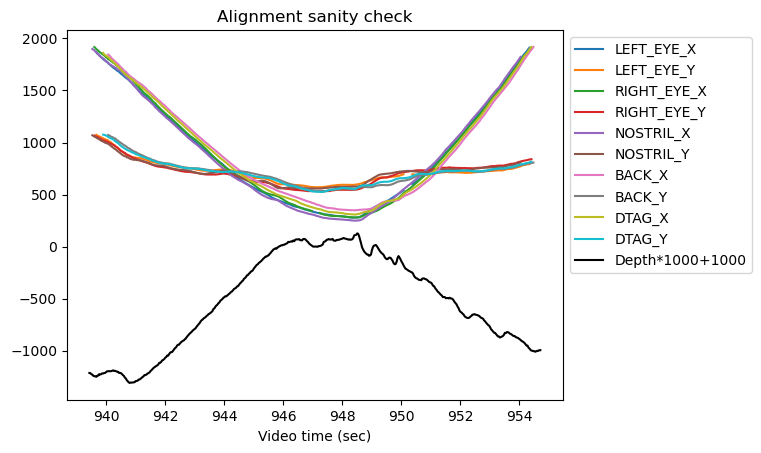

Save xypressure data to: 20190626_s2_t3_GOPR1470_xypressure.csv



---------------------------------------------------------
20190626_s2_t4, video: GOPR1470.MP4


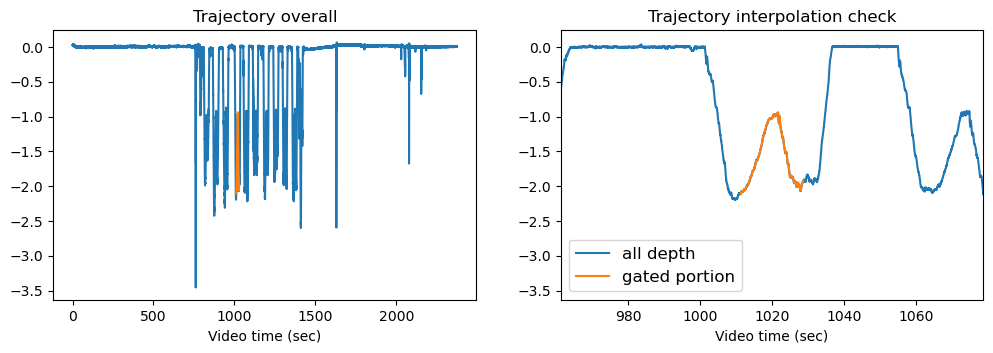

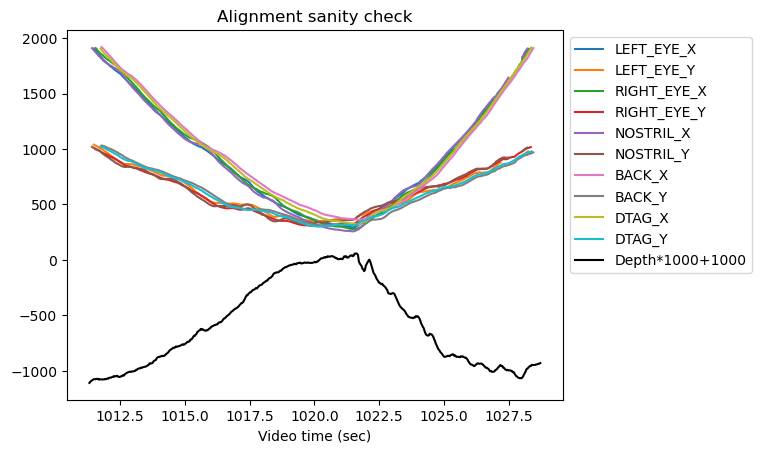

Save xypressure data to: 20190626_s2_t4_GOPR1470_xypressure.csv



---------------------------------------------------------
20190626_s2_t5, video: GOPR1470.MP4 + GP011470.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190626_s2_t6, video: GP011470.MP4


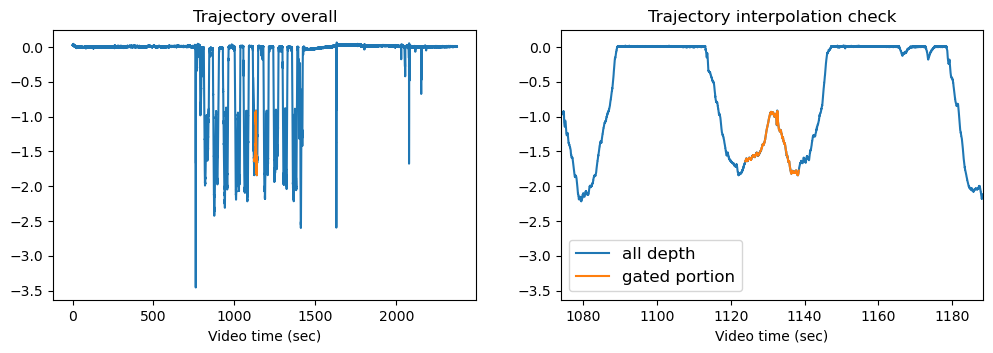

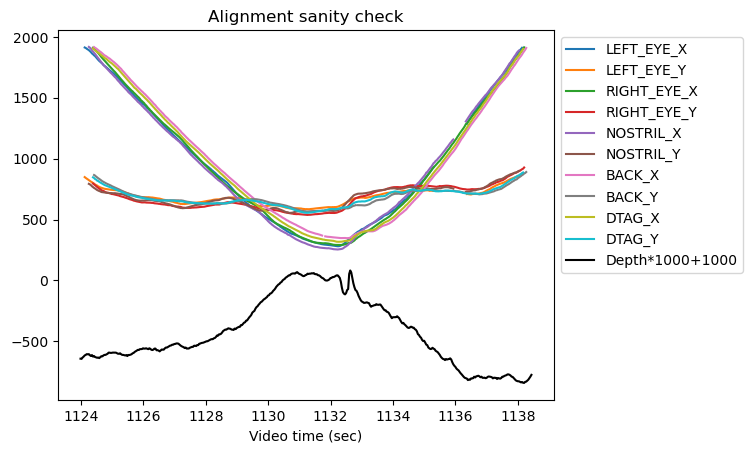

Save xypressure data to: 20190626_s2_t6_GP011470_xypressure.csv



---------------------------------------------------------
20190626_s2_t7, video: GP011470.MP4


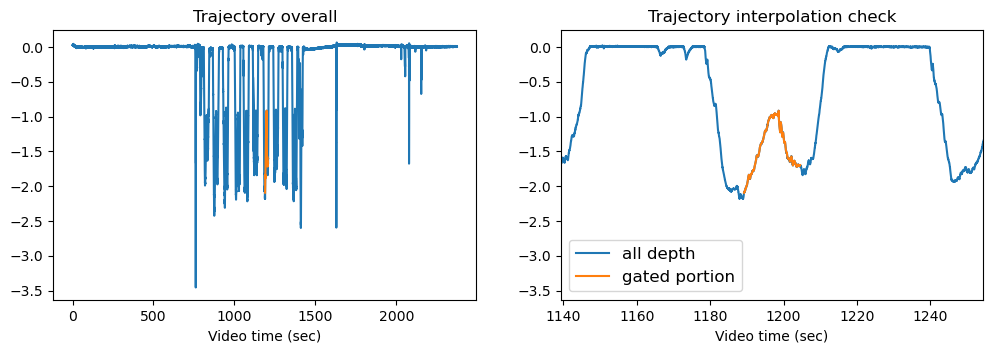

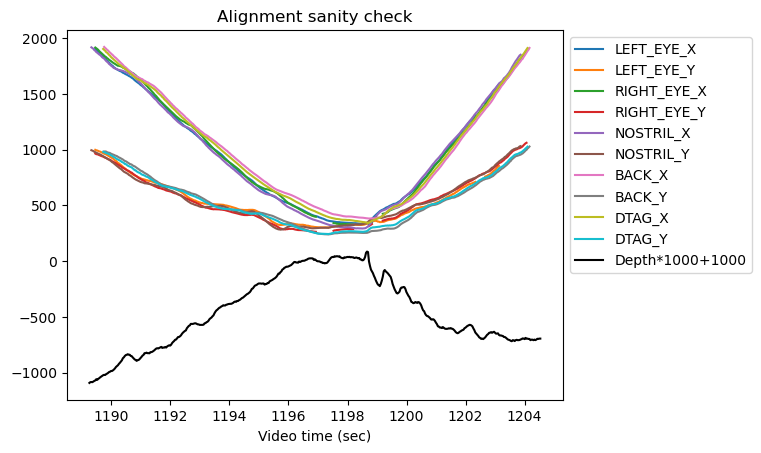

Save xypressure data to: 20190626_s2_t7_GP011470_xypressure.csv



---------------------------------------------------------
20190626_s2_t8, video: GP011470.MP4


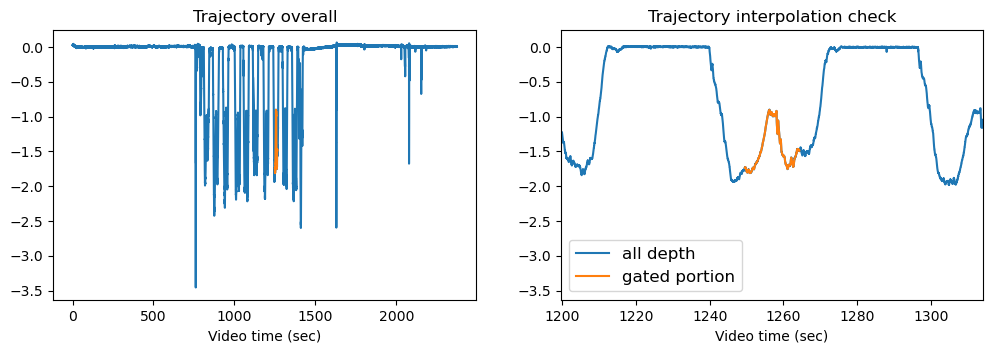

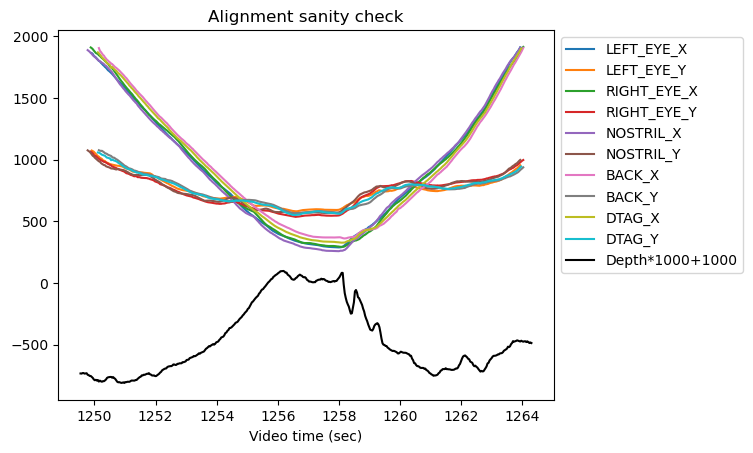

Save xypressure data to: 20190626_s2_t8_GP011470_xypressure.csv



---------------------------------------------------------
20190626_s2_t9, video: GP011470.MP4


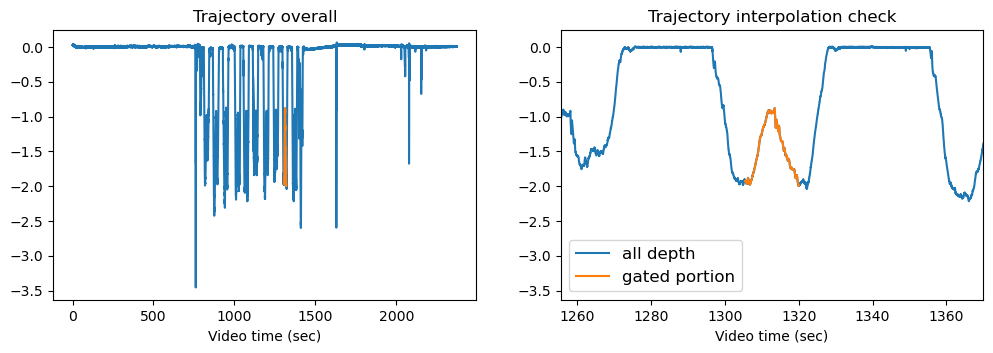

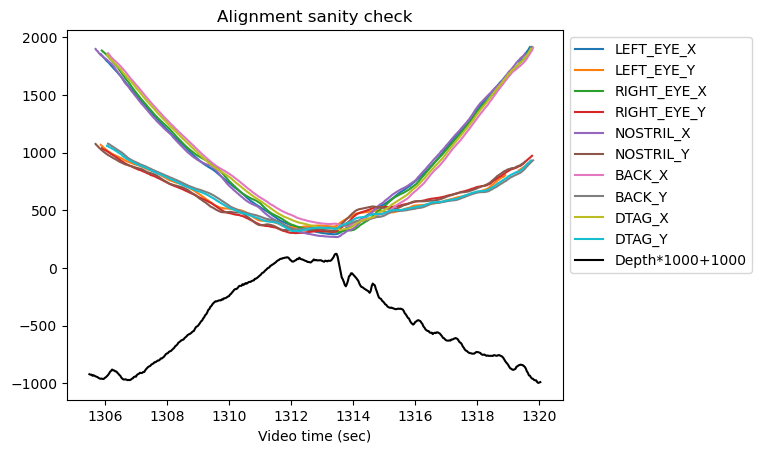

Save xypressure data to: 20190626_s2_t9_GP011470_xypressure.csv



---------------------------------------------------------
20190626_s2_t10, video: GP011470.MP4


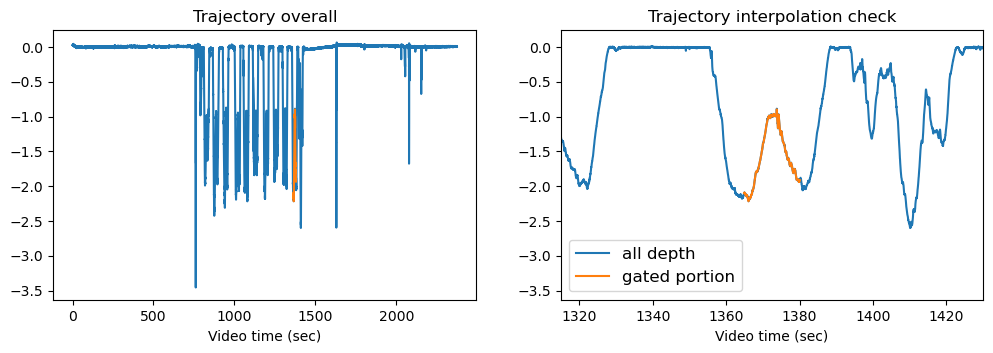

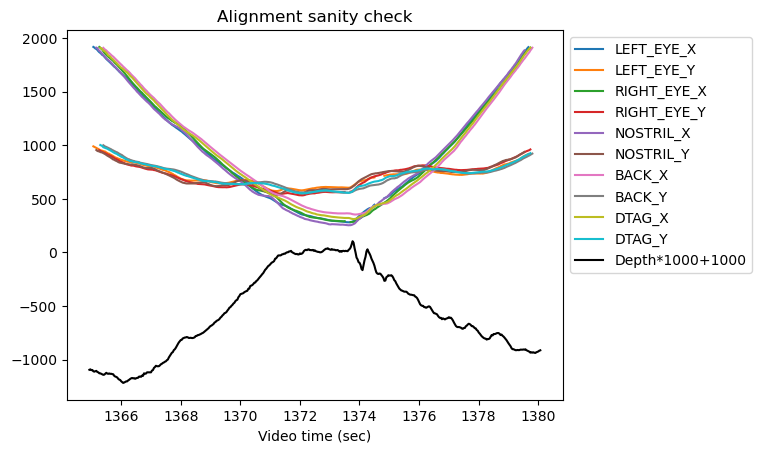

Save xypressure data to: 20190626_s2_t10_GP011470_xypressure.csv



---------------------------------------------------------
20190626_s3_t1, video: GOPR1471.MP4


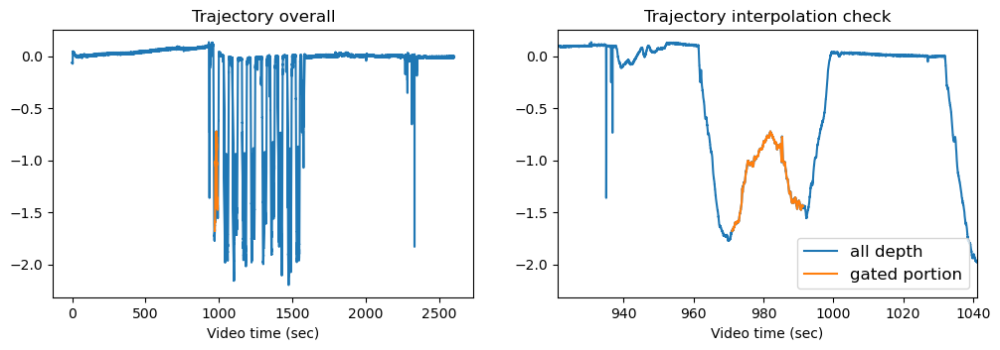

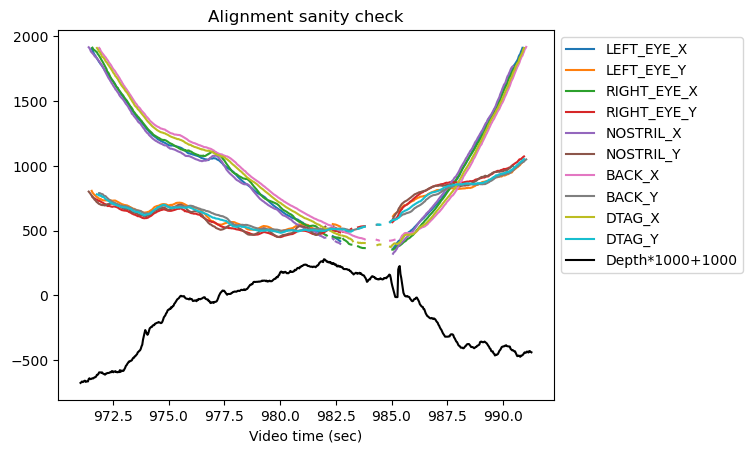

Save xypressure data to: 20190626_s3_t1_GOPR1471_xypressure.csv



---------------------------------------------------------
20190626_s3_t2, video: GOPR1471.MP4


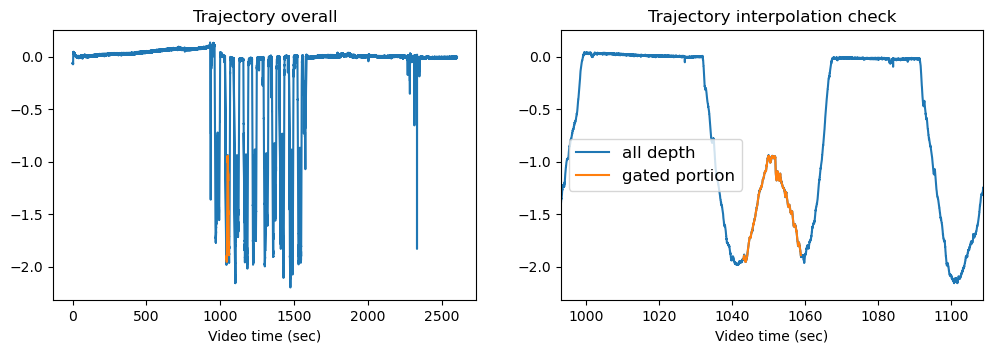

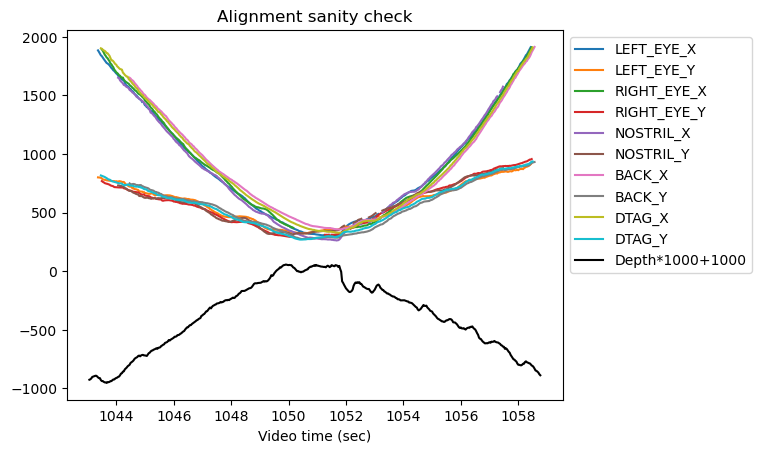

Save xypressure data to: 20190626_s3_t2_GOPR1471_xypressure.csv



---------------------------------------------------------
20190626_s3_t3, video: GP011471.MP4


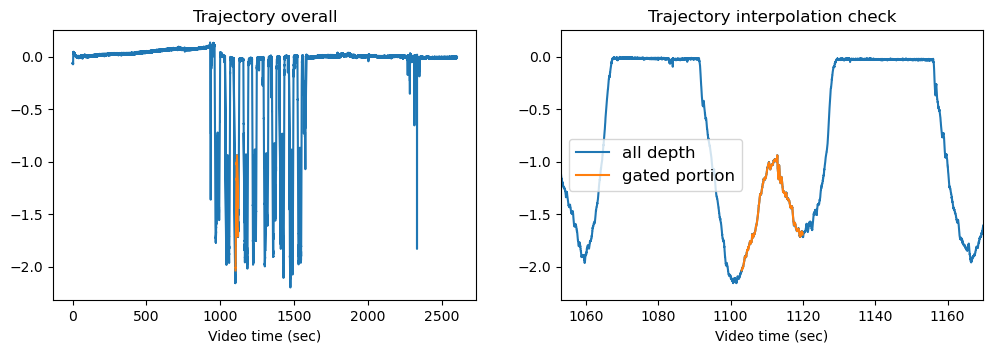

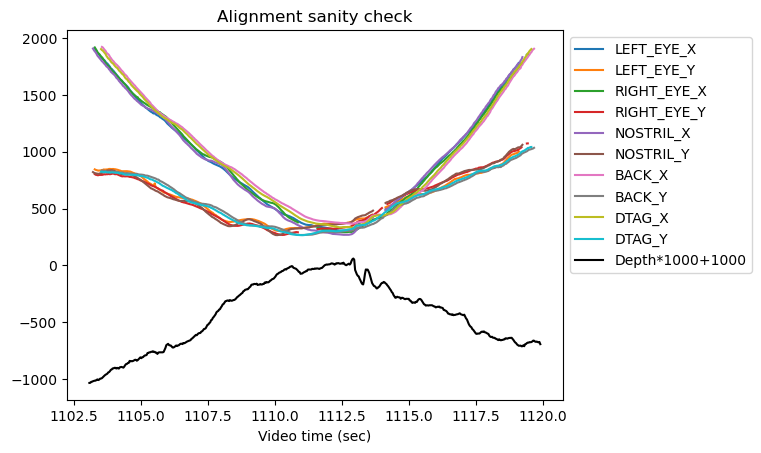

Save xypressure data to: 20190626_s3_t3_GP011471_xypressure.csv



---------------------------------------------------------
20190626_s3_t4, video: GP011471.MP4


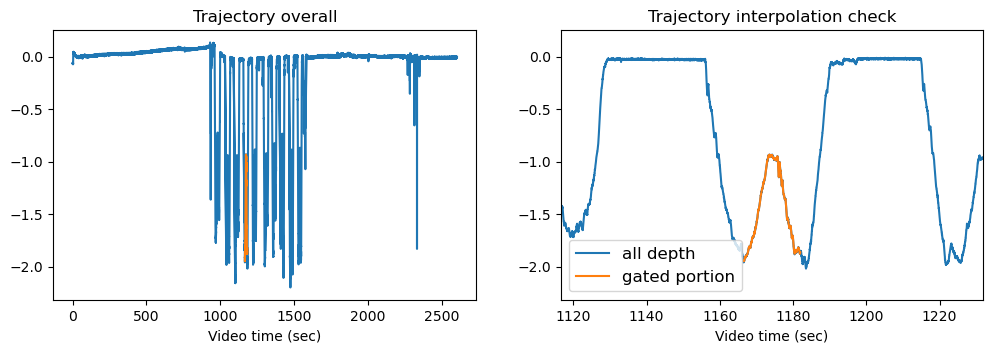

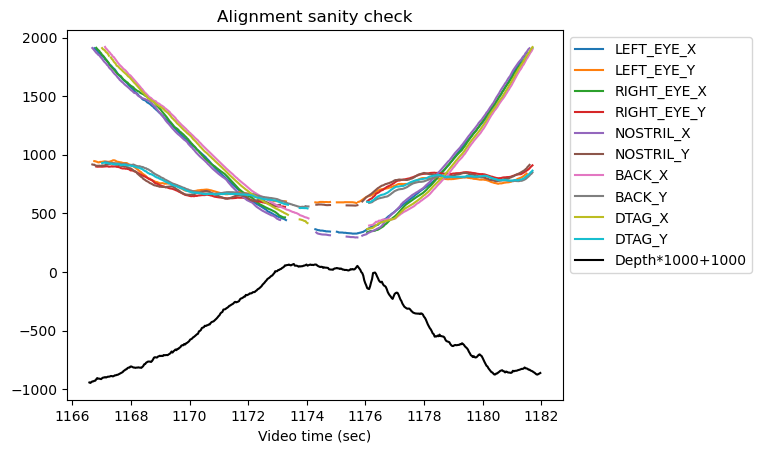

Save xypressure data to: 20190626_s3_t4_GP011471_xypressure.csv



---------------------------------------------------------
20190626_s3_t5, video: GP011471.MP4


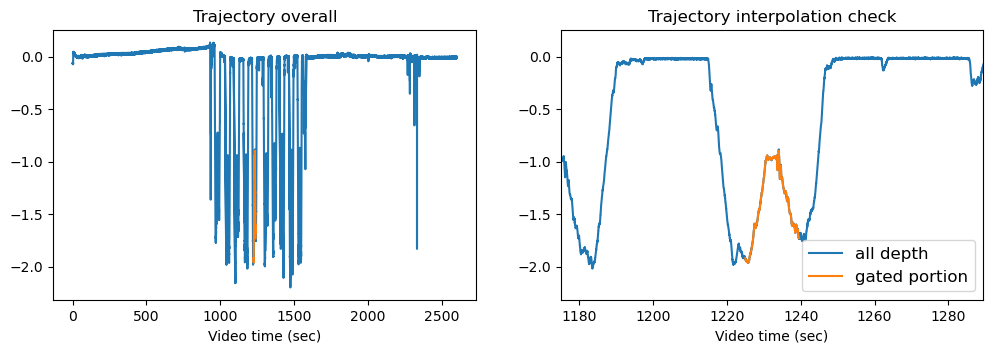

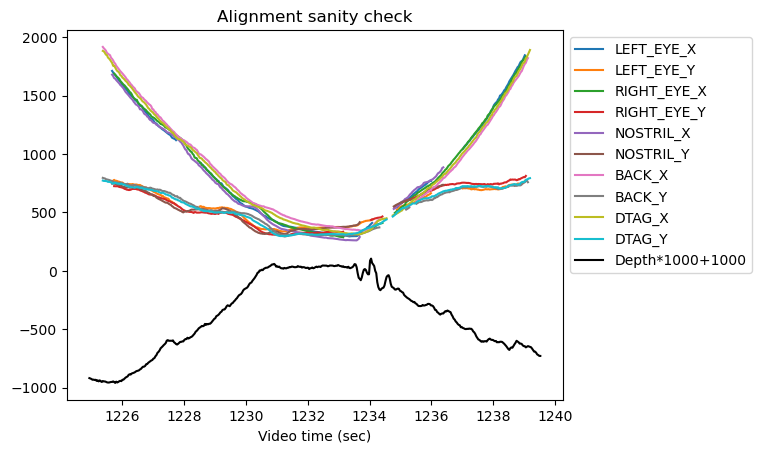

Save xypressure data to: 20190626_s3_t5_GP011471_xypressure.csv



---------------------------------------------------------
20190626_s3_t6, video: GP011471.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190626_s3_t7, video: GP011471.MP4


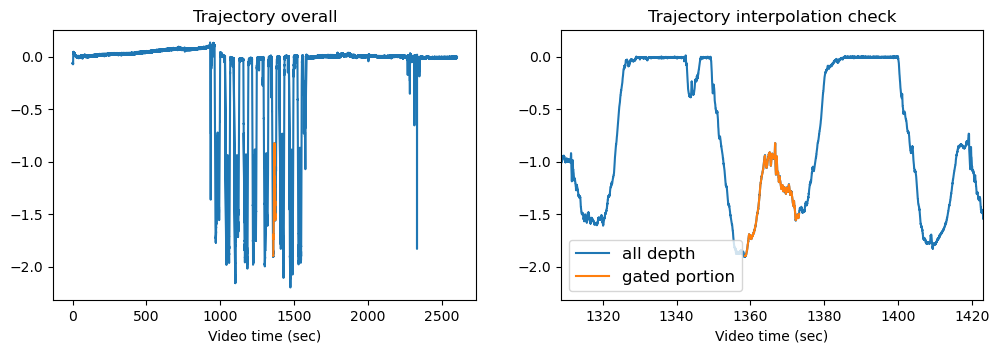

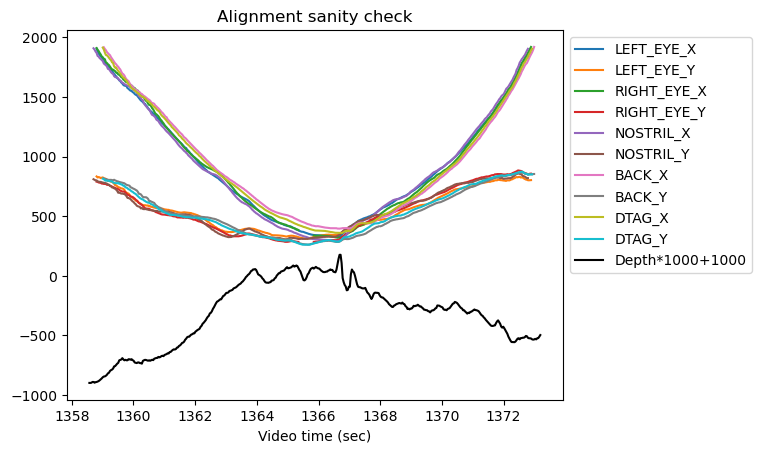

Save xypressure data to: 20190626_s3_t7_GP011471_xypressure.csv



---------------------------------------------------------
20190626_s3_t8, video: GP011471.MP4


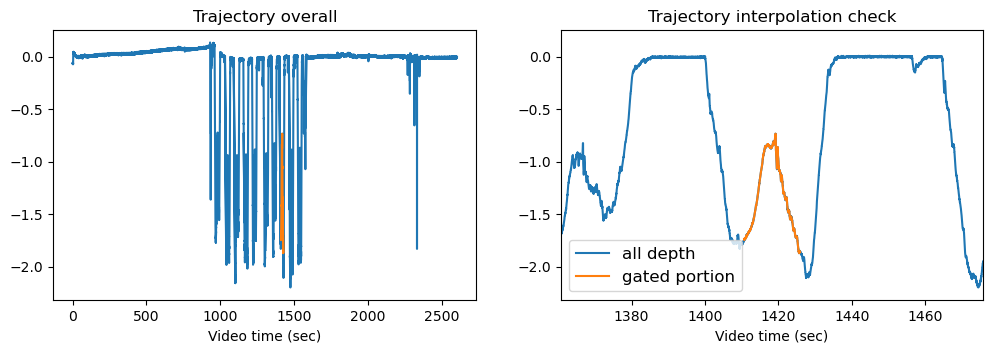

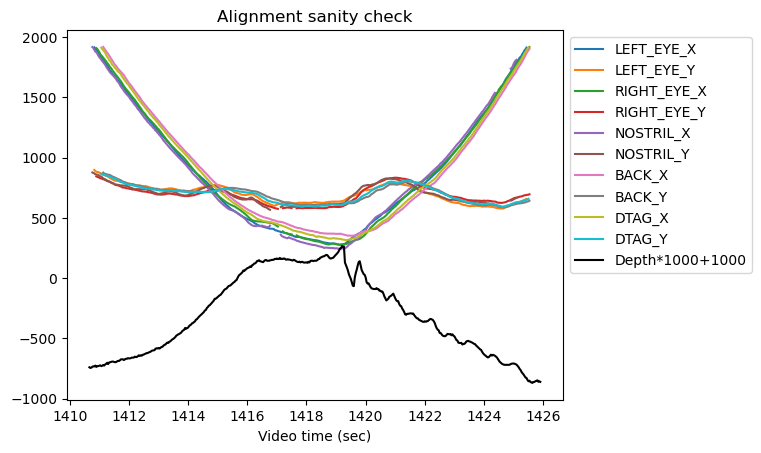

Save xypressure data to: 20190626_s3_t8_GP011471_xypressure.csv



---------------------------------------------------------
20190626_s3_t9, video: GP011471.MP4


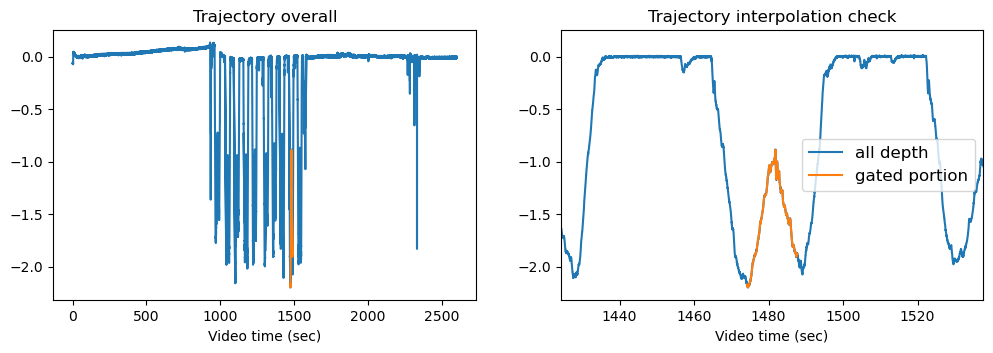

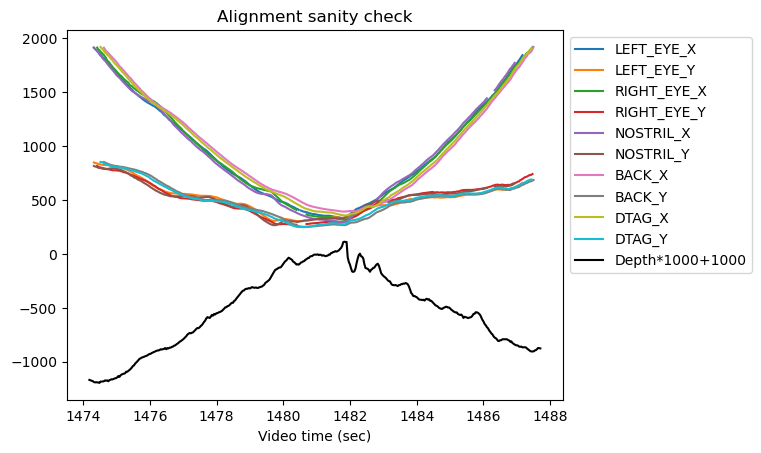

Save xypressure data to: 20190626_s3_t9_GP011471_xypressure.csv



---------------------------------------------------------
20190626_s3_t10, video: GP011471.MP4


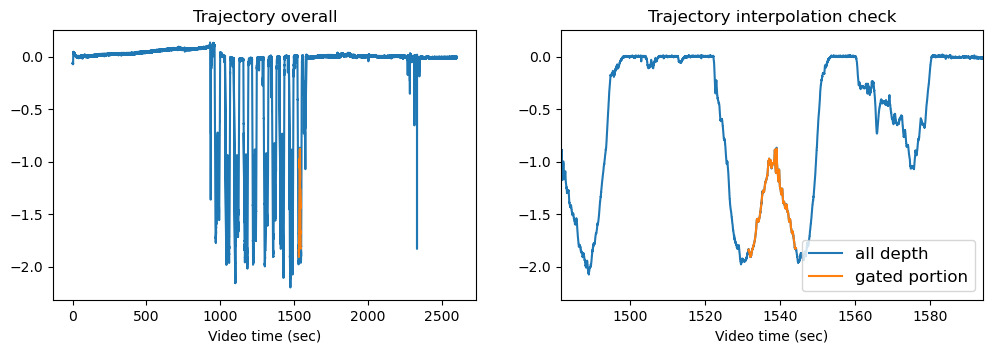

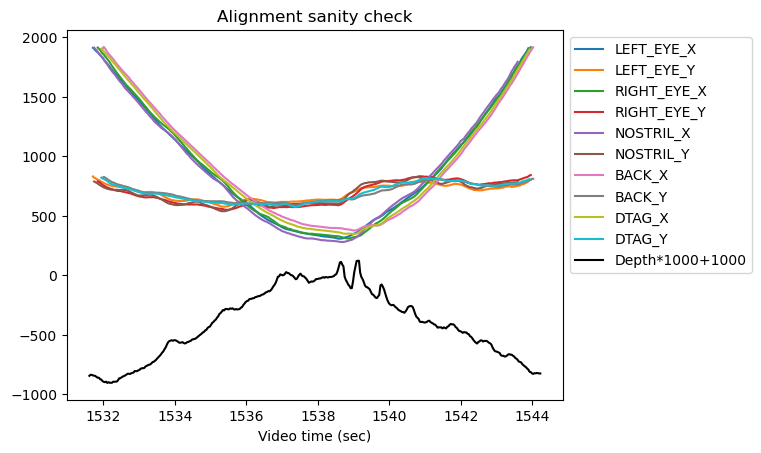

Save xypressure data to: 20190626_s3_t10_GP011471_xypressure.csv



---------------------------------------------------------
20190627_s1_t1, video: GOPR1472.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190627_s1_t2, video: GOPR1472.MP4


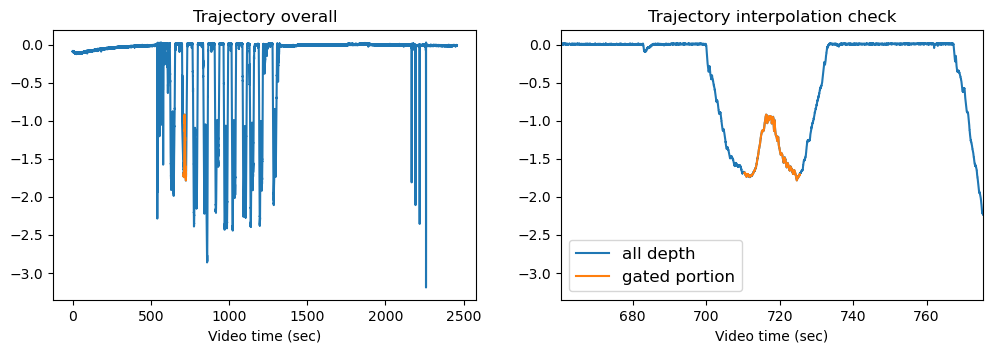

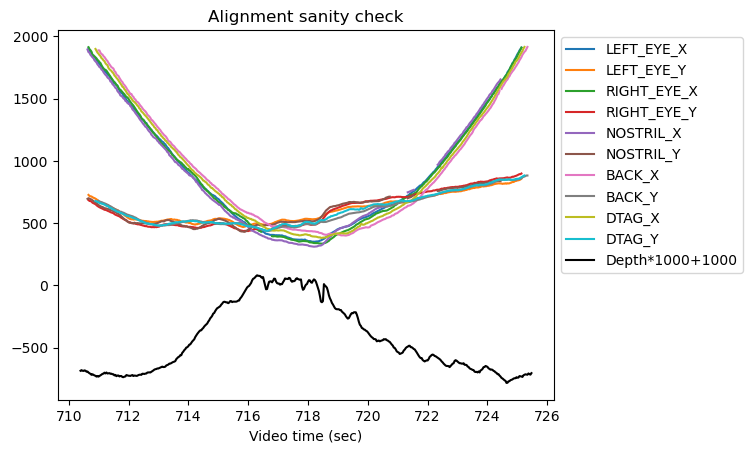

Save xypressure data to: 20190627_s1_t2_GOPR1472_xypressure.csv



---------------------------------------------------------
20190627_s1_t3, video: GOPR1472.MP4


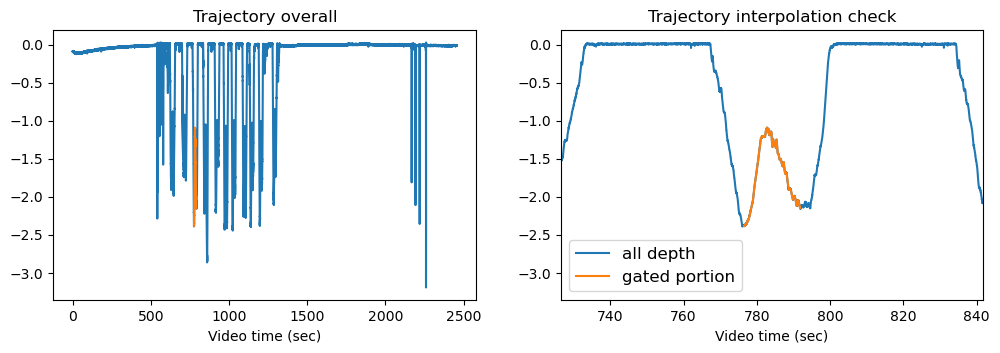

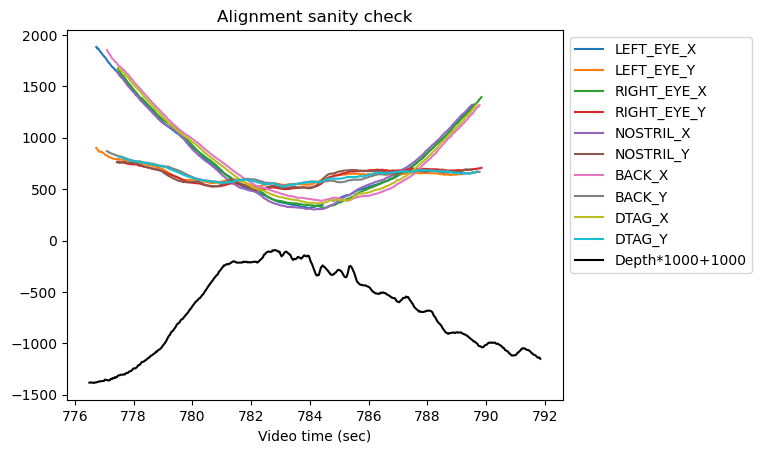

Save xypressure data to: 20190627_s1_t3_GOPR1472_xypressure.csv



---------------------------------------------------------
20190627_s1_t4, video: GOPR1472.MP4


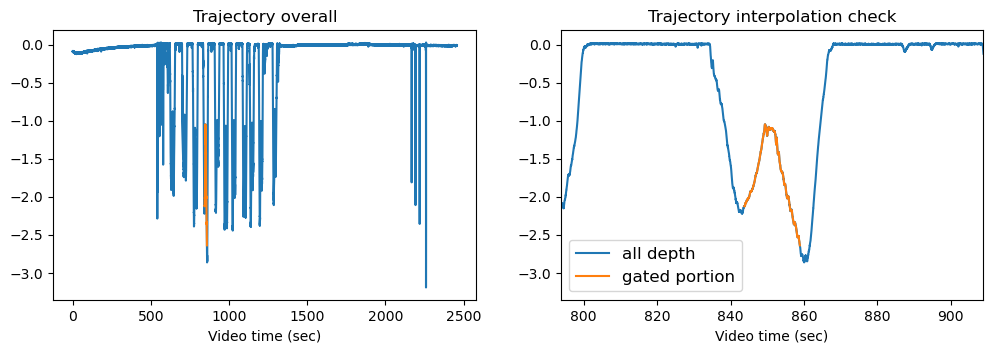

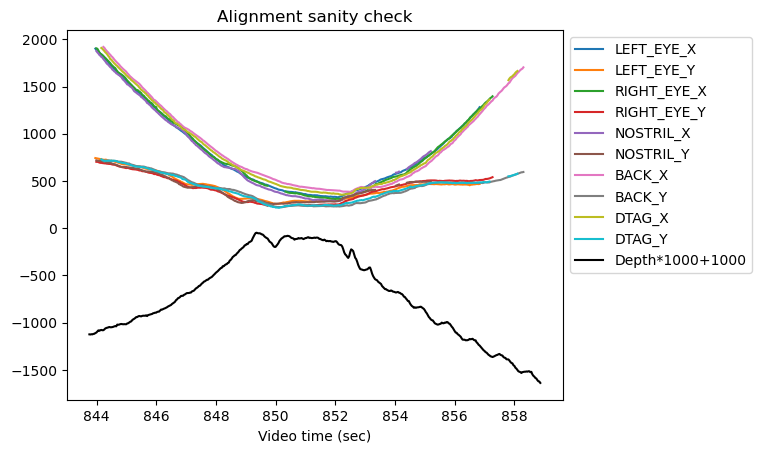

Save xypressure data to: 20190627_s1_t4_GOPR1472_xypressure.csv



---------------------------------------------------------
20190627_s1_t5, video: GOPR1472.MP4


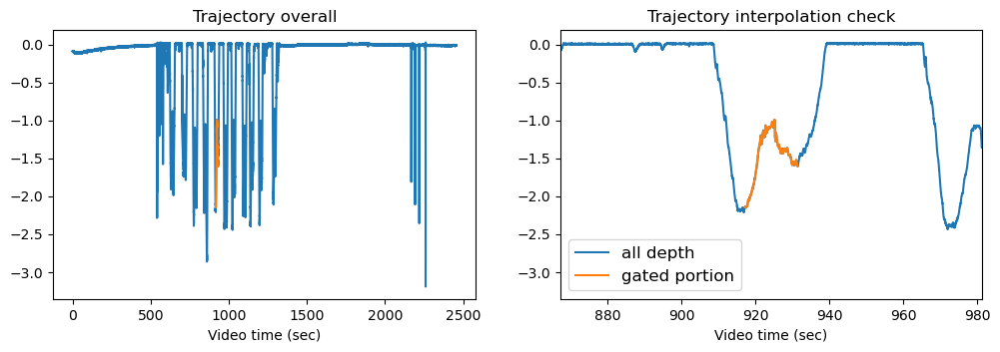

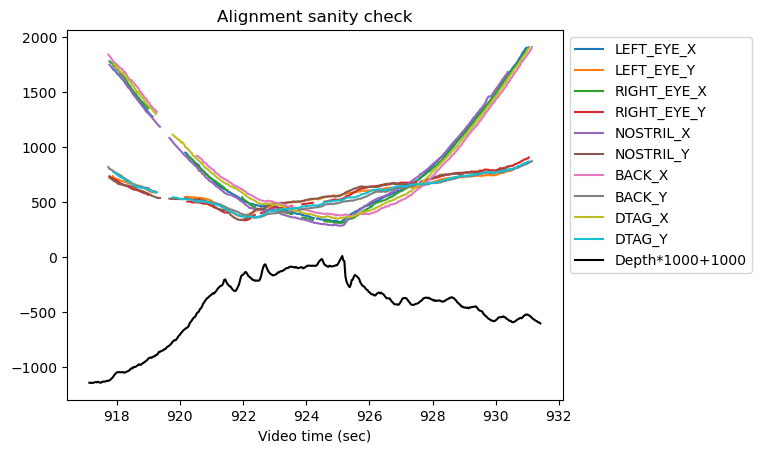

Save xypressure data to: 20190627_s1_t5_GOPR1472_xypressure.csv



---------------------------------------------------------
20190627_s1_t6, video: GOPR1472.MP4


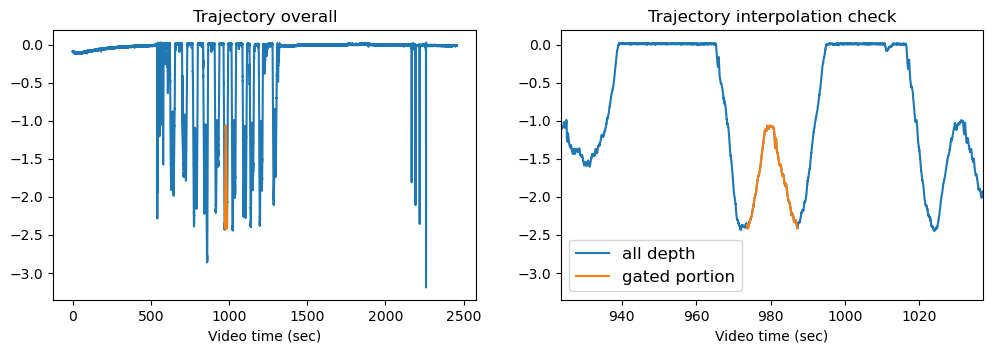

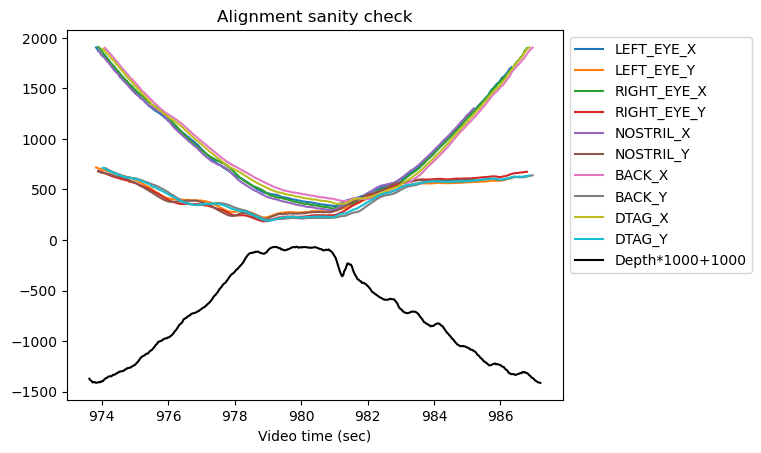

Save xypressure data to: 20190627_s1_t6_GOPR1472_xypressure.csv



---------------------------------------------------------
20190627_s1_t7, video: GOPR1472.MP4


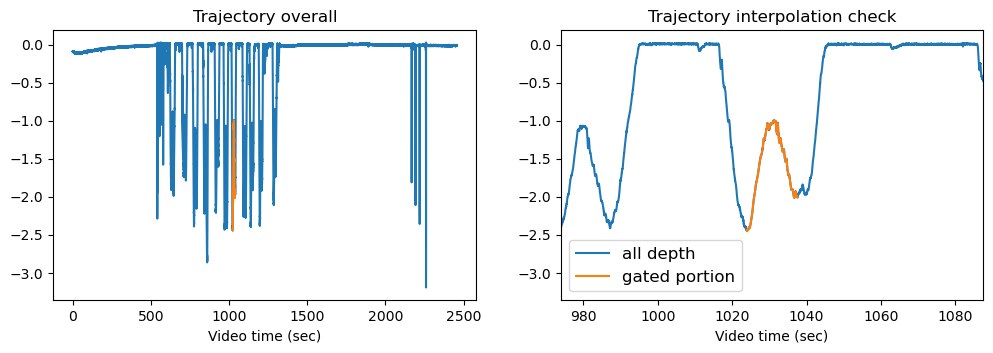

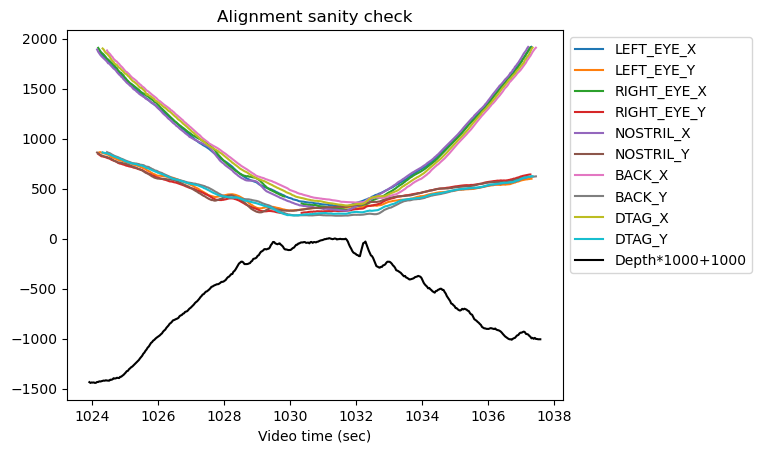

Save xypressure data to: 20190627_s1_t7_GOPR1472_xypressure.csv



---------------------------------------------------------
20190627_s1_t8, video: GOPR1472.MP4 + GP011472.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190627_s1_t9, video: GP011472.MP4


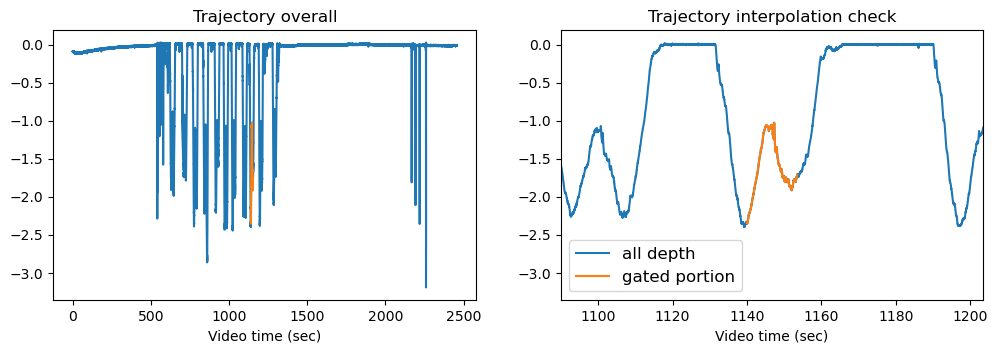

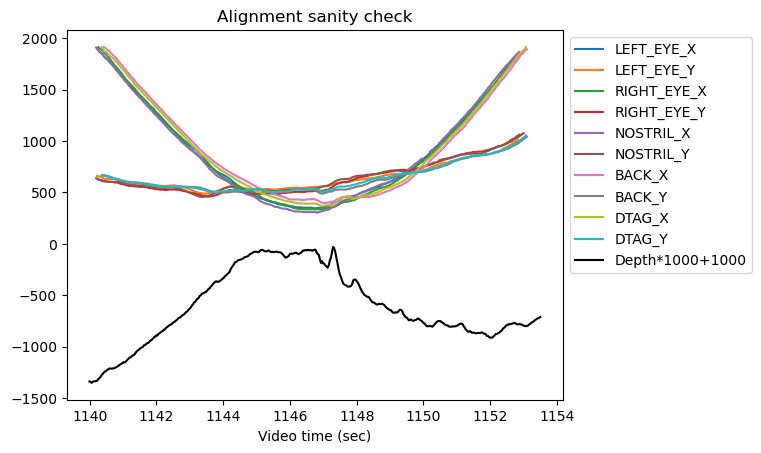

Save xypressure data to: 20190627_s1_t9_GP011472_xypressure.csv



---------------------------------------------------------
20190627_s1_t10, video: GP011472.MP4


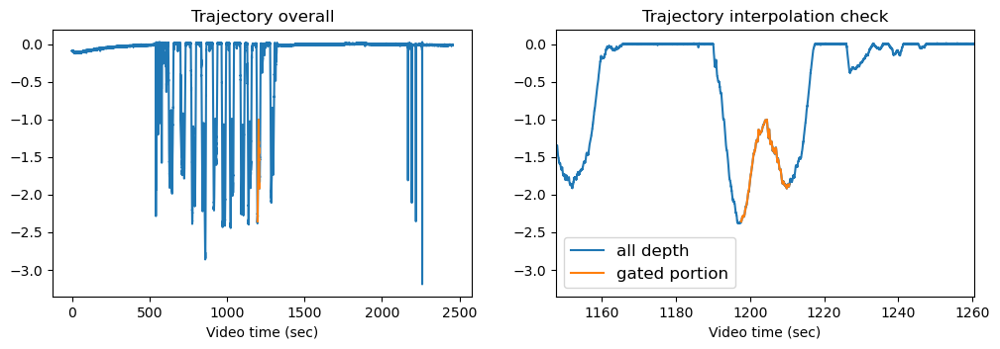

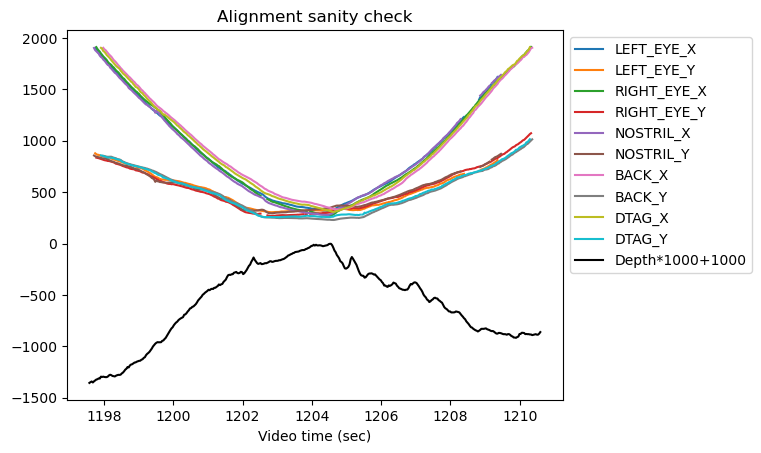

Save xypressure data to: 20190627_s1_t10_GP011472_xypressure.csv



---------------------------------------------------------
20190627_s1_t11, video: GP011472.MP4


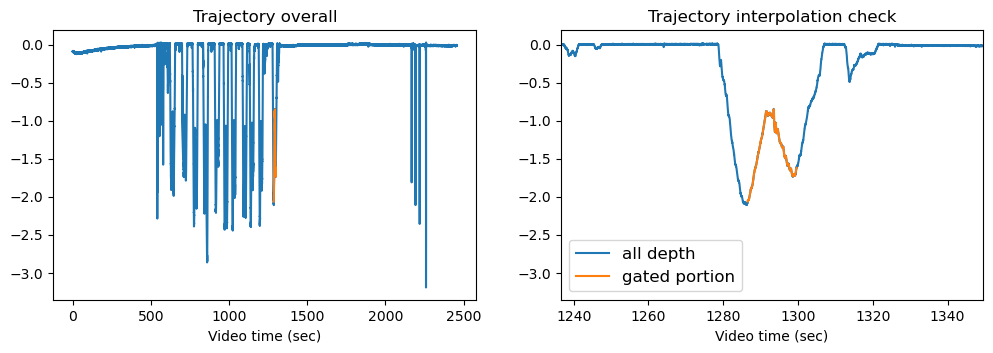

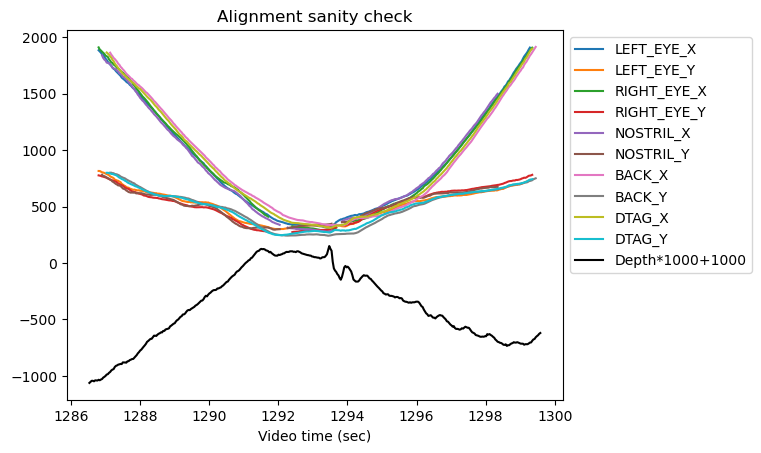

Save xypressure data to: 20190627_s1_t11_GP011472_xypressure.csv



---------------------------------------------------------
20190627_s2_t1, video: GP011473.MP4


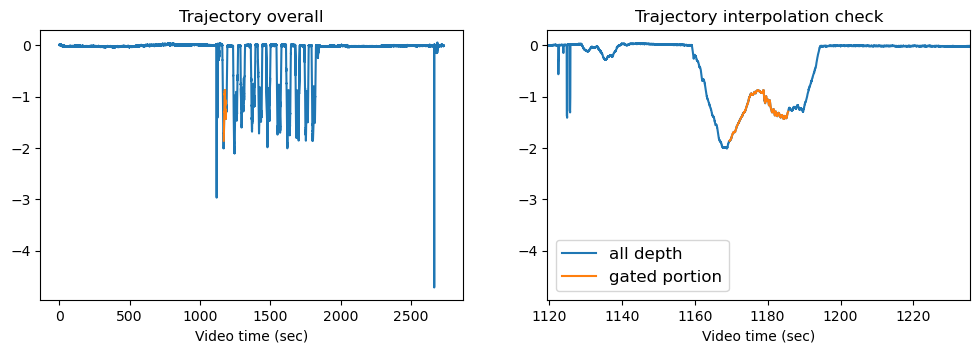

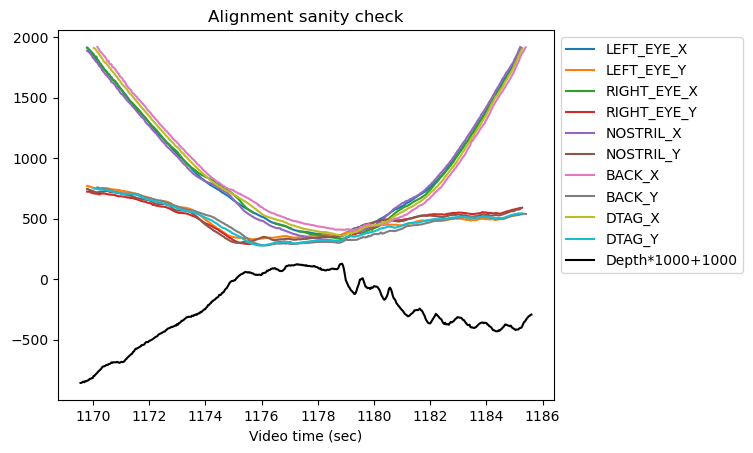

Save xypressure data to: 20190627_s2_t1_GP011473_xypressure.csv



---------------------------------------------------------
20190627_s2_t2, video: GP011473.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190627_s2_t3, video: GP011473.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190627_s2_t4, video: GP011473.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190627_s2_t5, video: GP011473.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190627_s2_t6, video: GP011473.MP4


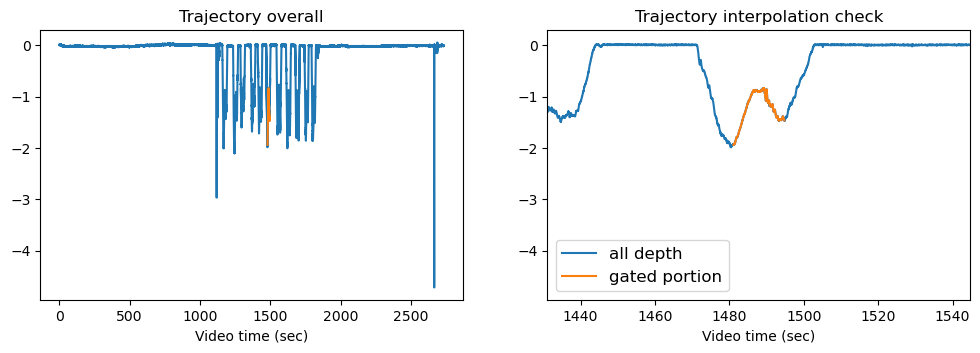

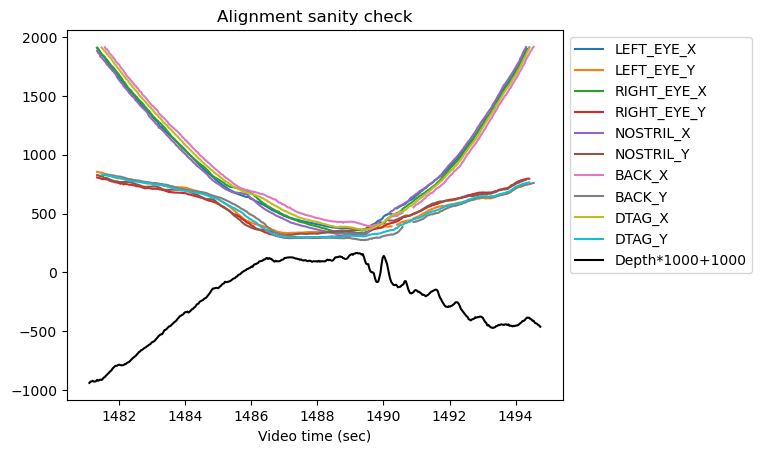

Save xypressure data to: 20190627_s2_t6_GP011473_xypressure.csv



---------------------------------------------------------
20190627_s2_t7, video: GP011473.MP4


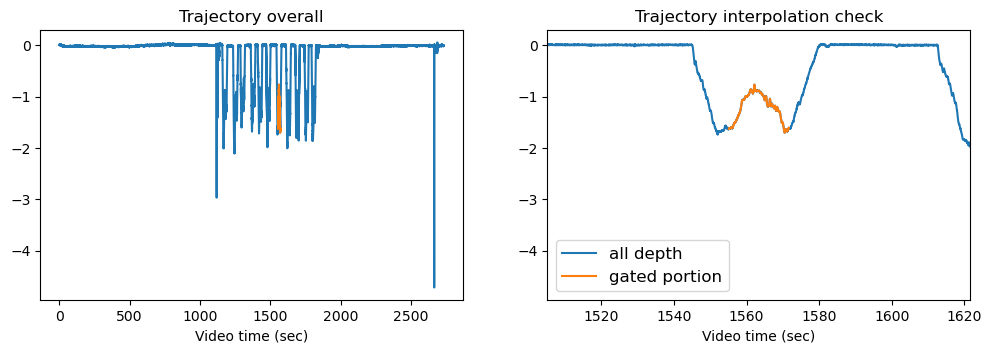

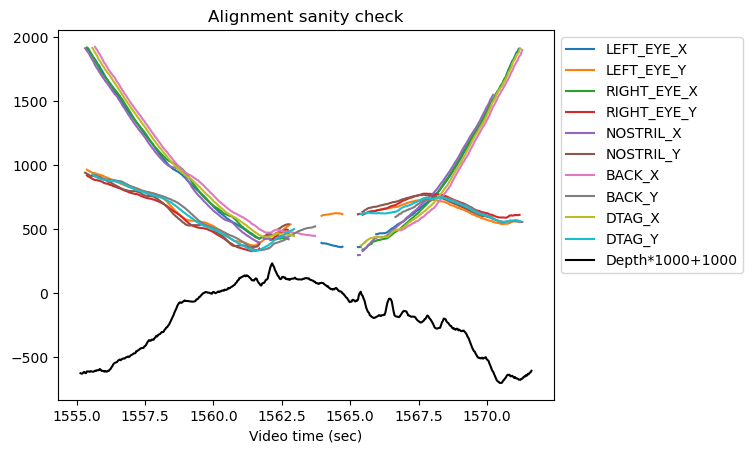

Save xypressure data to: 20190627_s2_t7_GP011473_xypressure.csv



---------------------------------------------------------
20190627_s2_t8, video: GP011473.MP4


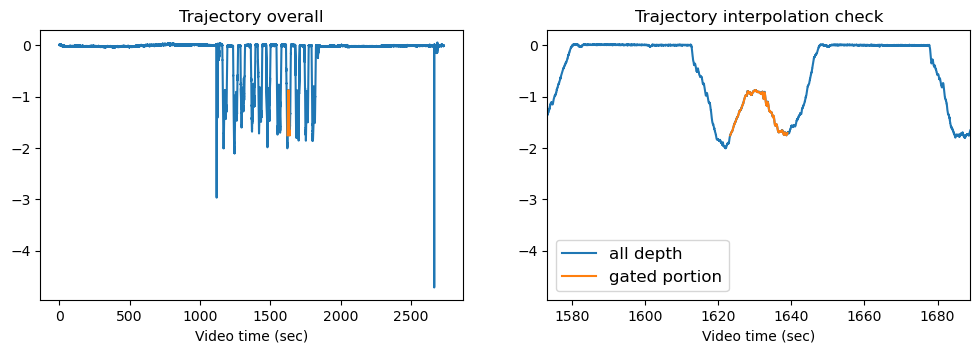

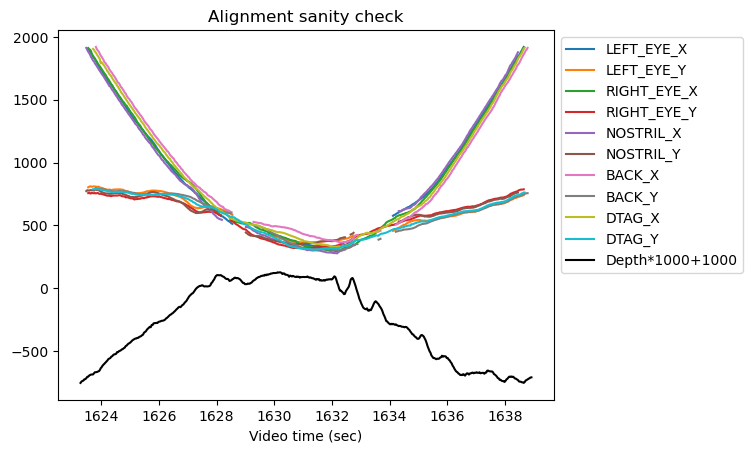

Save xypressure data to: 20190627_s2_t8_GP011473_xypressure.csv



---------------------------------------------------------
20190627_s2_t9, video: GP011473.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190627_s2_t10, video: GP011473.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190627_s2_t11, video: GP011473.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190627_s3_t1, video: GOPR1474.MP4


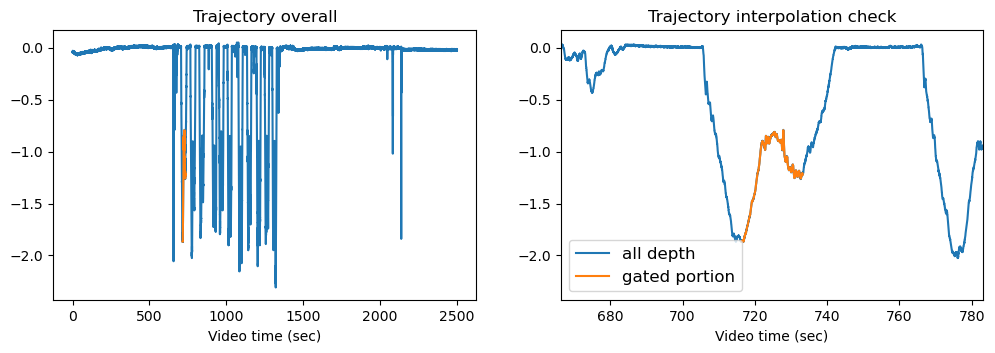

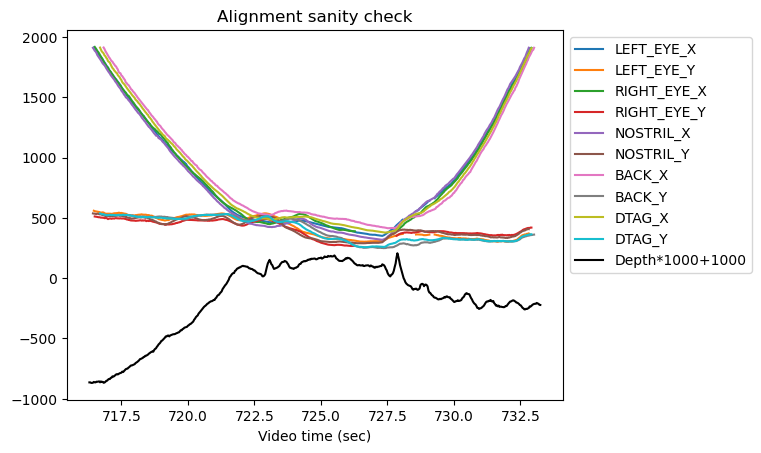

Save xypressure data to: 20190627_s3_t1_GOPR1474_xypressure.csv



---------------------------------------------------------
20190627_s3_t2, video: GOPR1474.MP4


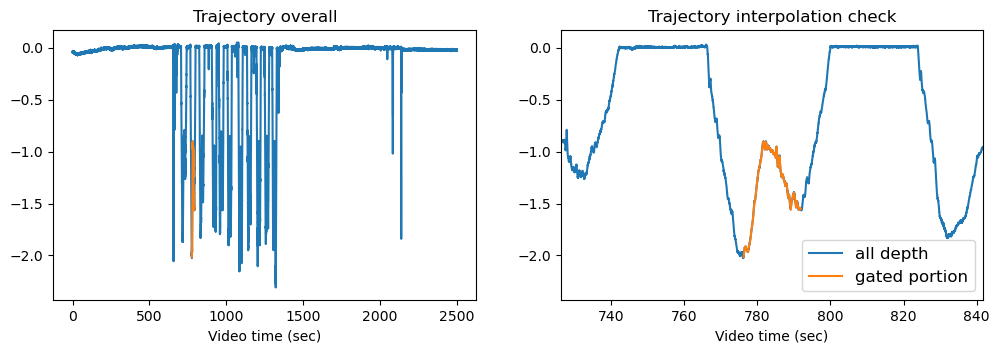

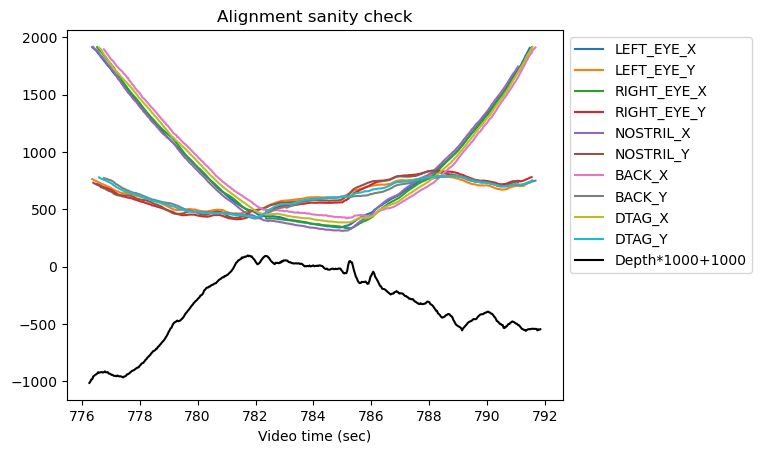

Save xypressure data to: 20190627_s3_t2_GOPR1474_xypressure.csv



---------------------------------------------------------
20190627_s3_t3, video: GOPR1474.MP4


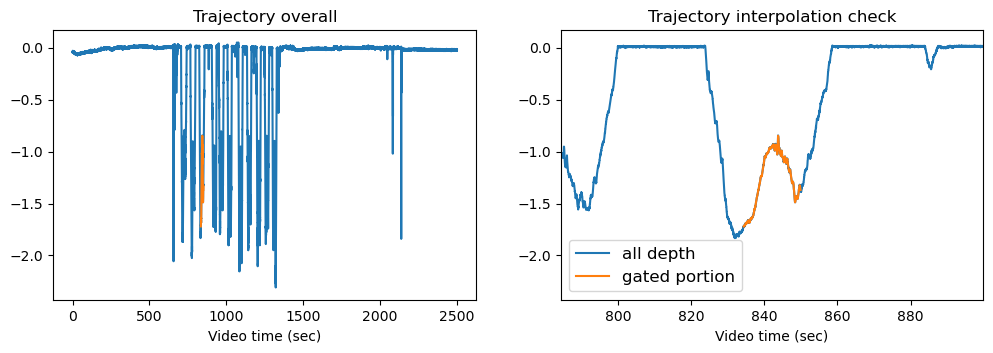

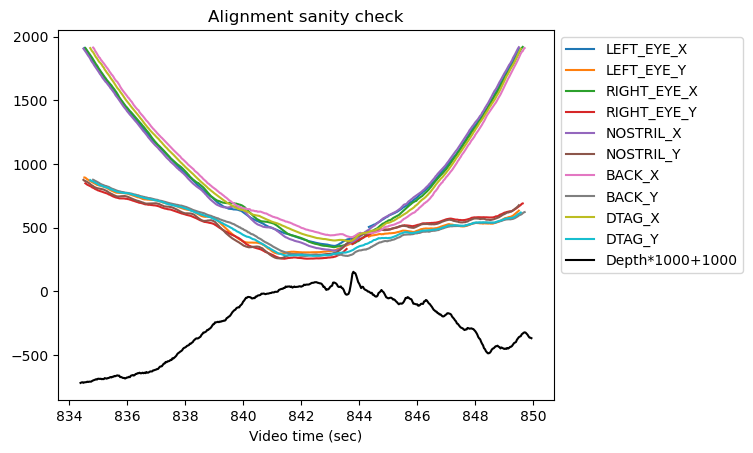

Save xypressure data to: 20190627_s3_t3_GOPR1474_xypressure.csv



---------------------------------------------------------
20190627_s3_t4, video: GOPR1474.MP4


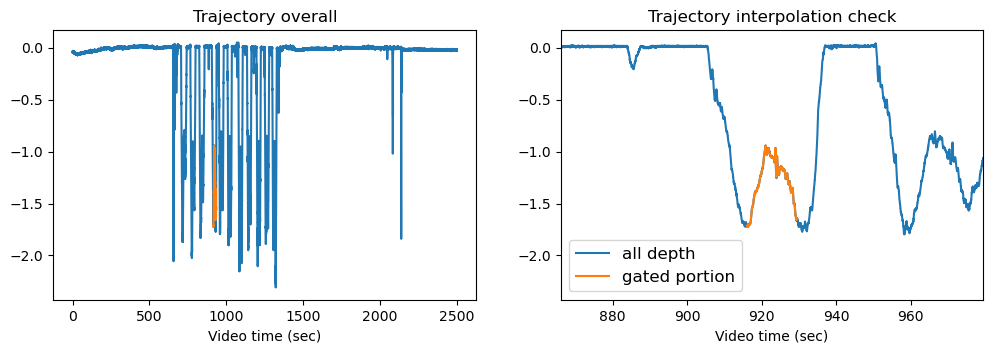

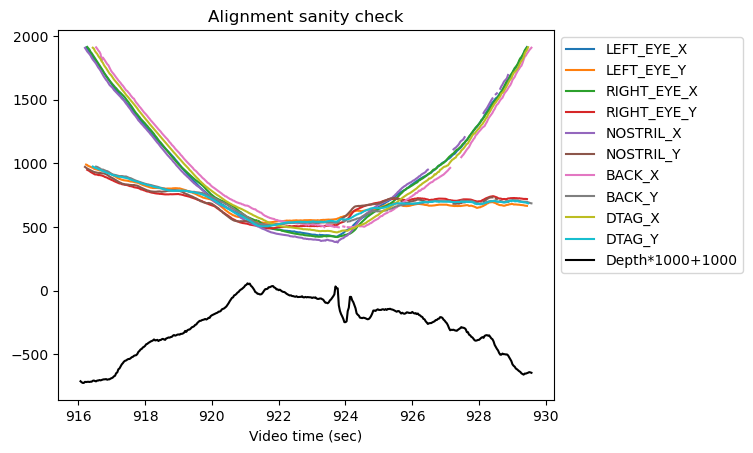

Save xypressure data to: 20190627_s3_t4_GOPR1474_xypressure.csv



---------------------------------------------------------
20190627_s3_t5, video: GOPR1474.MP4


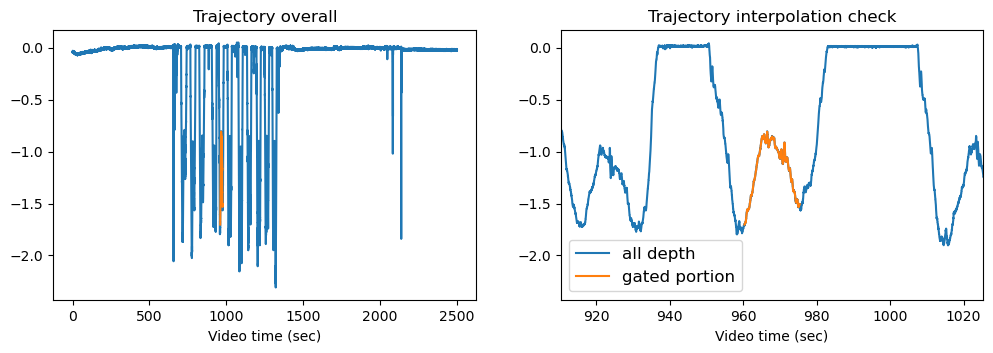

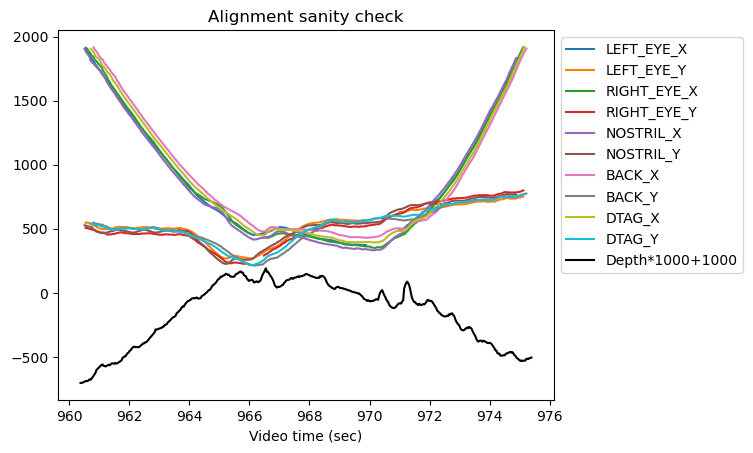

Save xypressure data to: 20190627_s3_t5_GOPR1474_xypressure.csv



---------------------------------------------------------
20190627_s3_t6, video: GOPR1474.MP4


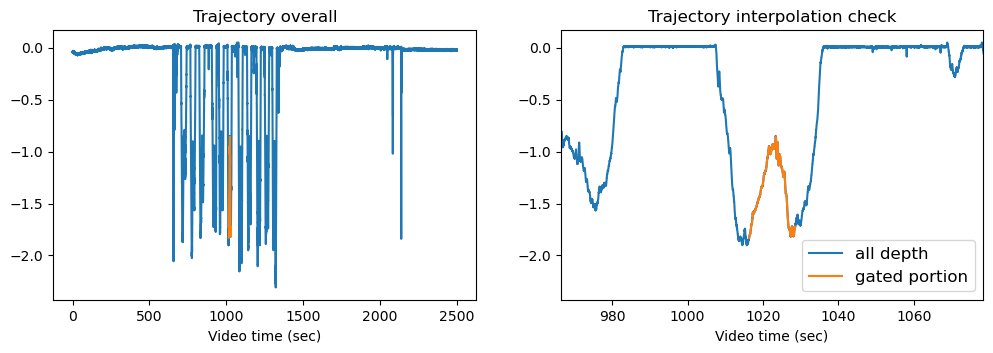

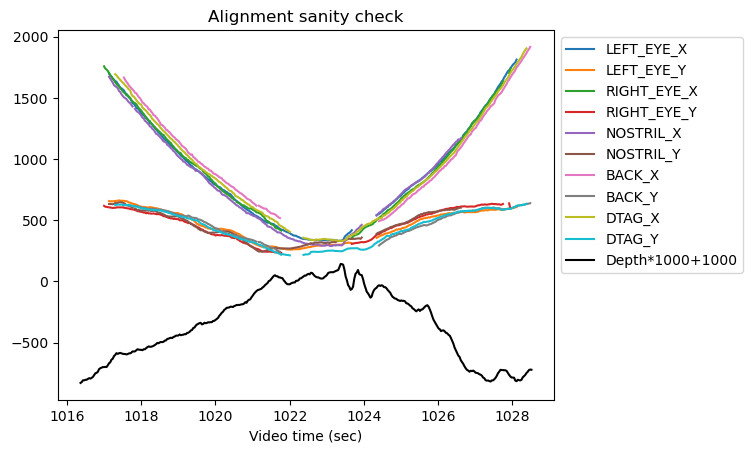

Save xypressure data to: 20190627_s3_t6_GOPR1474_xypressure.csv



---------------------------------------------------------
20190627_s3_t7, video: GP011474.MP4


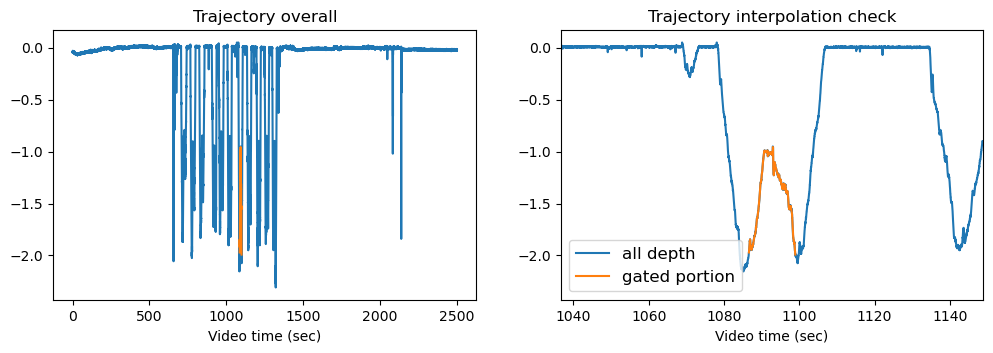

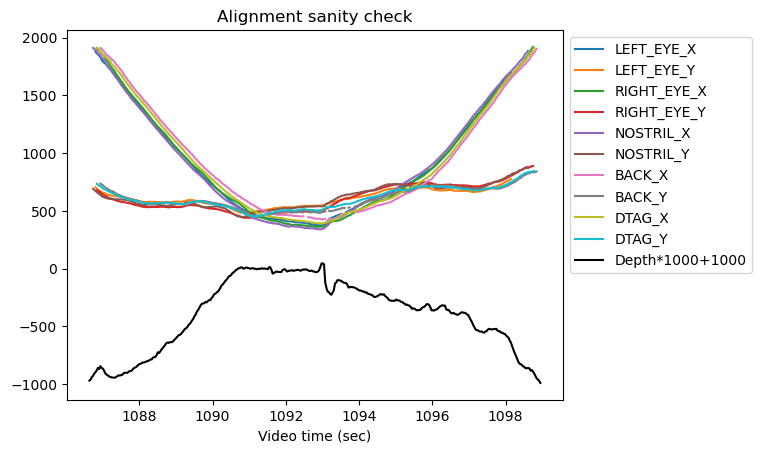

Save xypressure data to: 20190627_s3_t7_GP011474_xypressure.csv



---------------------------------------------------------
20190627_s3_t8, video: GP011474.MP4


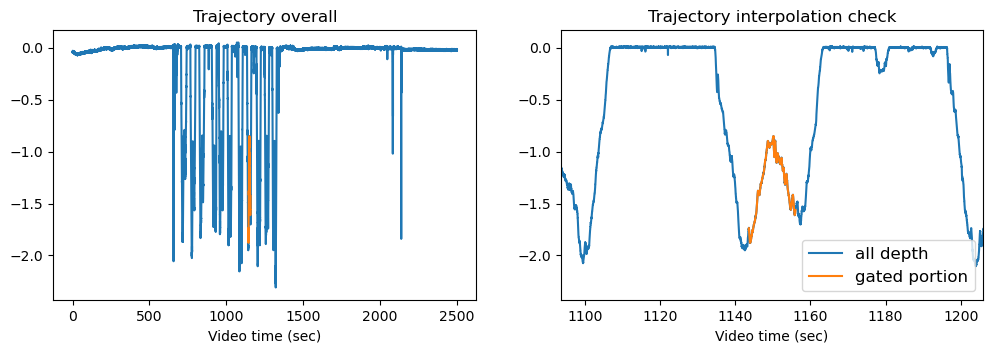

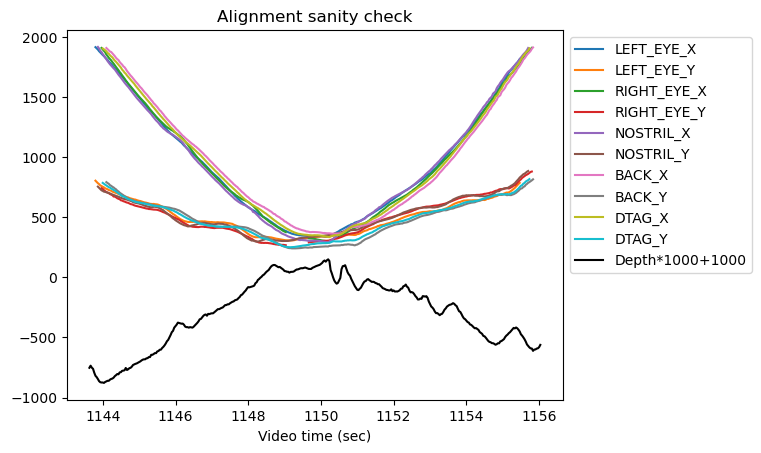

Save xypressure data to: 20190627_s3_t8_GP011474_xypressure.csv



---------------------------------------------------------
20190627_s3_t9, video: GP011474.MP4


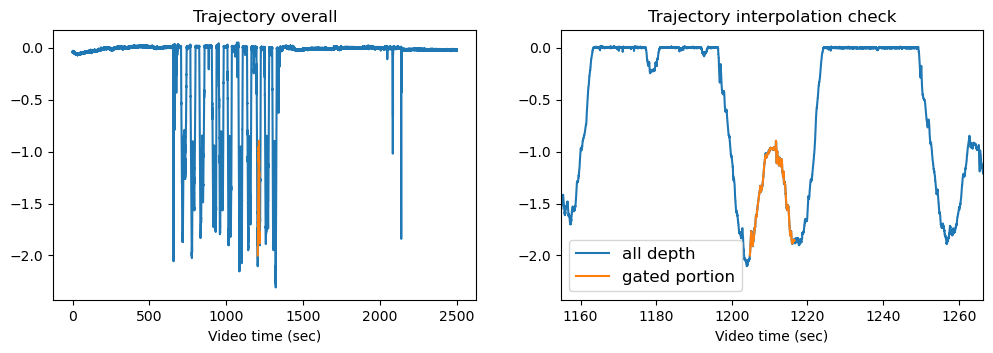

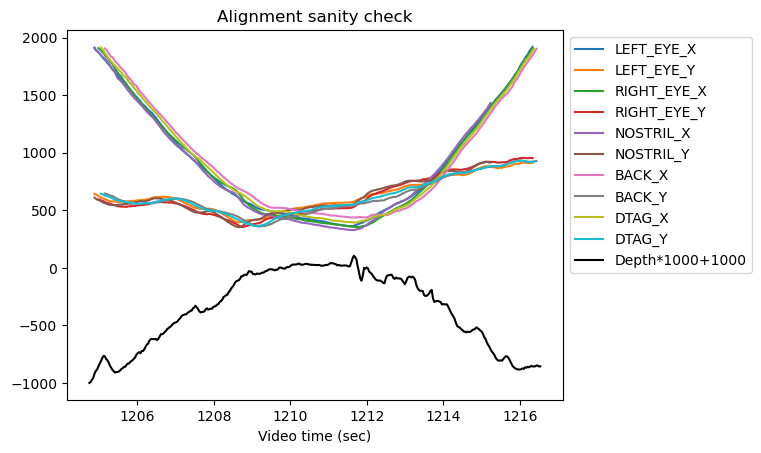

Save xypressure data to: 20190627_s3_t9_GP011474_xypressure.csv



---------------------------------------------------------
20190627_s3_t10, video: GP011474.MP4


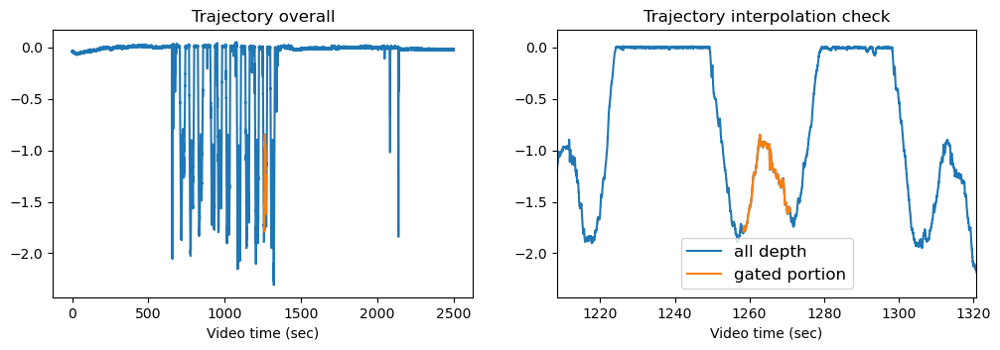

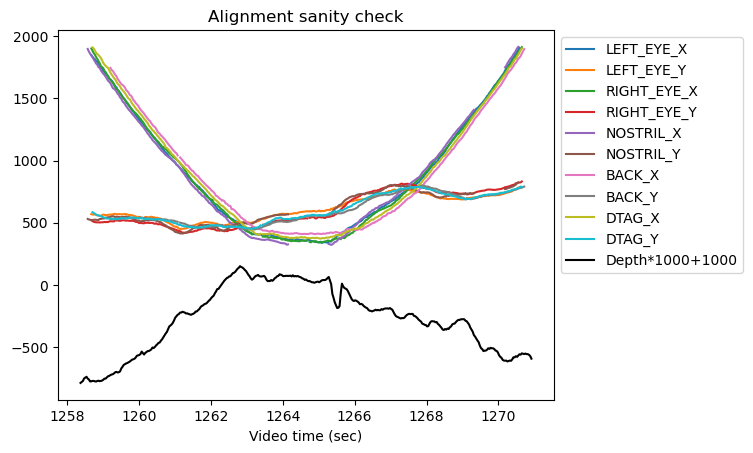

Save xypressure data to: 20190627_s3_t10_GP011474_xypressure.csv



---------------------------------------------------------
20190627_s3_t11, video: GP011474.MP4


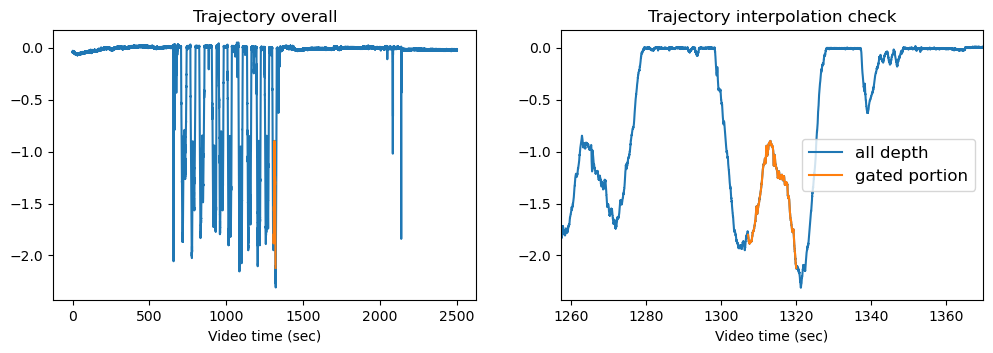

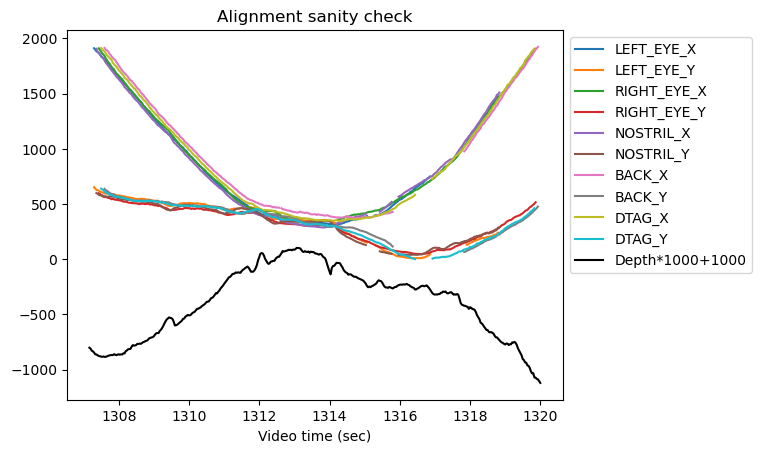

Save xypressure data to: 20190627_s3_t11_GP011474_xypressure.csv



---------------------------------------------------------
20190628_s1_t1, video: GOPR1475.MP4


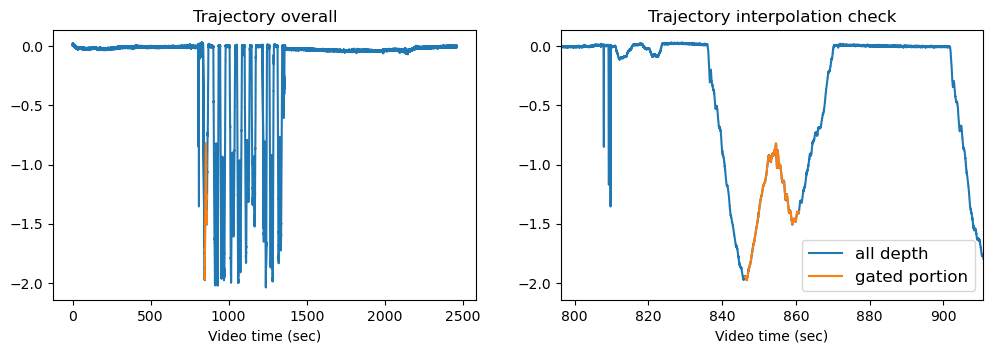

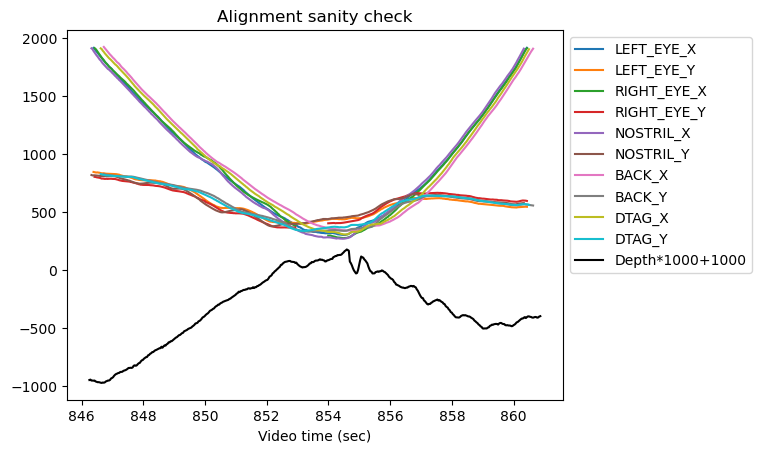

Save xypressure data to: 20190628_s1_t1_GOPR1475_xypressure.csv



---------------------------------------------------------
20190628_s1_t2, video: GOPR1475.MP4


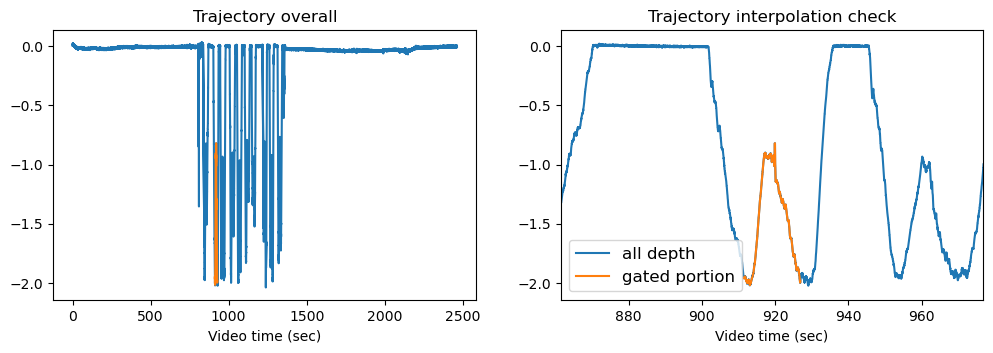

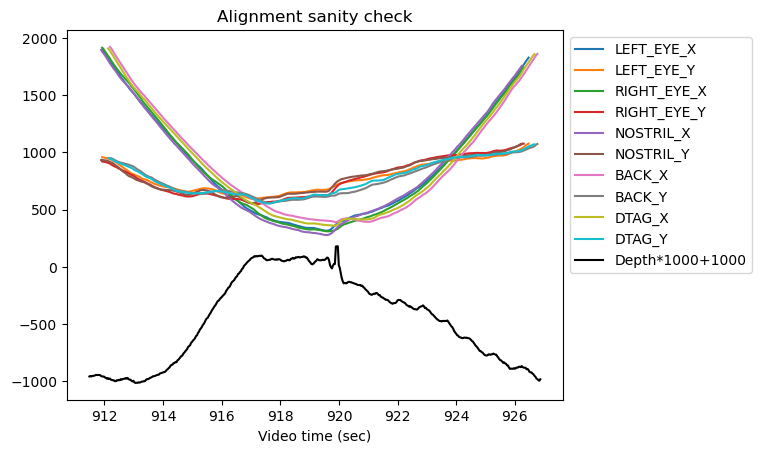

Save xypressure data to: 20190628_s1_t2_GOPR1475_xypressure.csv



---------------------------------------------------------
20190628_s1_t3, video: GOPR1475.MP4


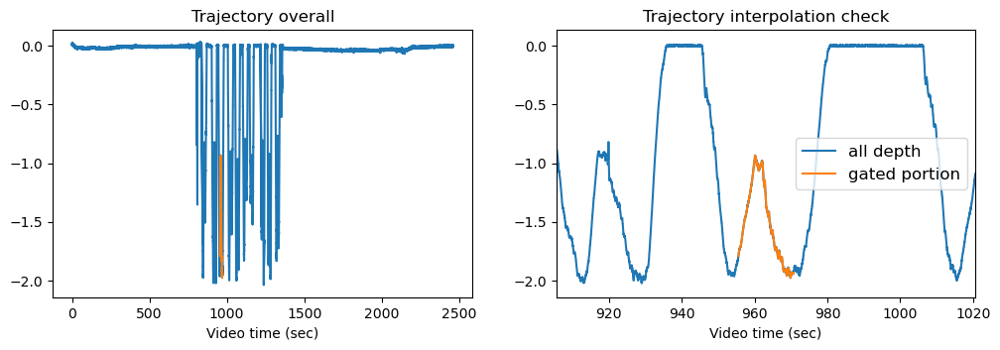

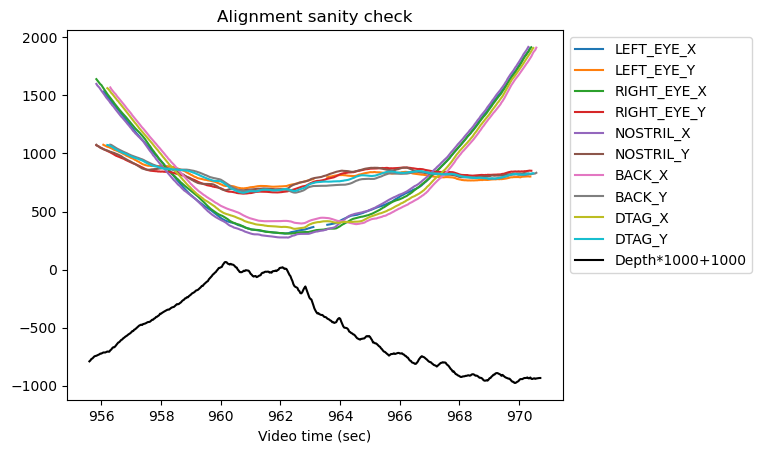

Save xypressure data to: 20190628_s1_t3_GOPR1475_xypressure.csv



---------------------------------------------------------
20190628_s1_t4, video: GOPR1475.MP4


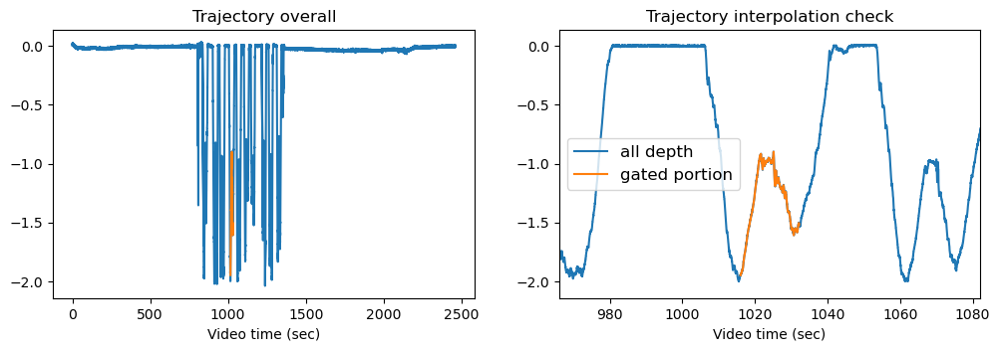

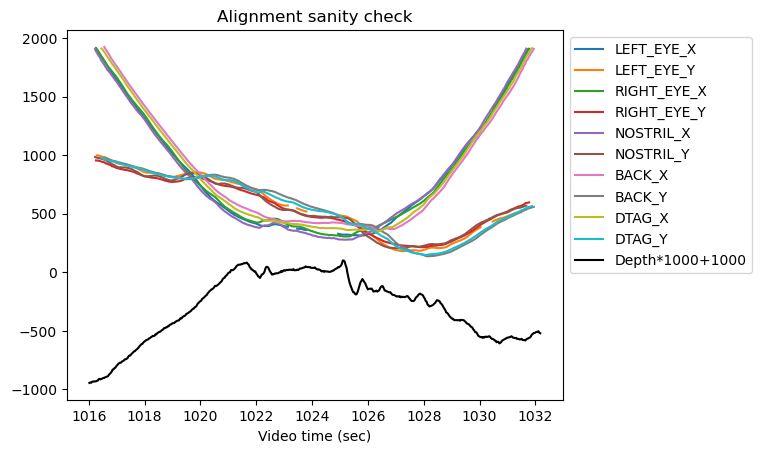

Save xypressure data to: 20190628_s1_t4_GOPR1475_xypressure.csv



---------------------------------------------------------
20190628_s1_t5, video: GOPR1475.MP4 + GP011475.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190628_s1_t6, video: GP011475.MP4


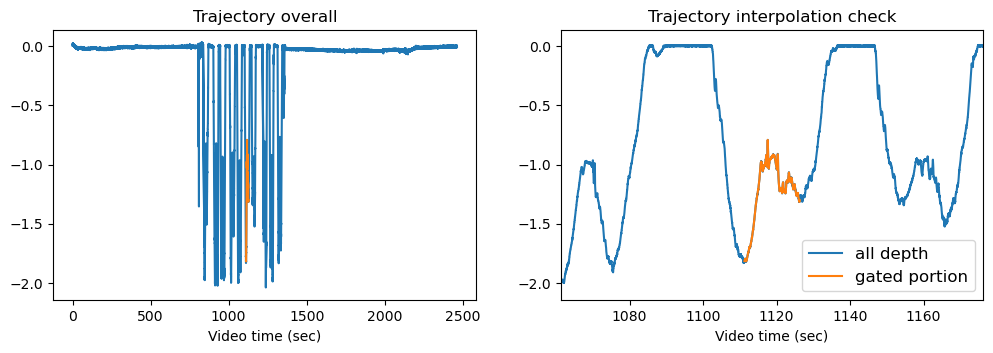

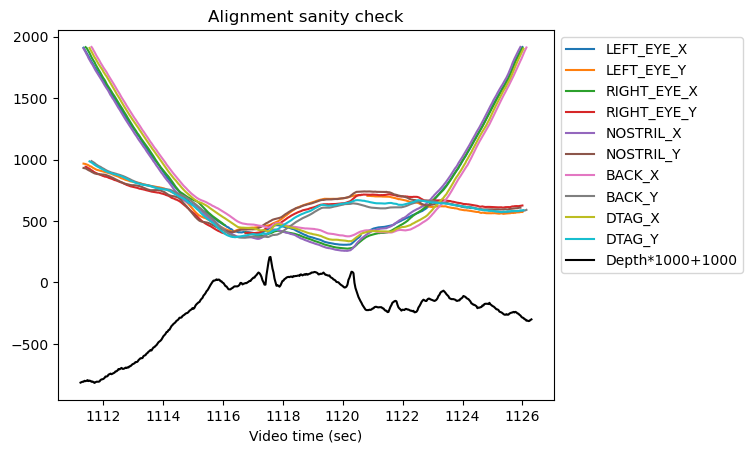

Save xypressure data to: 20190628_s1_t6_GP011475_xypressure.csv



---------------------------------------------------------
20190628_s1_t7, video: GP011475.MP4


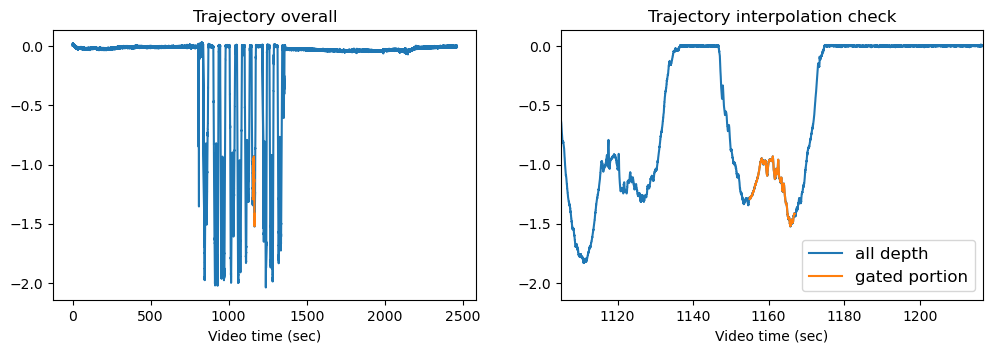

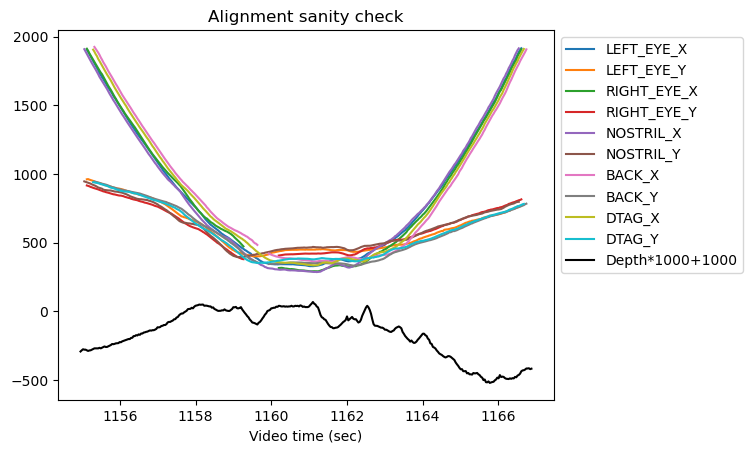

Save xypressure data to: 20190628_s1_t7_GP011475_xypressure.csv



---------------------------------------------------------
20190628_s1_t8, video: GP011475.MP4


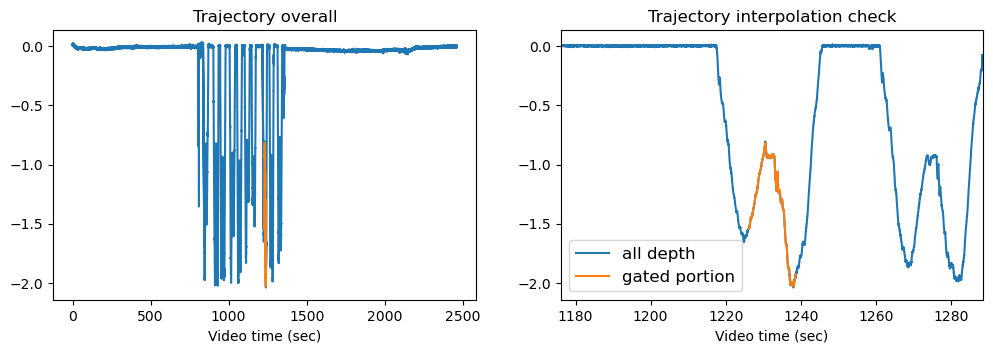

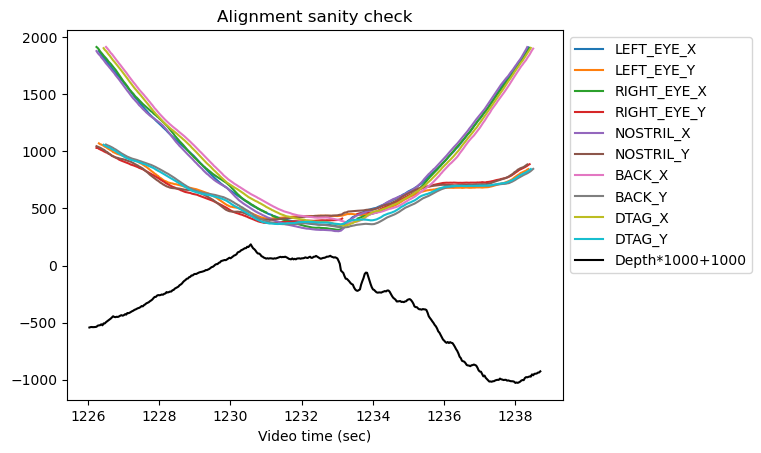

Save xypressure data to: 20190628_s1_t8_GP011475_xypressure.csv



---------------------------------------------------------
20190628_s1_t9, video: GP011475.MP4


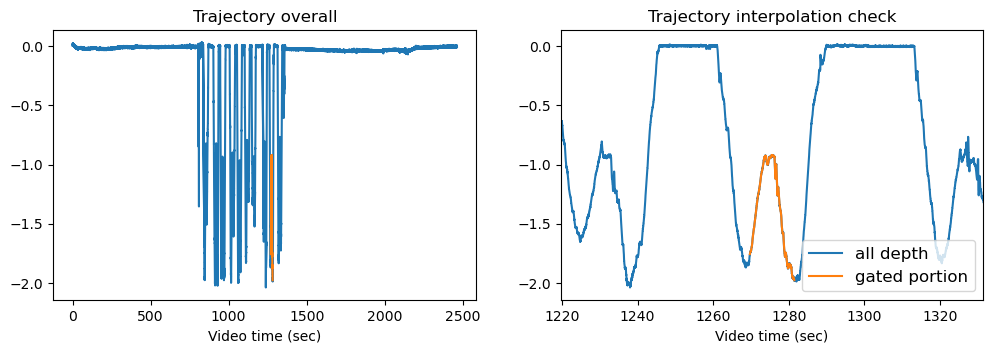

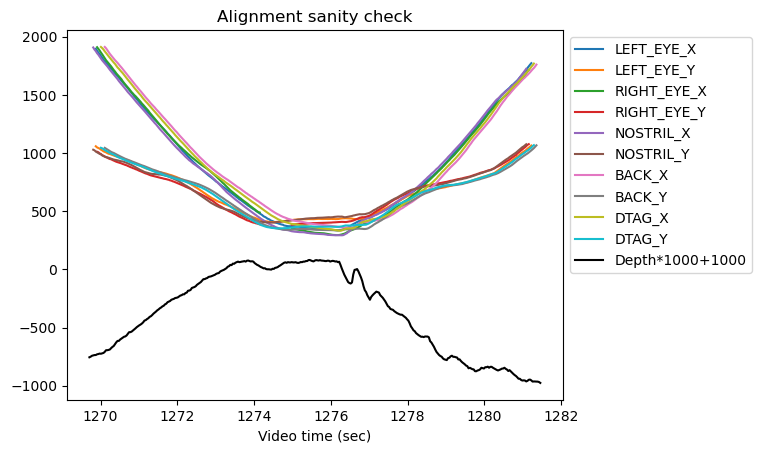

Save xypressure data to: 20190628_s1_t9_GP011475_xypressure.csv



---------------------------------------------------------
20190628_s1_t10, video: GP011475.MP4


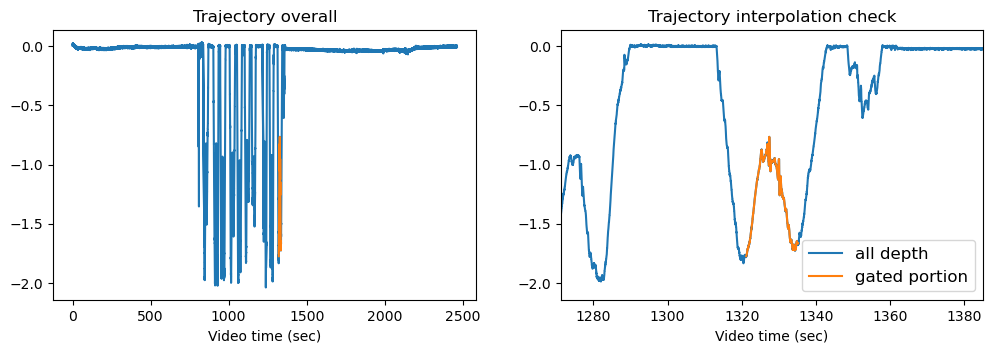

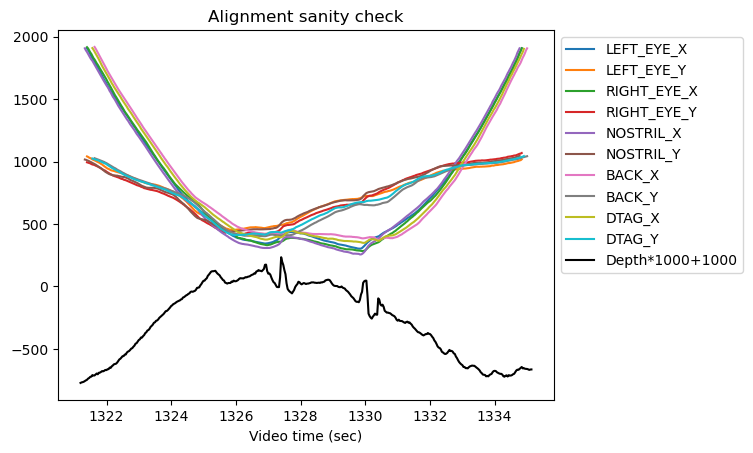

Save xypressure data to: 20190628_s1_t10_GP011475_xypressure.csv



---------------------------------------------------------
20190628_s2_t1, video: GOPR1476.MP4


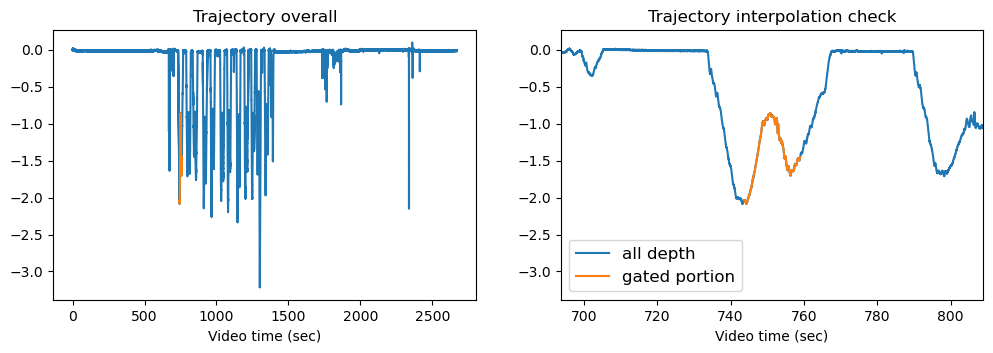

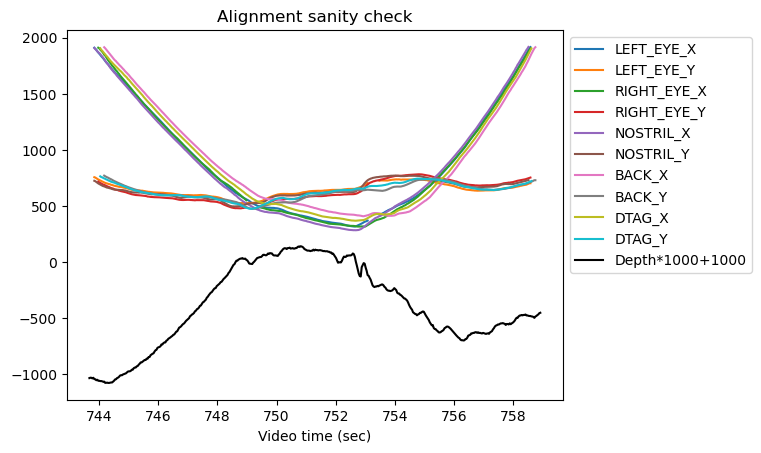

Save xypressure data to: 20190628_s2_t1_GOPR1476_xypressure.csv



---------------------------------------------------------
20190628_s2_t2, video: GOPR1476.MP4


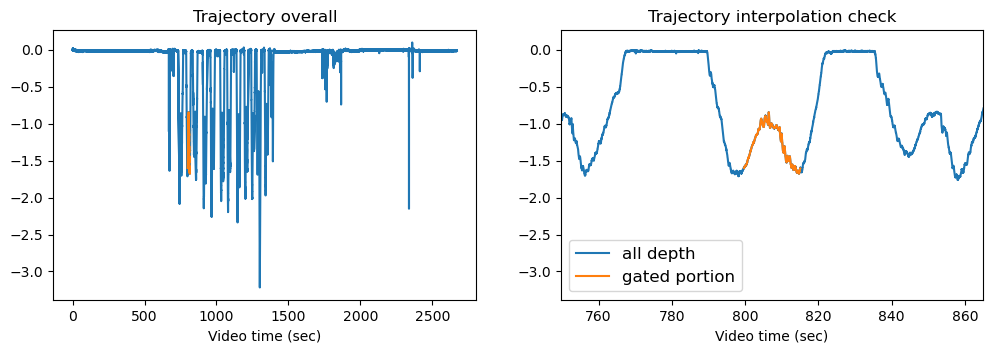

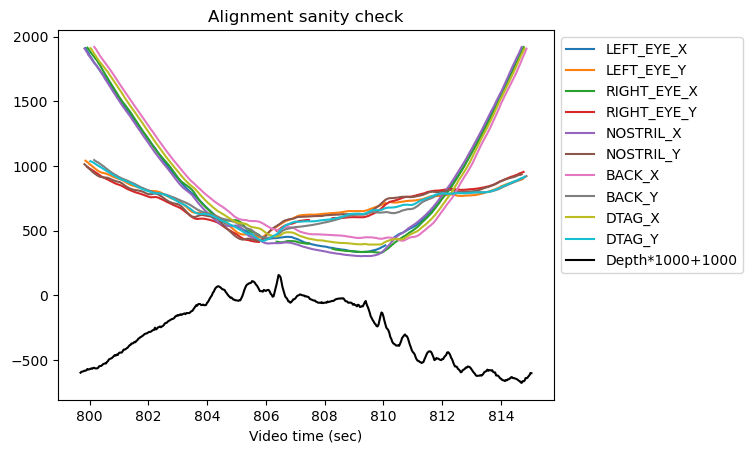

Save xypressure data to: 20190628_s2_t2_GOPR1476_xypressure.csv



---------------------------------------------------------
20190628_s2_t3, video: GOPR1476.MP4


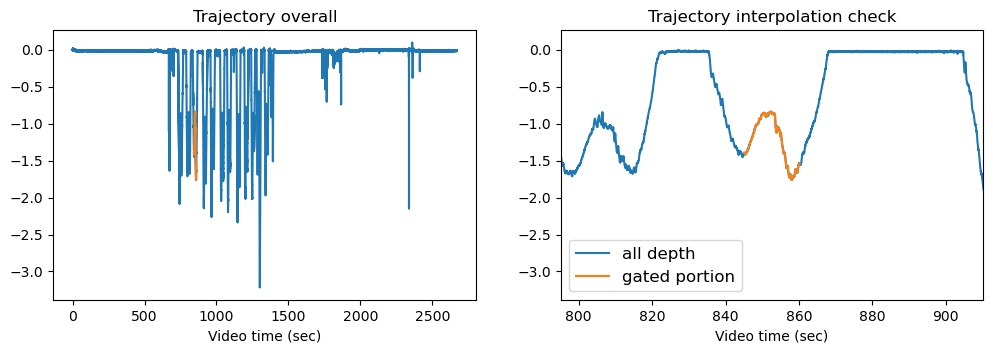

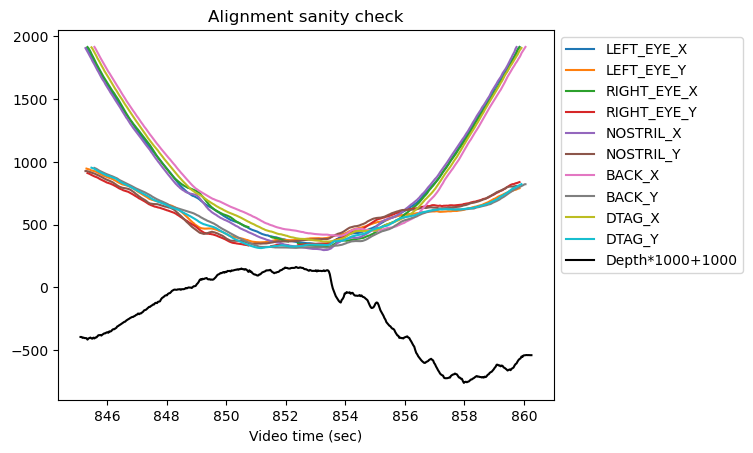

Save xypressure data to: 20190628_s2_t3_GOPR1476_xypressure.csv



---------------------------------------------------------
20190628_s2_t4, video: GOPR1476.MP4


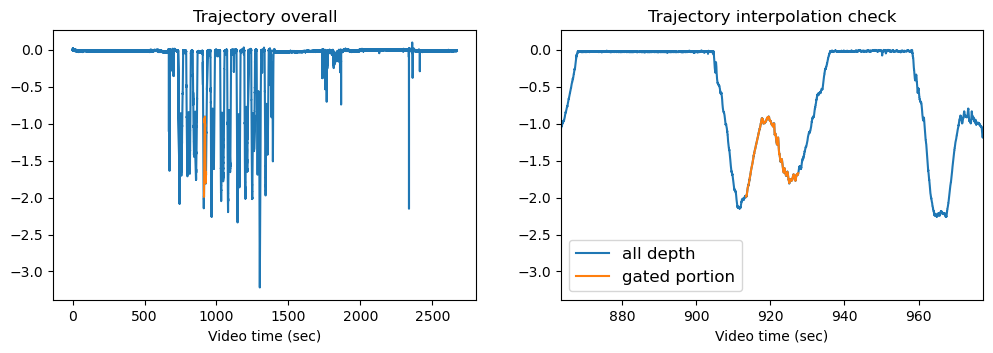

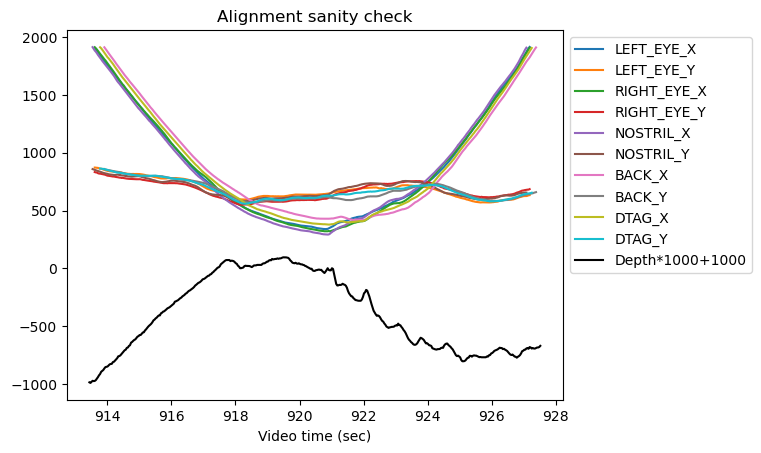

Save xypressure data to: 20190628_s2_t4_GOPR1476_xypressure.csv



---------------------------------------------------------
20190628_s2_t5, video: GOPR1476.MP4


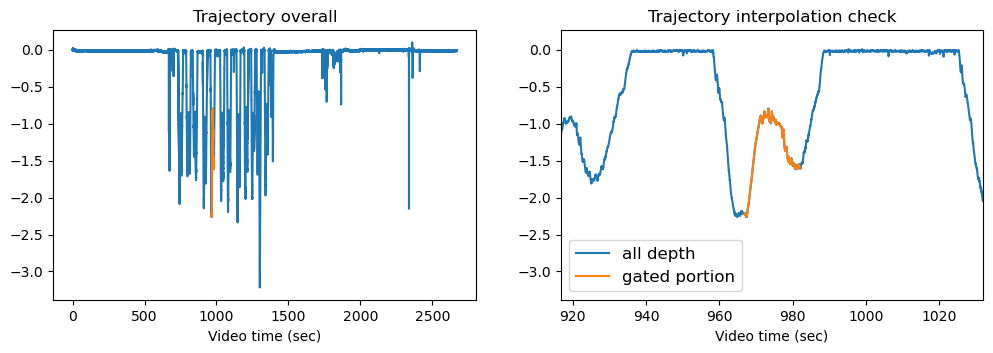

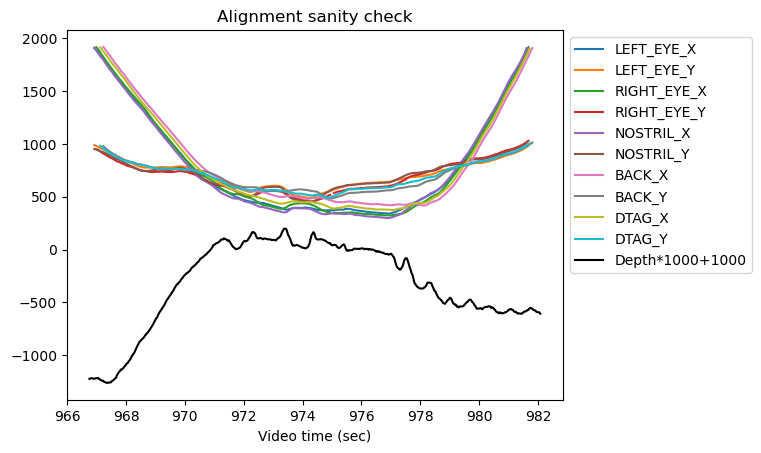

Save xypressure data to: 20190628_s2_t5_GOPR1476_xypressure.csv



---------------------------------------------------------
20190628_s2_t6, video: GOPR1476.MP4


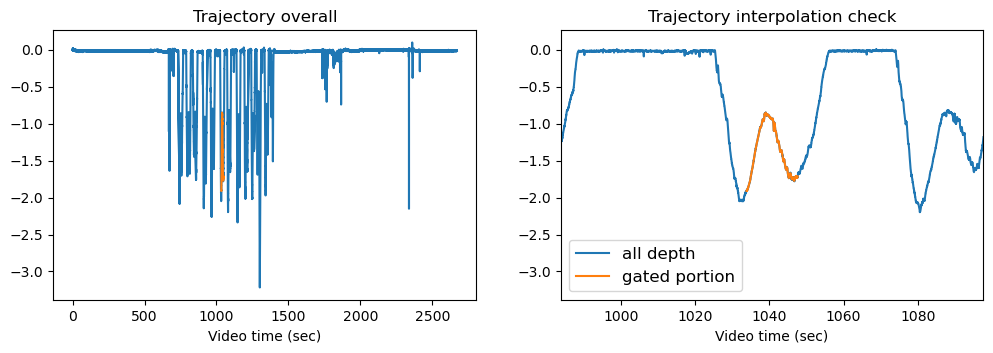

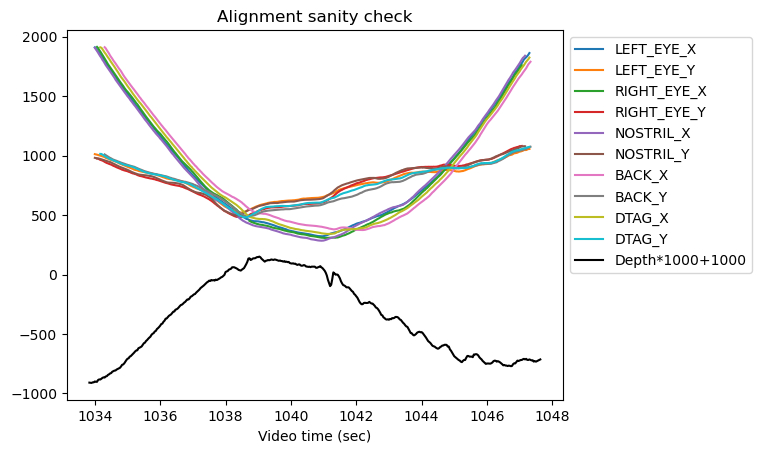

Save xypressure data to: 20190628_s2_t6_GOPR1476_xypressure.csv



---------------------------------------------------------
20190628_s2_t7, video: GP011476.MP4


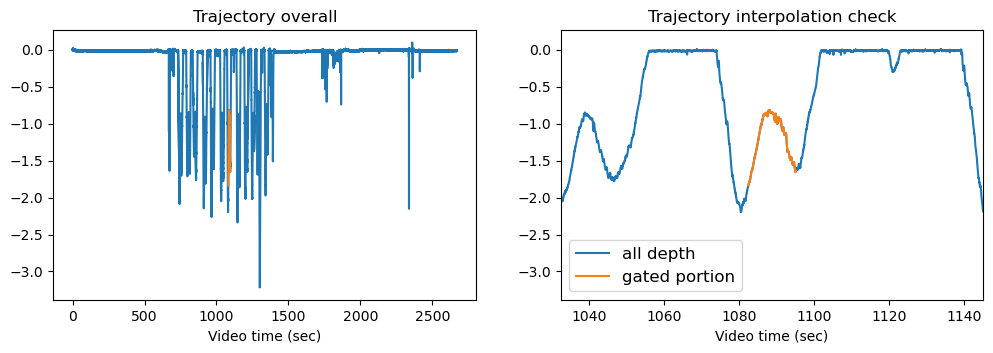

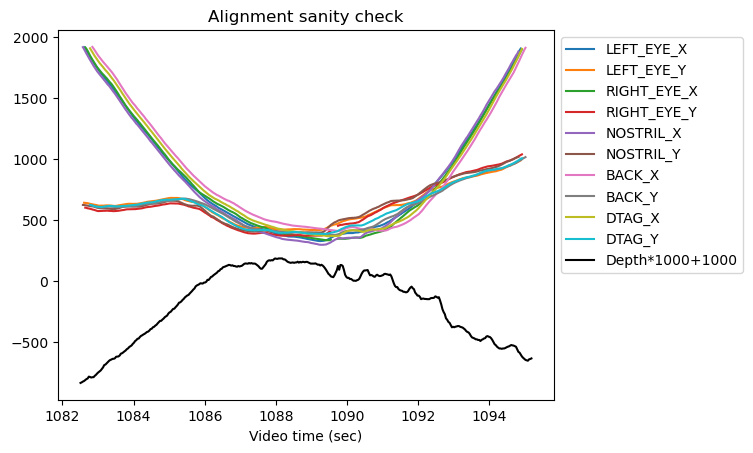

Save xypressure data to: 20190628_s2_t7_GP011476_xypressure.csv



---------------------------------------------------------
20190628_s2_t8, video: GP011476.MP4


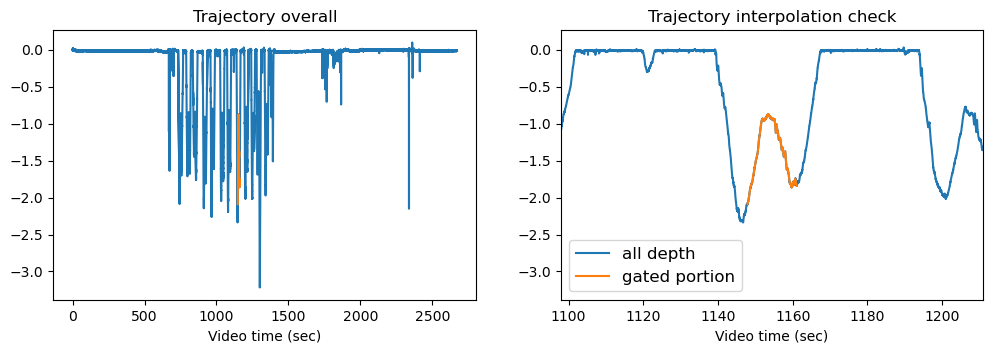

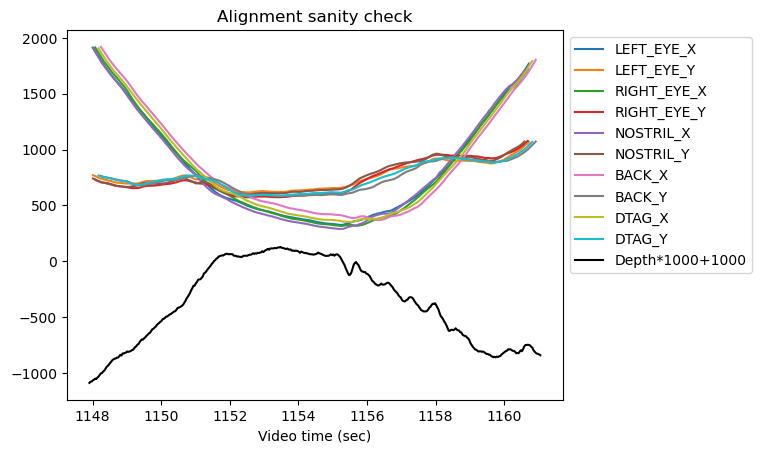

Save xypressure data to: 20190628_s2_t8_GP011476_xypressure.csv



---------------------------------------------------------
20190628_s2_t9, video: GP011476.MP4


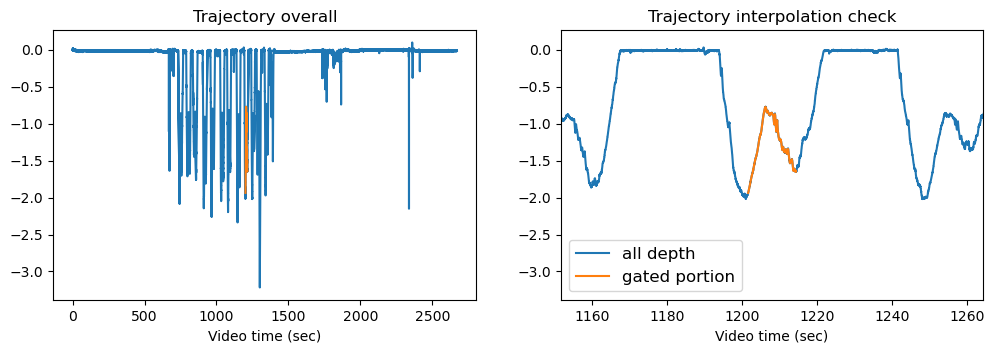

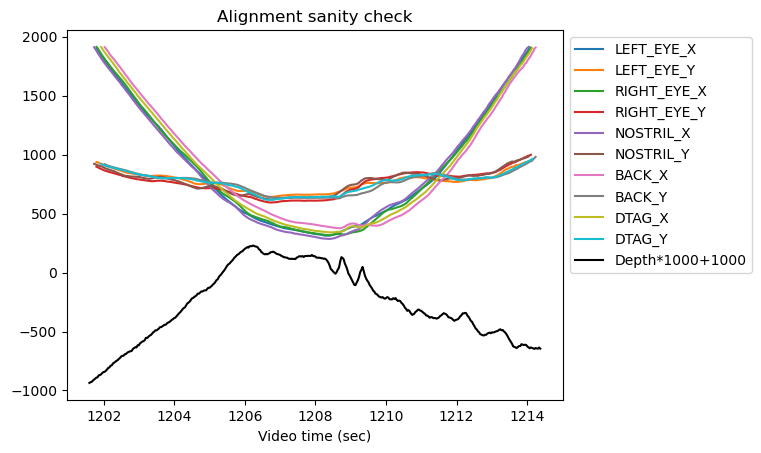

Save xypressure data to: 20190628_s2_t9_GP011476_xypressure.csv



---------------------------------------------------------
20190628_s2_t10, video: GP011476.MP4


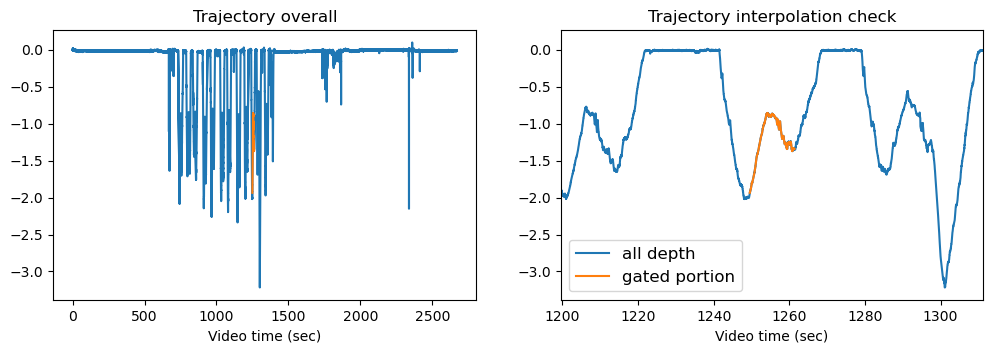

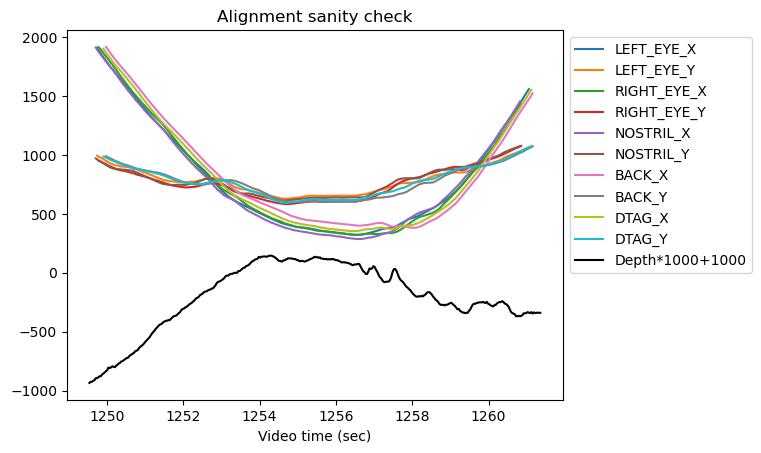

Save xypressure data to: 20190628_s2_t10_GP011476_xypressure.csv



---------------------------------------------------------
20190628_s2_t11, video: GP011476.MP4


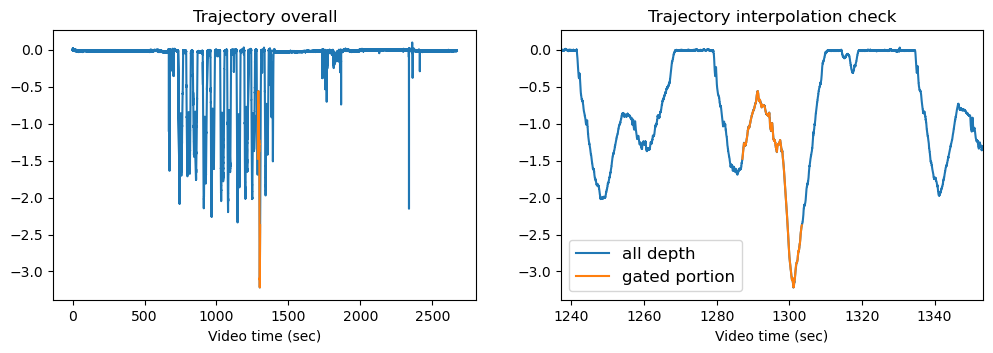

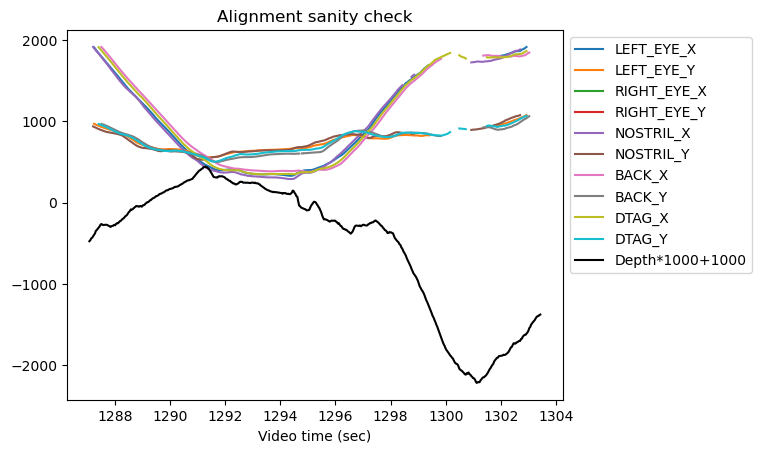

Save xypressure data to: 20190628_s2_t11_GP011476_xypressure.csv



---------------------------------------------------------
20190628_s2_t12, video: GP011476.MP4


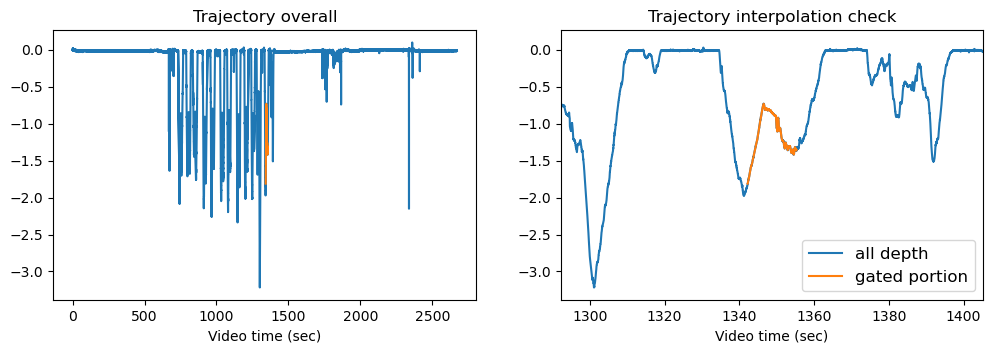

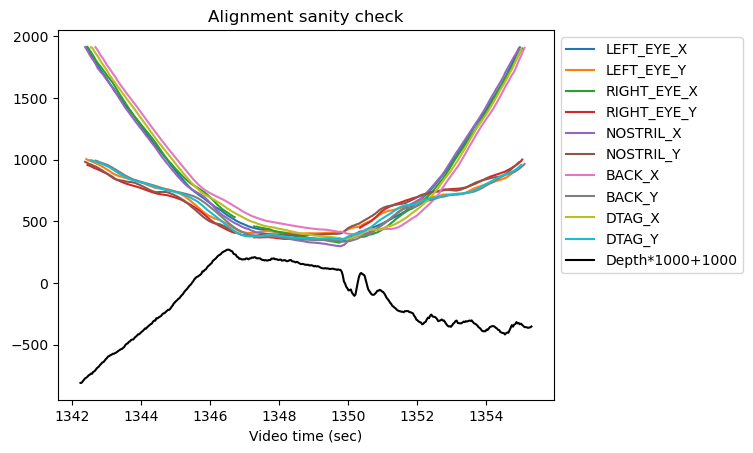

Save xypressure data to: 20190628_s2_t12_GP011476_xypressure.csv



---------------------------------------------------------
20190628_s3_t1, video: GOPR1477.MP4


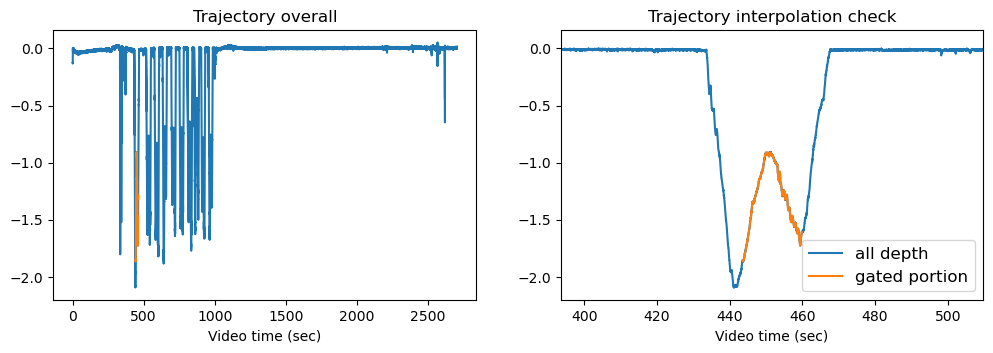

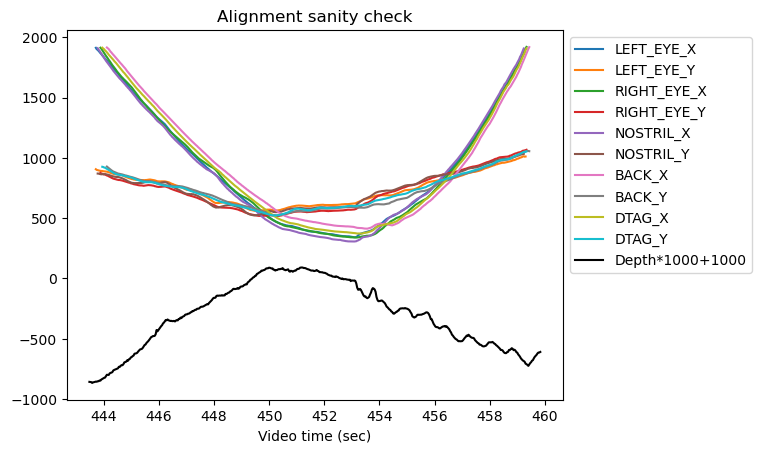

Save xypressure data to: 20190628_s3_t1_GOPR1477_xypressure.csv



---------------------------------------------------------
20190628_s3_t2, video: GOPR1477.MP4


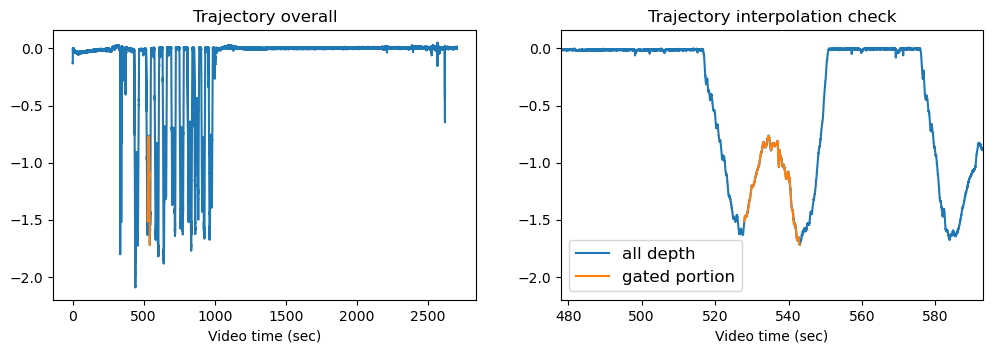

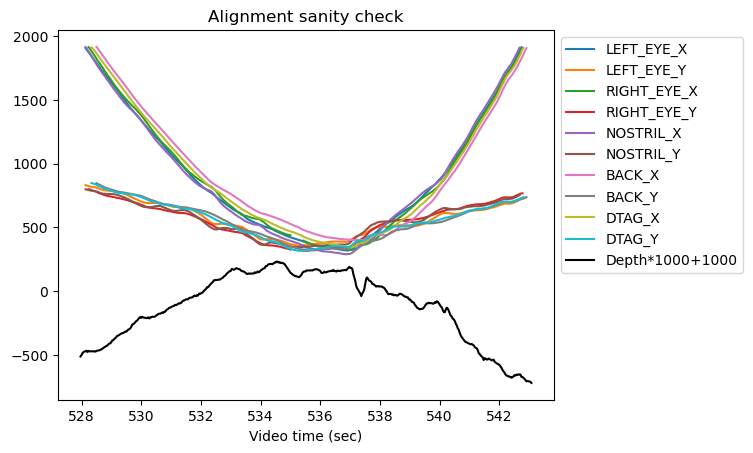

Save xypressure data to: 20190628_s3_t2_GOPR1477_xypressure.csv



---------------------------------------------------------
20190628_s3_t3, video: GOPR1477.MP4


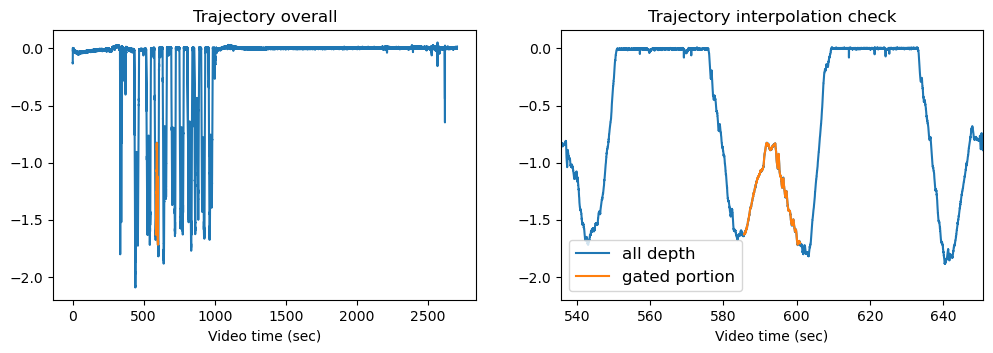

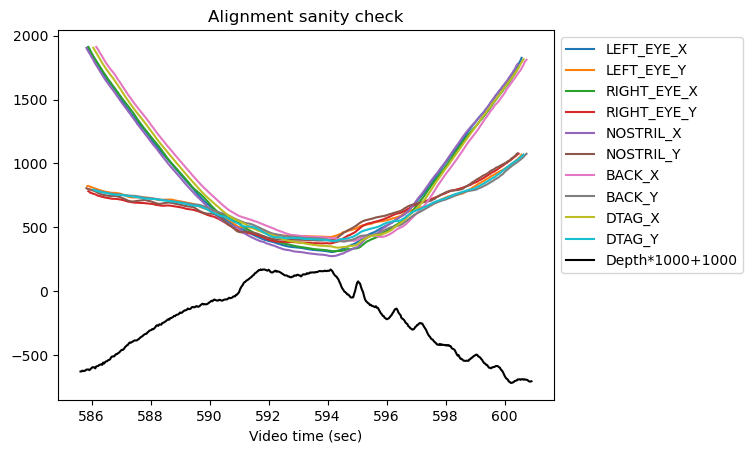

Save xypressure data to: 20190628_s3_t3_GOPR1477_xypressure.csv



---------------------------------------------------------
20190628_s3_t4, video: GOPR1477.MP4


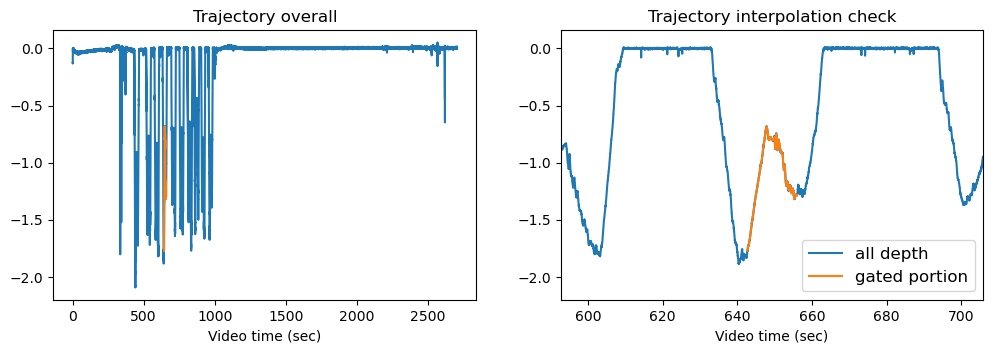

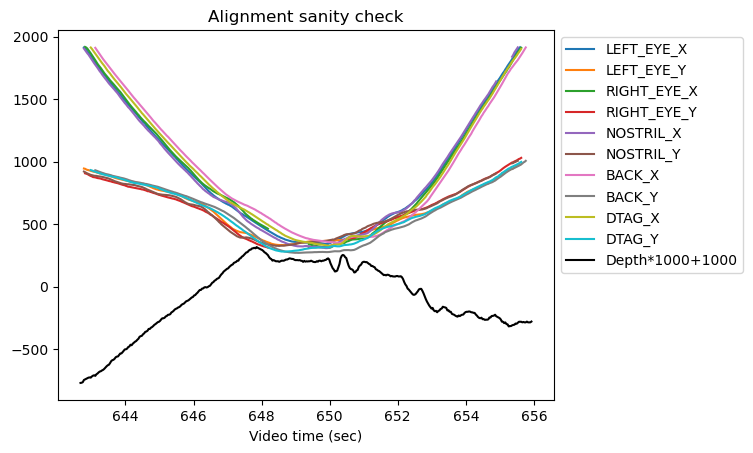

Save xypressure data to: 20190628_s3_t4_GOPR1477_xypressure.csv



---------------------------------------------------------
20190628_s3_t5, video: GOPR1477.MP4


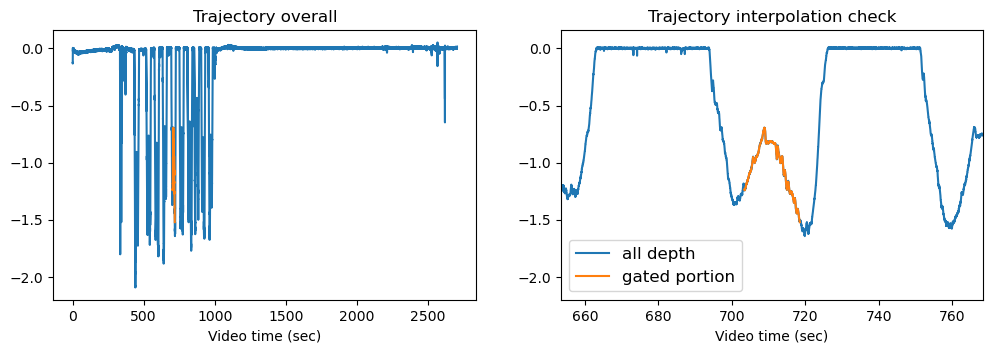

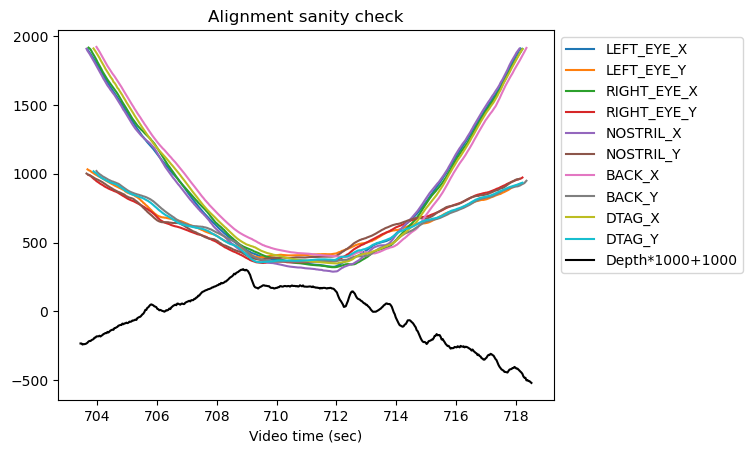

Save xypressure data to: 20190628_s3_t5_GOPR1477_xypressure.csv



---------------------------------------------------------
20190628_s3_t6, video: GOPR1477.MP4


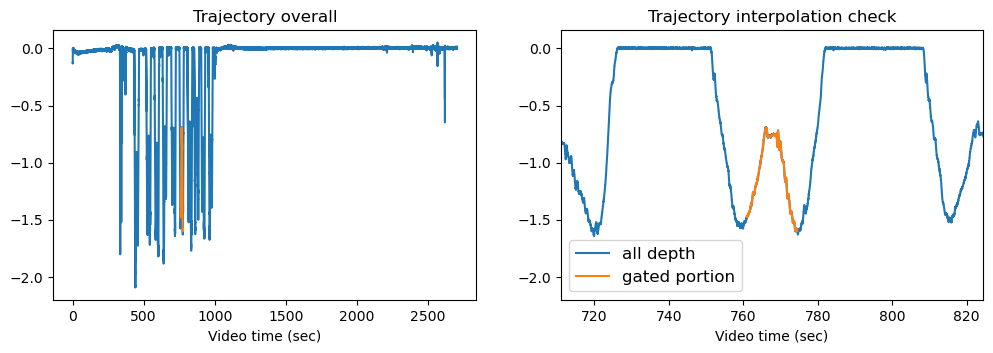

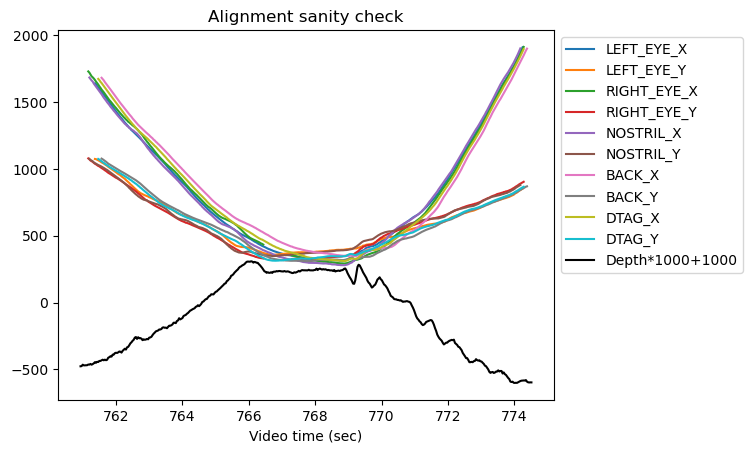

Save xypressure data to: 20190628_s3_t6_GOPR1477_xypressure.csv



---------------------------------------------------------
20190628_s3_t7, video: GOPR1477.MP4


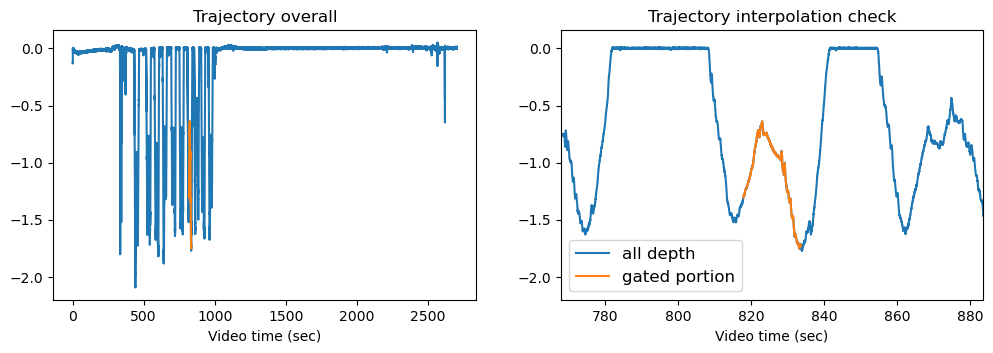

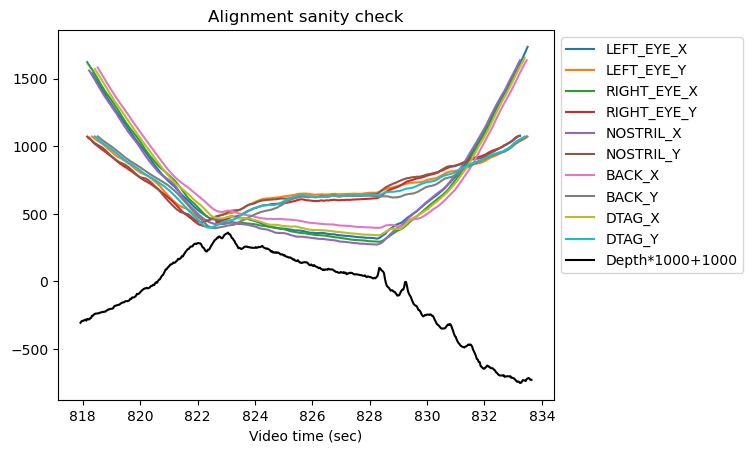

Save xypressure data to: 20190628_s3_t7_GOPR1477_xypressure.csv



---------------------------------------------------------
20190628_s3_t8, video: GOPR1477.MP4


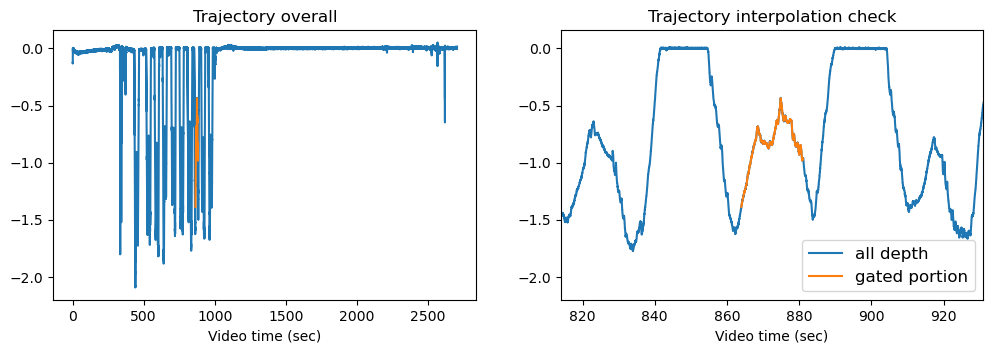

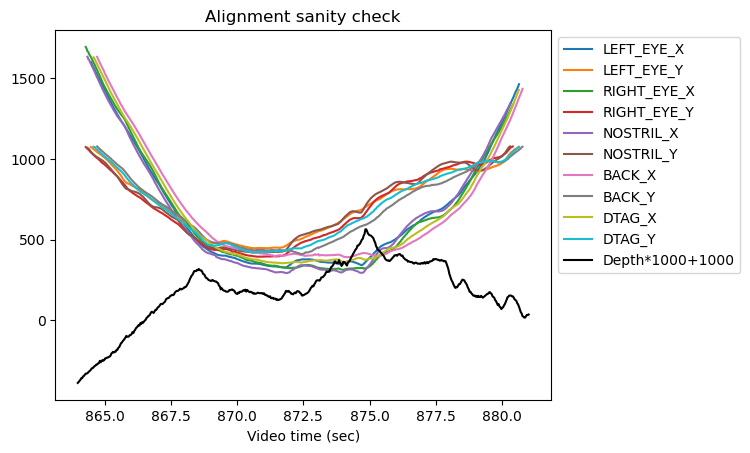

Save xypressure data to: 20190628_s3_t8_GOPR1477_xypressure.csv



---------------------------------------------------------
20190628_s3_t9, video: GOPR1477.MP4


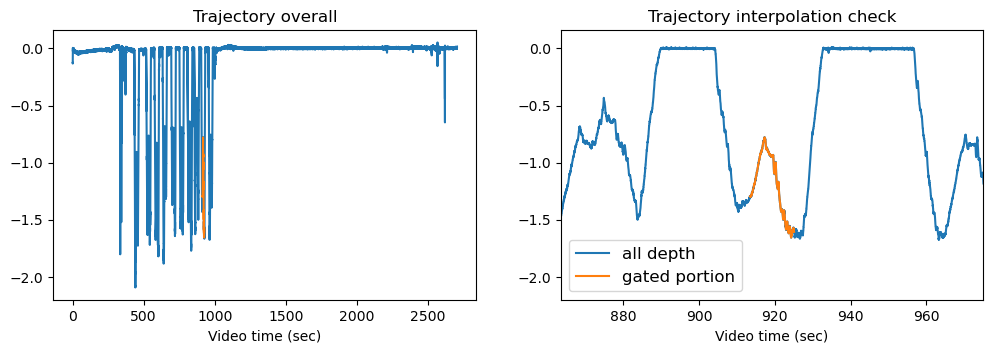

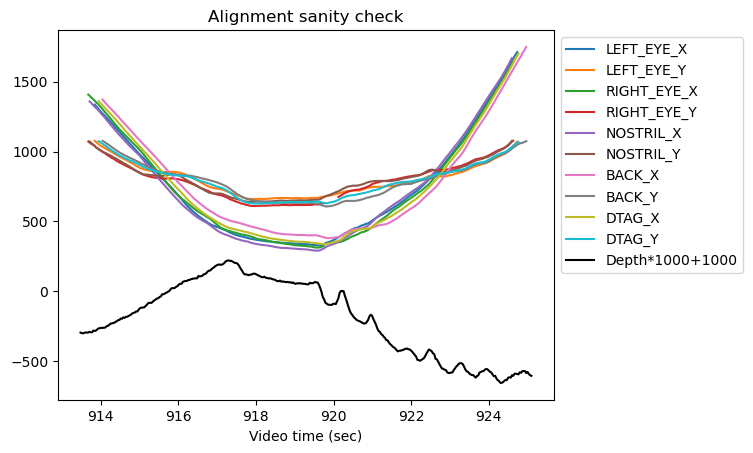

Save xypressure data to: 20190628_s3_t9_GOPR1477_xypressure.csv



---------------------------------------------------------
20190628_s3_t10, video: GOPR1477.MP4


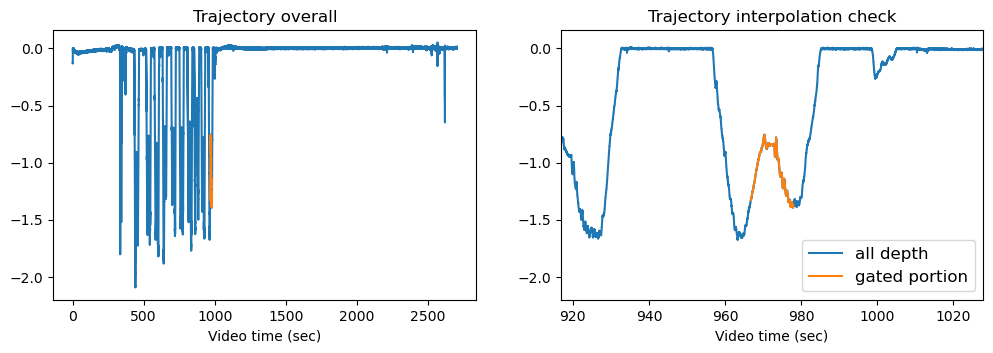

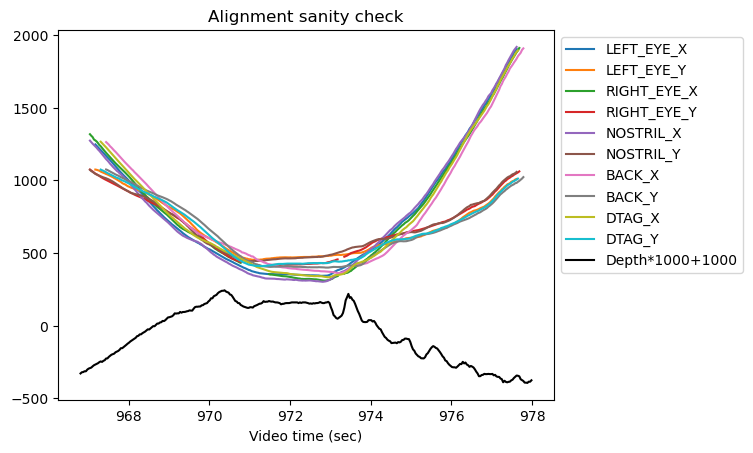

Save xypressure data to: 20190628_s3_t10_GOPR1477_xypressure.csv



---------------------------------------------------------
20190701_s1_t1, video: GOPR1478.MP4


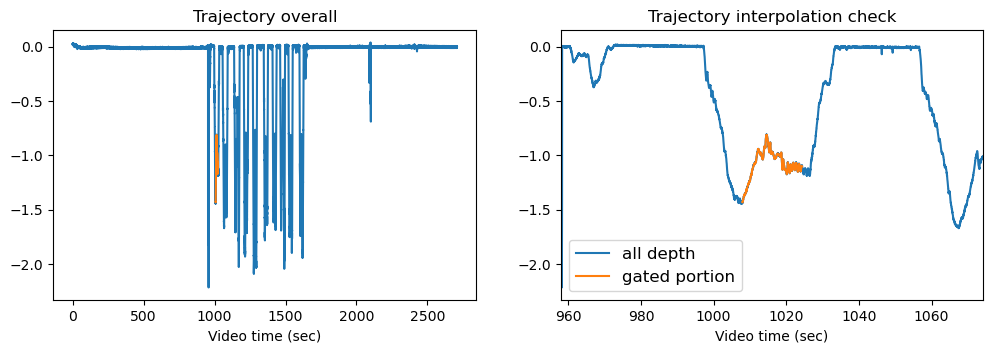

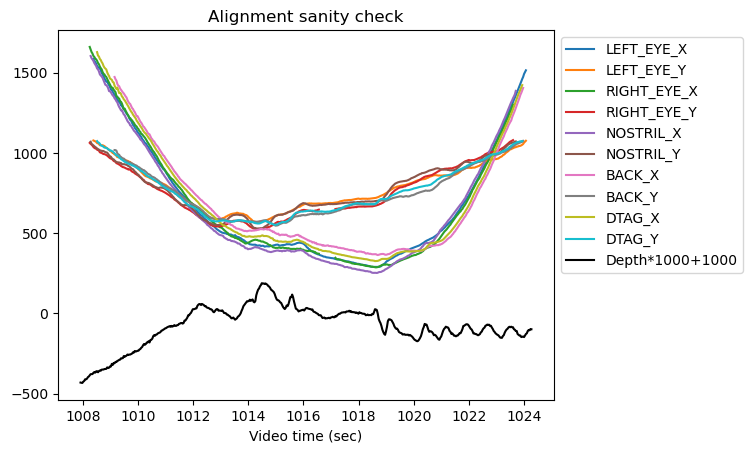

Save xypressure data to: 20190701_s1_t1_GOPR1478_xypressure.csv



---------------------------------------------------------
20190701_s1_t2, video: GP011478.MP4


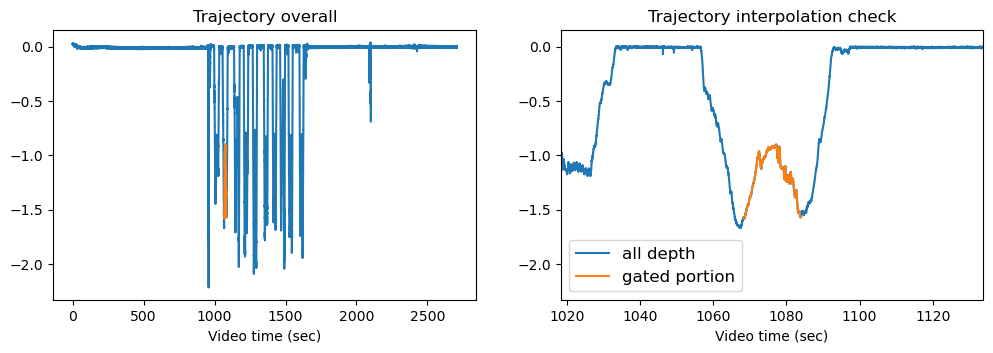

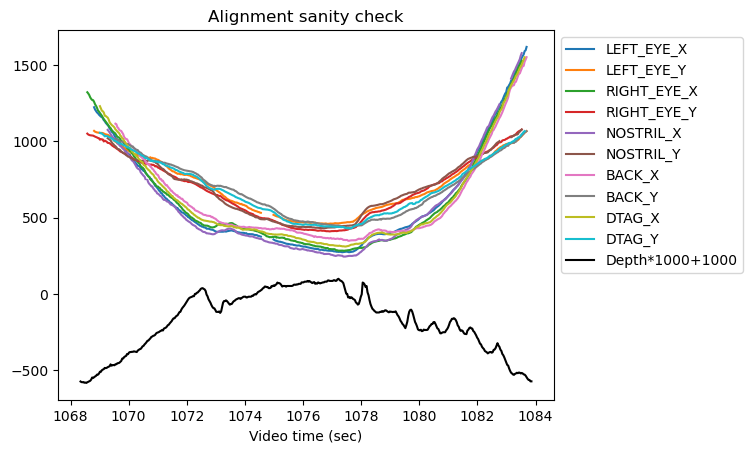

Save xypressure data to: 20190701_s1_t2_GP011478_xypressure.csv



---------------------------------------------------------
20190701_s1_t3, video: GP011478.MP4


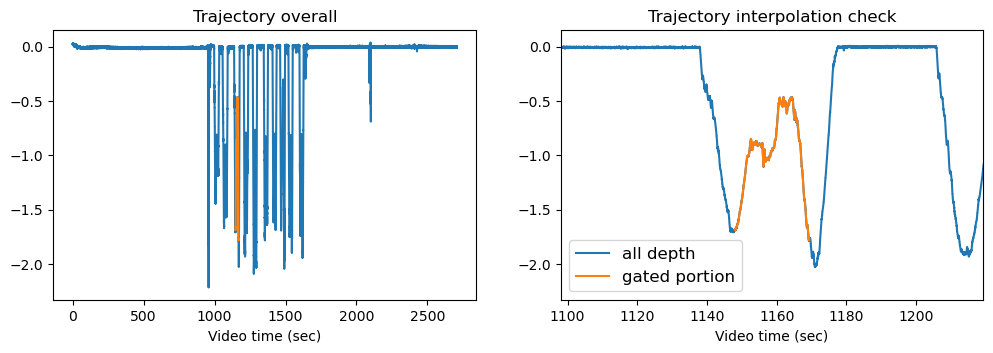

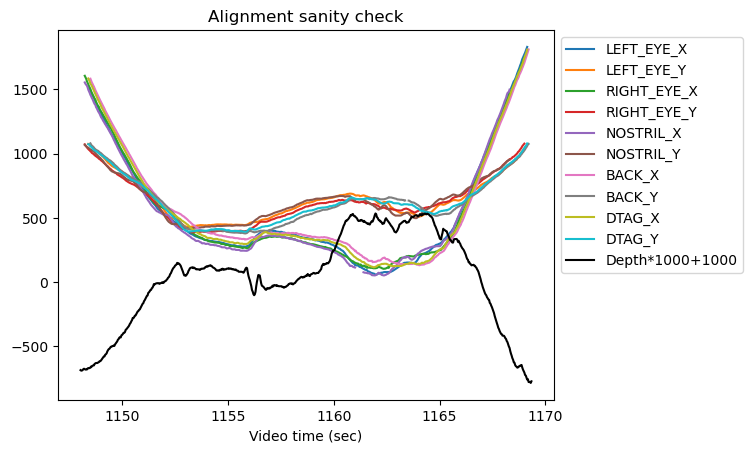

Save xypressure data to: 20190701_s1_t3_GP011478_xypressure.csv



---------------------------------------------------------
20190701_s1_t4, video: GP011478.MP4


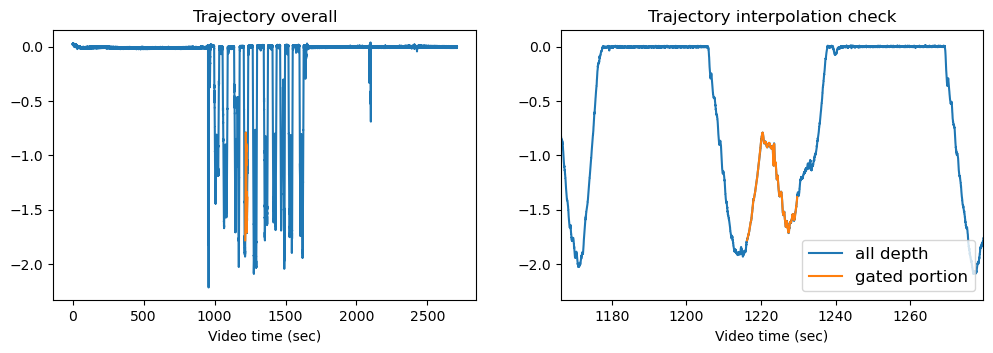

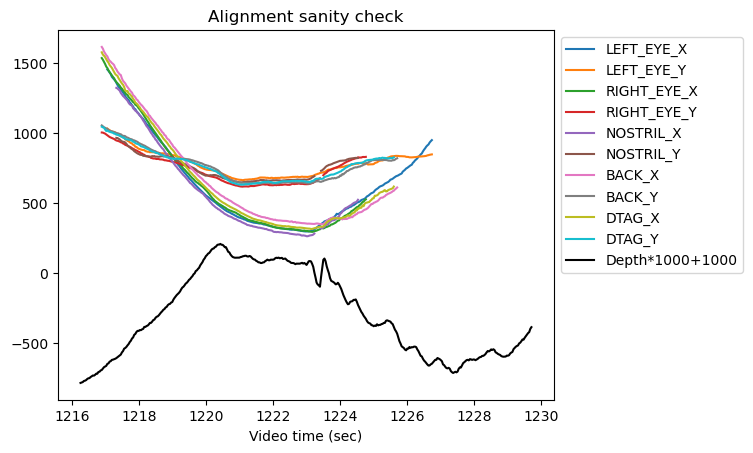

Save xypressure data to: 20190701_s1_t4_GP011478_xypressure.csv



---------------------------------------------------------
20190701_s1_t5, video: GP011478.MP4


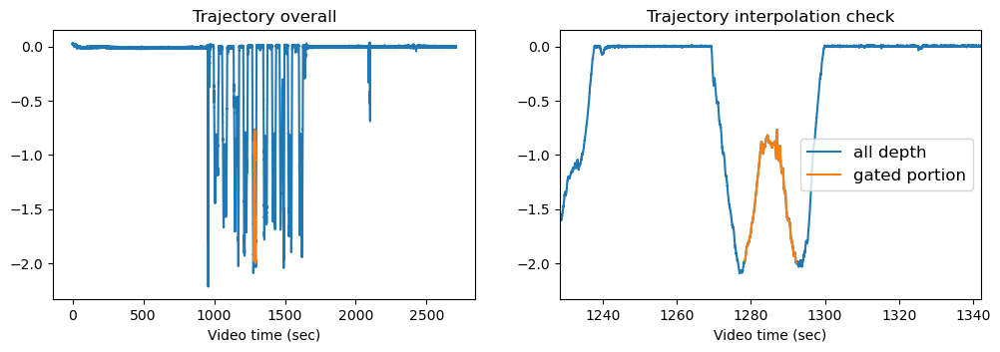

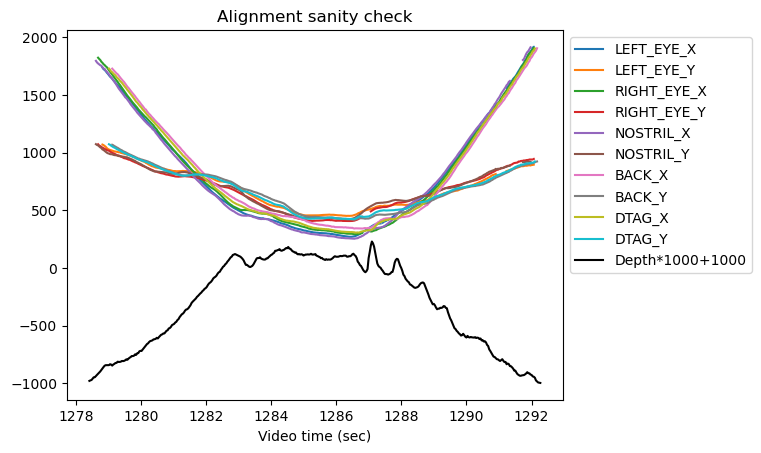

Save xypressure data to: 20190701_s1_t5_GP011478_xypressure.csv



---------------------------------------------------------
20190701_s1_t6, video: GP011478.MP4


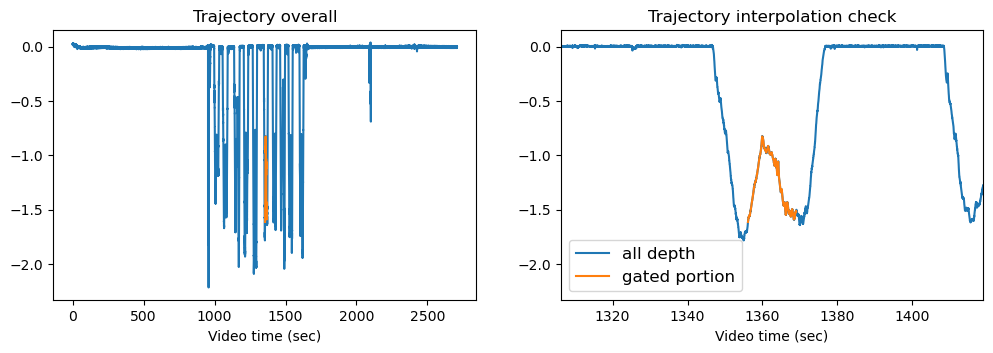

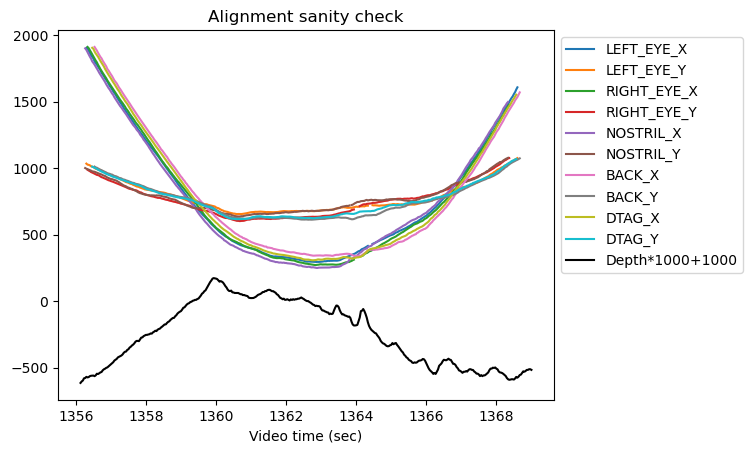

Save xypressure data to: 20190701_s1_t6_GP011478_xypressure.csv



---------------------------------------------------------
20190701_s1_t7, video: GP011478.MP4


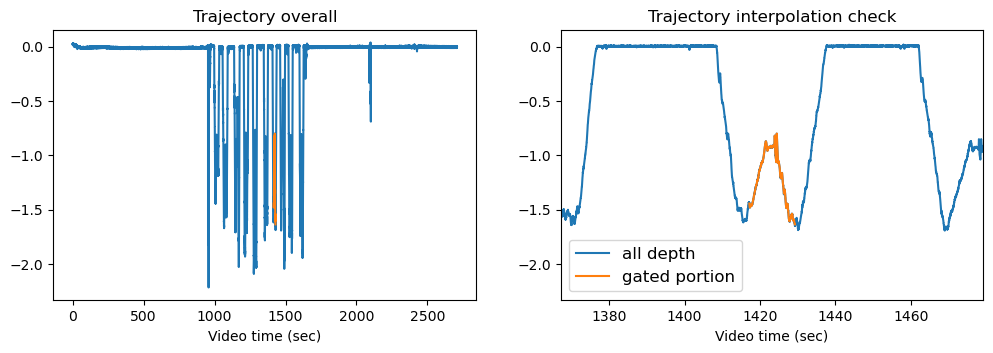

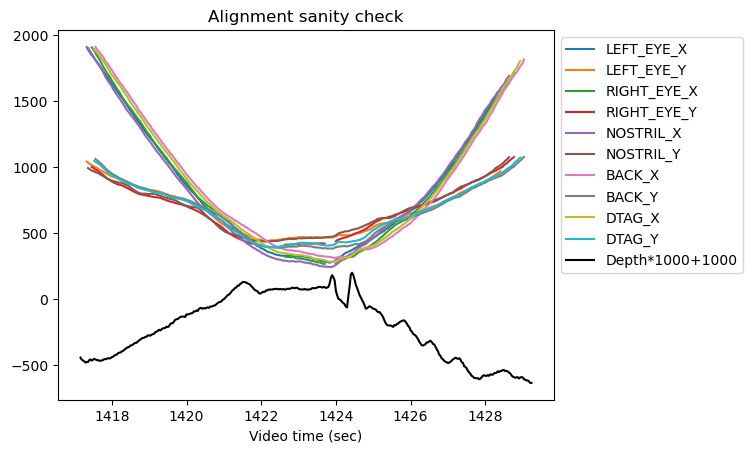

Save xypressure data to: 20190701_s1_t7_GP011478_xypressure.csv



---------------------------------------------------------
20190701_s1_t8, video: GP011478.MP4


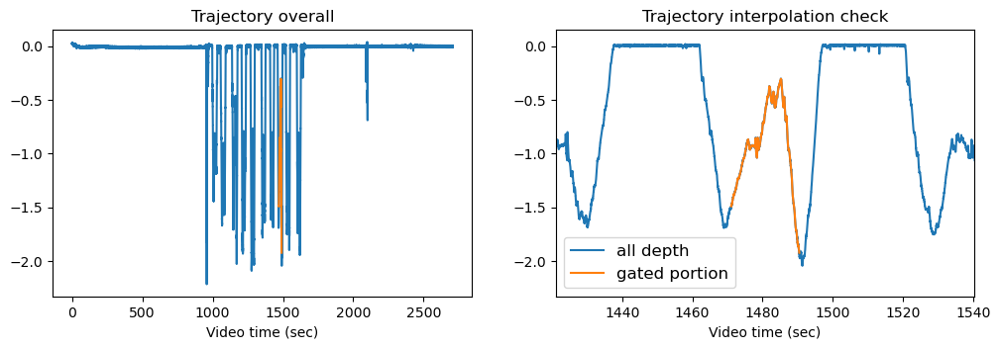

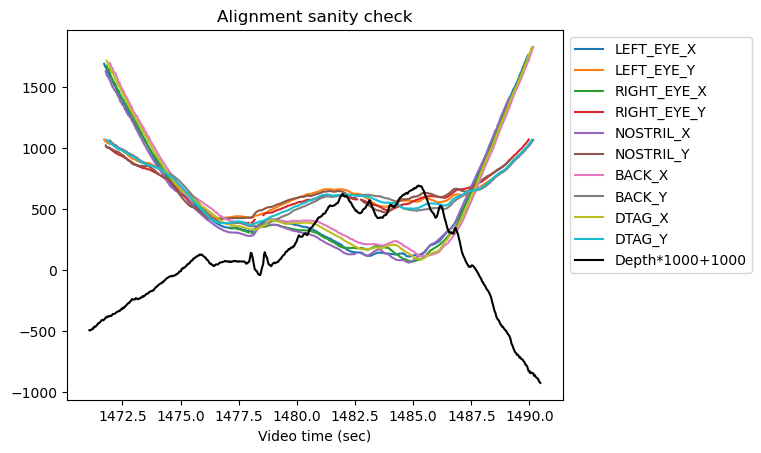

Save xypressure data to: 20190701_s1_t8_GP011478_xypressure.csv



---------------------------------------------------------
20190701_s1_t9, video: GP011478.MP4


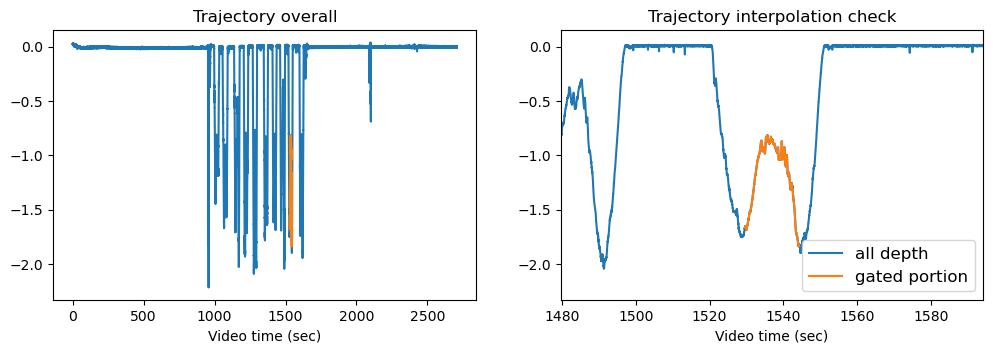

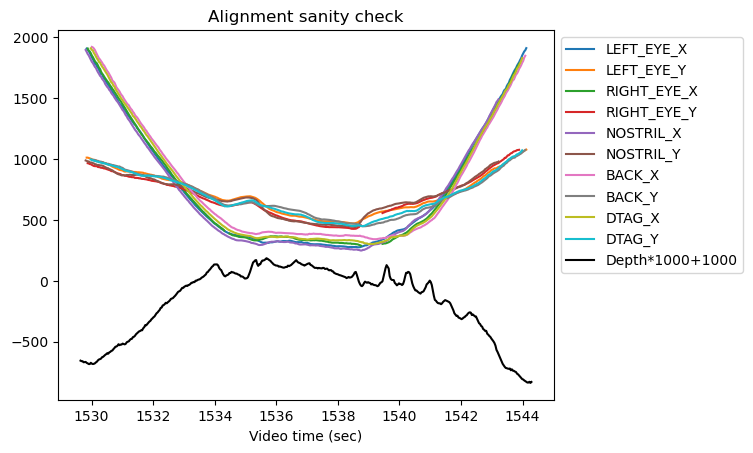

Save xypressure data to: 20190701_s1_t9_GP011478_xypressure.csv



---------------------------------------------------------
20190701_s1_t10, video: GP011478.MP4


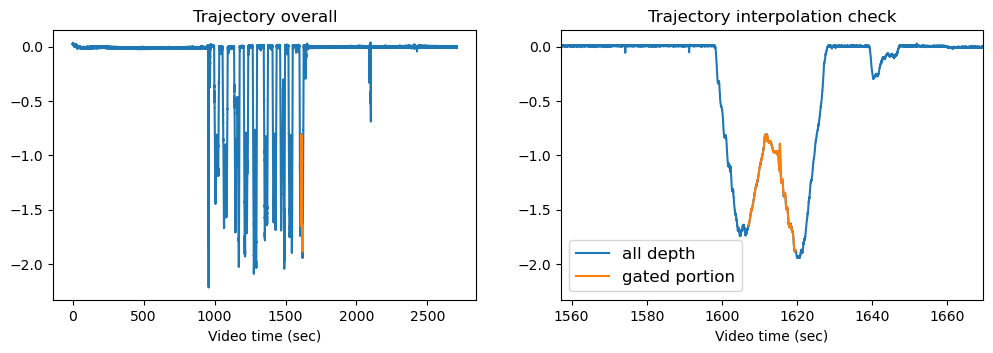

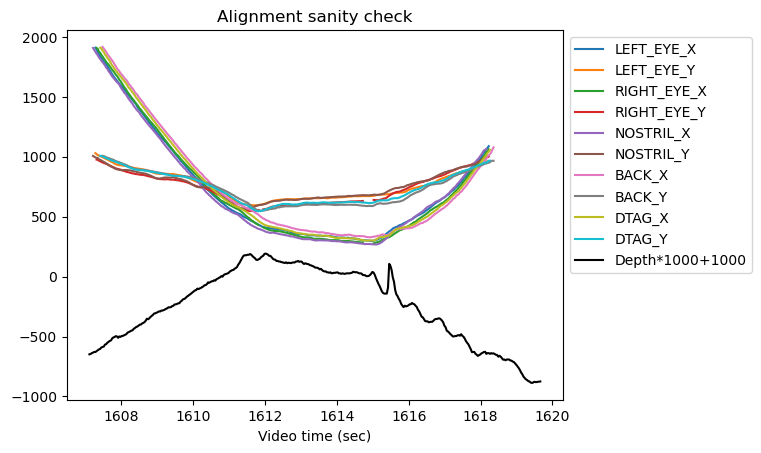

Save xypressure data to: 20190701_s1_t10_GP011478_xypressure.csv



---------------------------------------------------------
20190701_s2_t1, video: GP011479.MP4


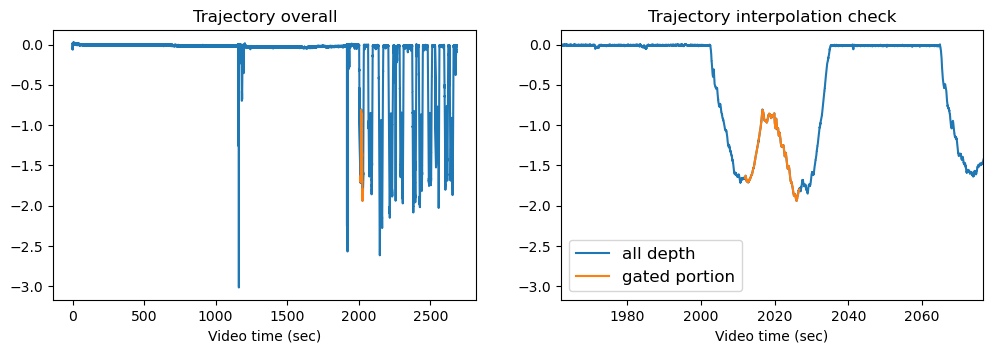

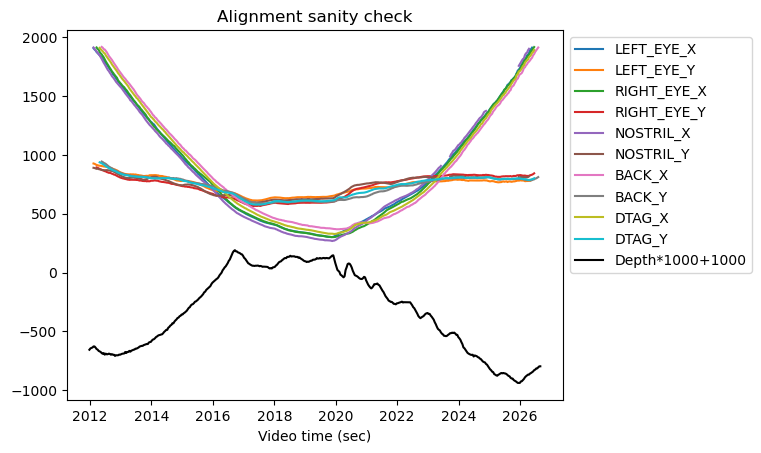

Save xypressure data to: 20190701_s2_t1_GP011479_xypressure.csv



---------------------------------------------------------
20190701_s2_t2, video: GP011479.MP4


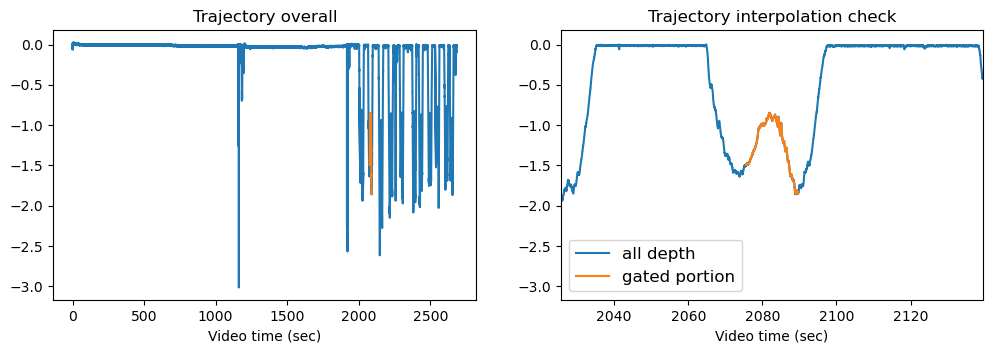

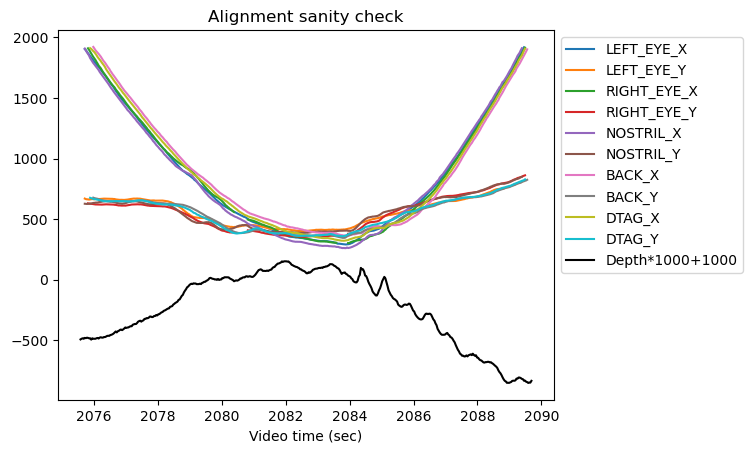

Save xypressure data to: 20190701_s2_t2_GP011479_xypressure.csv



---------------------------------------------------------
20190701_s2_t3, video: GP011479.MP4 + GP021479.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190701_s2_t4, video: GP021479.MP4


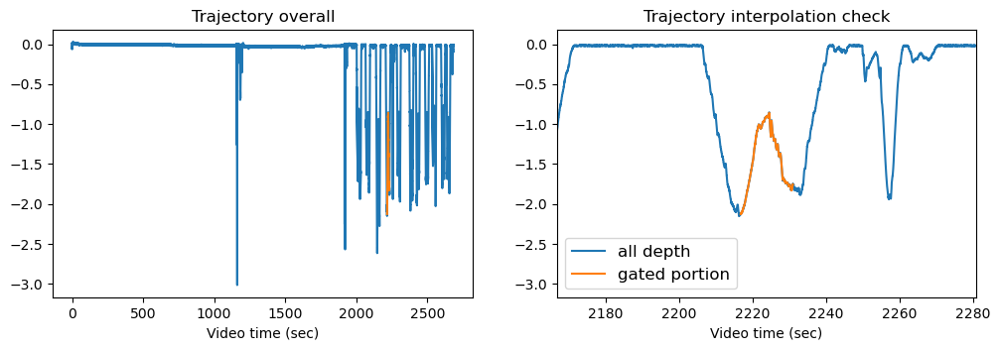

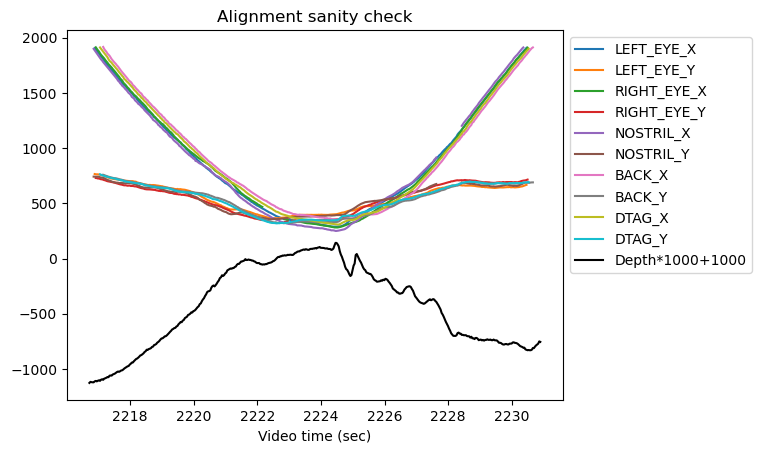

Save xypressure data to: 20190701_s2_t4_GP021479_xypressure.csv



---------------------------------------------------------
20190701_s2_t5, video: GP021479.MP4


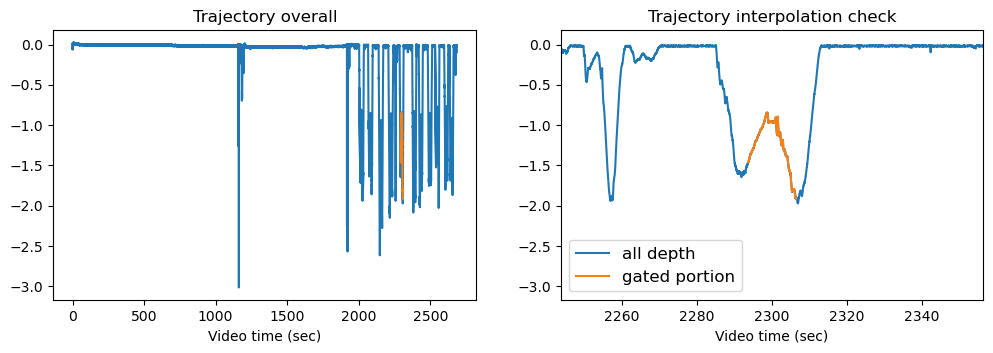

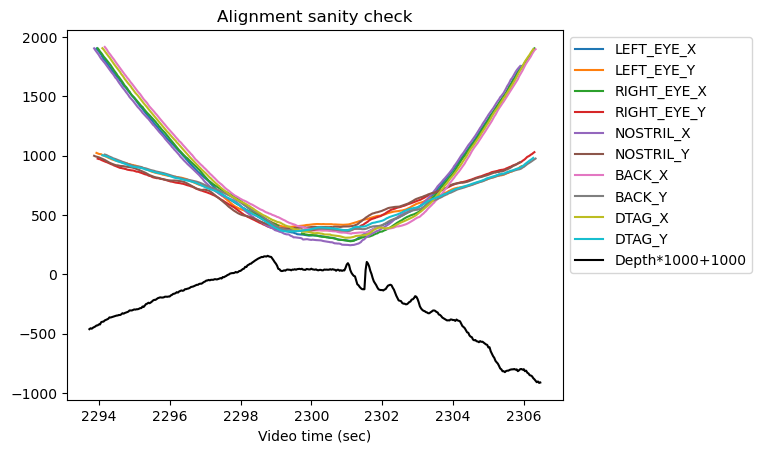

Save xypressure data to: 20190701_s2_t5_GP021479_xypressure.csv



---------------------------------------------------------
20190701_s2_t6, video: GP021479.MP4


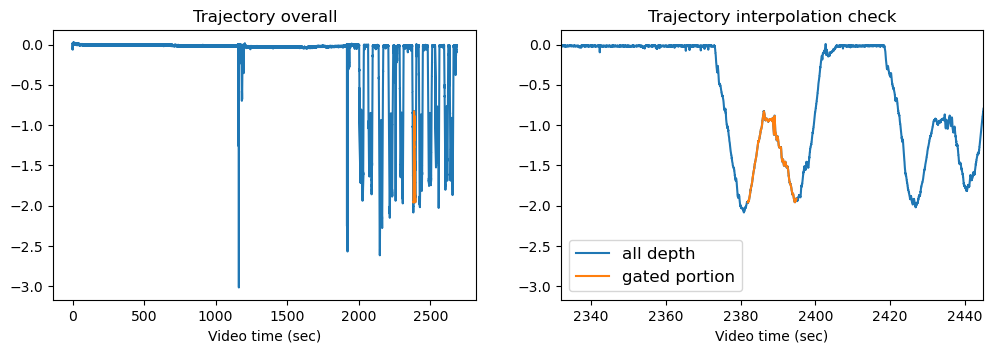

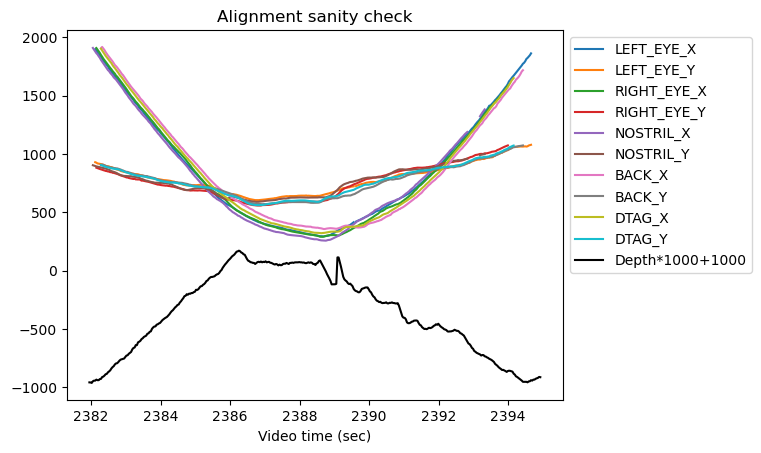

Save xypressure data to: 20190701_s2_t6_GP021479_xypressure.csv



---------------------------------------------------------
20190701_s2_t7, video: GP021479.MP4


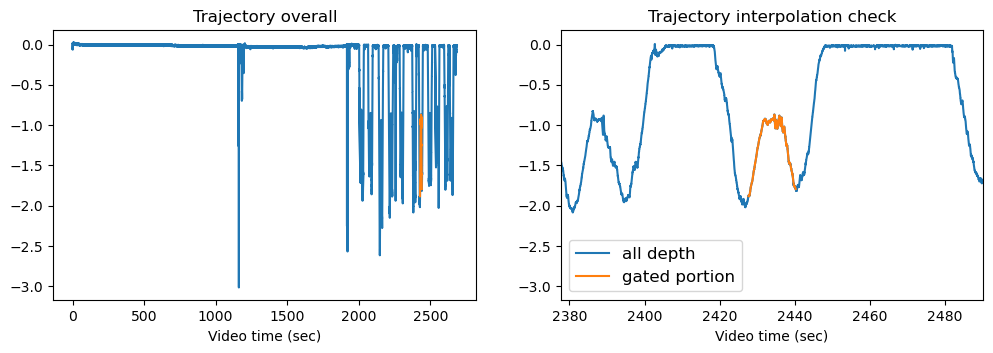

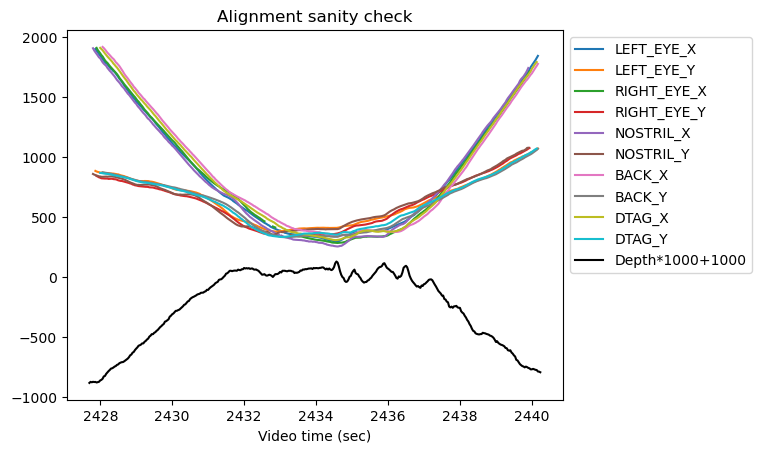

Save xypressure data to: 20190701_s2_t7_GP021479_xypressure.csv



---------------------------------------------------------
20190701_s2_t8, video: GP021479.MP4


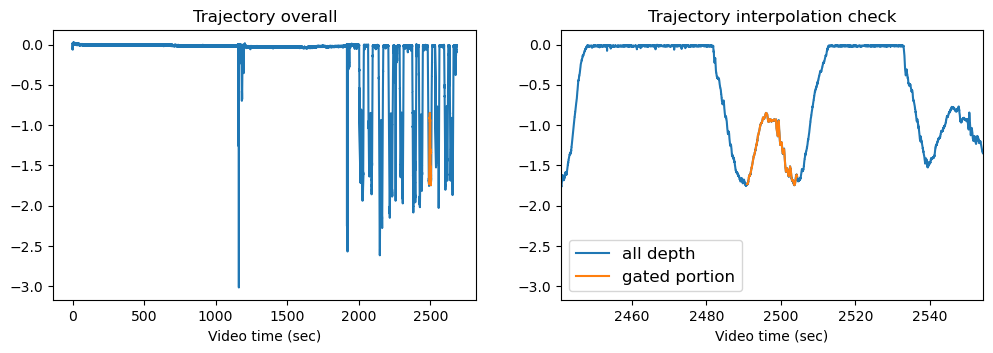

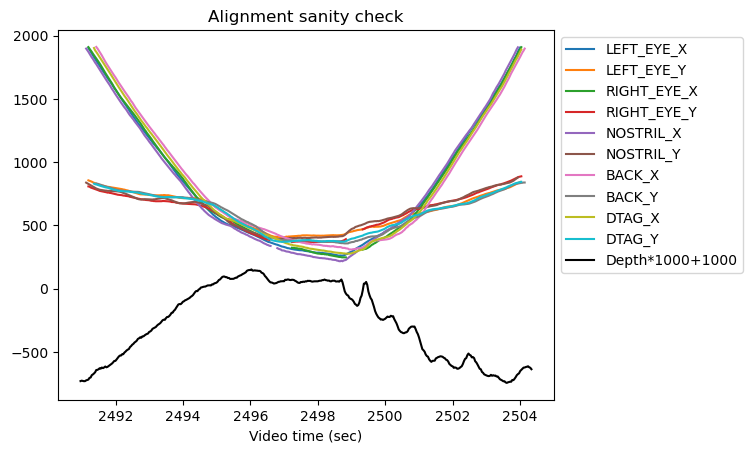

Save xypressure data to: 20190701_s2_t8_GP021479_xypressure.csv



---------------------------------------------------------
20190701_s2_t9, video: GP021479.MP4


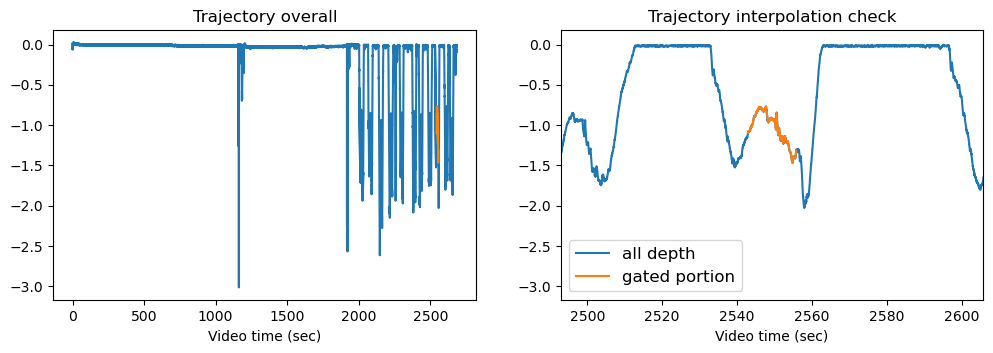

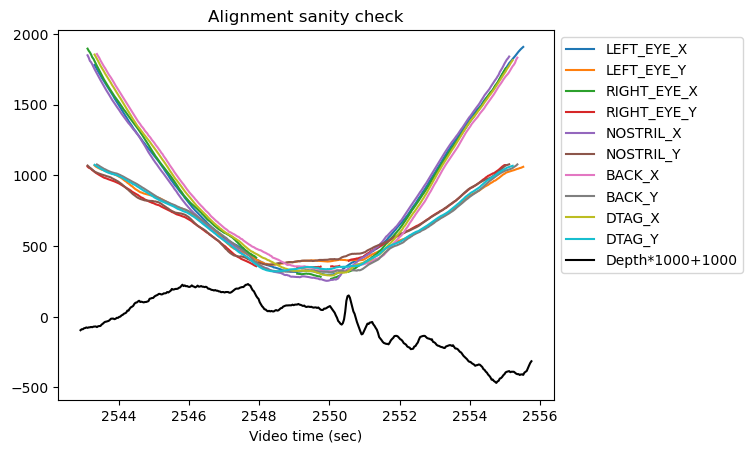

Save xypressure data to: 20190701_s2_t9_GP021479_xypressure.csv



---------------------------------------------------------
20190701_s2_t10, video: GP021479.MP4


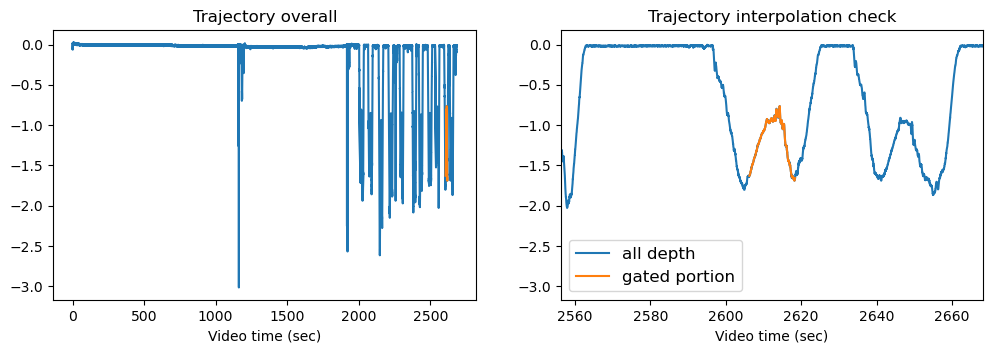

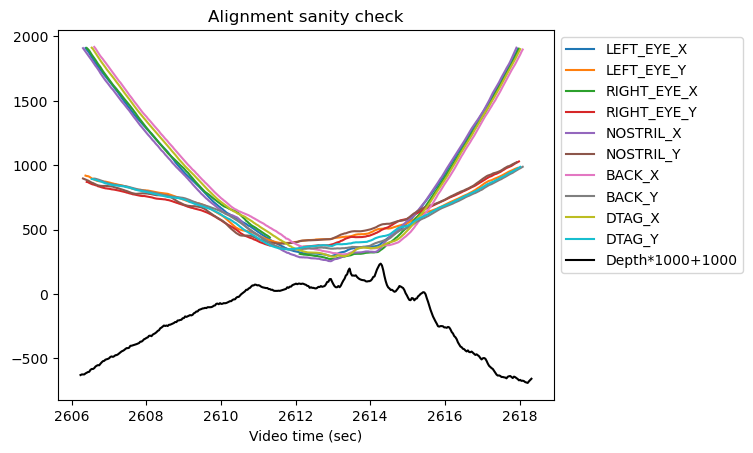

Save xypressure data to: 20190701_s2_t10_GP021479_xypressure.csv



---------------------------------------------------------
20190701_s2_t11, video: GP021479.MP4


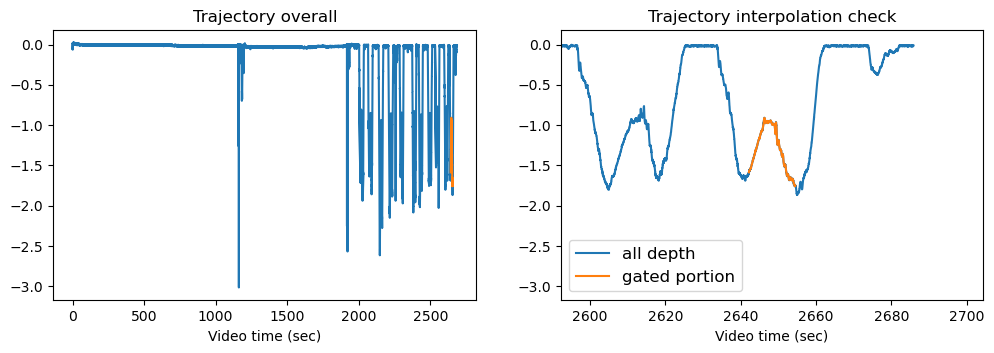

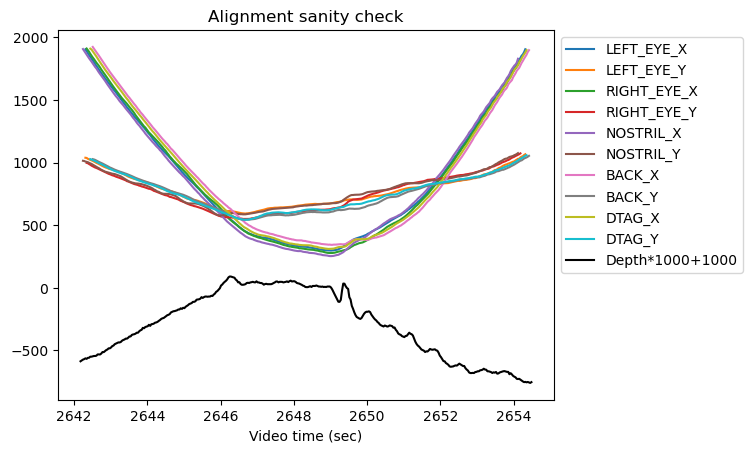

Save xypressure data to: 20190701_s2_t11_GP021479_xypressure.csv



---------------------------------------------------------
20190701_s3_t1, video: GOPR1480.MP4


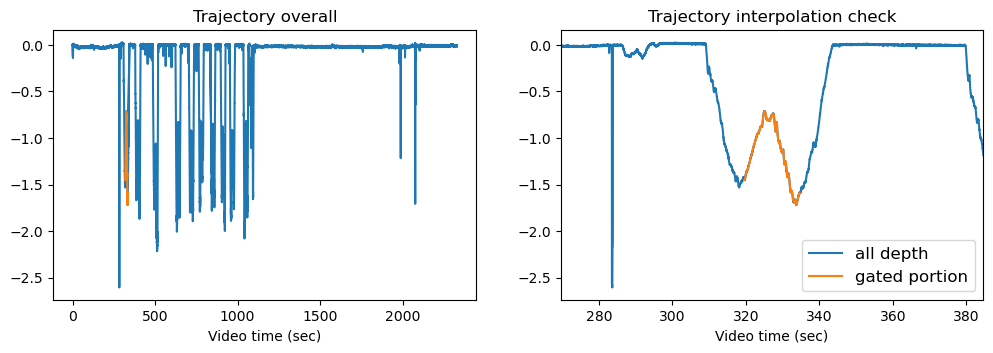

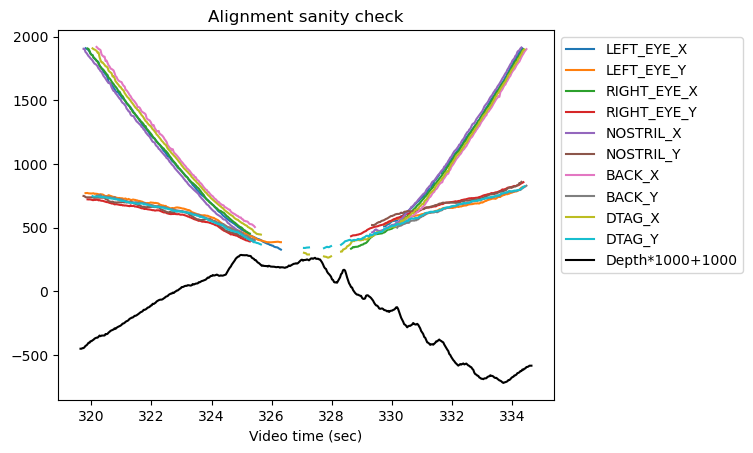

Save xypressure data to: 20190701_s3_t1_GOPR1480_xypressure.csv



---------------------------------------------------------
20190701_s3_t2, video: GOPR1480.MP4


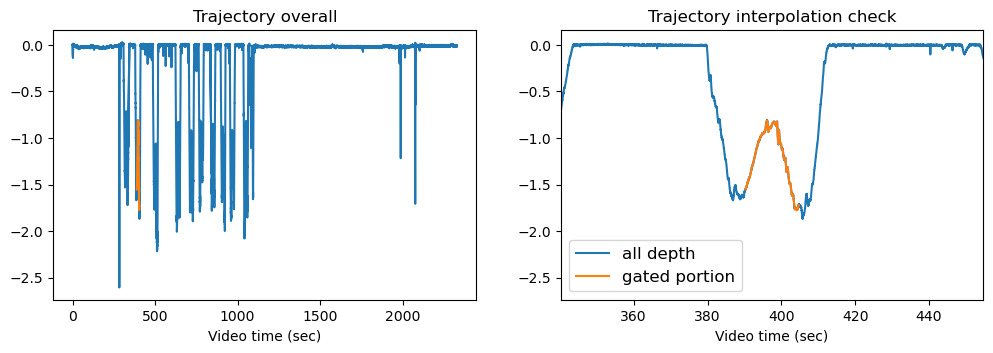

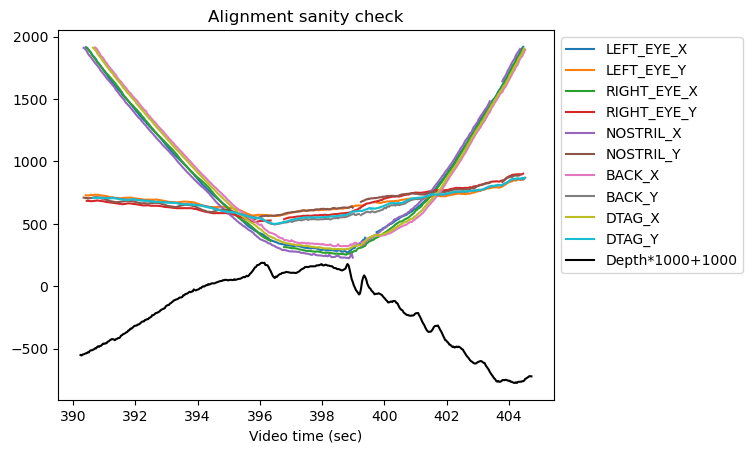

Save xypressure data to: 20190701_s3_t2_GOPR1480_xypressure.csv



---------------------------------------------------------
20190701_s3_t3, video: GOPR1480.MP4


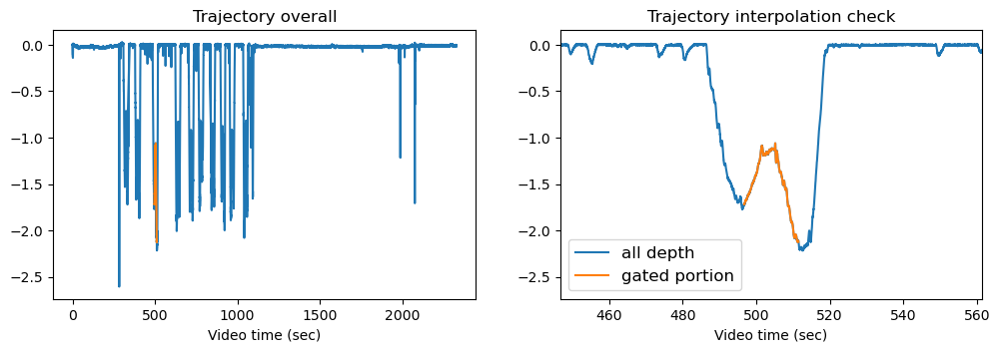

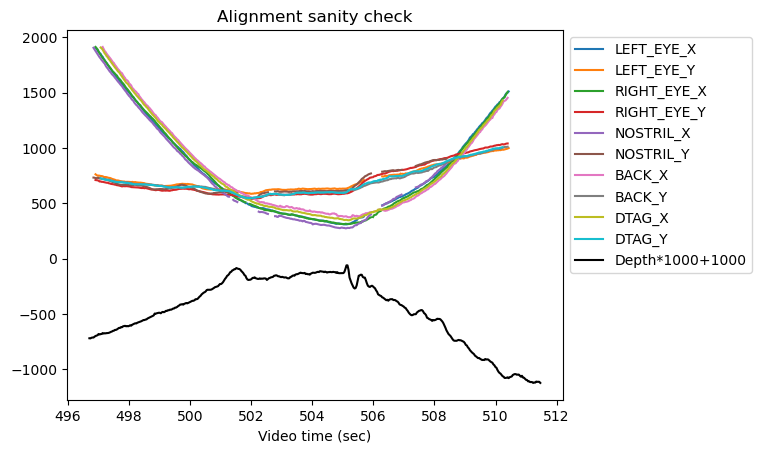

Save xypressure data to: 20190701_s3_t3_GOPR1480_xypressure.csv



---------------------------------------------------------
20190701_s3_t4, video: GOPR1480.MP4


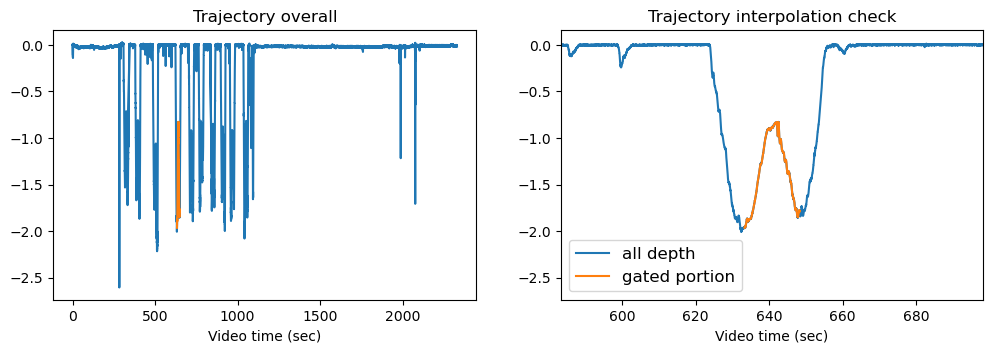

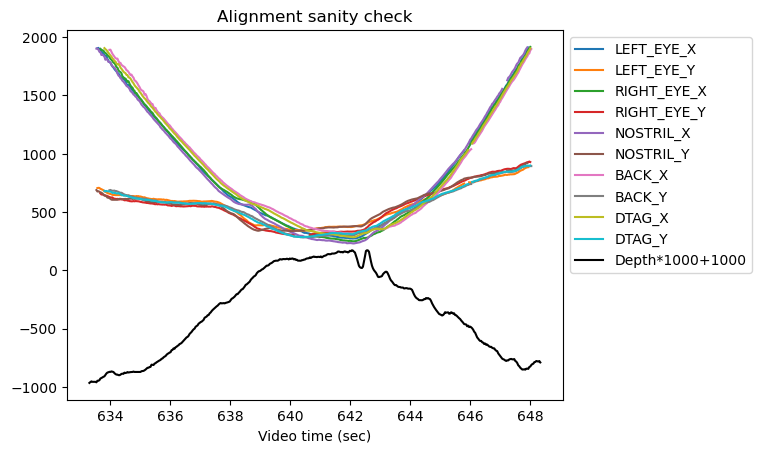

Save xypressure data to: 20190701_s3_t4_GOPR1480_xypressure.csv



---------------------------------------------------------
20190701_s3_t5, video: GOPR1480.MP4


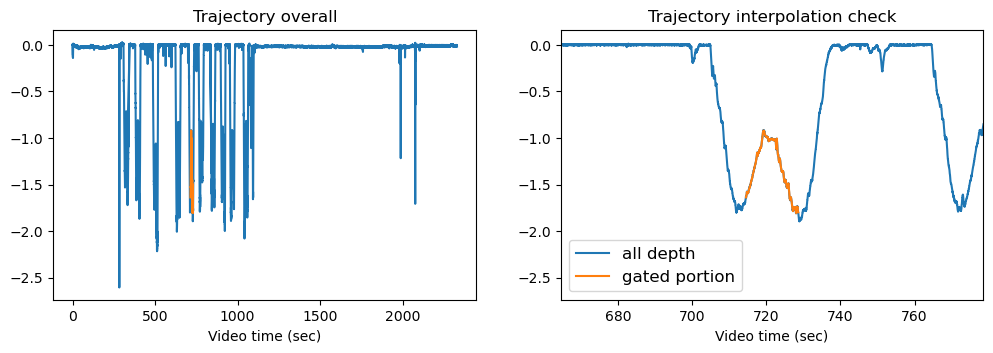

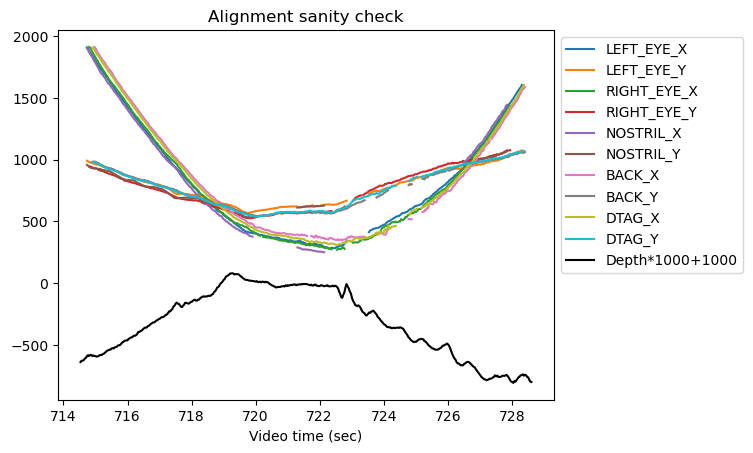

Save xypressure data to: 20190701_s3_t5_GOPR1480_xypressure.csv



---------------------------------------------------------
20190701_s3_t6, video: GOPR1480.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190701_s3_t7, video: GOPR1480.MP4


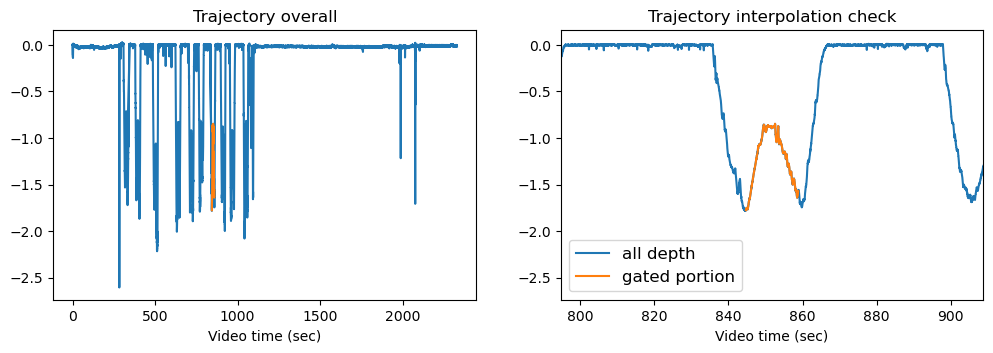

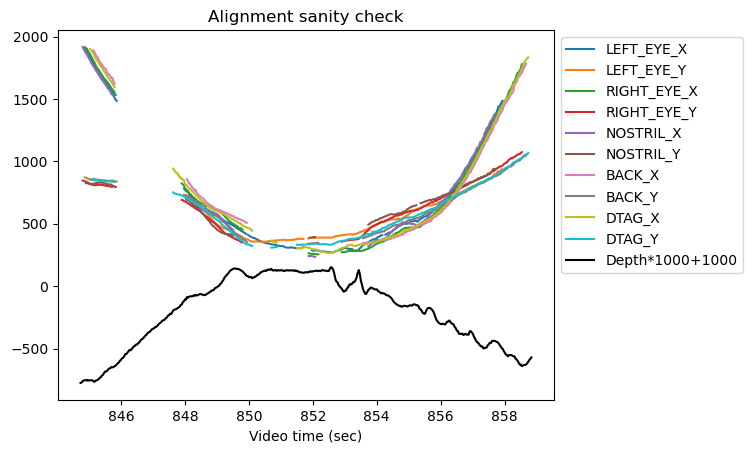

Save xypressure data to: 20190701_s3_t7_GOPR1480_xypressure.csv



---------------------------------------------------------
20190701_s3_t8, video: GOPR1480.MP4


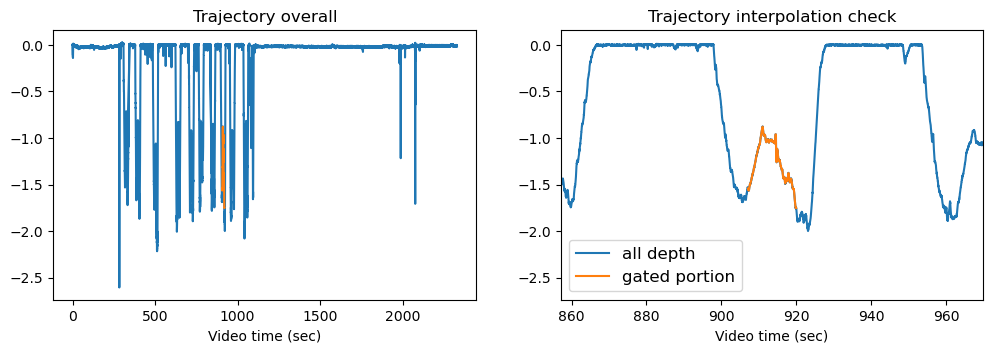

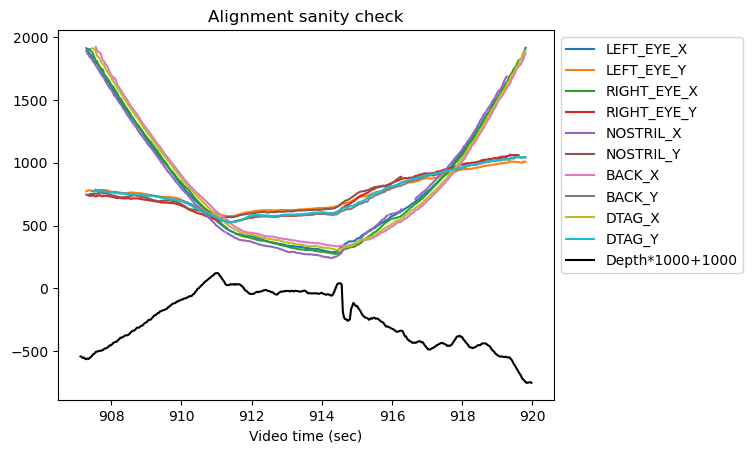

Save xypressure data to: 20190701_s3_t8_GOPR1480_xypressure.csv



---------------------------------------------------------
20190701_s3_t9, video: GOPR1480.MP4


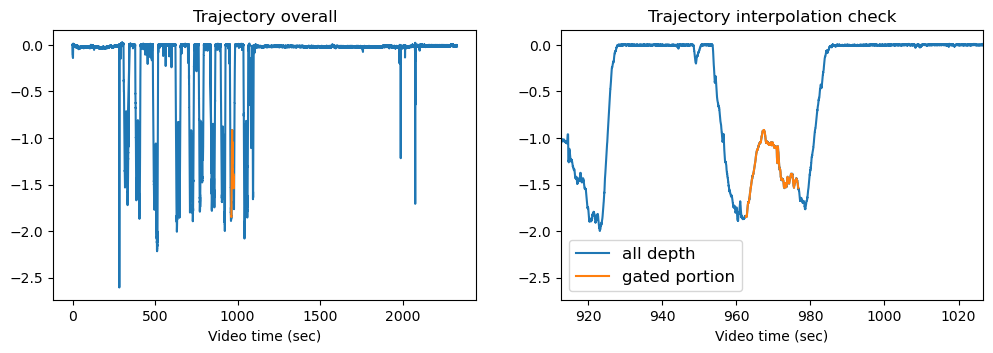

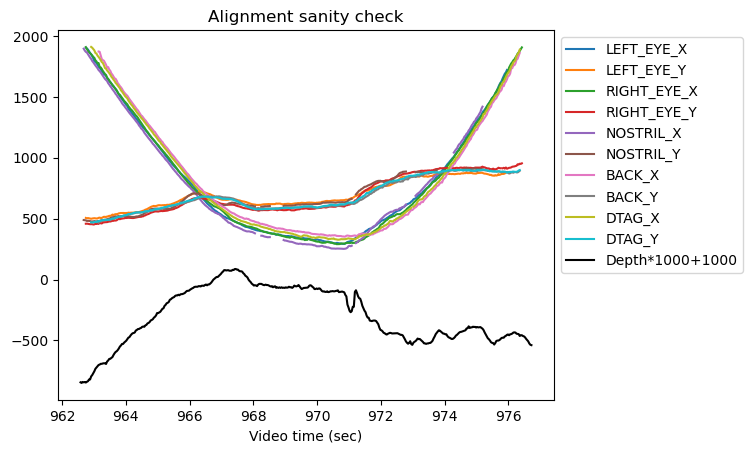

Save xypressure data to: 20190701_s3_t9_GOPR1480_xypressure.csv



---------------------------------------------------------
20190701_s3_t10, video: GOPR1480.MP4


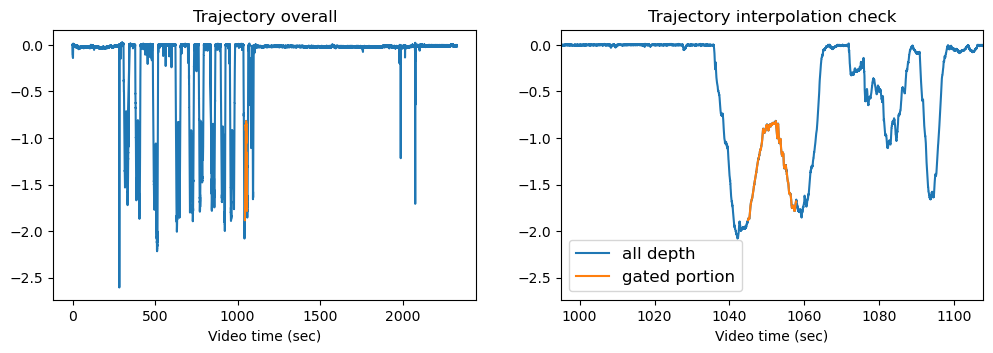

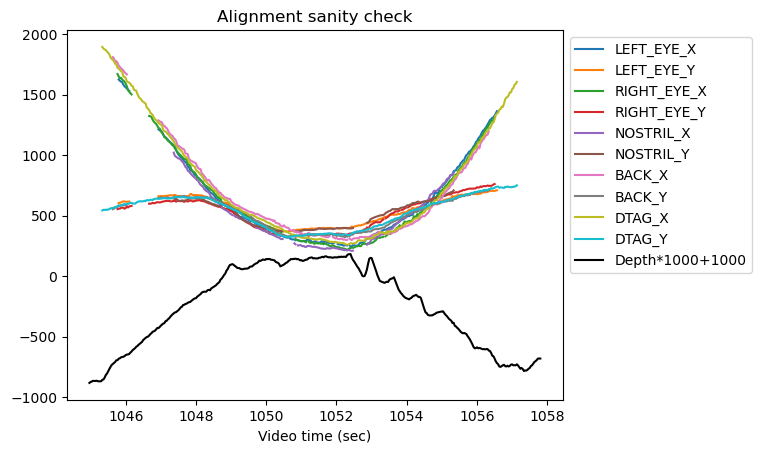

Save xypressure data to: 20190701_s3_t10_GOPR1480_xypressure.csv



---------------------------------------------------------
20190702_s1_t1, video: GOPR1481.MP4


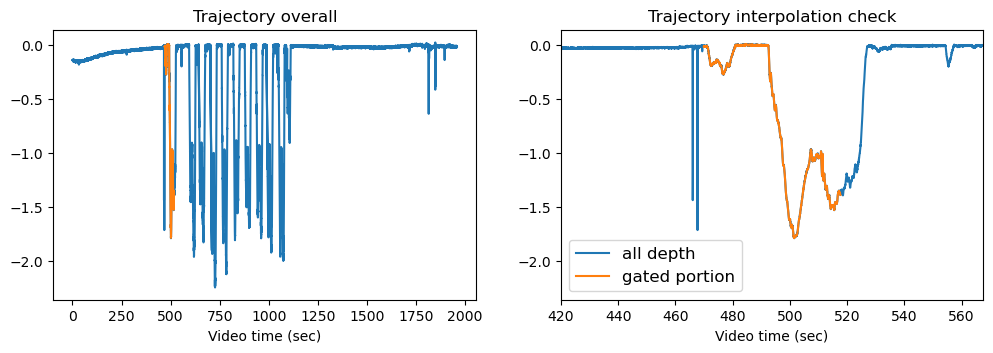

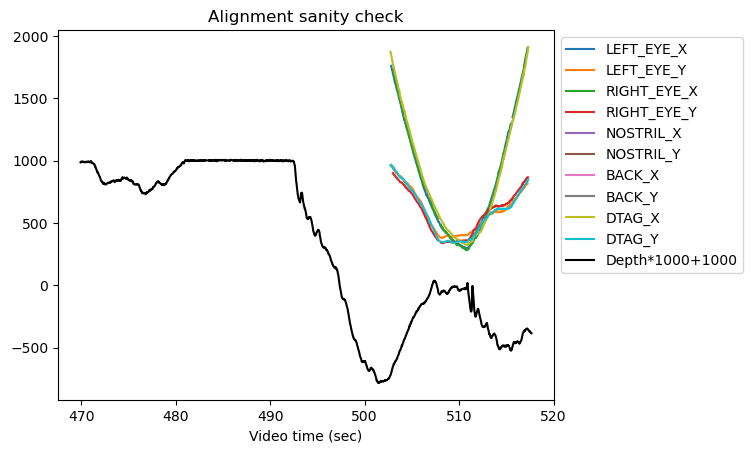

Save xypressure data to: 20190702_s1_t1_GOPR1481_xypressure.csv



---------------------------------------------------------
20190702_s1_t2, video: GOPR1481.MP4


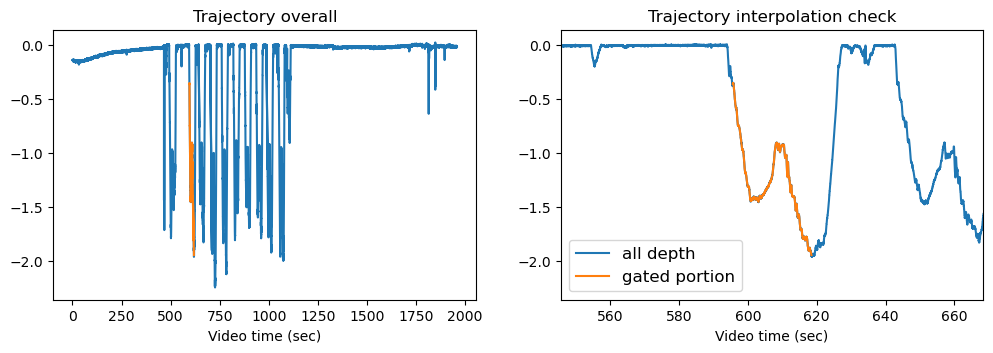

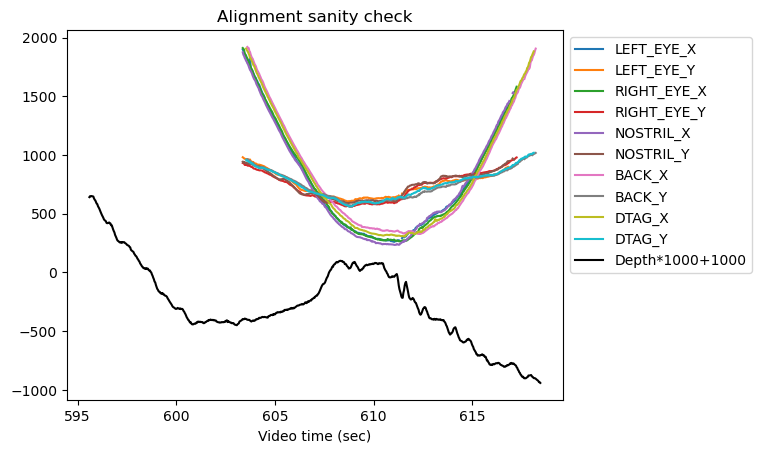

Save xypressure data to: 20190702_s1_t2_GOPR1481_xypressure.csv



---------------------------------------------------------
20190702_s1_t3, video: GOPR1481.MP4


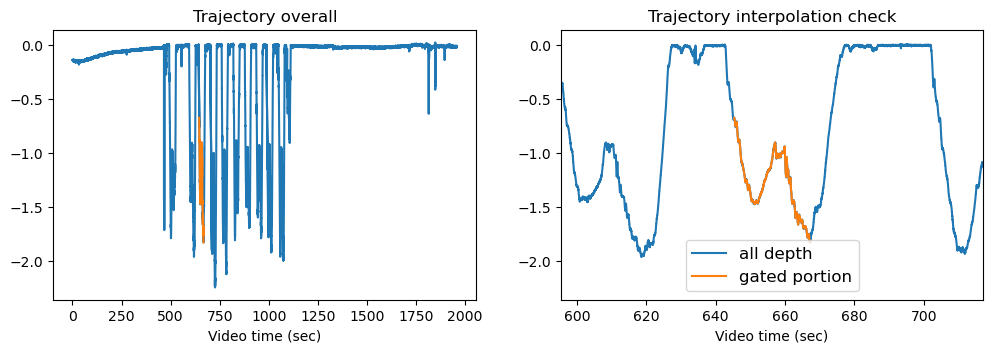

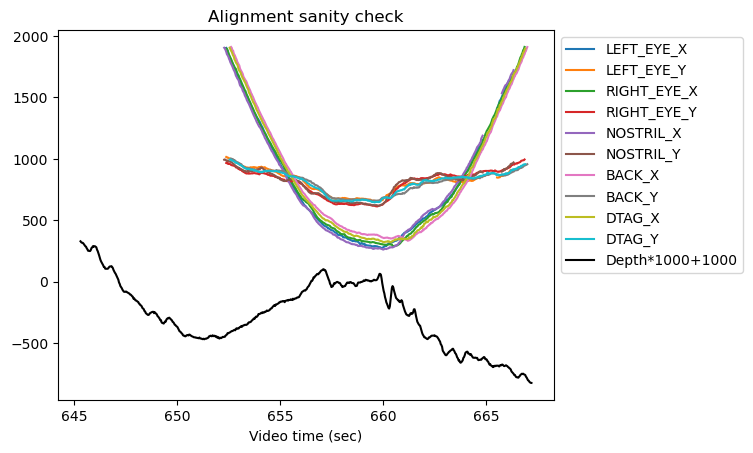

Save xypressure data to: 20190702_s1_t3_GOPR1481_xypressure.csv



---------------------------------------------------------
20190702_s1_t4, video: GOPR1481.MP4


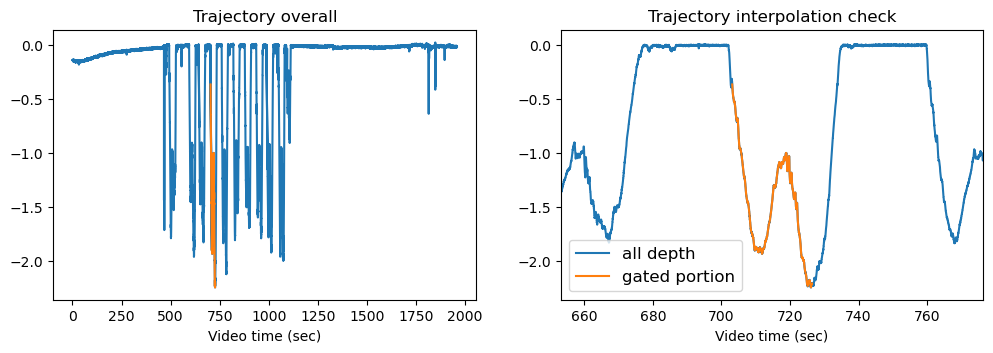

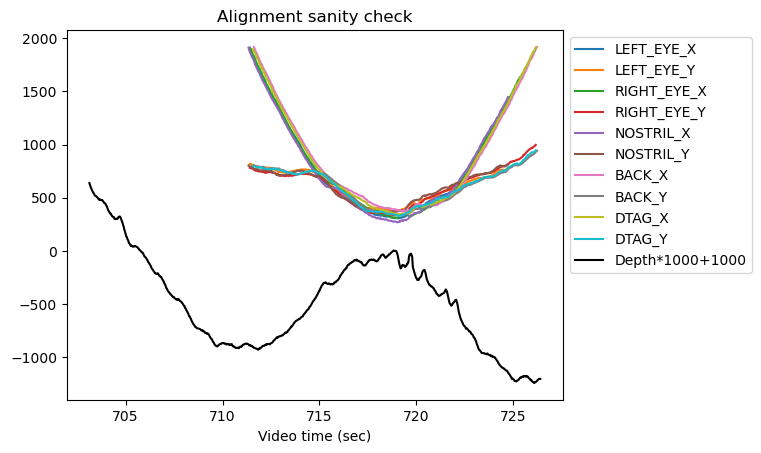

Save xypressure data to: 20190702_s1_t4_GOPR1481_xypressure.csv



---------------------------------------------------------
20190702_s1_t5, video: GOPR1481.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190702_s1_t6, video: GOPR1481.MP4


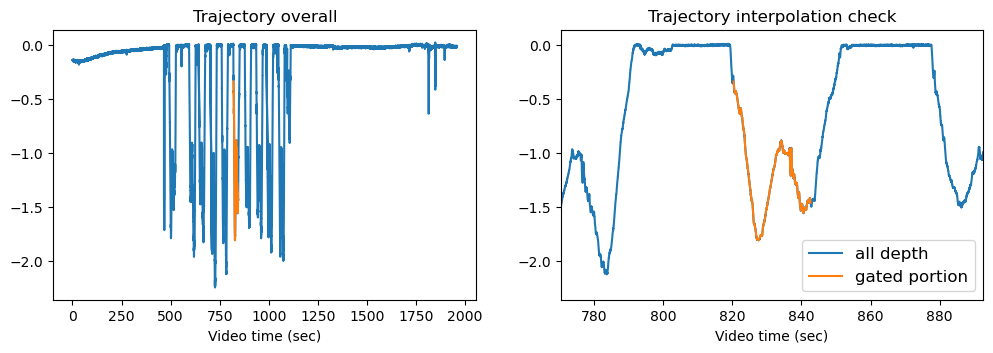

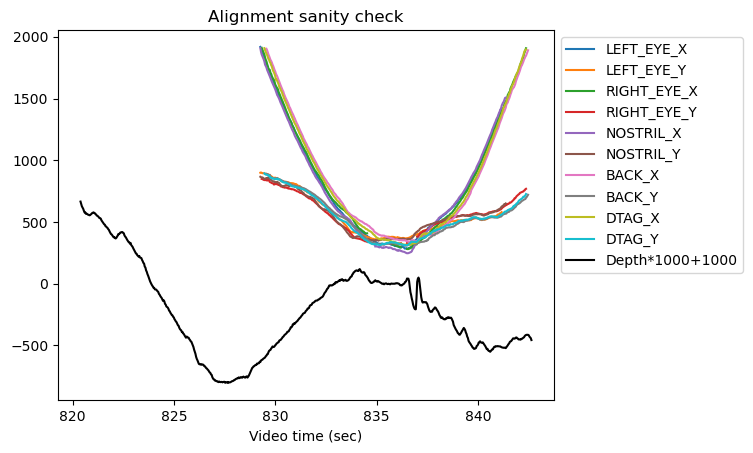

Save xypressure data to: 20190702_s1_t6_GOPR1481_xypressure.csv



---------------------------------------------------------
20190702_s1_t7, video: GOPR1481.MP4


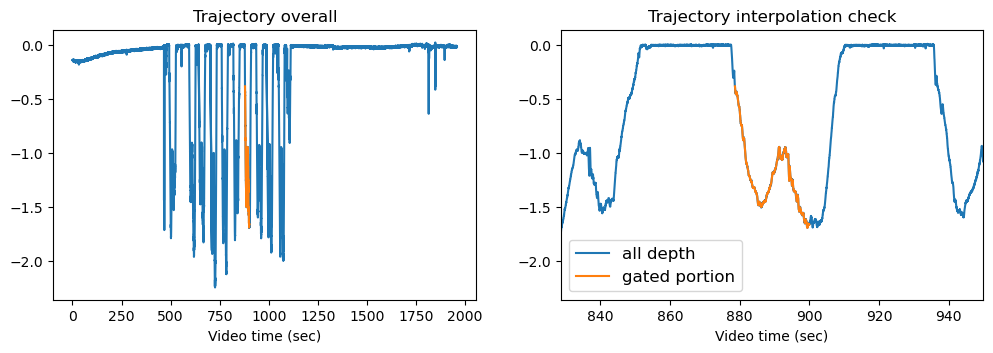

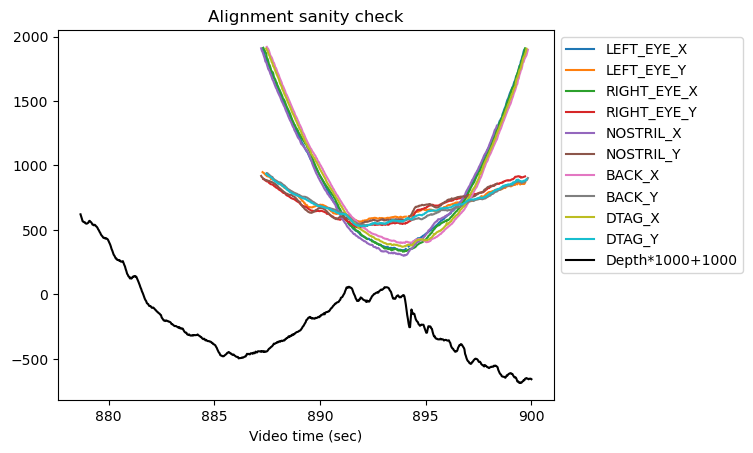

Save xypressure data to: 20190702_s1_t7_GOPR1481_xypressure.csv



---------------------------------------------------------
20190702_s1_t8, video: GOPR1481.MP4


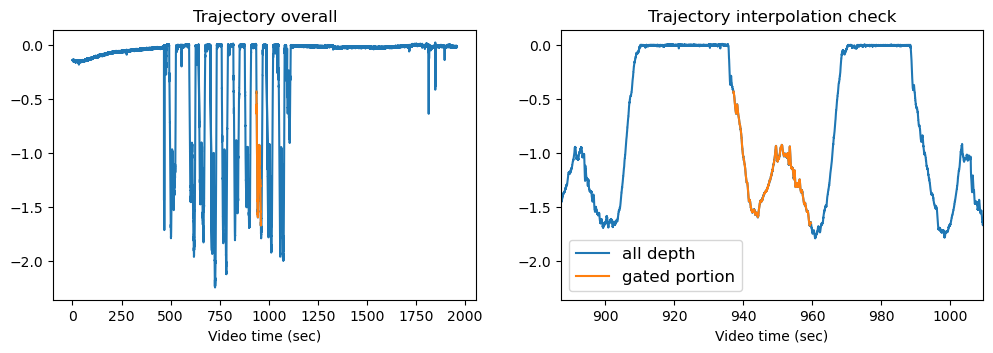

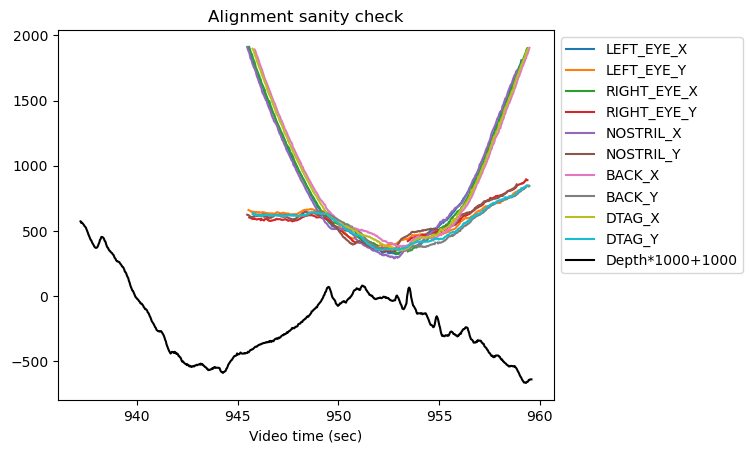

Save xypressure data to: 20190702_s1_t8_GOPR1481_xypressure.csv



---------------------------------------------------------
20190702_s1_t9, video: GOPR1481.MP4


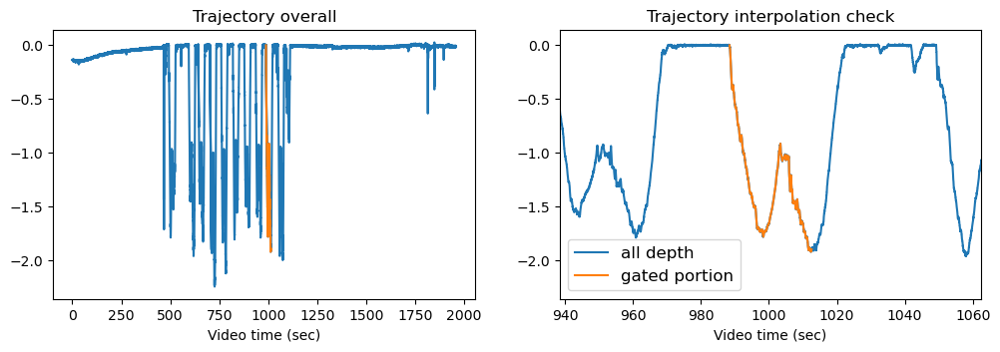

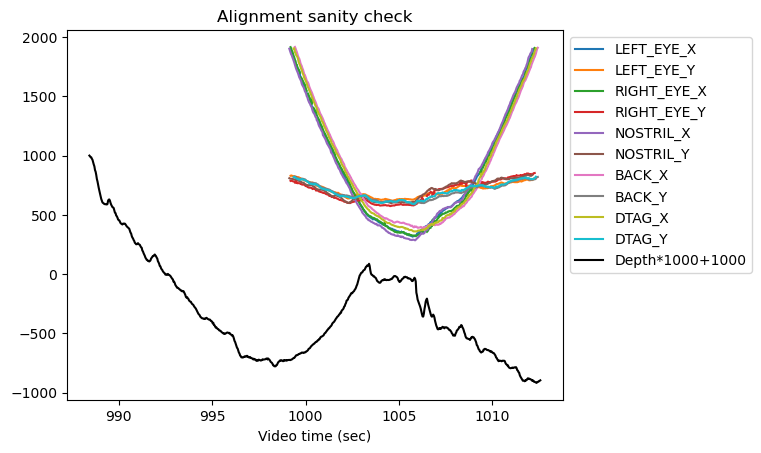

Save xypressure data to: 20190702_s1_t9_GOPR1481_xypressure.csv



---------------------------------------------------------
20190702_s1_t10, video: GP011481.MP4


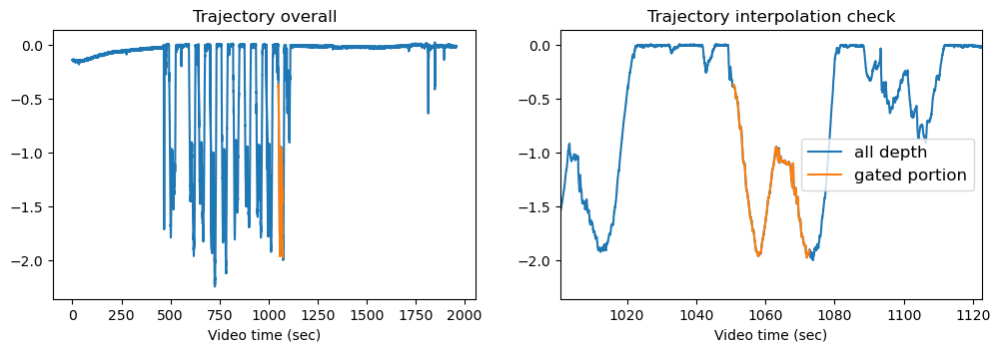

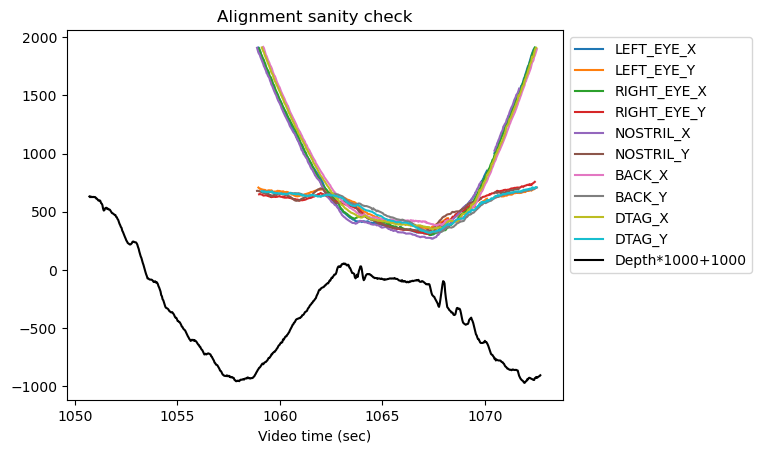

Save xypressure data to: 20190702_s1_t10_GP011481_xypressure.csv



---------------------------------------------------------
20190702_s2_t1, video: GOPR1482.MP4
Dtag tap sync does not exist, skipping this trial...



---------------------------------------------------------
20190702_s2_t2, video: GOPR1482.MP4
Dtag tap sync does not exist, skipping this trial...



---------------------------------------------------------
20190702_s2_t3, video: GOPR1482.MP4
Dtag tap sync does not exist, skipping this trial...



---------------------------------------------------------
20190702_s2_t4, video: GOPR1482.MP4
Dtag tap sync does not exist, skipping this trial...



---------------------------------------------------------
20190702_s2_t5, video: GOPR1482.MP4
Dtag tap sync does not exist, skipping this trial...



---------------------------------------------------------
20190702_s2_t6, video: GOPR1482.MP4
Dtag tap sync does not exist, skipping this trial...



--------------------------------

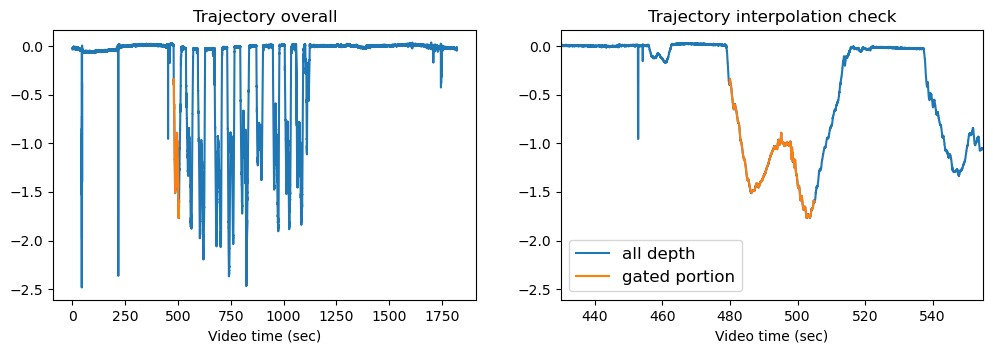

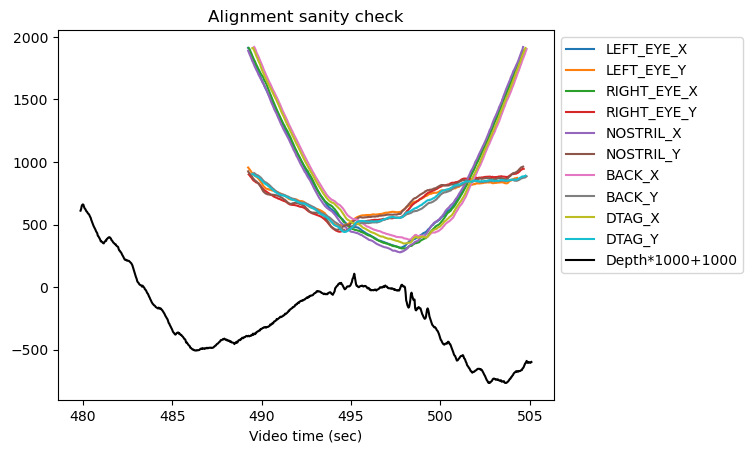

Save xypressure data to: 20190702_s3_t1_GOPR1483_xypressure.csv



---------------------------------------------------------
20190702_s3_t2, video: GOPR1483.MP4


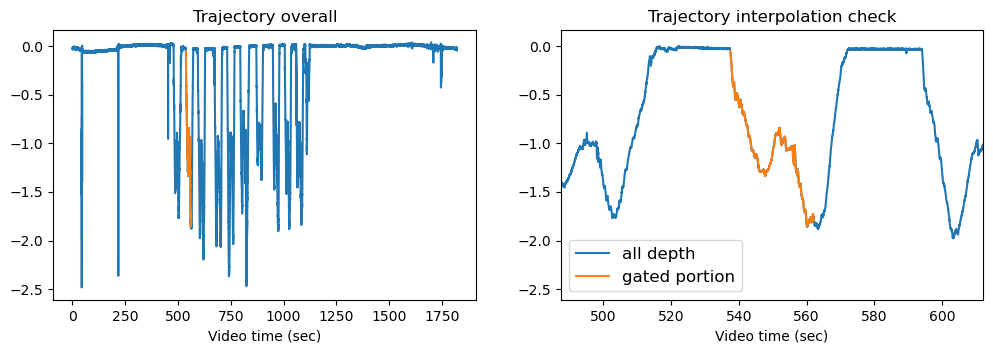

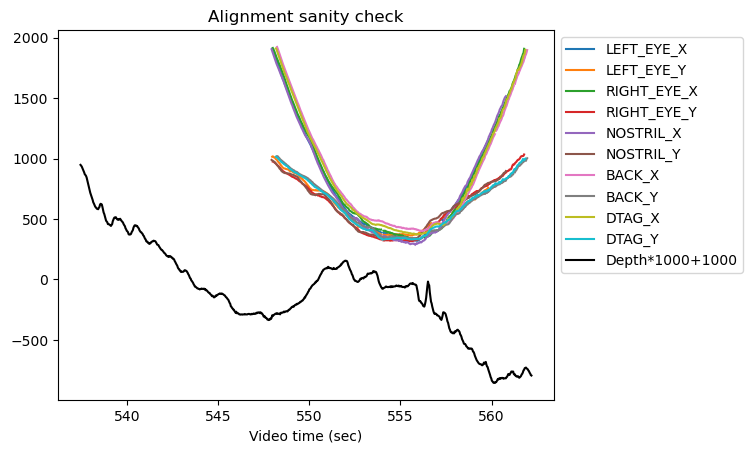

Save xypressure data to: 20190702_s3_t2_GOPR1483_xypressure.csv



---------------------------------------------------------
20190702_s3_t3, video: GOPR1483.MP4


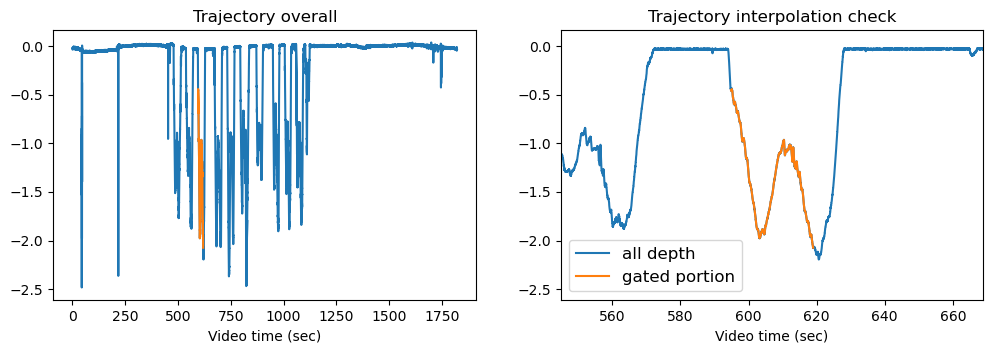

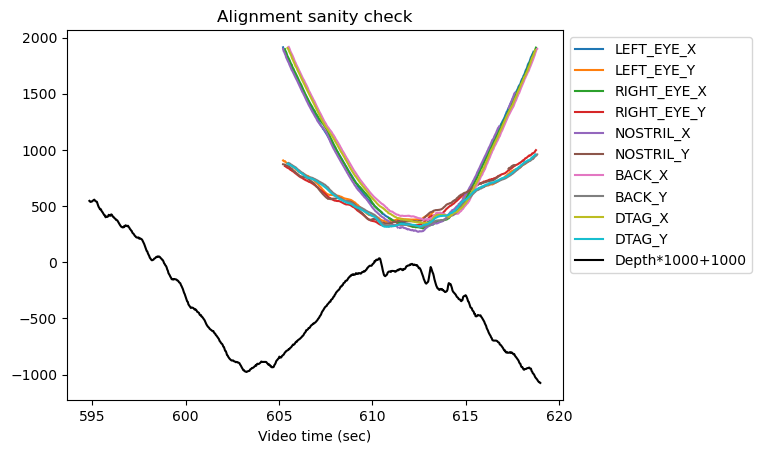

Save xypressure data to: 20190702_s3_t3_GOPR1483_xypressure.csv



---------------------------------------------------------
20190702_s3_t4, video: GOPR1483.MP4


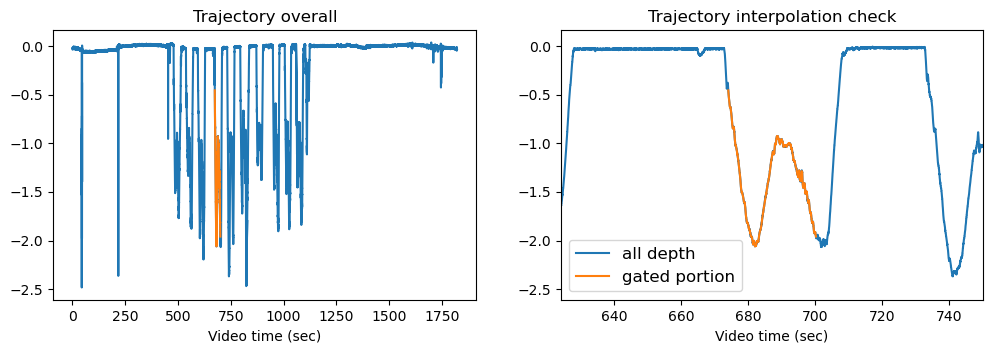

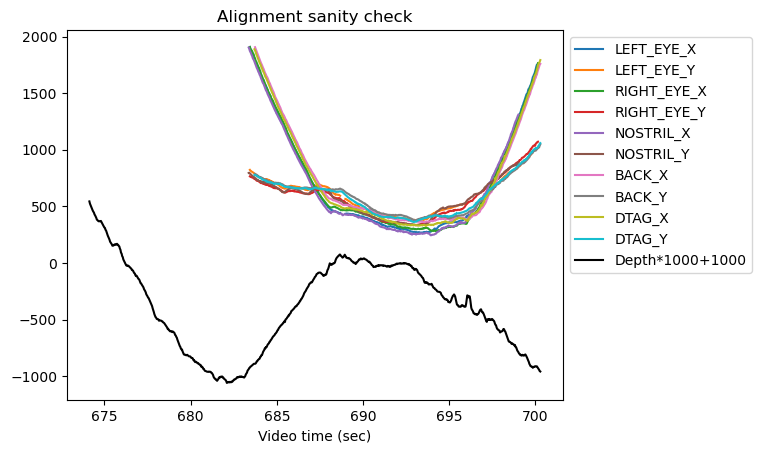

Save xypressure data to: 20190702_s3_t4_GOPR1483_xypressure.csv



---------------------------------------------------------
20190702_s3_t5, video: GOPR1483.MP4


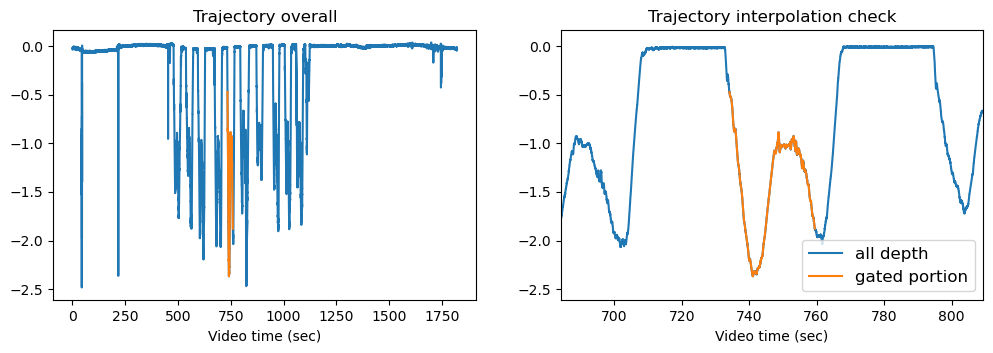

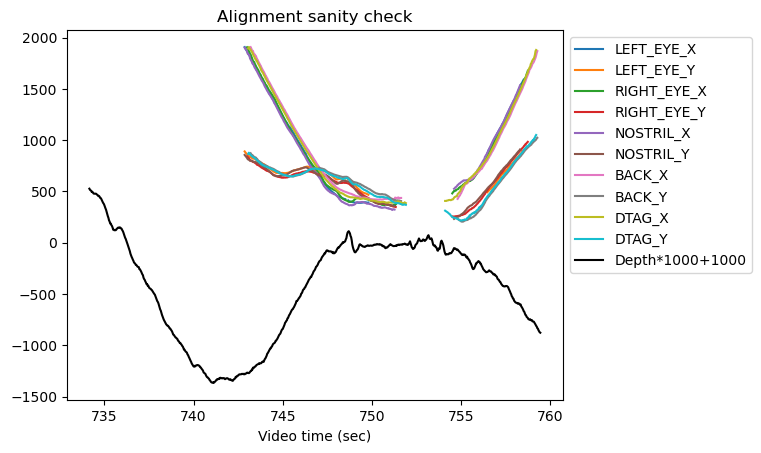

Save xypressure data to: 20190702_s3_t5_GOPR1483_xypressure.csv



---------------------------------------------------------
20190702_s3_t6, video: GOPR1483.MP4


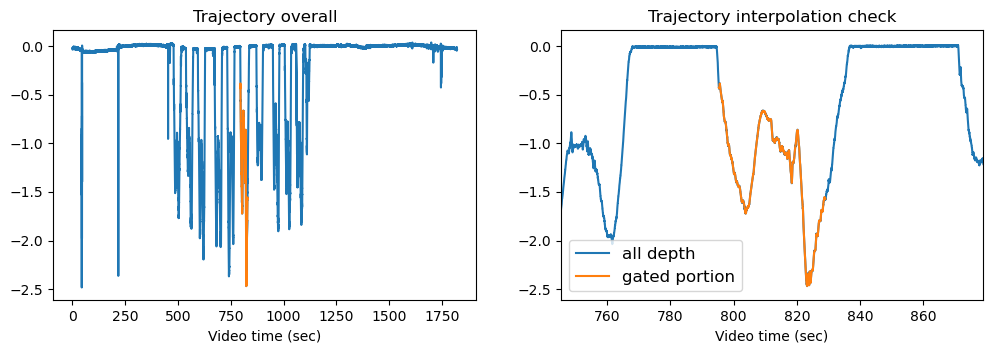

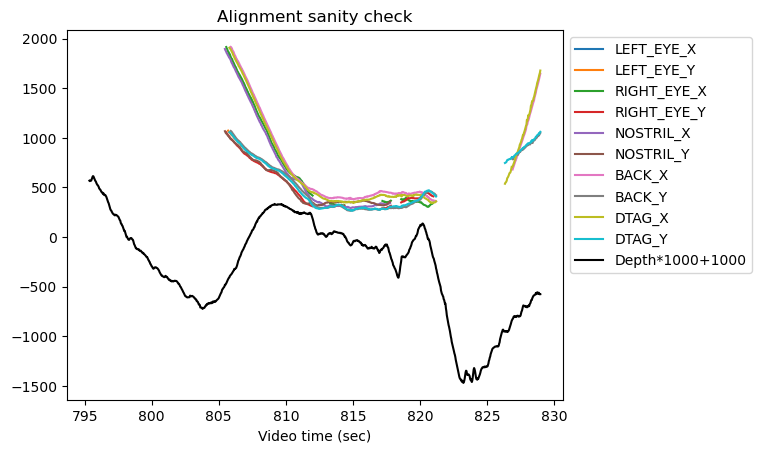

Save xypressure data to: 20190702_s3_t6_GOPR1483_xypressure.csv



---------------------------------------------------------
20190702_s3_t7, video: GOPR1483.MP4


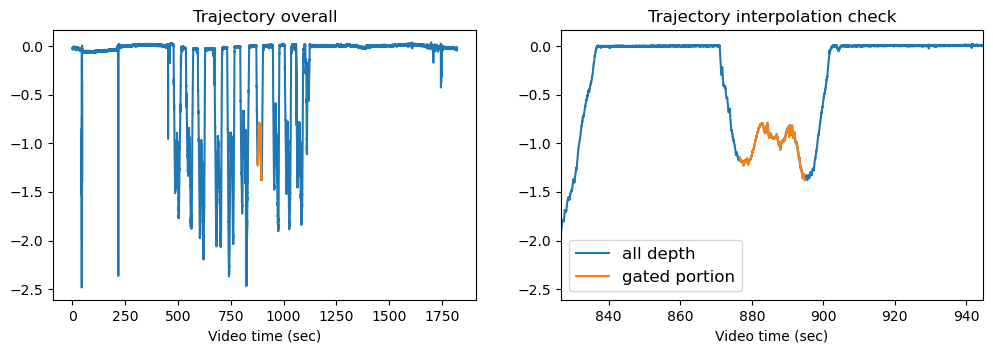

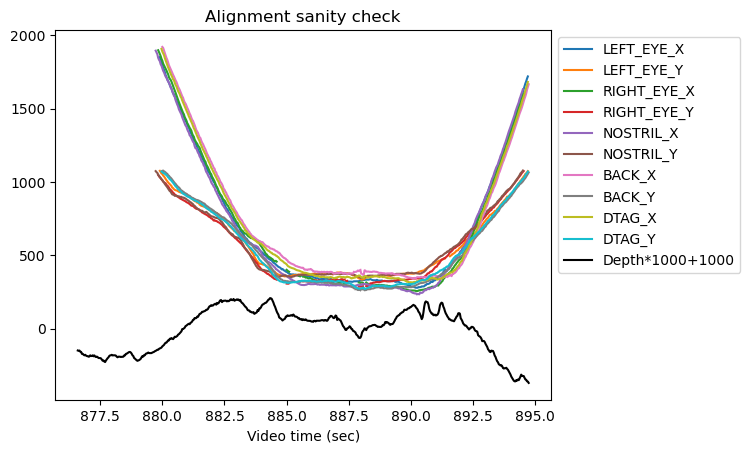

Save xypressure data to: 20190702_s3_t7_GOPR1483_xypressure.csv



---------------------------------------------------------
20190702_s3_t8, video: GOPR1483.MP4


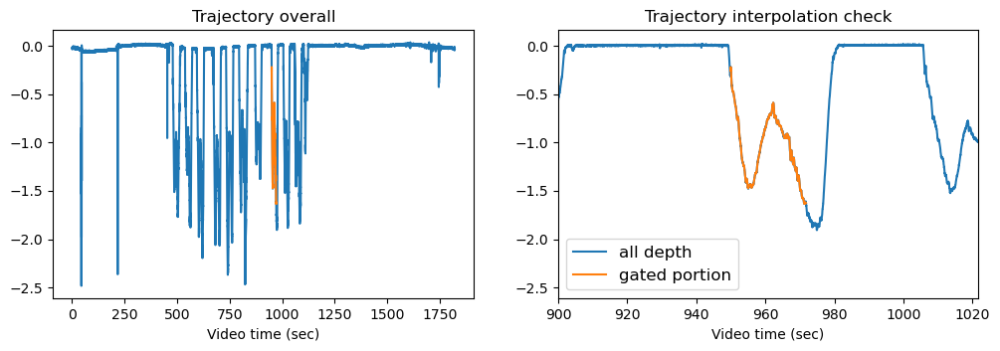

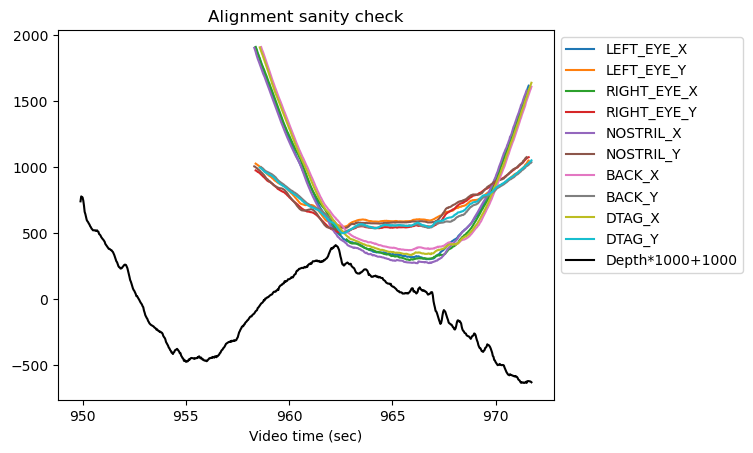

Save xypressure data to: 20190702_s3_t8_GOPR1483_xypressure.csv



---------------------------------------------------------
20190702_s3_t9, video: GOPR1483.MP4


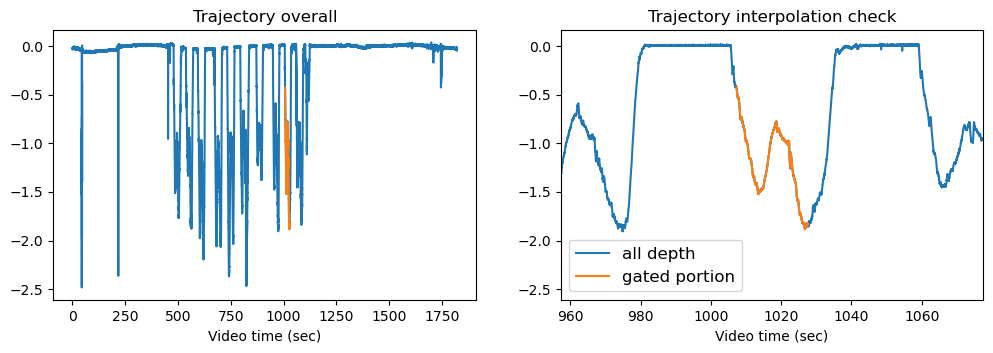

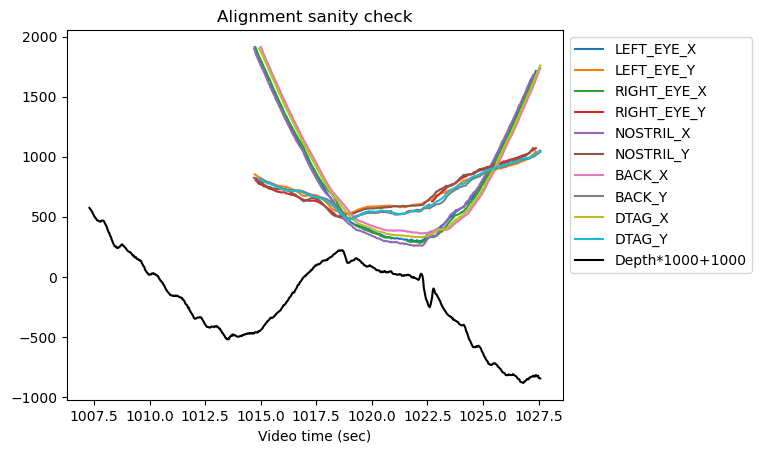

Save xypressure data to: 20190702_s3_t9_GOPR1483_xypressure.csv



---------------------------------------------------------
20190702_s3_t10, video: GP011483.MP4


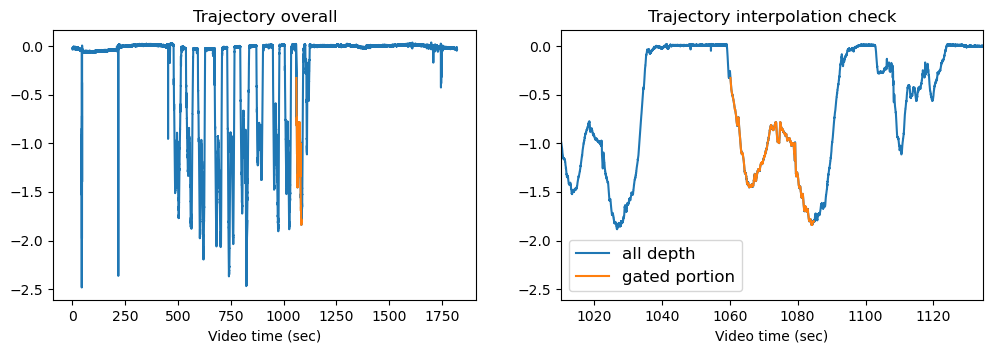

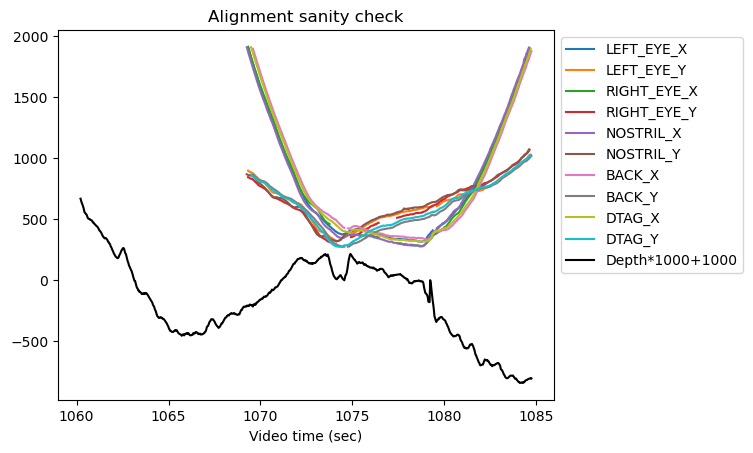

Save xypressure data to: 20190702_s3_t10_GP011483_xypressure.csv



---------------------------------------------------------
20190703_s1_t1, video: GOPR1484.MP4


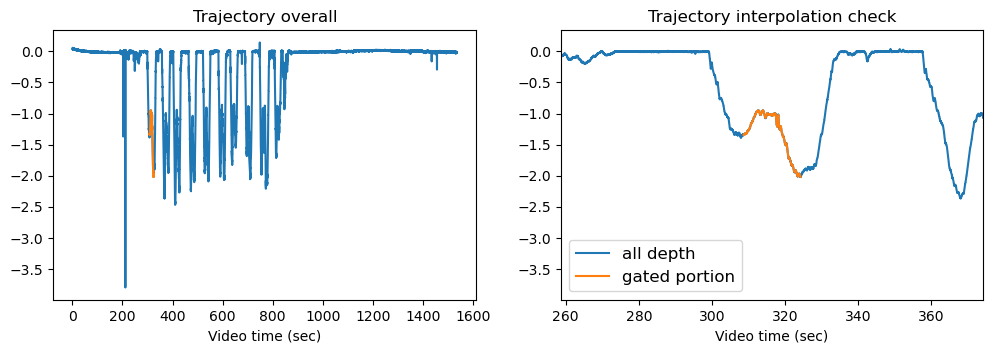

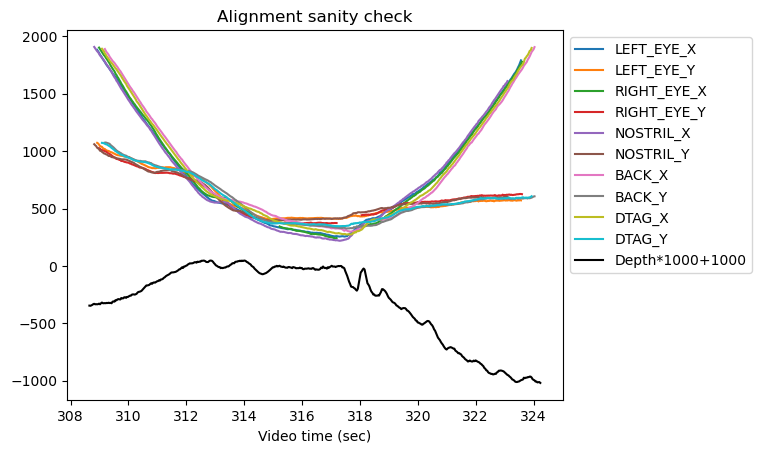

Save xypressure data to: 20190703_s1_t1_GOPR1484_xypressure.csv



---------------------------------------------------------
20190703_s1_t2, video: GOPR1484.MP4


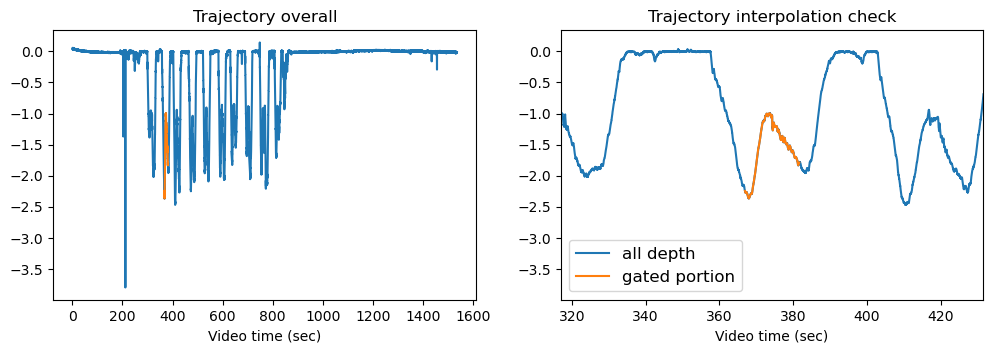

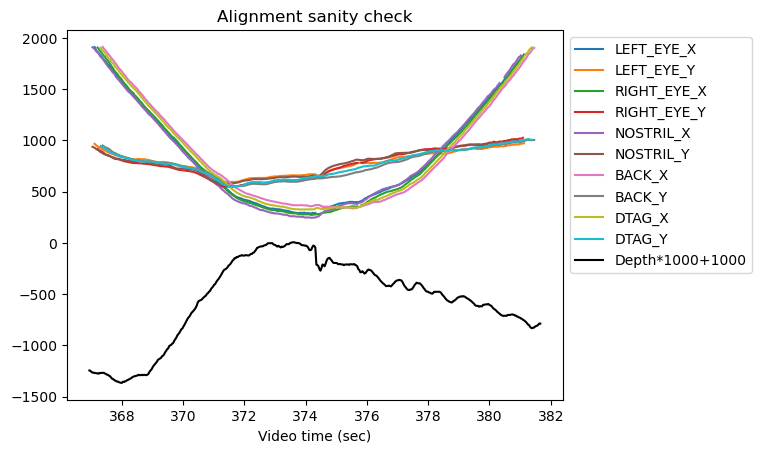

Save xypressure data to: 20190703_s1_t2_GOPR1484_xypressure.csv



---------------------------------------------------------
20190703_s1_t3, video: GOPR1484.MP4


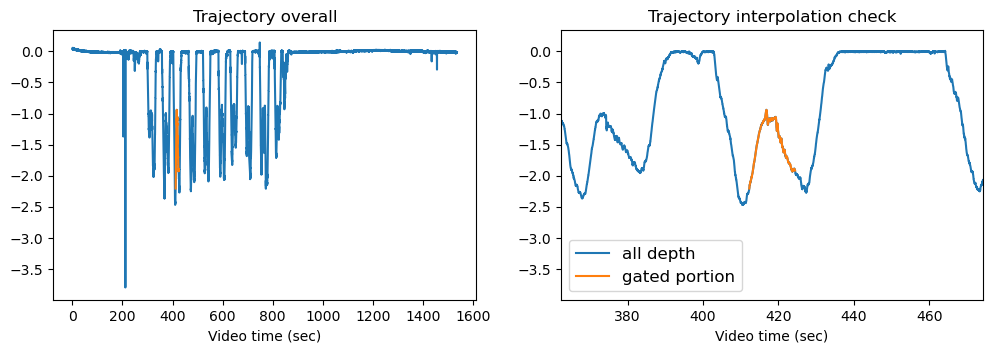

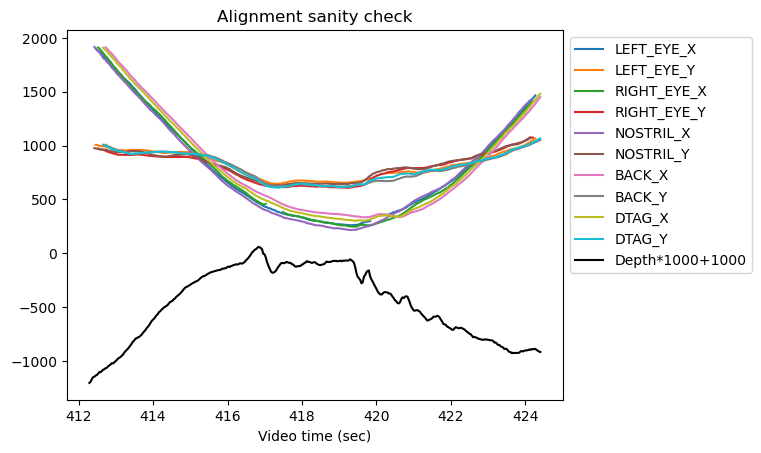

Save xypressure data to: 20190703_s1_t3_GOPR1484_xypressure.csv



---------------------------------------------------------
20190703_s1_t4, video: GOPR1484.MP4


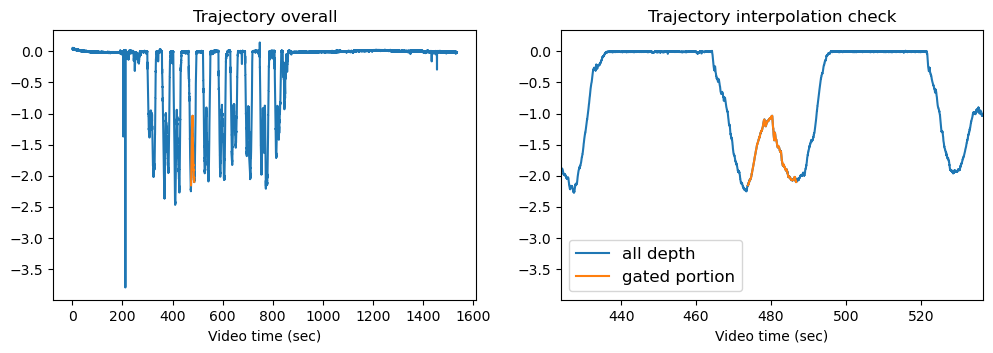

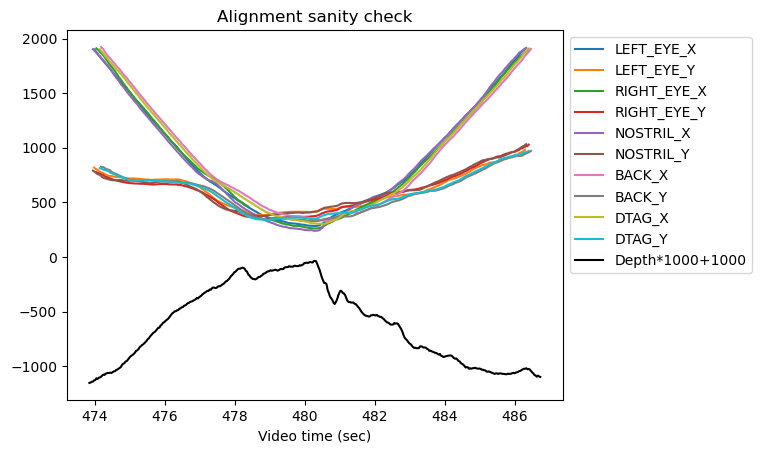

Save xypressure data to: 20190703_s1_t4_GOPR1484_xypressure.csv



---------------------------------------------------------
20190703_s1_t5, video: GOPR1484.MP4


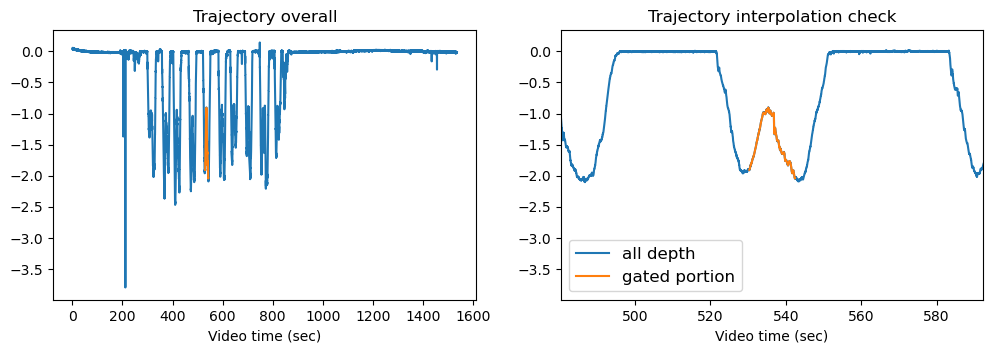

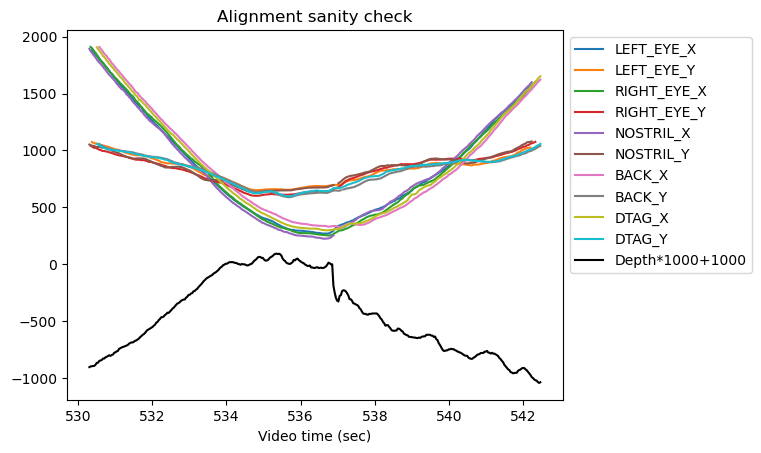

Save xypressure data to: 20190703_s1_t5_GOPR1484_xypressure.csv



---------------------------------------------------------
20190703_s1_t6, video: GOPR1484.MP4


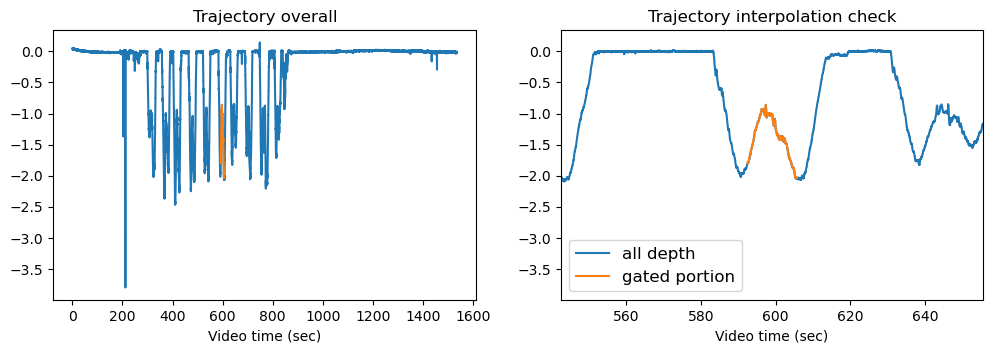

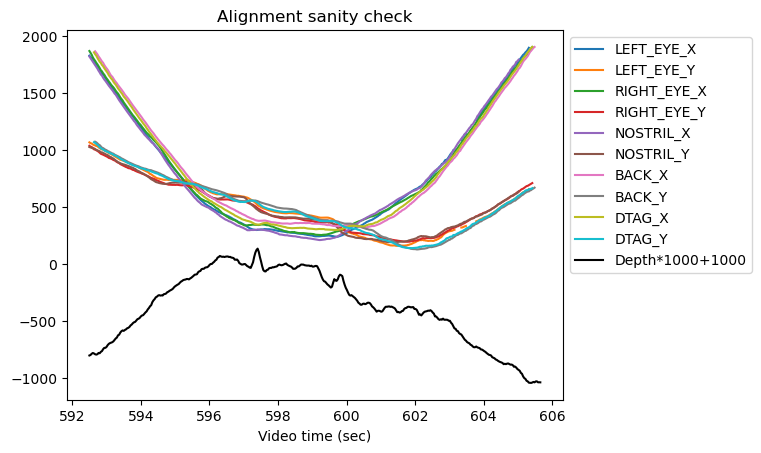

Save xypressure data to: 20190703_s1_t6_GOPR1484_xypressure.csv



---------------------------------------------------------
20190703_s1_t7, video: GOPR1484.MP4


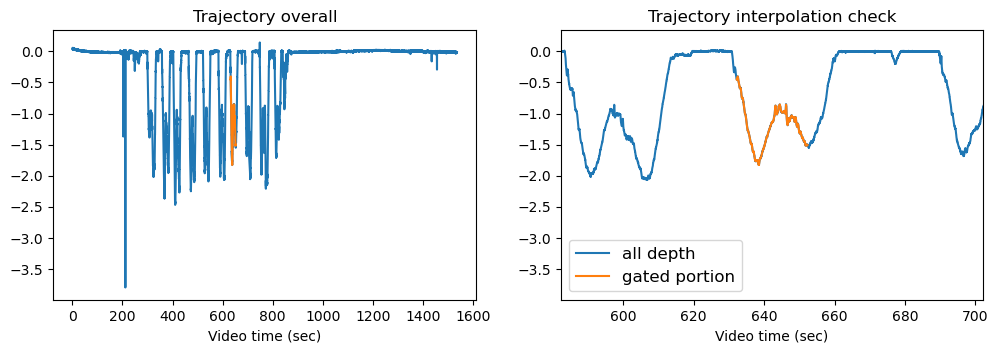

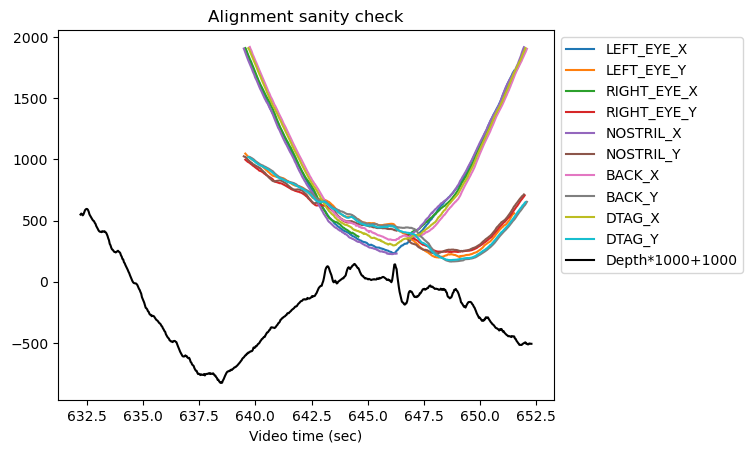

Save xypressure data to: 20190703_s1_t7_GOPR1484_xypressure.csv



---------------------------------------------------------
20190703_s1_t8, video: GOPR1484.MP4


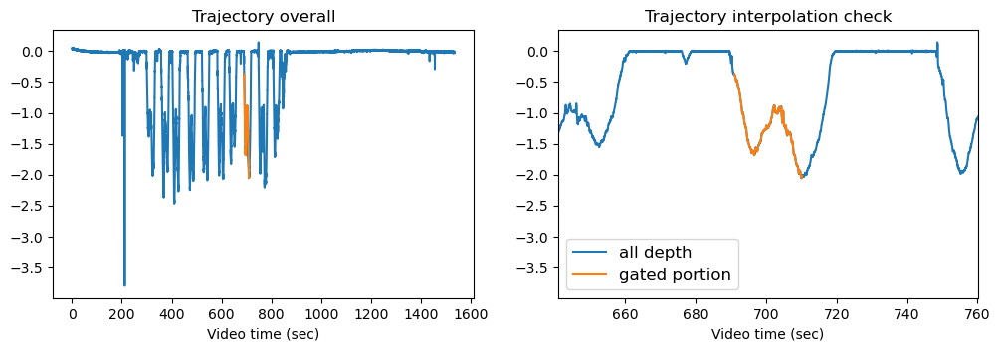

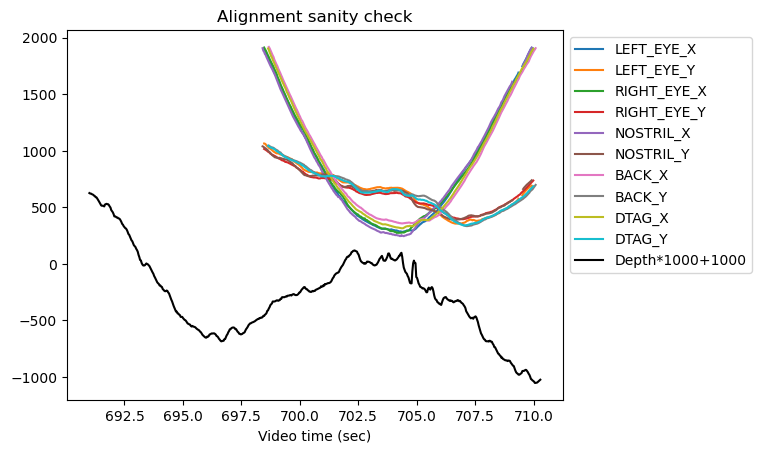

Save xypressure data to: 20190703_s1_t8_GOPR1484_xypressure.csv



---------------------------------------------------------
20190703_s1_t9, video: GOPR1484.MP4


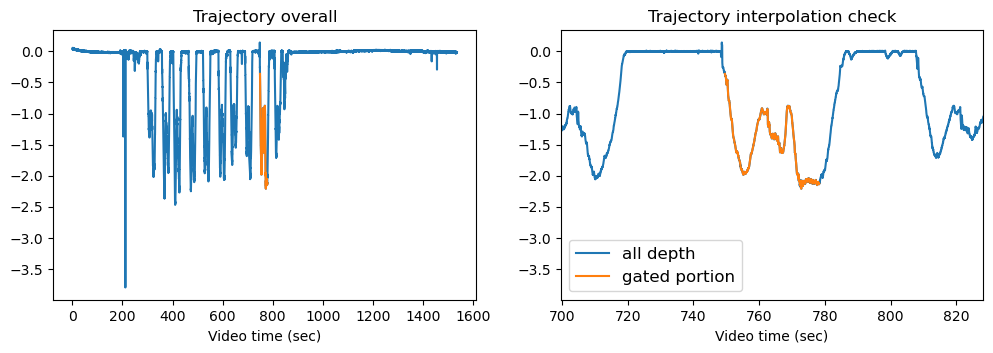

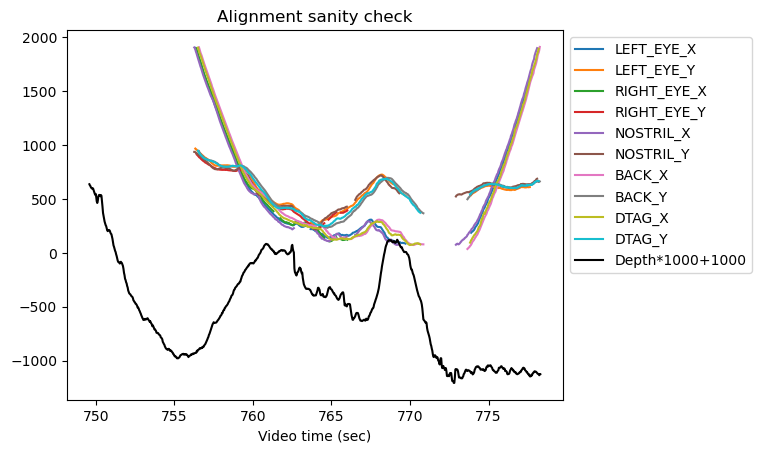

Save xypressure data to: 20190703_s1_t9_GOPR1484_xypressure.csv



---------------------------------------------------------
20190703_s1_t10, video: GOPR1484.MP4


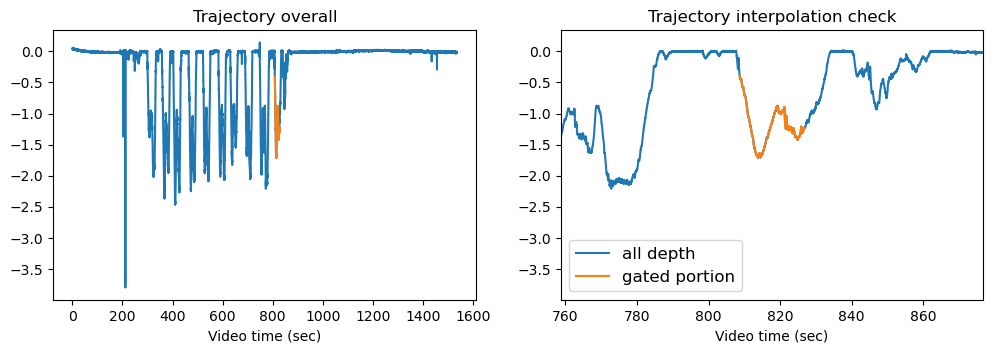

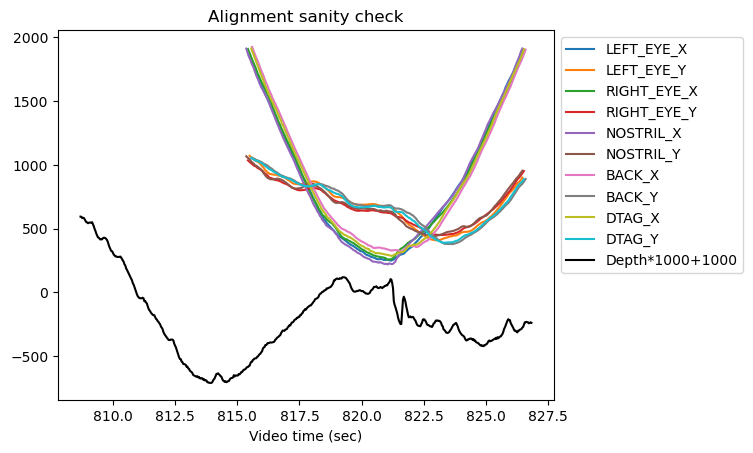

Save xypressure data to: 20190703_s1_t10_GOPR1484_xypressure.csv



---------------------------------------------------------
20190703_s2_t1, video: GOPR1485.MP4


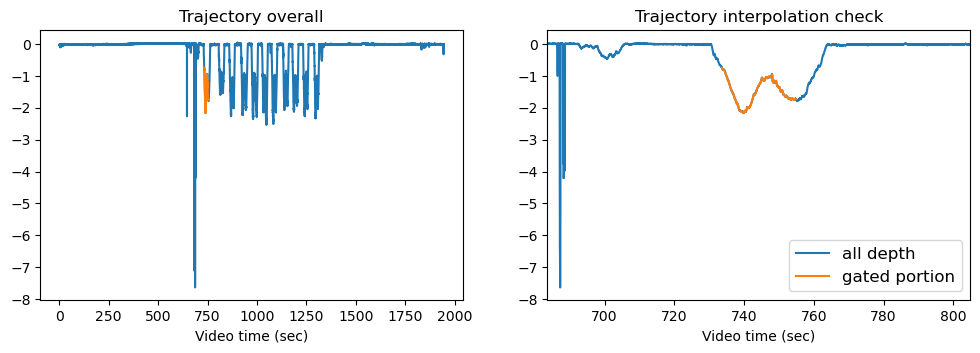

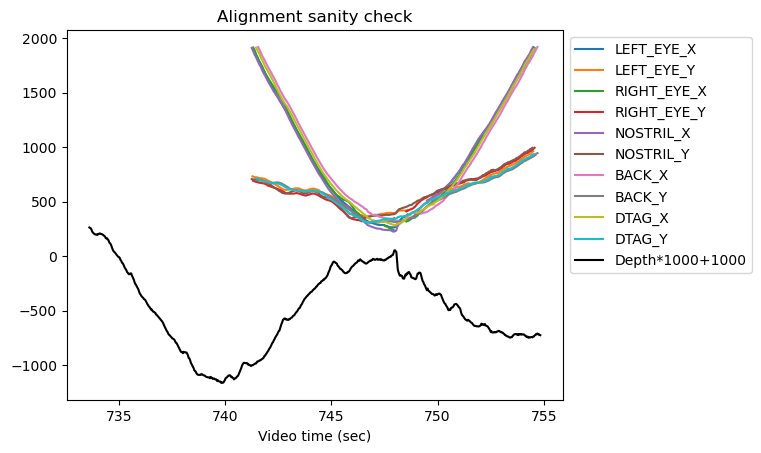

Save xypressure data to: 20190703_s2_t1_GOPR1485_xypressure.csv



---------------------------------------------------------
20190703_s2_t2, video: GOPR1485.MP4


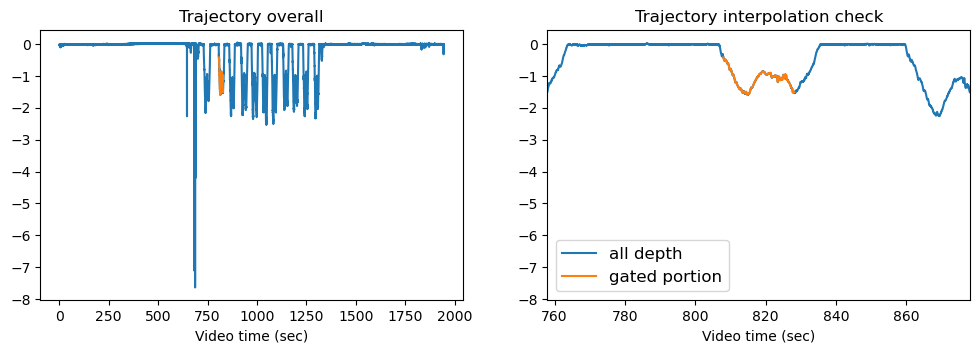

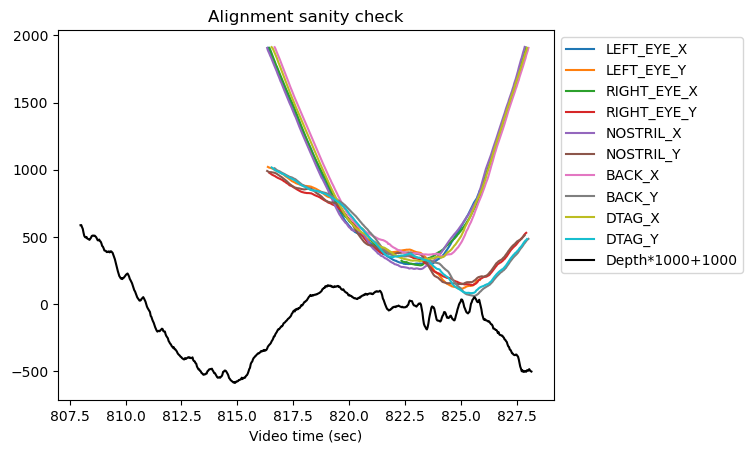

Save xypressure data to: 20190703_s2_t2_GOPR1485_xypressure.csv



---------------------------------------------------------
20190703_s2_t3, video: GOPR1485.MP4


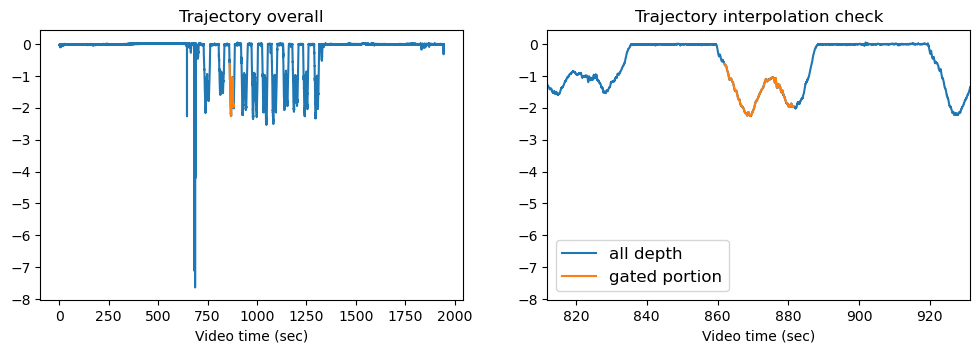

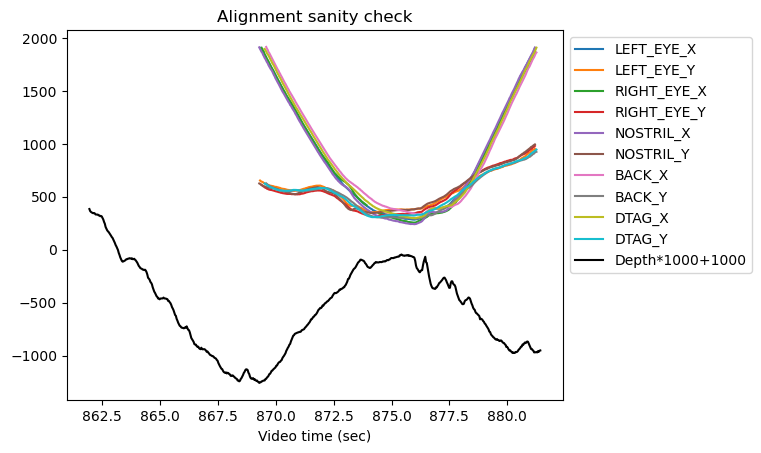

Save xypressure data to: 20190703_s2_t3_GOPR1485_xypressure.csv



---------------------------------------------------------
20190703_s2_t4, video: GOPR1485.MP4


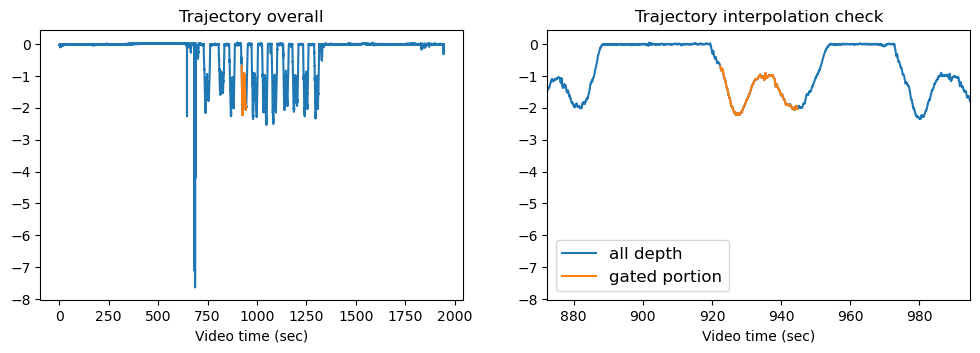

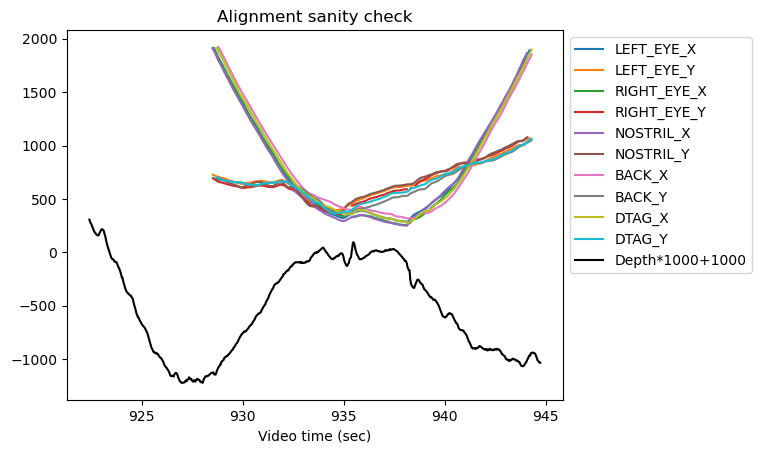

Save xypressure data to: 20190703_s2_t4_GOPR1485_xypressure.csv



---------------------------------------------------------
20190703_s2_t5, video: GOPR1485.MP4


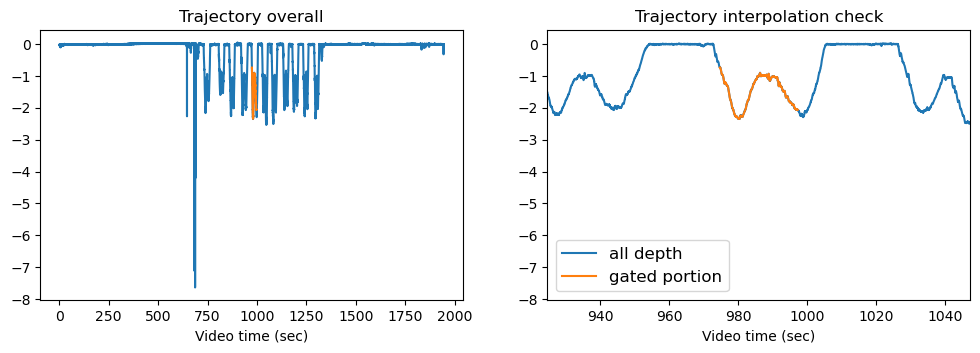

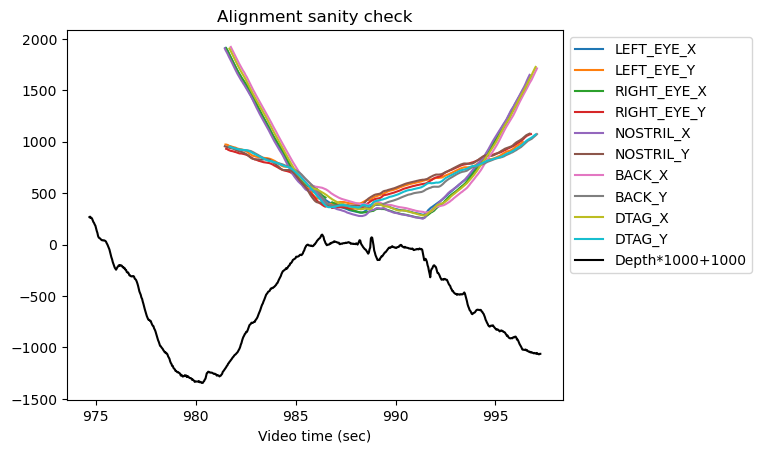

Save xypressure data to: 20190703_s2_t5_GOPR1485_xypressure.csv



---------------------------------------------------------
20190703_s2_t6, video: GOPR1485.MP4 + GP011485.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190703_s2_t7, video: GP011485.MP4


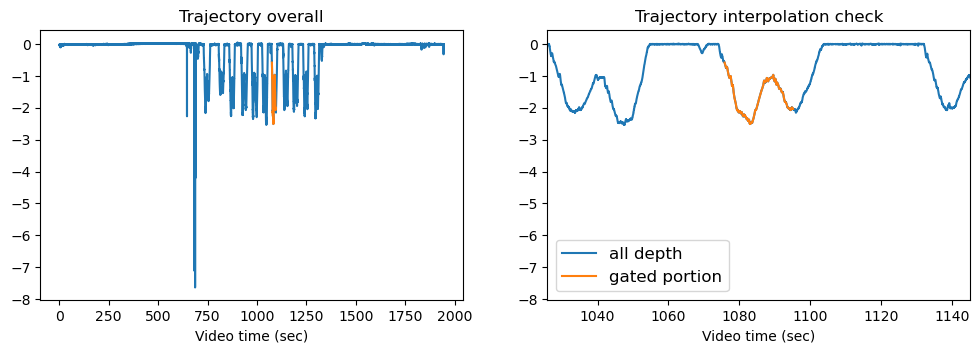

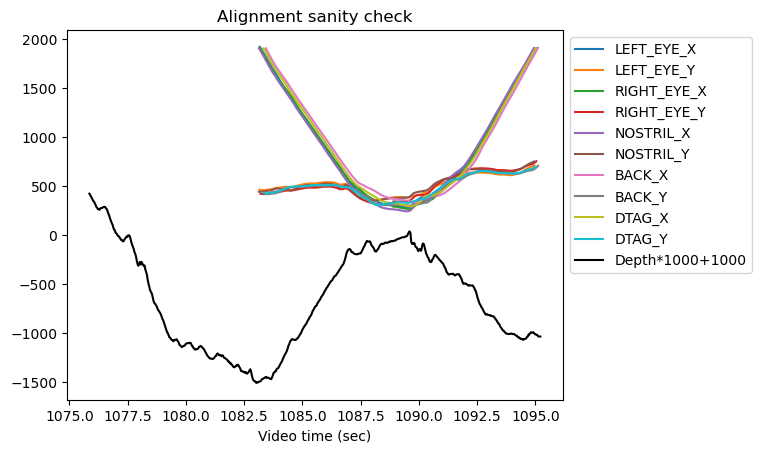

Save xypressure data to: 20190703_s2_t7_GP011485_xypressure.csv



---------------------------------------------------------
20190703_s2_t8, video: GP011485.MP4


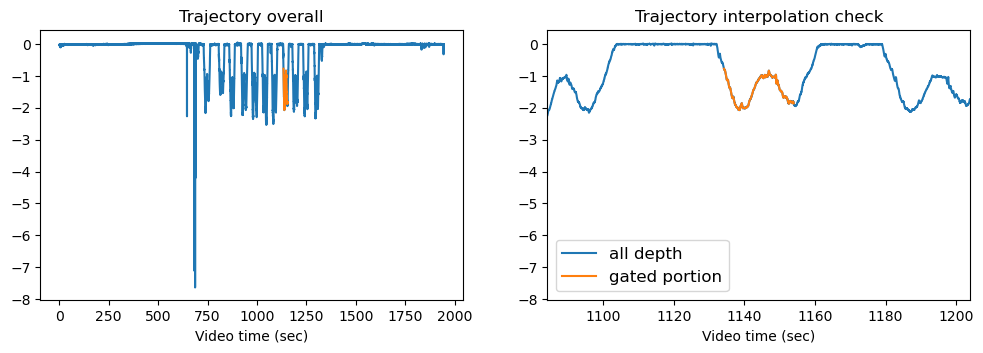

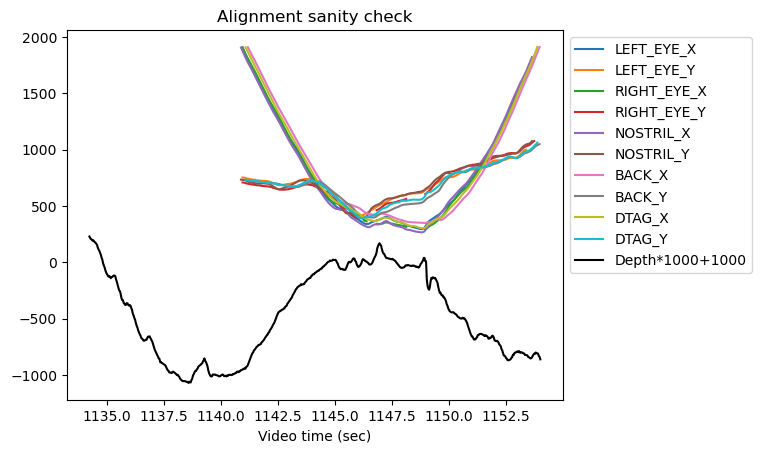

Save xypressure data to: 20190703_s2_t8_GP011485_xypressure.csv



---------------------------------------------------------
20190703_s2_t9, video: GP011485.MP4


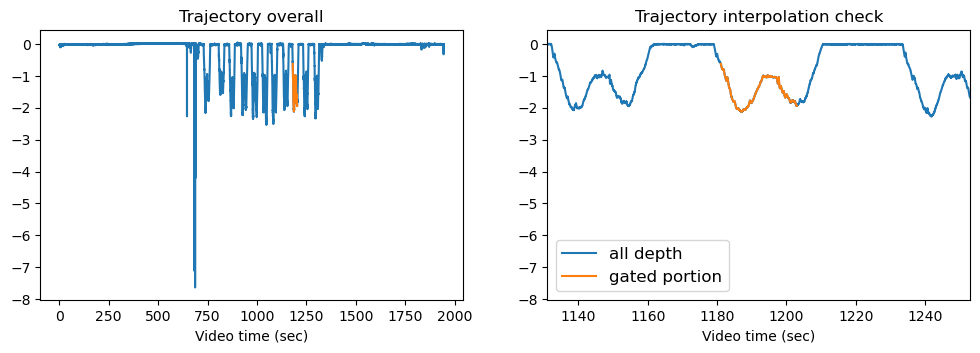

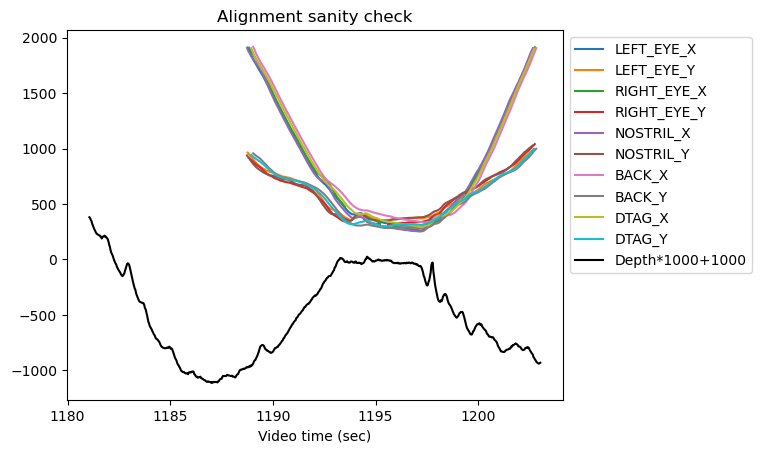

Save xypressure data to: 20190703_s2_t9_GP011485_xypressure.csv



---------------------------------------------------------
20190703_s2_t10, video: GP011485.MP4


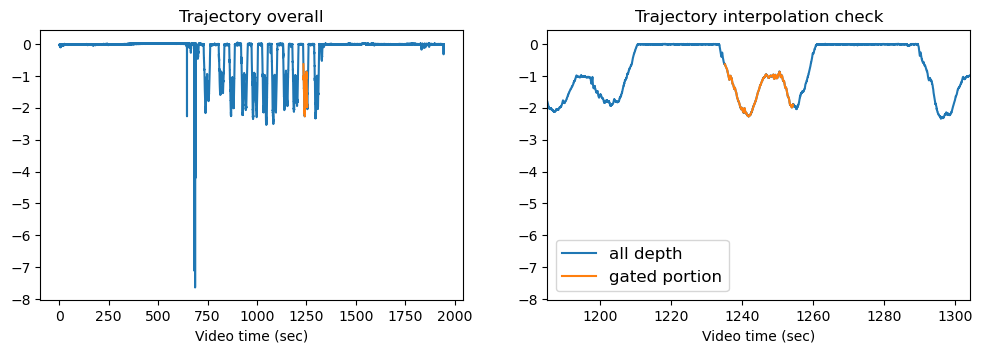

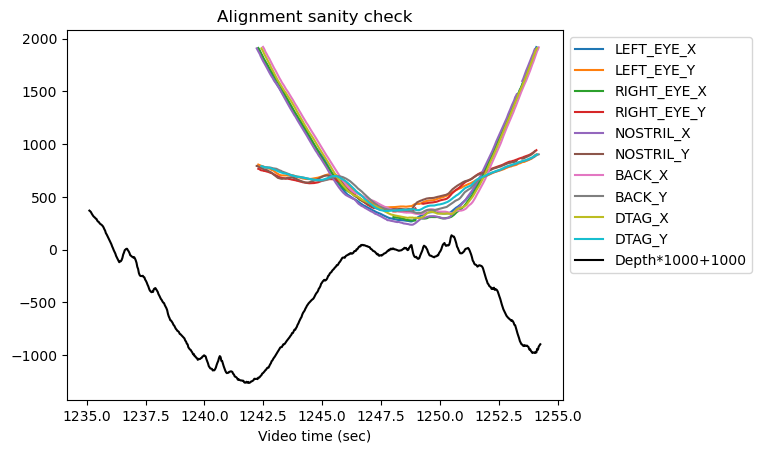

Save xypressure data to: 20190703_s2_t10_GP011485_xypressure.csv



---------------------------------------------------------
20190703_s2_t11, video: GP011485.MP4


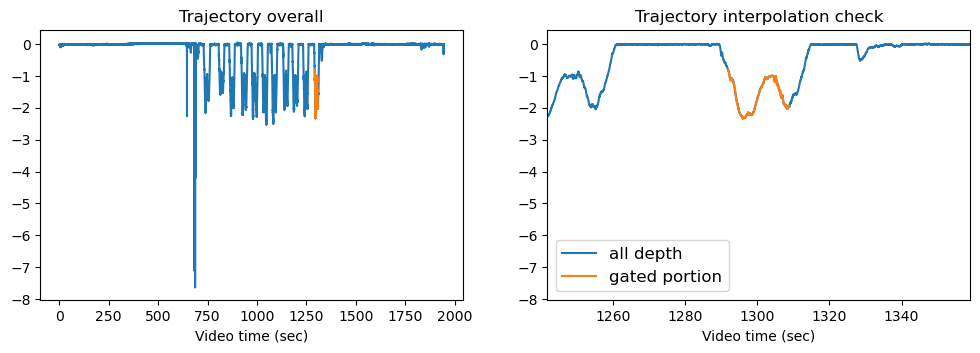

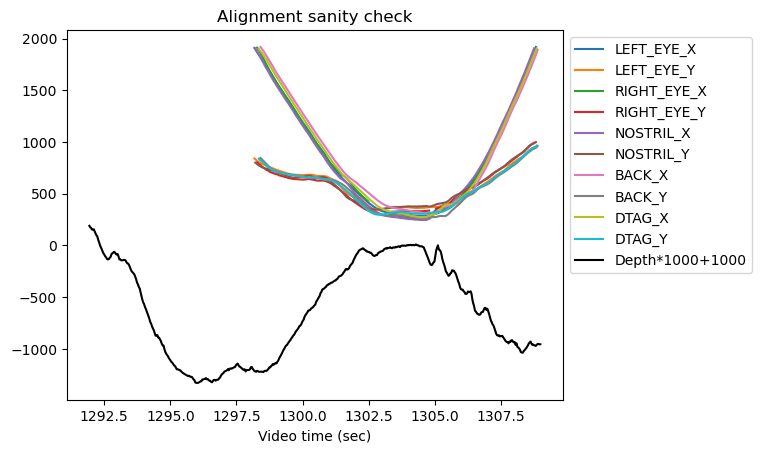

Save xypressure data to: 20190703_s2_t11_GP011485_xypressure.csv



---------------------------------------------------------
20190703_s3_t1, video: GOPR1486.MP4


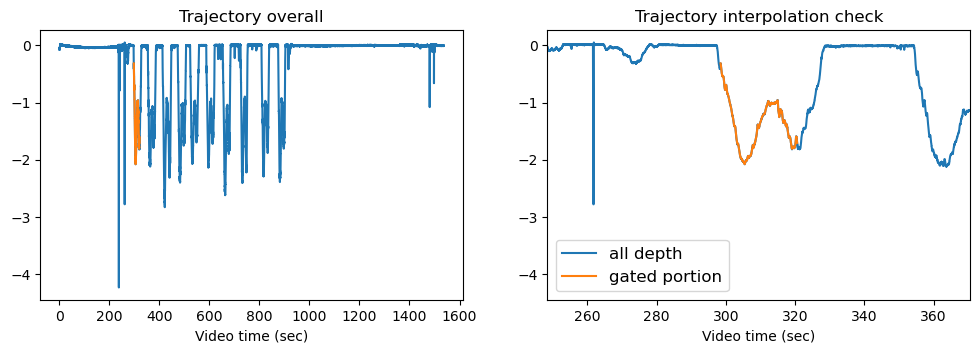

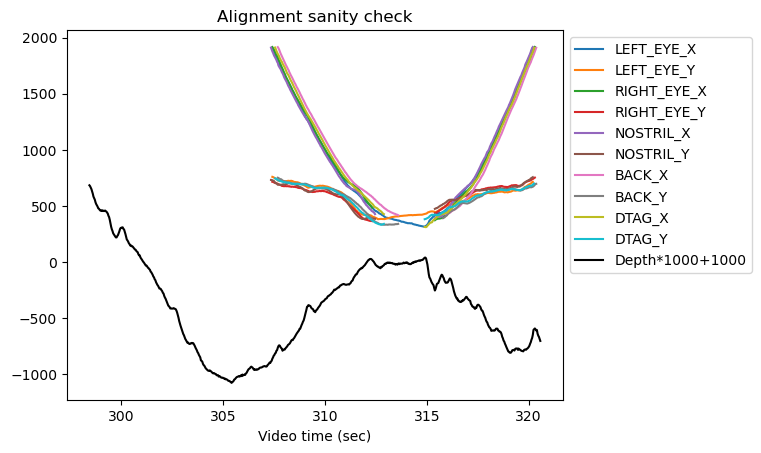

Save xypressure data to: 20190703_s3_t1_GOPR1486_xypressure.csv



---------------------------------------------------------
20190703_s3_t2, video: GOPR1486.MP4


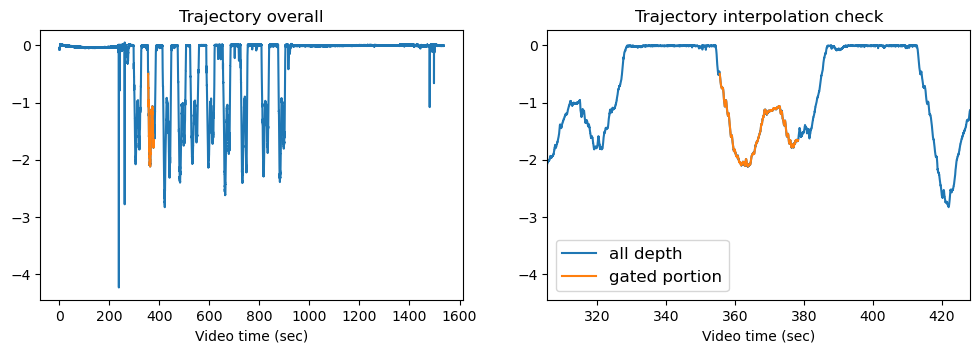

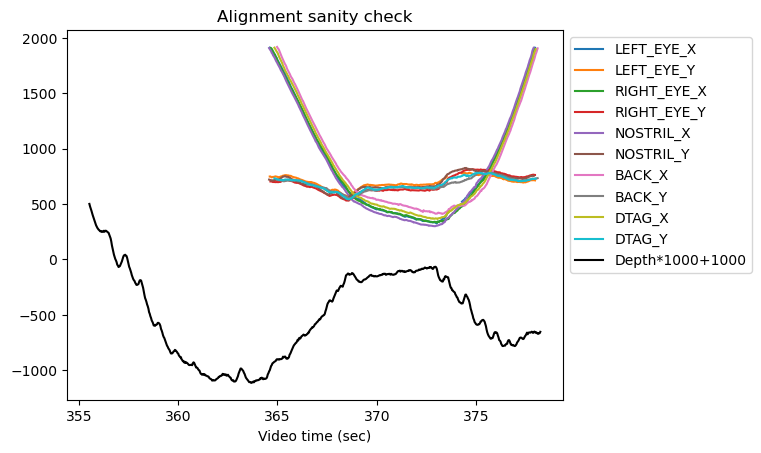

Save xypressure data to: 20190703_s3_t2_GOPR1486_xypressure.csv



---------------------------------------------------------
20190703_s3_t3, video: GOPR1486.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190703_s3_t4, video: GOPR1486.MP4


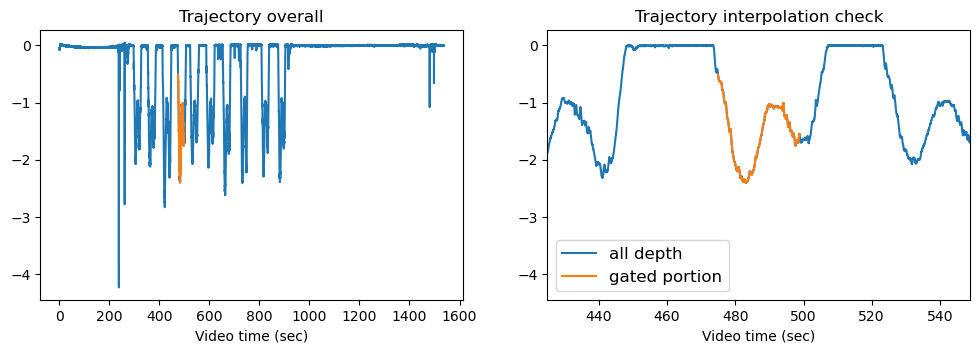

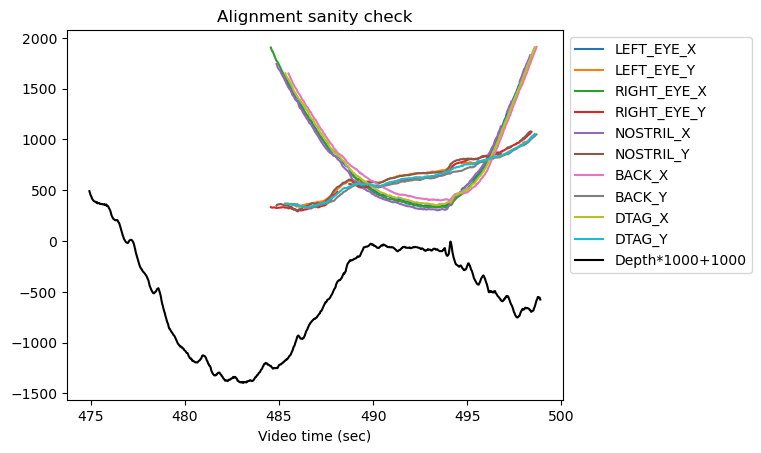

Save xypressure data to: 20190703_s3_t4_GOPR1486_xypressure.csv



---------------------------------------------------------
20190703_s3_t5, video: GOPR1486.MP4
Not included in wanted track with 1 video, skipping this trial...



---------------------------------------------------------
20190703_s3_t6, video: GOPR1486.MP4


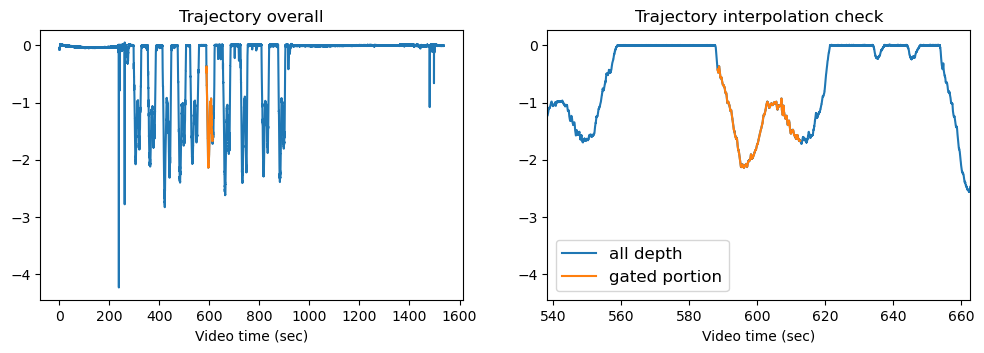

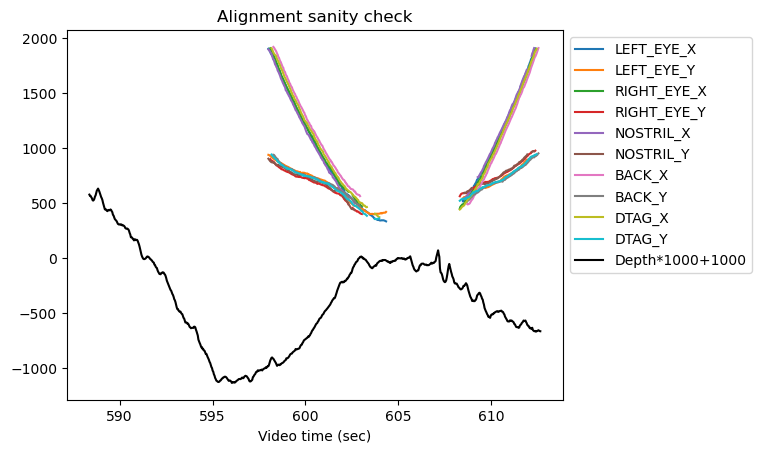

Save xypressure data to: 20190703_s3_t6_GOPR1486_xypressure.csv



---------------------------------------------------------
20190703_s3_t7, video: GOPR1486.MP4


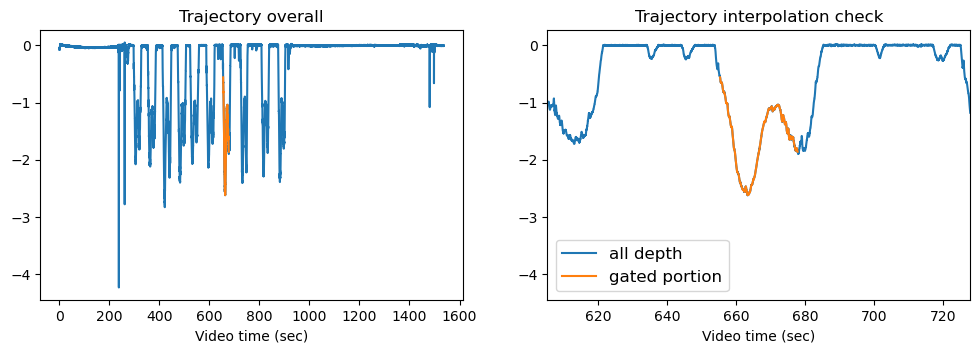

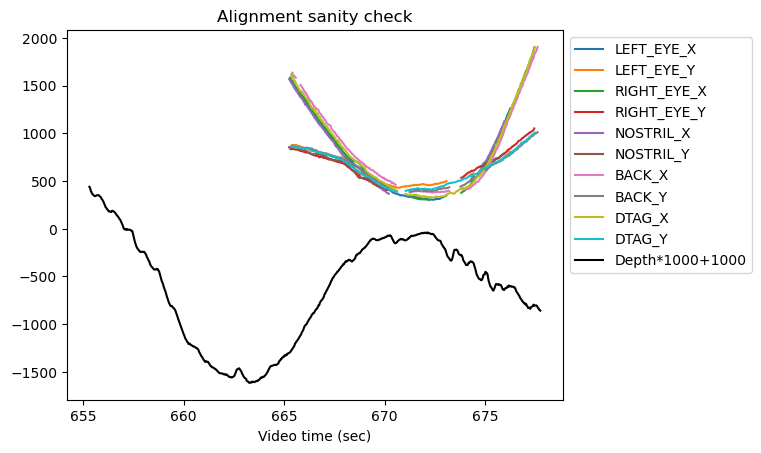

Save xypressure data to: 20190703_s3_t7_GOPR1486_xypressure.csv



---------------------------------------------------------
20190703_s3_t8, video: GOPR1486.MP4


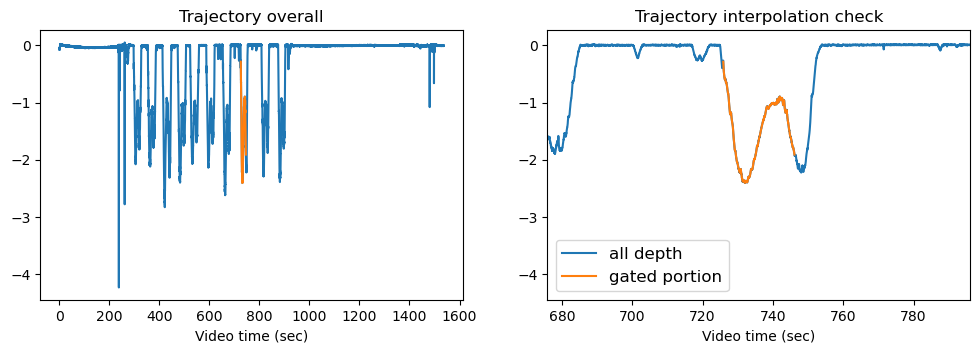

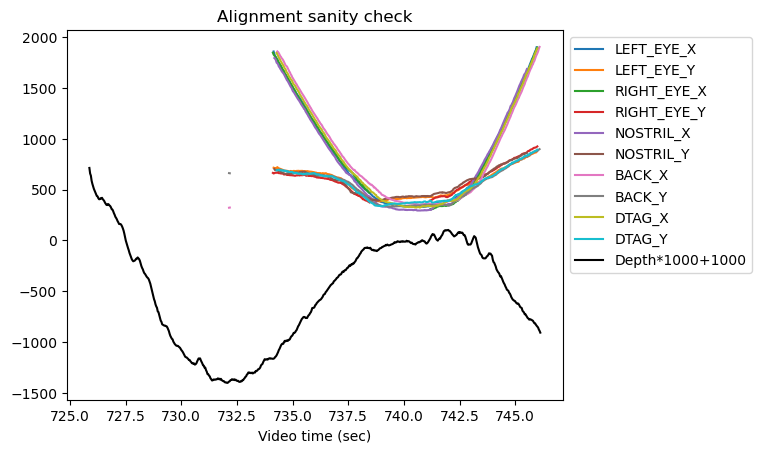

Save xypressure data to: 20190703_s3_t8_GOPR1486_xypressure.csv



---------------------------------------------------------
20190703_s3_t9, video: GOPR1486.MP4


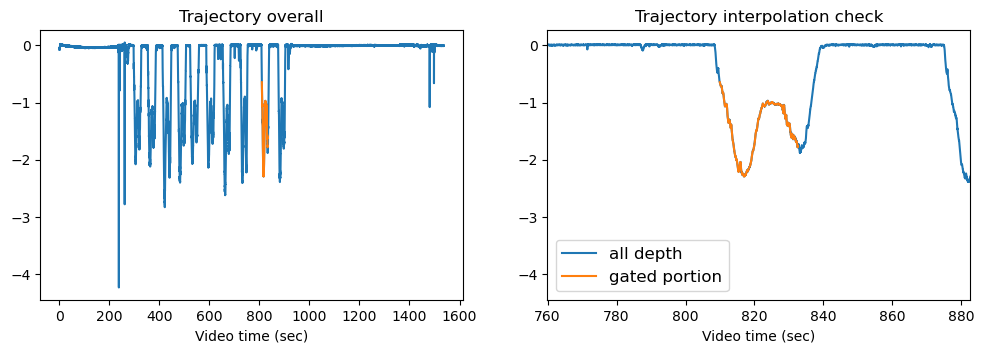

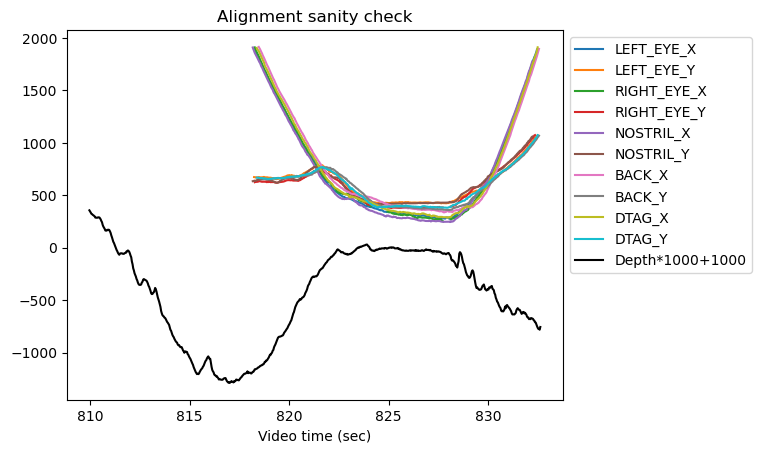

Save xypressure data to: 20190703_s3_t9_GOPR1486_xypressure.csv



---------------------------------------------------------
20190703_s3_t10, video: GOPR1486.MP4


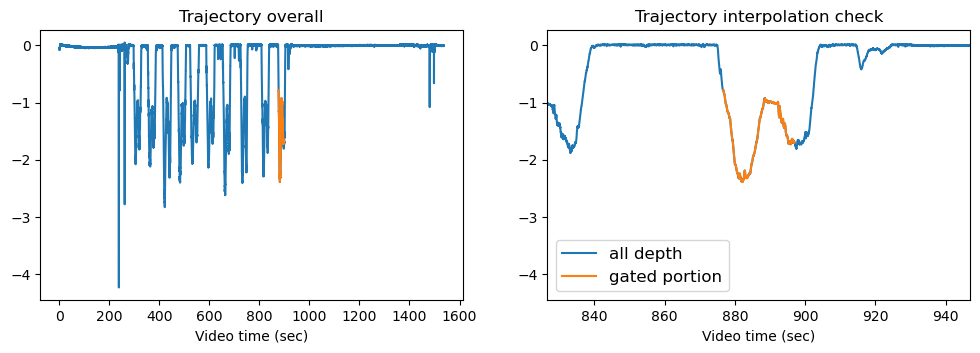

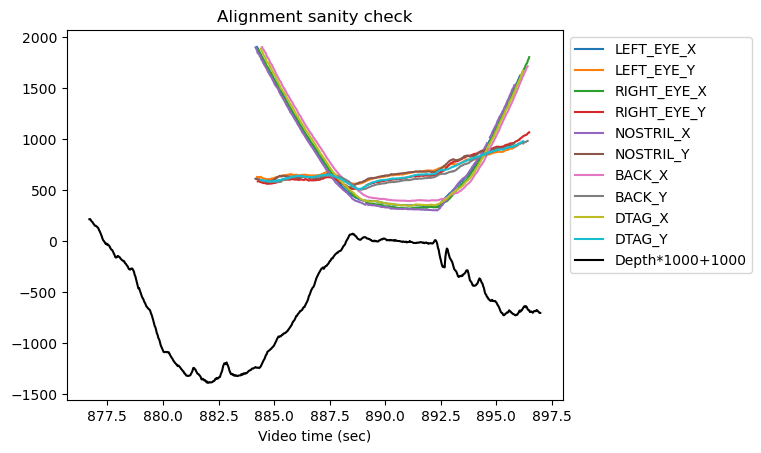

Save xypressure data to: 20190703_s3_t10_GOPR1486_xypressure.csv



---------------------------------------------------------
20190704_s1_t1, video: GOPR1487.MP4


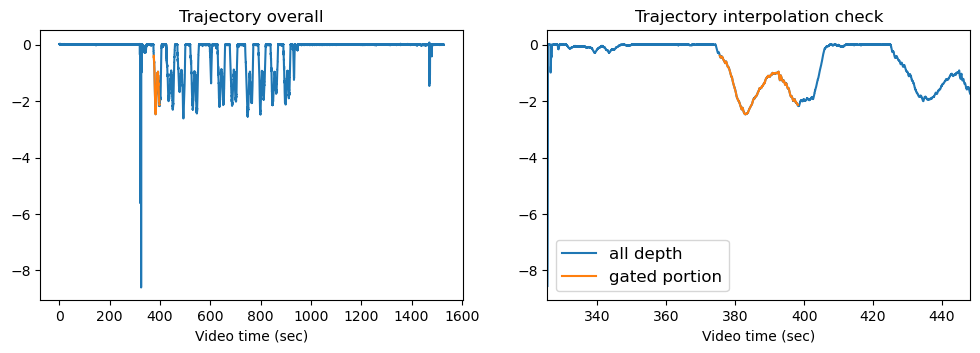

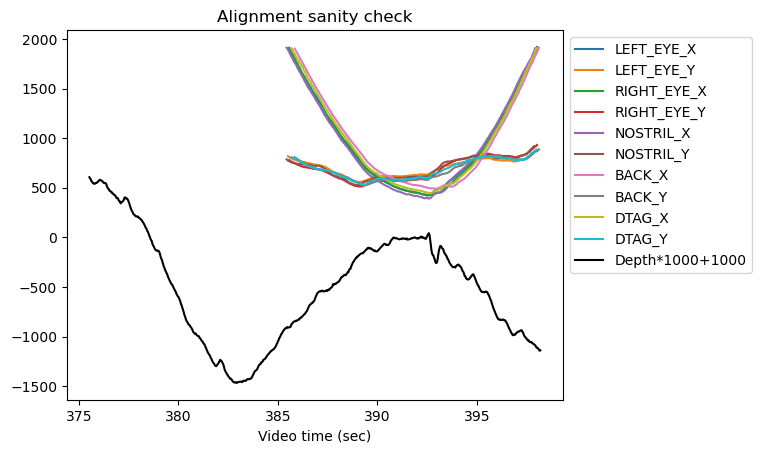

Save xypressure data to: 20190704_s1_t1_GOPR1487_xypressure.csv



---------------------------------------------------------
20190704_s1_t2, video: GOPR1487.MP4


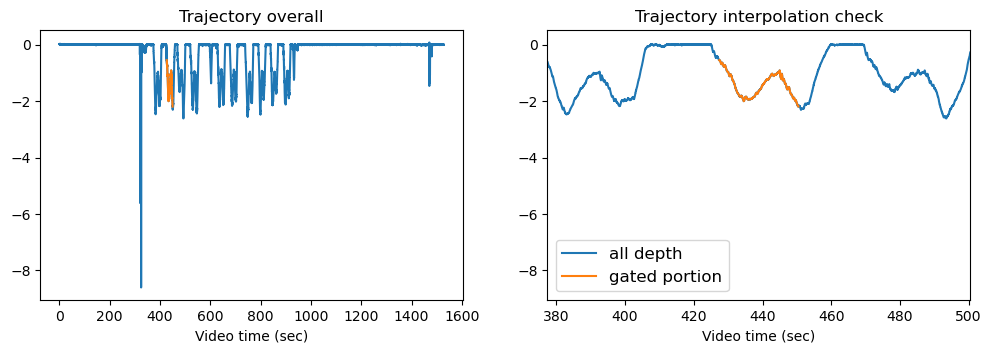

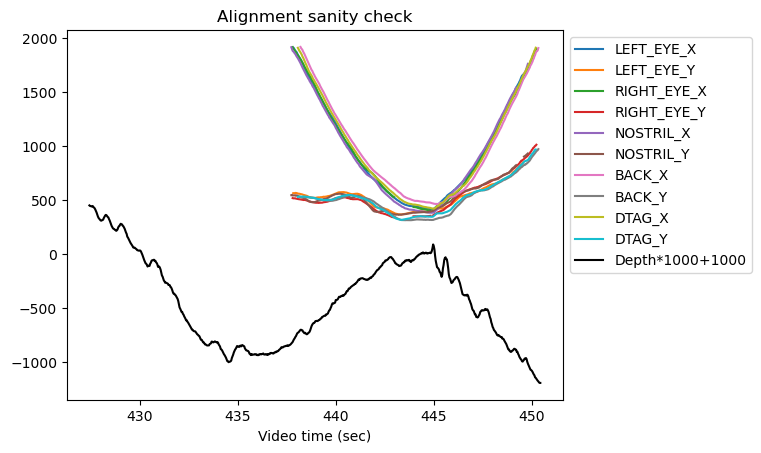

Save xypressure data to: 20190704_s1_t2_GOPR1487_xypressure.csv



---------------------------------------------------------
20190704_s1_t3, video: GOPR1487.MP4


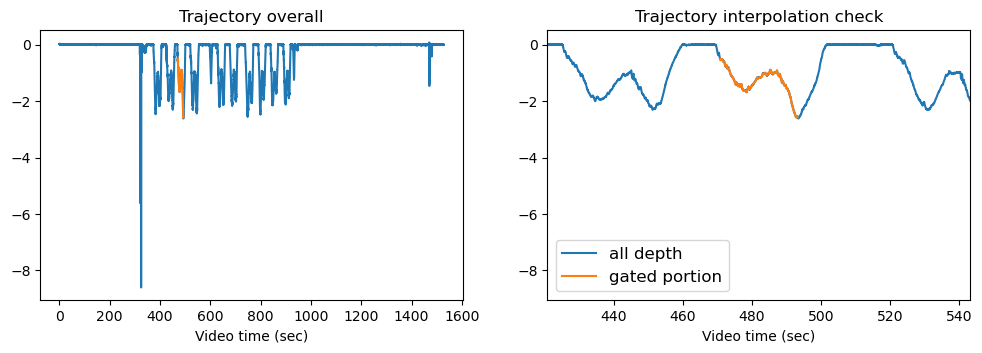

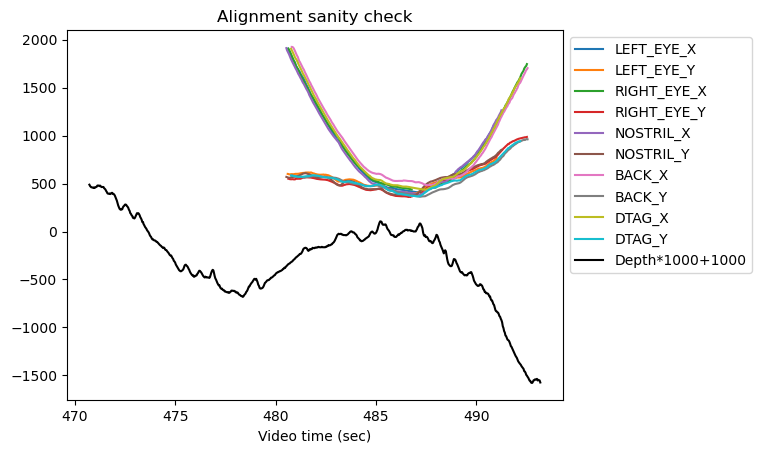

Save xypressure data to: 20190704_s1_t3_GOPR1487_xypressure.csv



---------------------------------------------------------
20190704_s1_t4, video: GOPR1487.MP4


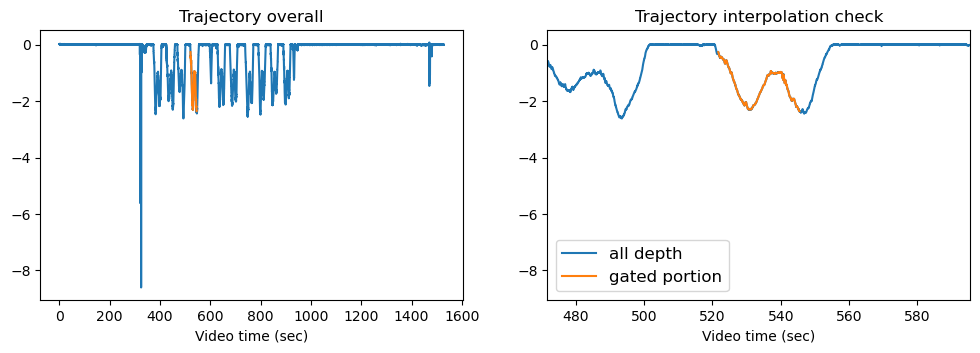

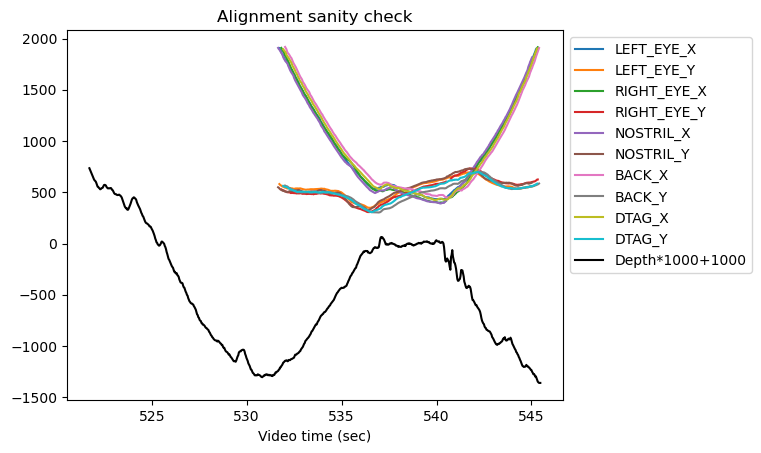

Save xypressure data to: 20190704_s1_t4_GOPR1487_xypressure.csv



---------------------------------------------------------
20190704_s1_t5, video: GOPR1487.MP4


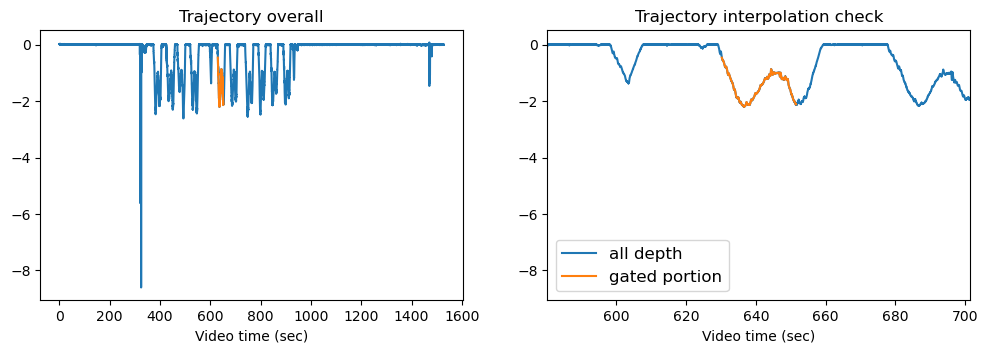

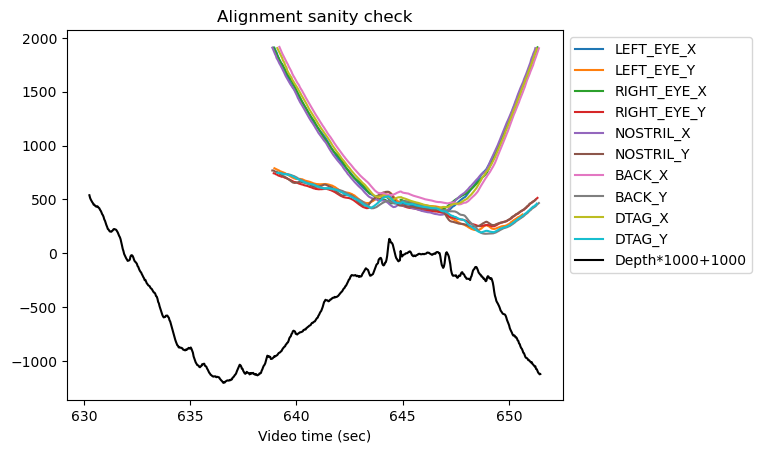

Save xypressure data to: 20190704_s1_t5_GOPR1487_xypressure.csv



---------------------------------------------------------
20190704_s1_t6, video: GOPR1487.MP4


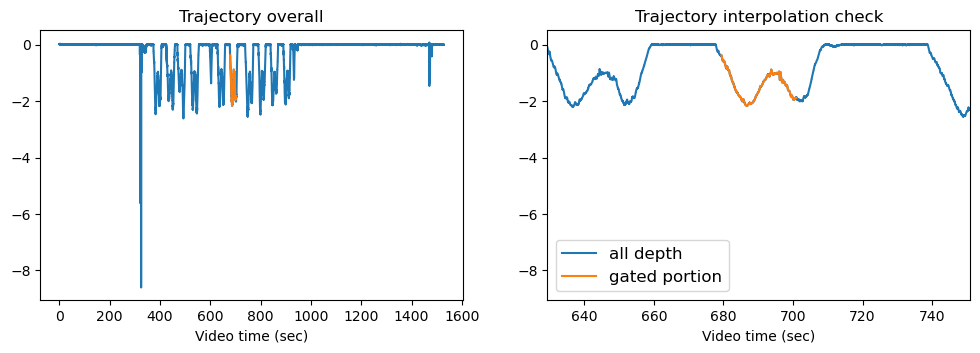

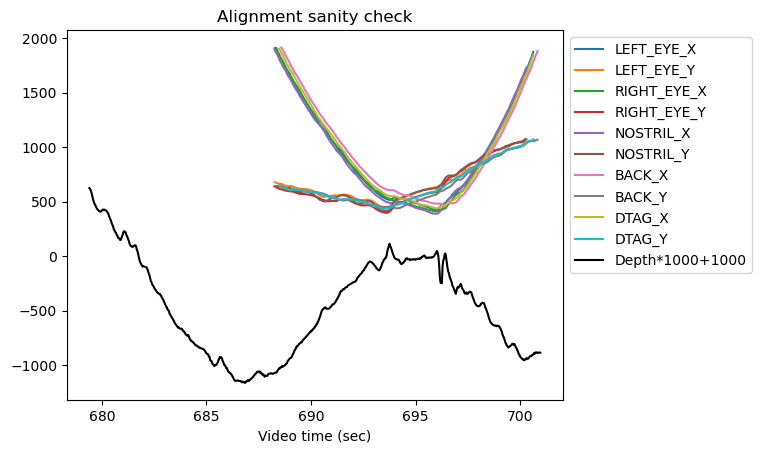

Save xypressure data to: 20190704_s1_t6_GOPR1487_xypressure.csv



---------------------------------------------------------
20190704_s1_t7, video: GOPR1487.MP4


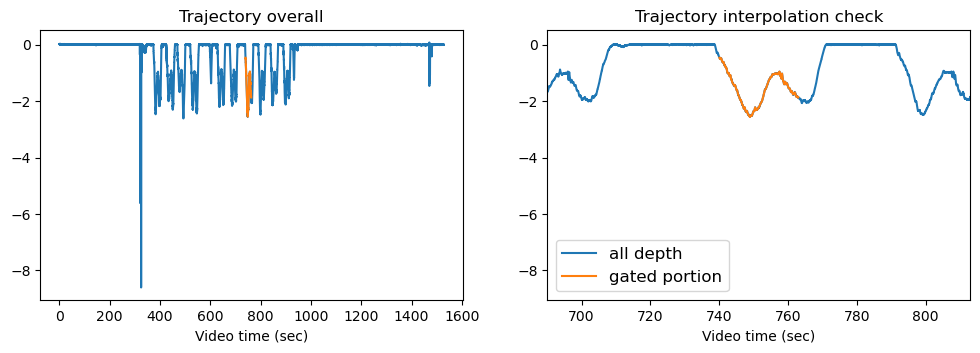

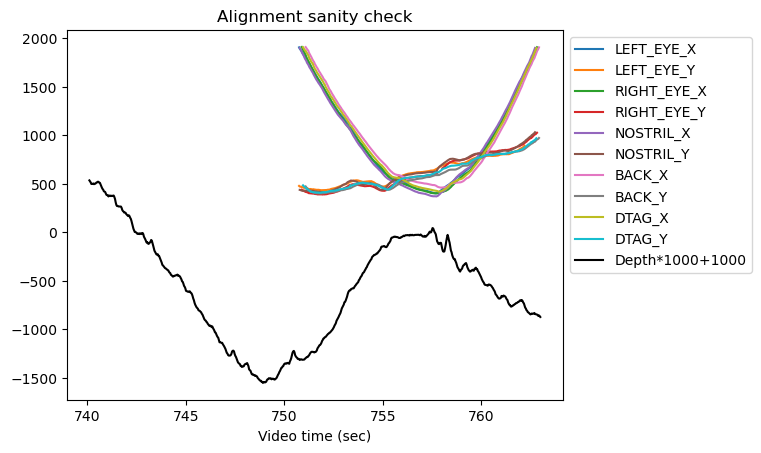

Save xypressure data to: 20190704_s1_t7_GOPR1487_xypressure.csv



---------------------------------------------------------
20190704_s1_t8, video: GOPR1487.MP4


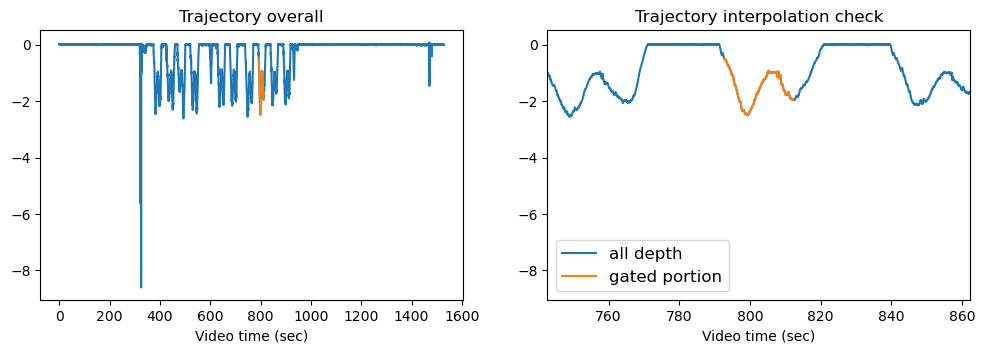

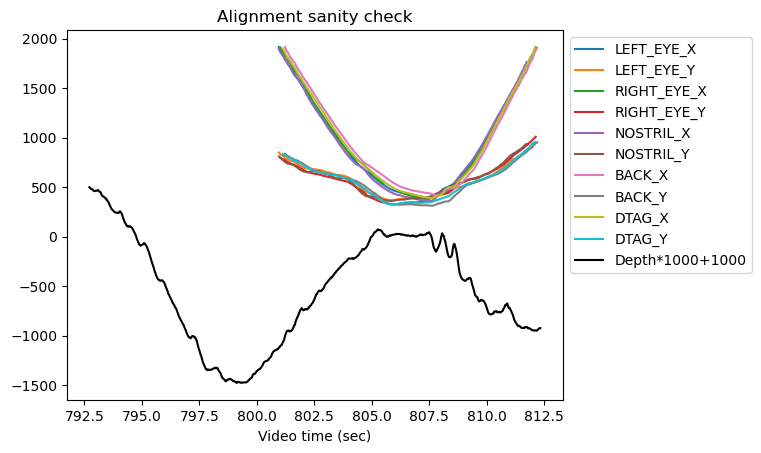

Save xypressure data to: 20190704_s1_t8_GOPR1487_xypressure.csv



---------------------------------------------------------
20190704_s1_t9, video: GOPR1487.MP4


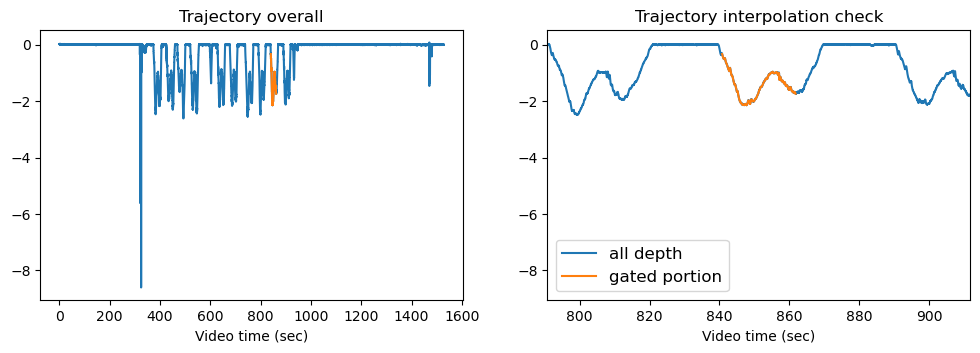

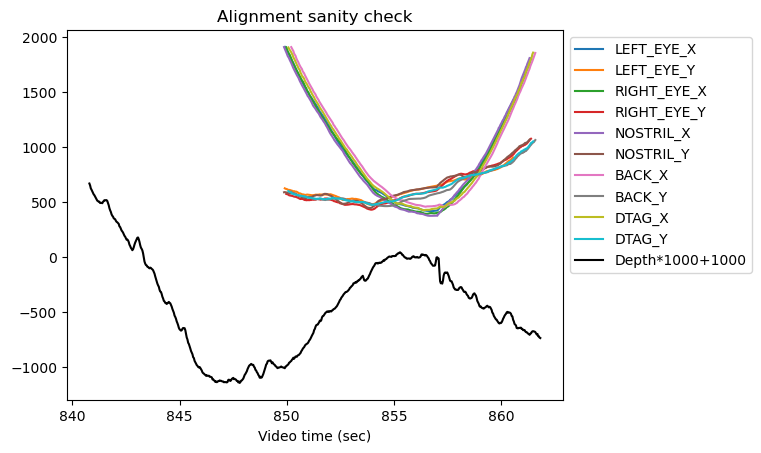

Save xypressure data to: 20190704_s1_t9_GOPR1487_xypressure.csv



---------------------------------------------------------
20190704_s1_t10, video: GOPR1487.MP4


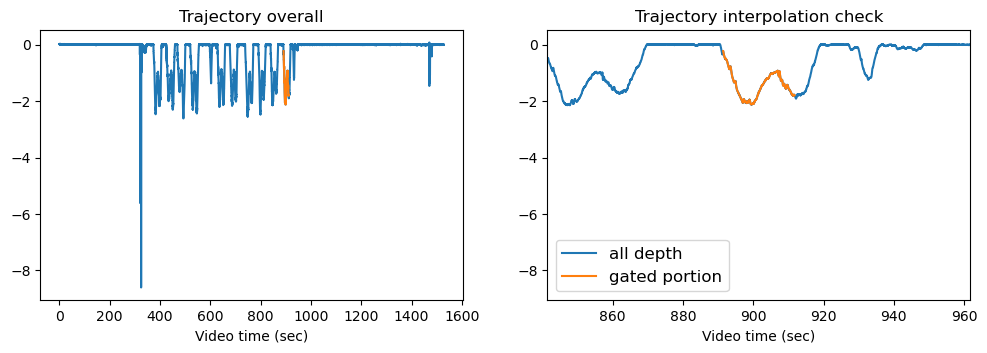

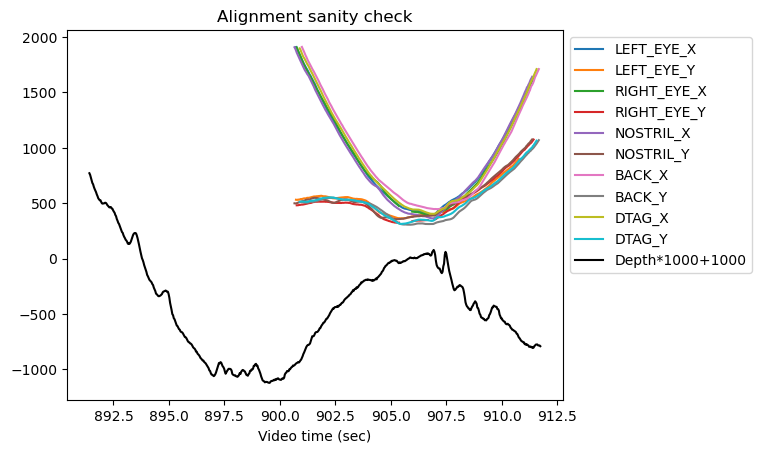

Save xypressure data to: 20190704_s1_t10_GOPR1487_xypressure.csv



---------------------------------------------------------
20190704_s2_t1, video: GOPR1488.MP4


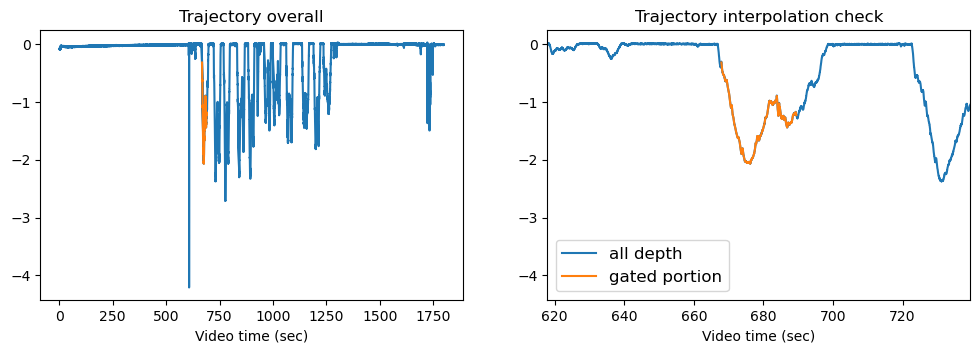

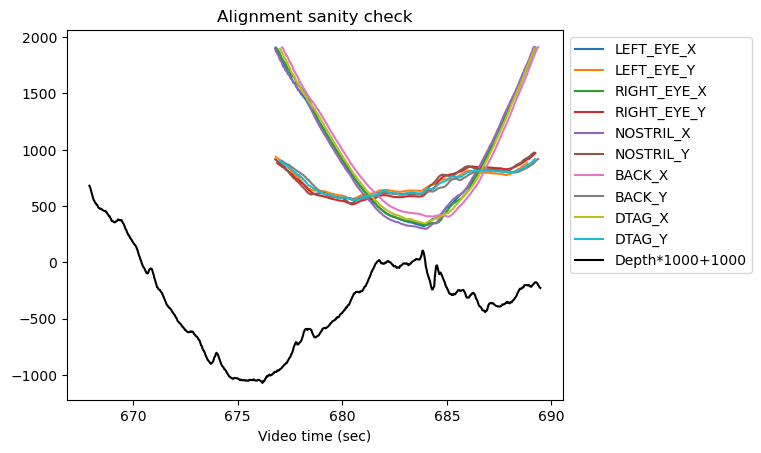

Save xypressure data to: 20190704_s2_t1_GOPR1488_xypressure.csv



---------------------------------------------------------
20190704_s2_t2, video: GOPR1488.MP4


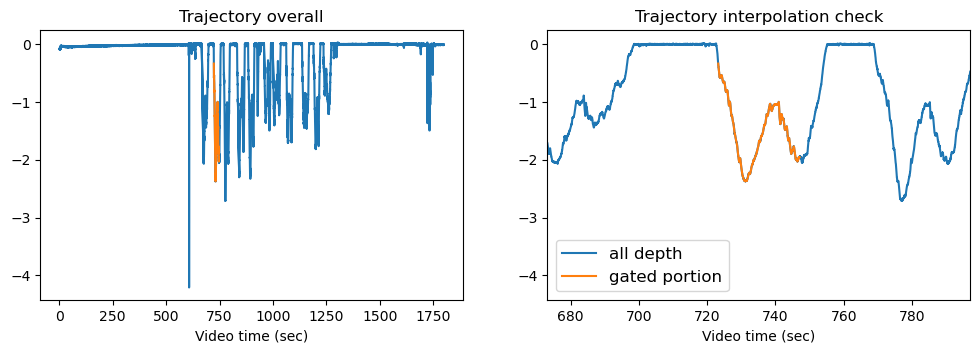

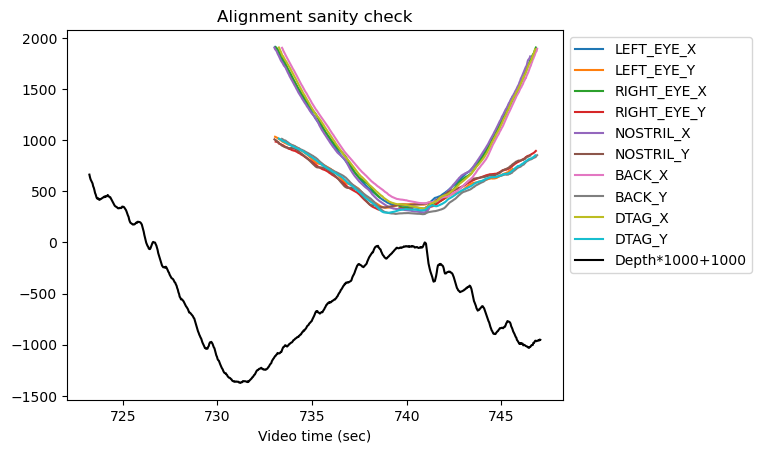

Save xypressure data to: 20190704_s2_t2_GOPR1488_xypressure.csv



---------------------------------------------------------
20190704_s2_t3, video: GOPR1488.MP4


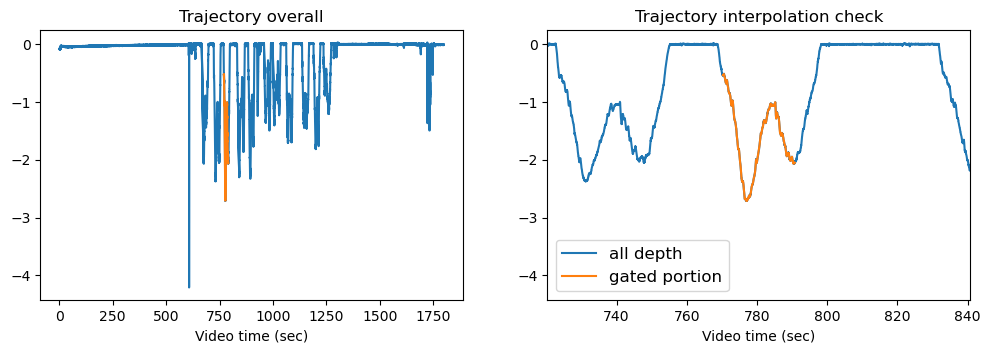

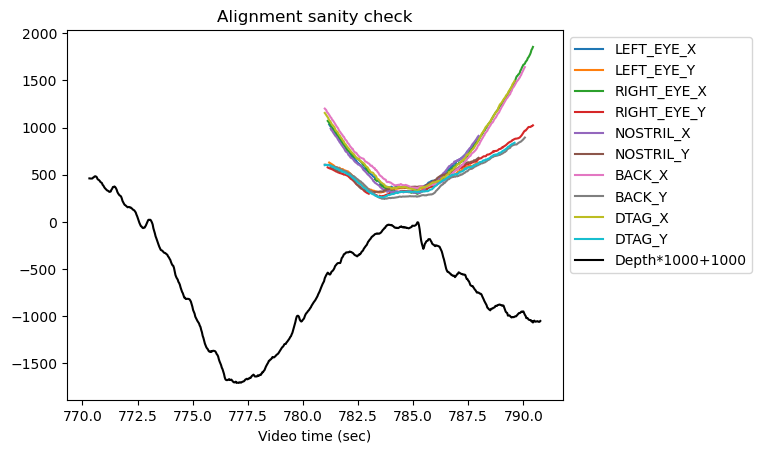

Save xypressure data to: 20190704_s2_t3_GOPR1488_xypressure.csv



---------------------------------------------------------
20190704_s2_t4, video: GOPR1488.MP4


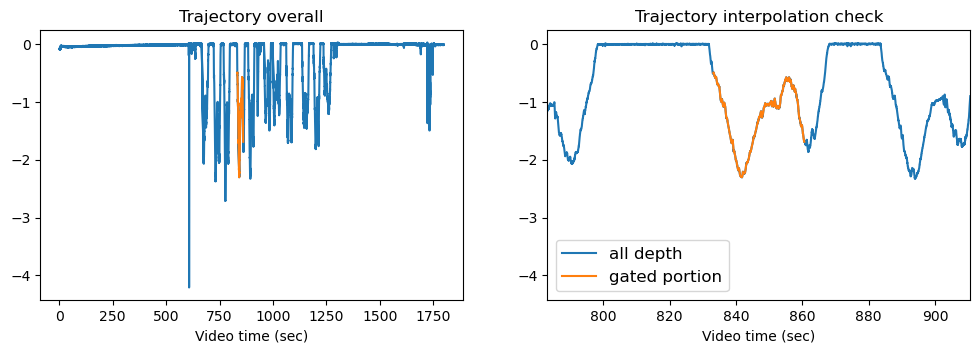

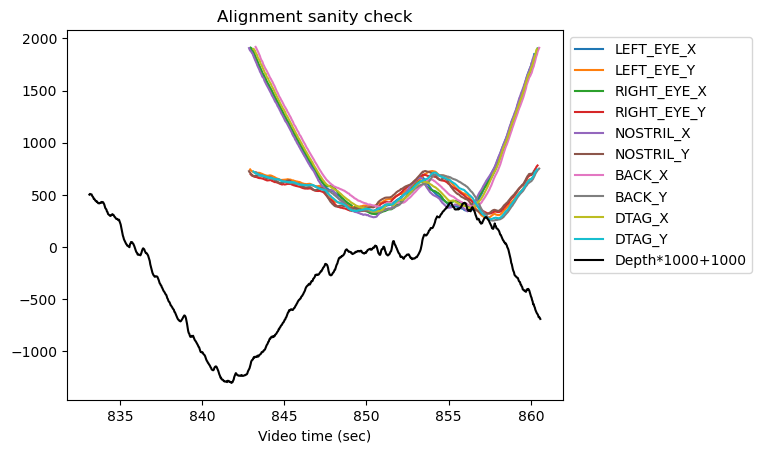

Save xypressure data to: 20190704_s2_t4_GOPR1488_xypressure.csv



---------------------------------------------------------
20190704_s2_t5, video: GOPR1488.MP4


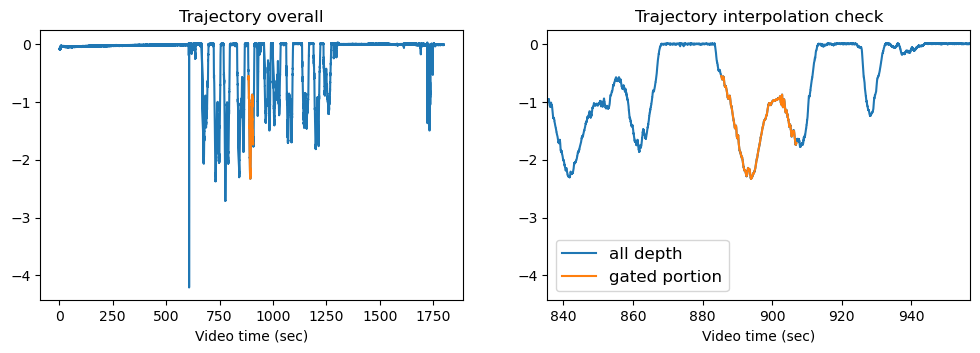

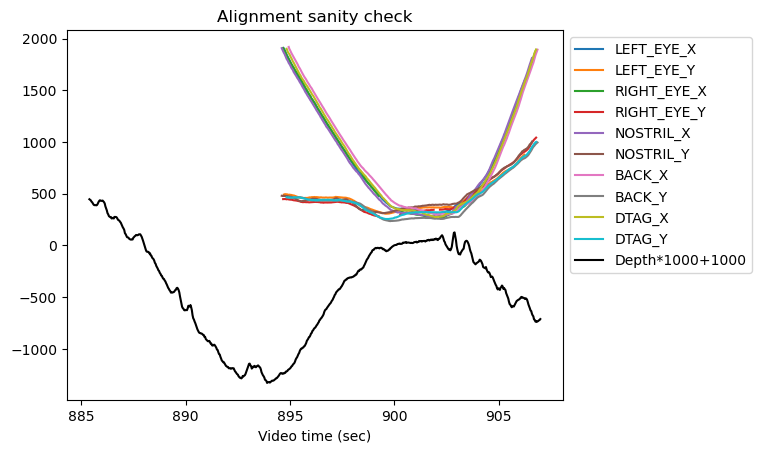

Save xypressure data to: 20190704_s2_t5_GOPR1488_xypressure.csv



---------------------------------------------------------
20190704_s2_t6, video: GOPR1488.MP4


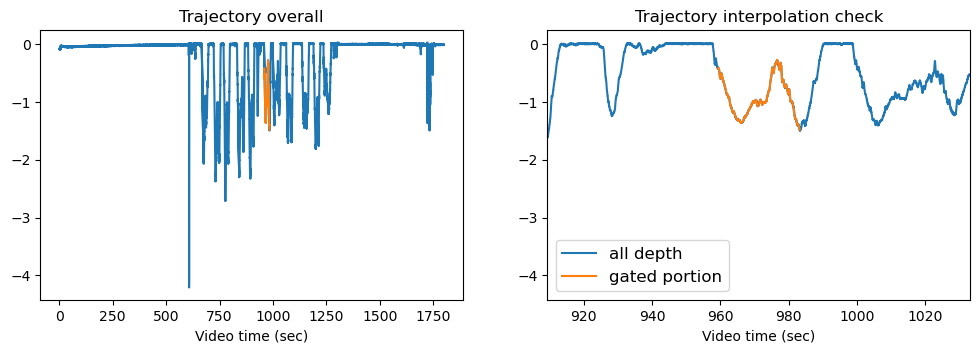

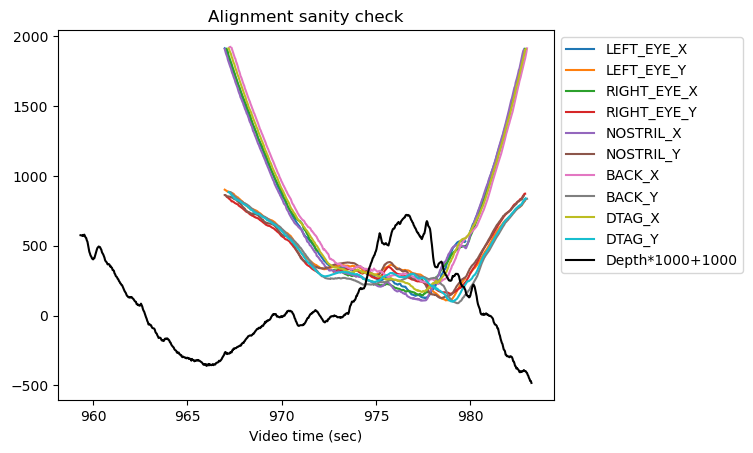

Save xypressure data to: 20190704_s2_t6_GOPR1488_xypressure.csv



---------------------------------------------------------
20190704_s2_t7, video: GOPR1488.MP4


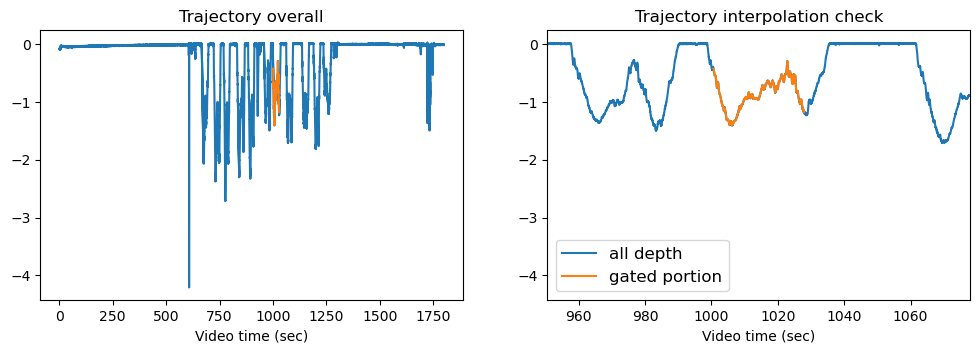

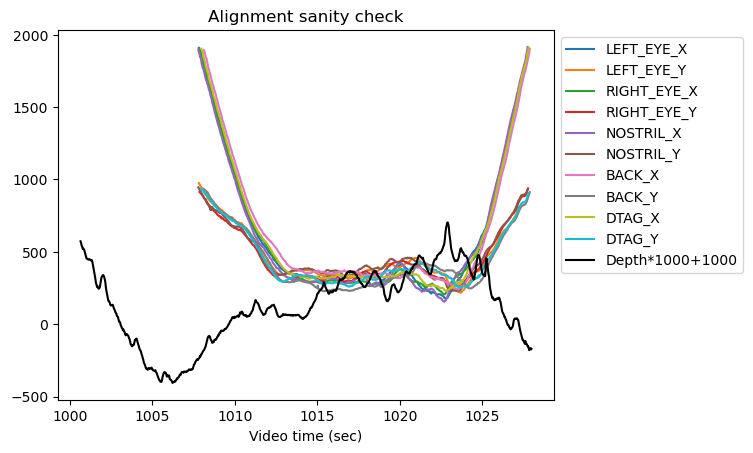

Save xypressure data to: 20190704_s2_t7_GOPR1488_xypressure.csv



---------------------------------------------------------
20190704_s2_t8, video: GP011488.MP4


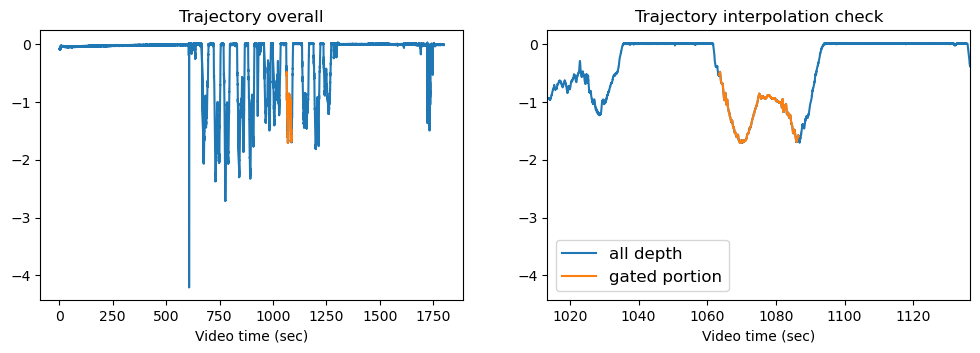

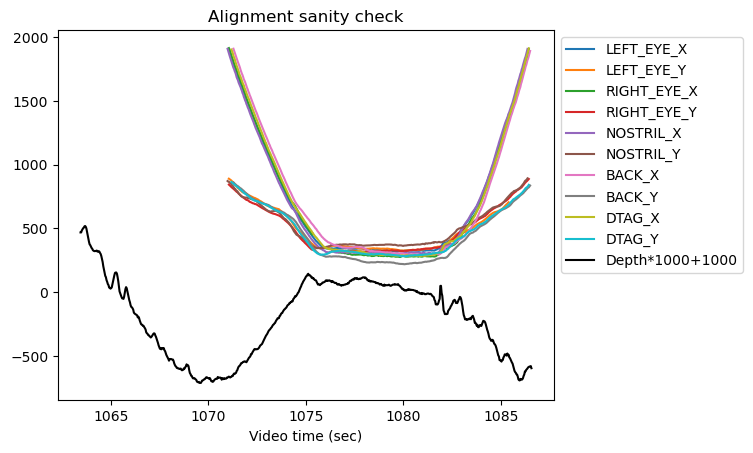

Save xypressure data to: 20190704_s2_t8_GP011488_xypressure.csv



---------------------------------------------------------
20190704_s2_t9, video: GP011488.MP4


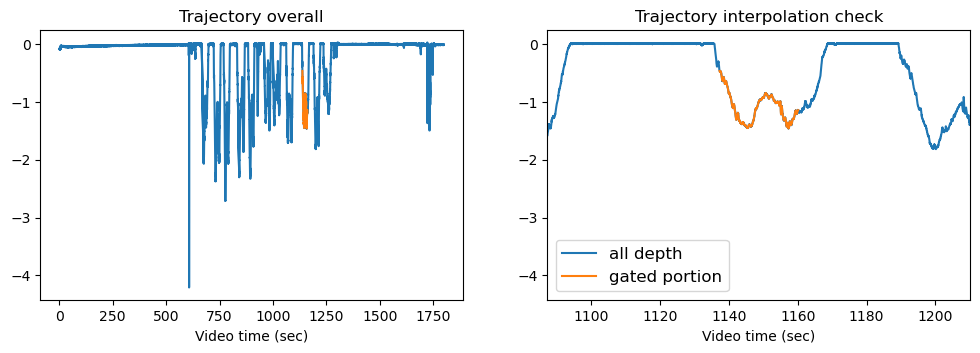

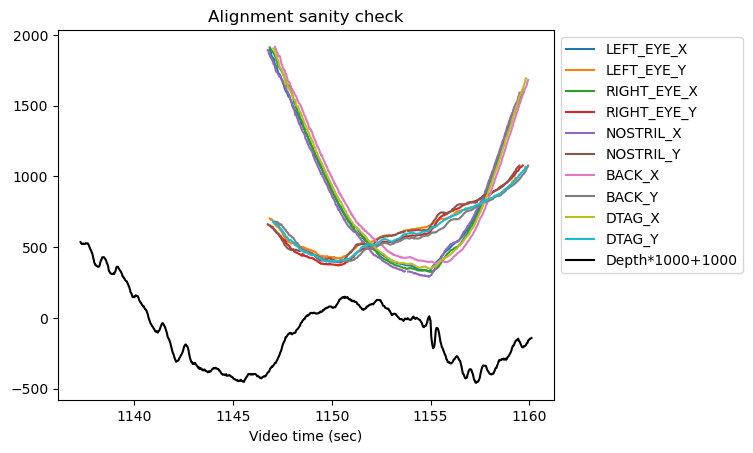

Save xypressure data to: 20190704_s2_t9_GP011488_xypressure.csv



---------------------------------------------------------
20190704_s2_t10, video: GP011488.MP4


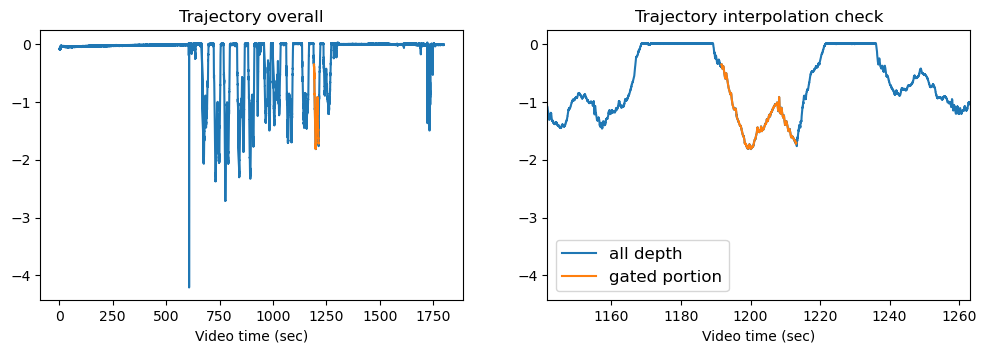

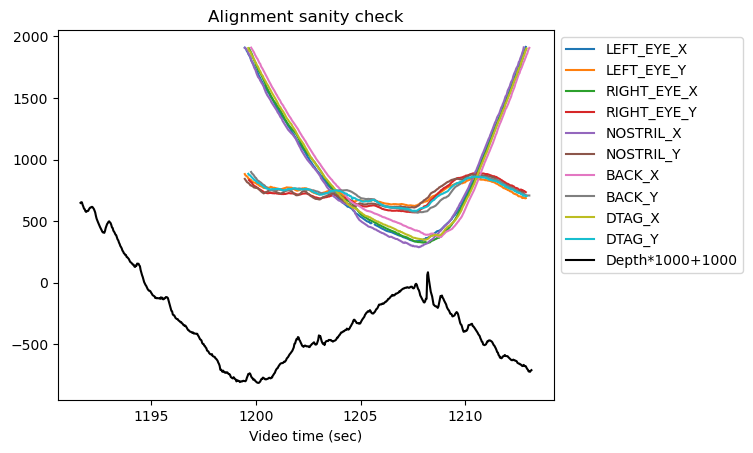

Save xypressure data to: 20190704_s2_t10_GP011488_xypressure.csv



---------------------------------------------------------
20190704_s2_t11, video: GP011488.MP4


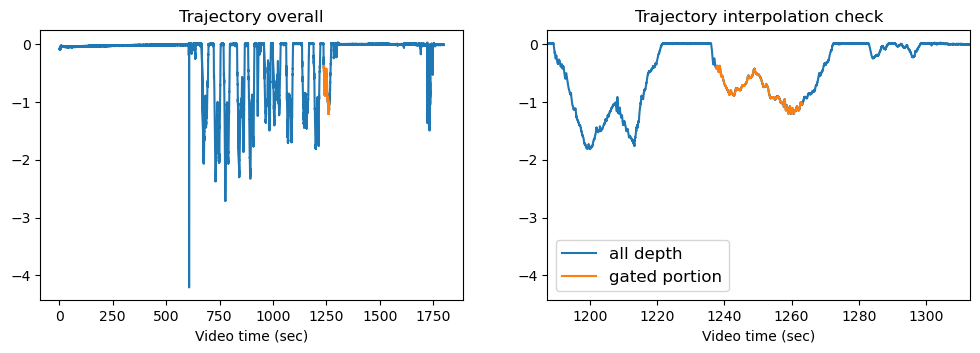

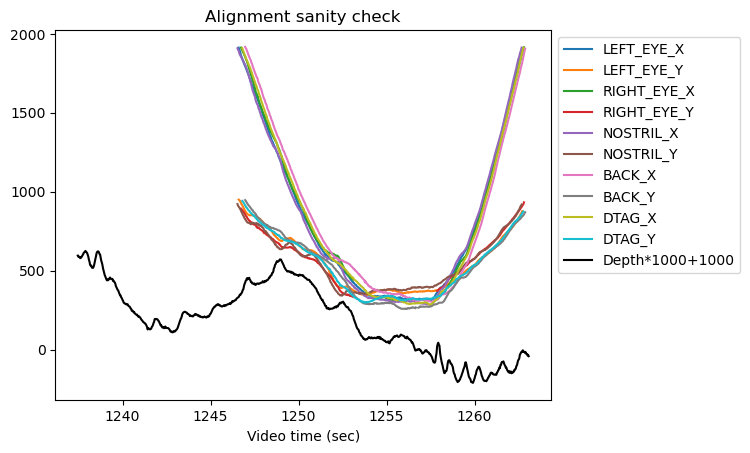

Save xypressure data to: 20190704_s2_t11_GP011488_xypressure.csv



---------------------------------------------------------
20190704_s3_t1, video: GOPR1489.MP4


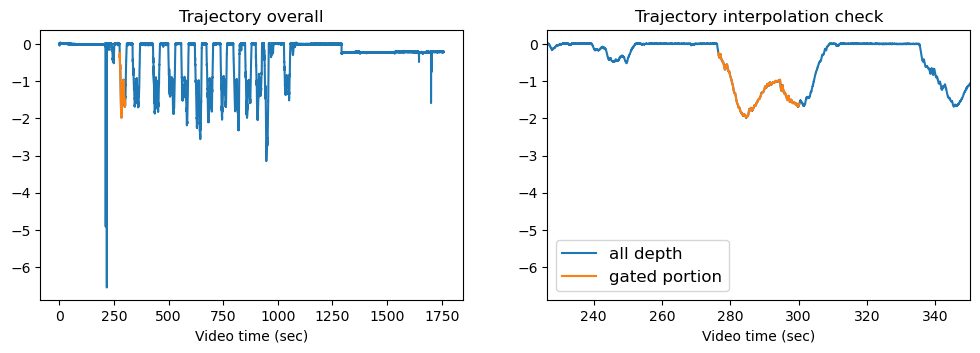

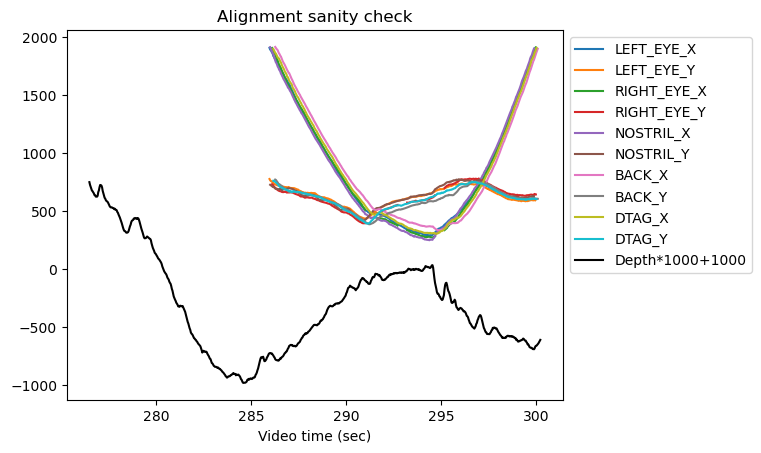

Save xypressure data to: 20190704_s3_t1_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t2, video: GOPR1489.MP4


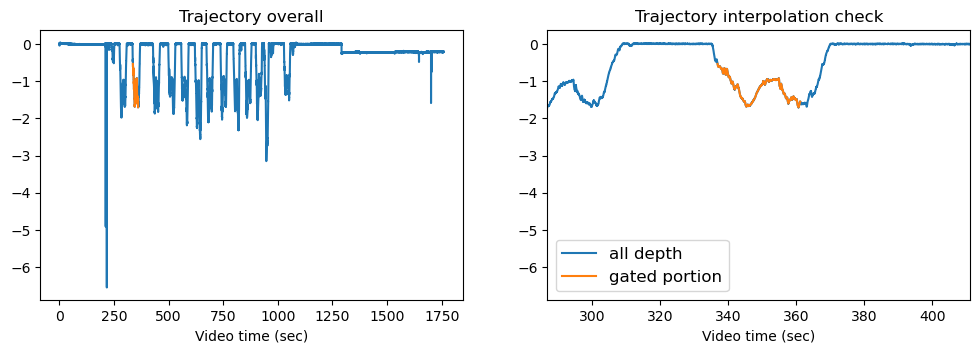

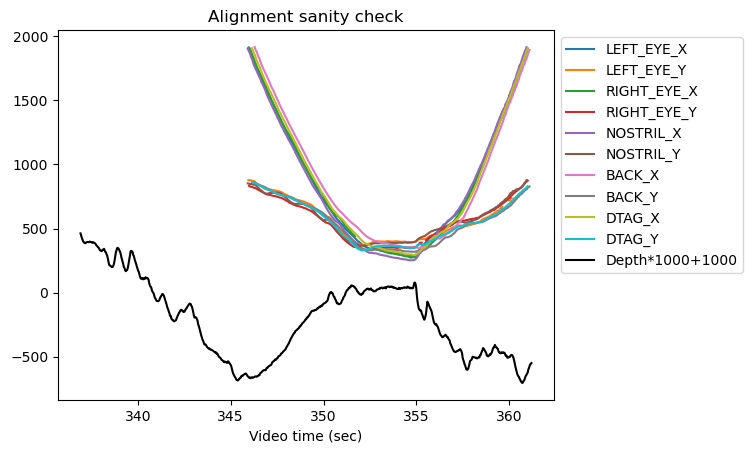

Save xypressure data to: 20190704_s3_t2_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t3, video: GOPR1489.MP4


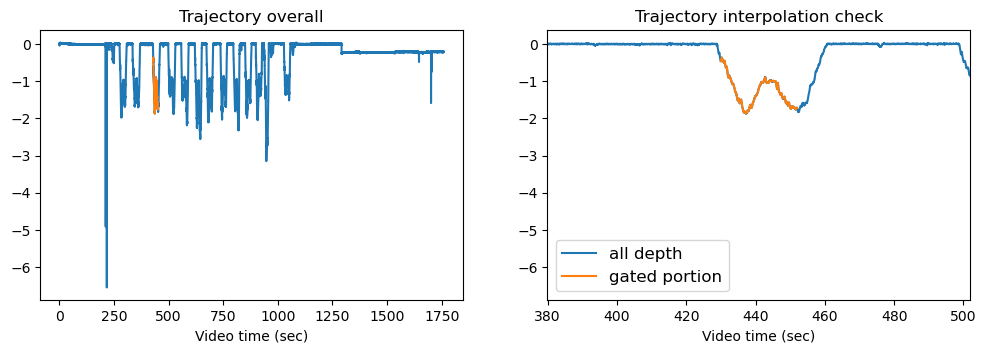

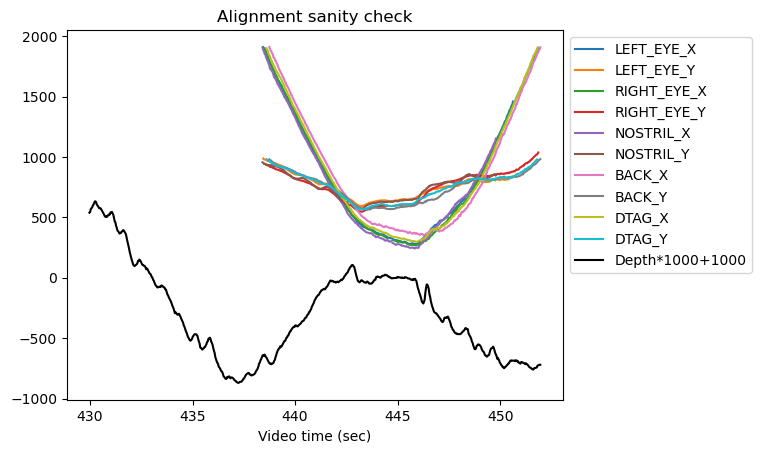

Save xypressure data to: 20190704_s3_t3_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t4, video: GOPR1489.MP4


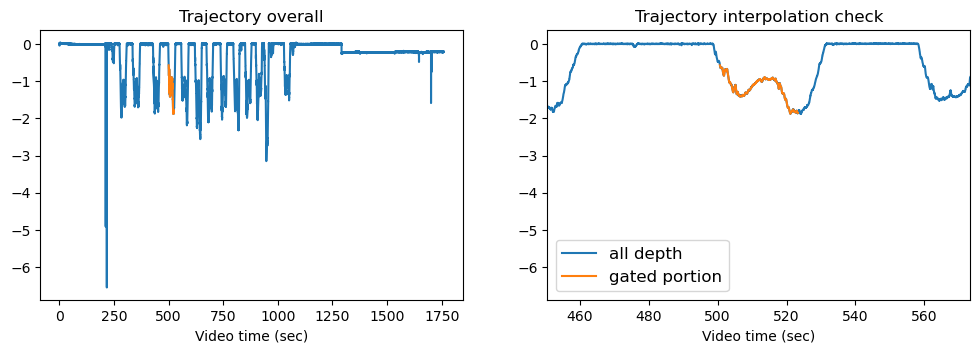

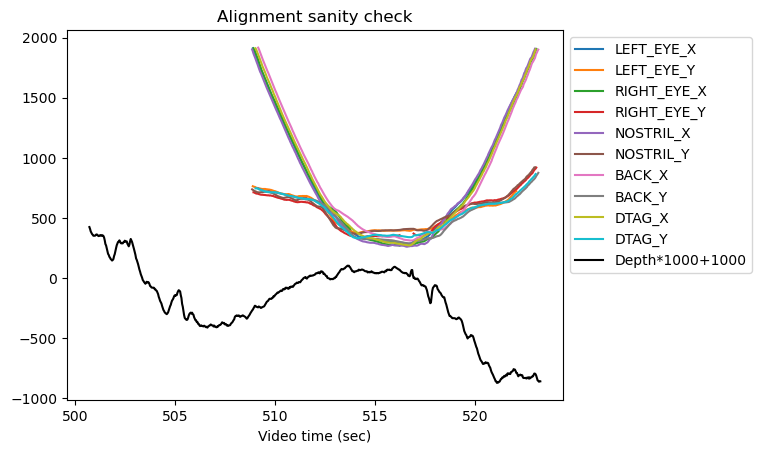

Save xypressure data to: 20190704_s3_t4_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t5, video: GOPR1489.MP4


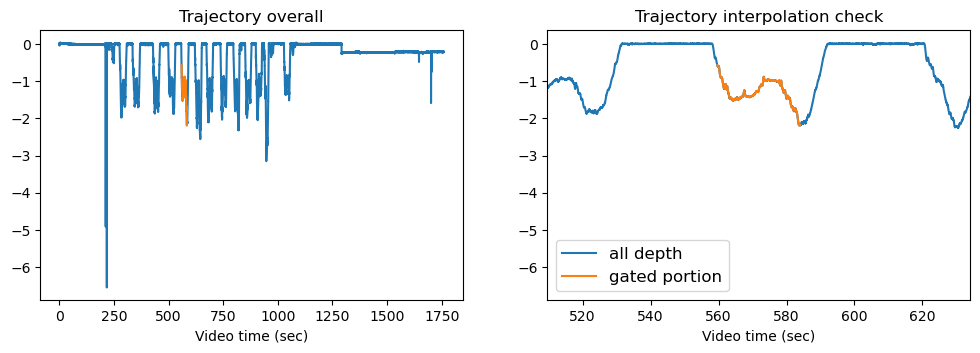

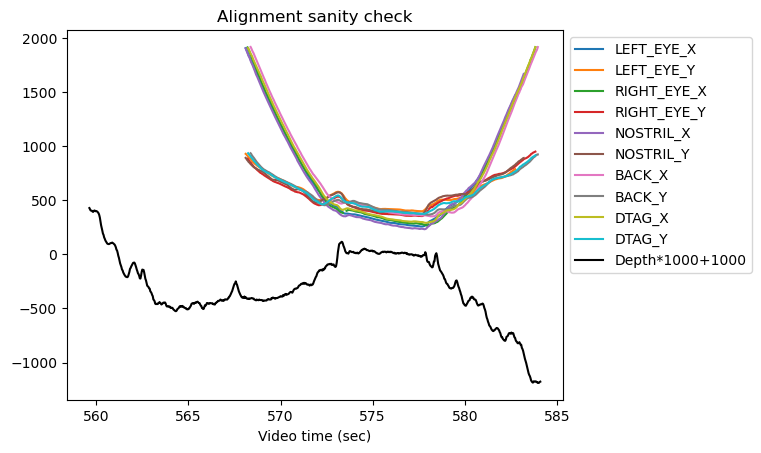

Save xypressure data to: 20190704_s3_t5_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t6, video: GOPR1489.MP4


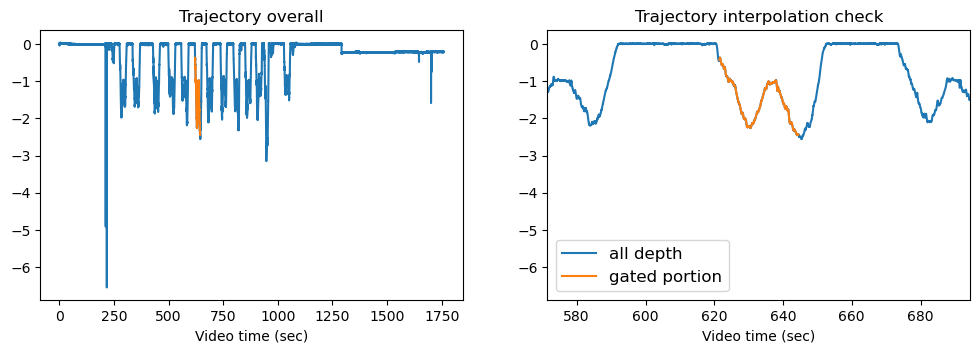

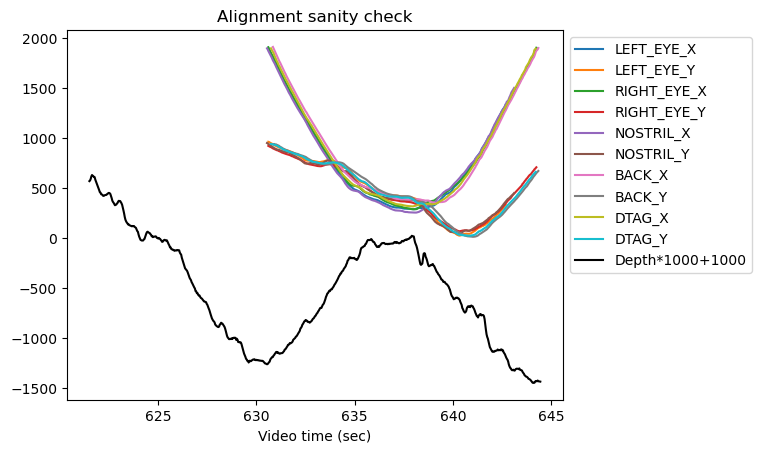

Save xypressure data to: 20190704_s3_t6_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t7, video: GOPR1489.MP4


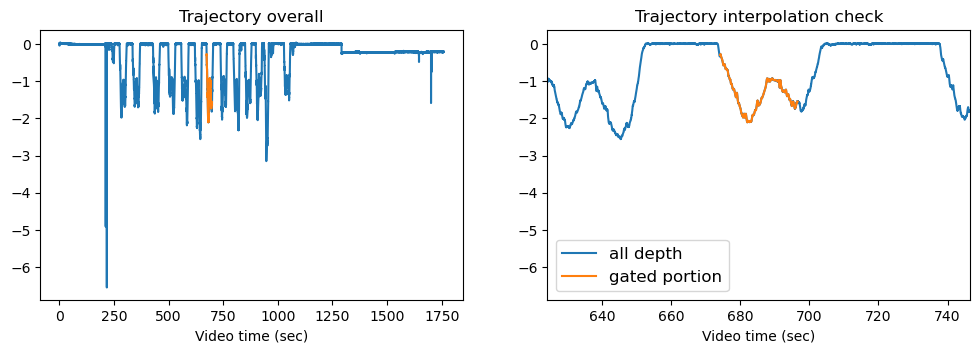

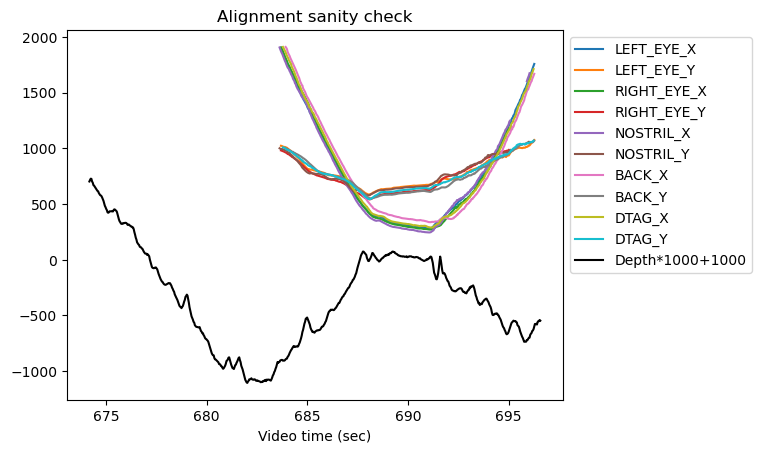

Save xypressure data to: 20190704_s3_t7_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t8, video: GOPR1489.MP4


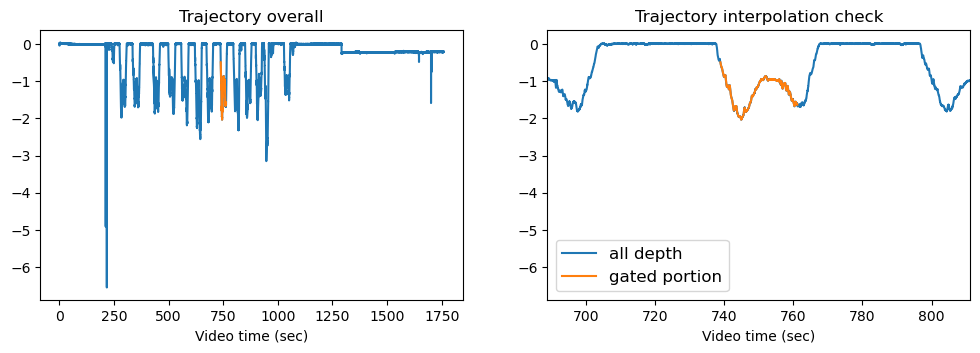

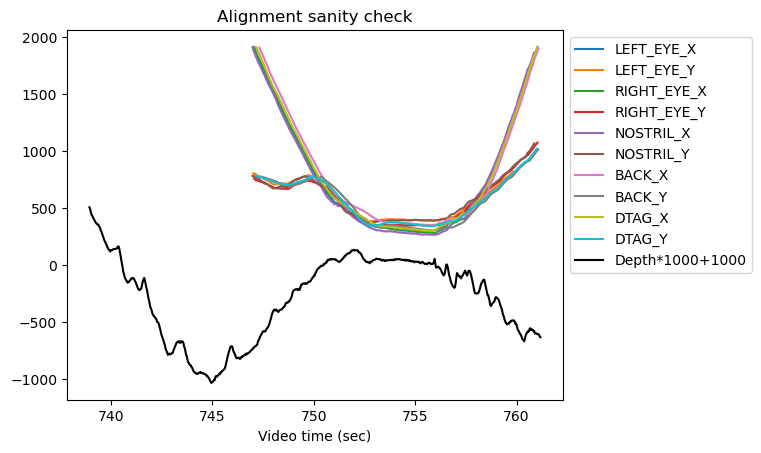

Save xypressure data to: 20190704_s3_t8_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t9, video: GOPR1489.MP4


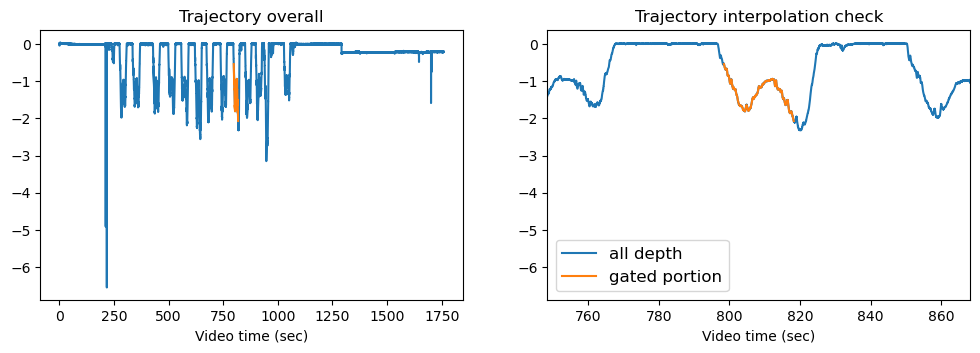

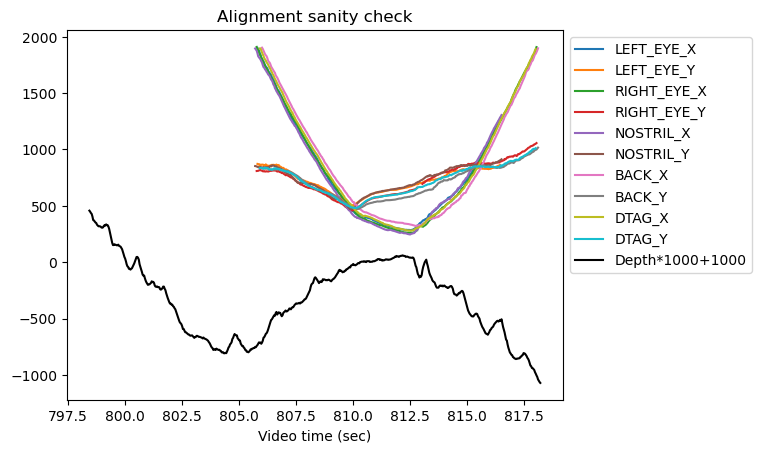

Save xypressure data to: 20190704_s3_t9_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t10, video: GOPR1489.MP4


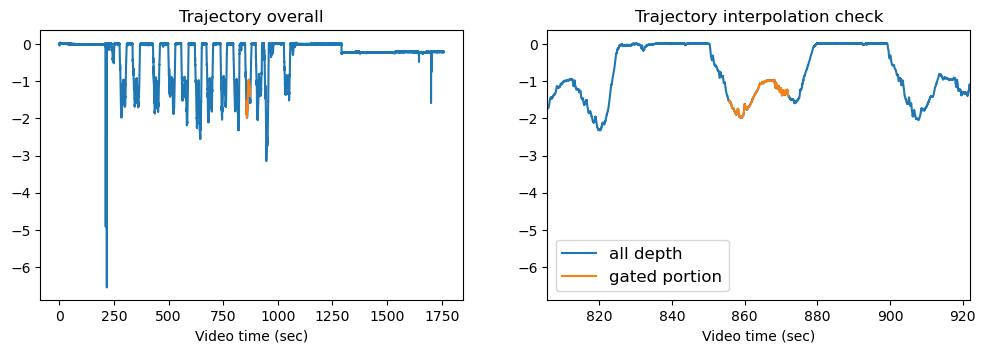

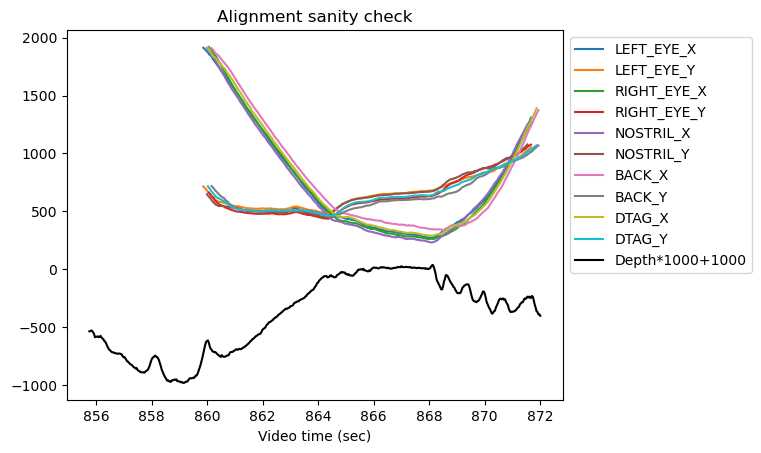

Save xypressure data to: 20190704_s3_t10_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t11, video: GOPR1489.MP4


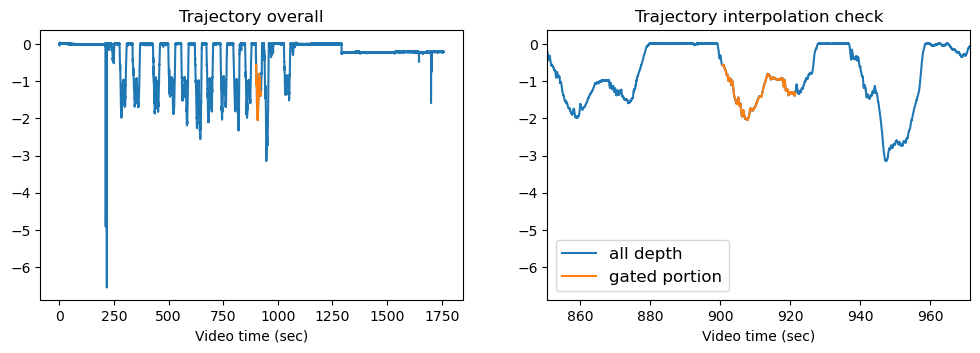

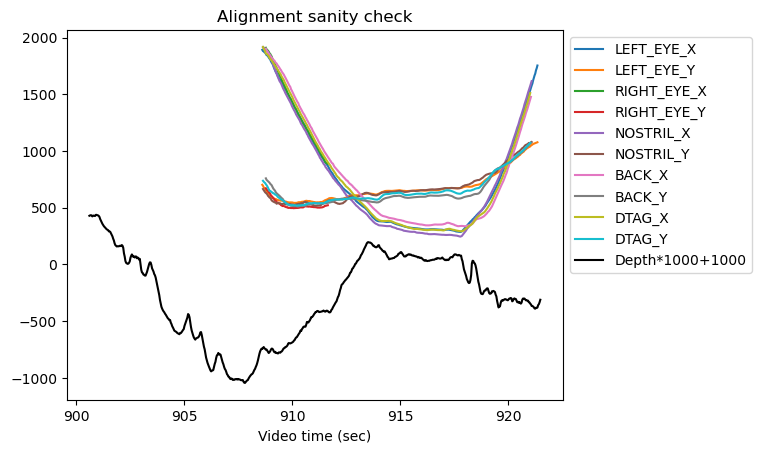

Save xypressure data to: 20190704_s3_t11_GOPR1489_xypressure.csv



---------------------------------------------------------
20190704_s3_t12, video: GOPR1489.MP4 + GP011489.MP4
Not included in wanted track with 1 video, skipping this trial...


In [25]:
# Assemble xypressure csv files
xyzpressure_from_1video = []

for trial_idx in df_all.index:

    s = df_all.loc[trial_idx, :]
    fname_prefix = '%d_s%d_t%d' % (s['DATE'], s['SESSION'], s['TRIAL'])
    fname = '%s_%s_xypressure.csv' % (fname_prefix, s['VIDEO_FILENAME'][-12:-4])
    
    print('')
    print('')
    print('')
    print('---------------------------------------------------------')
    print('%s, video: %s' % (fname_prefix, s['VIDEO_FILENAME']))

    if not s['file_wanted_1video']:
        xyzpressure_from_1video.append(False)
        print('Not included in wanted track with 1 video, skipping this trial...')
        continue
        
    else:
        xyzpressure_from_1video.append(True)

        # 20190702_s2 does not have syncing info
        if np.isnan(s['tap_sync_time_dtag2video']):
            print('Dtag tap sync does not exist, skipping this trial...')
            continue

        else:
            # Interpolate track
            track, depth, vid_time, fig_track_interp = sync(trial_idx)
            fig_track_interp.savefig(str(out_path.joinpath('fig_track_interp', 
                                                           Path(fname).stem+'_track_interp.png')), 
                                     dpi=150, bbox_inches='tight', pad_inches=0.3)

            # Construct df
            df_p = pd.DataFrame(depth, columns=['DTAG_PRESSURE'])
            df_t = pd.DataFrame(track.values, columns=col_list)
            df = pd.concat([df_t, df_p], axis=1)

            # Check track points
            fig_alignment = plot_alignment_check()
            fig_alignment.savefig(str(out_path.joinpath('fig_alignment', fname+'_alignment.png')), 
                                  dpi=150, bbox_inches='tight', pad_inches=0.3)

            # Save file
            print('Save xypressure data to: ' + fname)
            df.to_csv(out_path.joinpath('csv', fname), index=False)


In [26]:
# Sanity check for dimensions: 
len(xyzpressure_from_1video)

247

## Create xypressure csv for multi-video trials




---------------------------------------------------------
20190626_s2_t5, video: GOPR1470.MP4 + GP011470.MP4


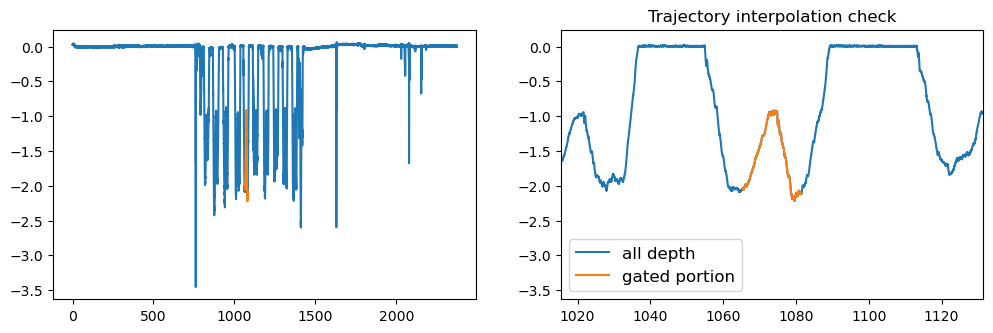

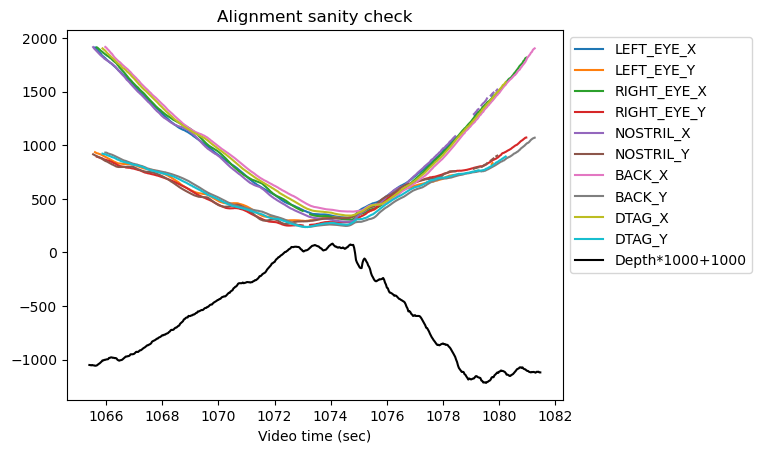

Save xypressure data to: 20190626_s2_t5_GOPR1470_xypressure.csv



---------------------------------------------------------
20190627_s1_t8, video: GOPR1472.MP4 + GP011472.MP4


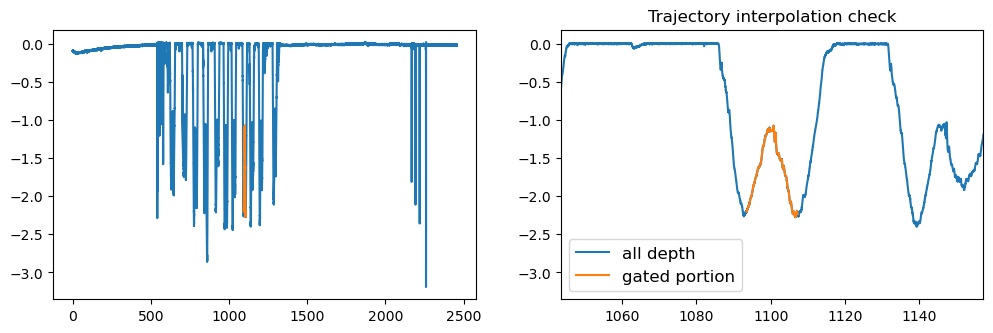

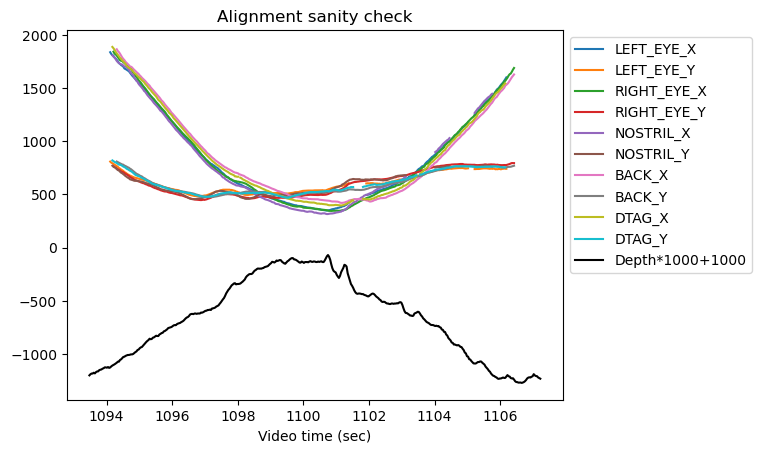

Save xypressure data to: 20190627_s1_t8_GOPR1472_xypressure.csv



---------------------------------------------------------
20190628_s1_t5, video: GOPR1475.MP4 + GP011475.MP4


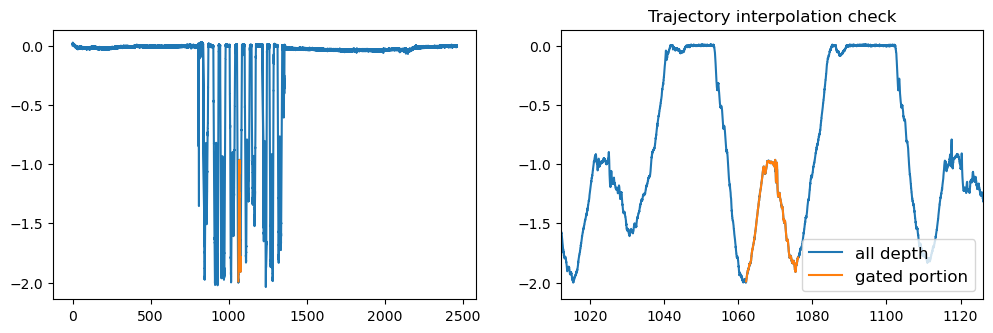

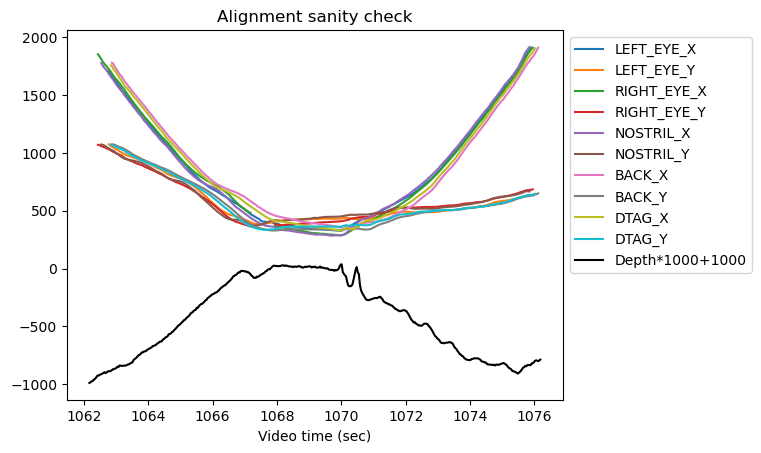

Save xypressure data to: 20190628_s1_t5_GOPR1475_xypressure.csv



---------------------------------------------------------
20190701_s2_t3, video: GP011479.MP4 + GP021479.MP4


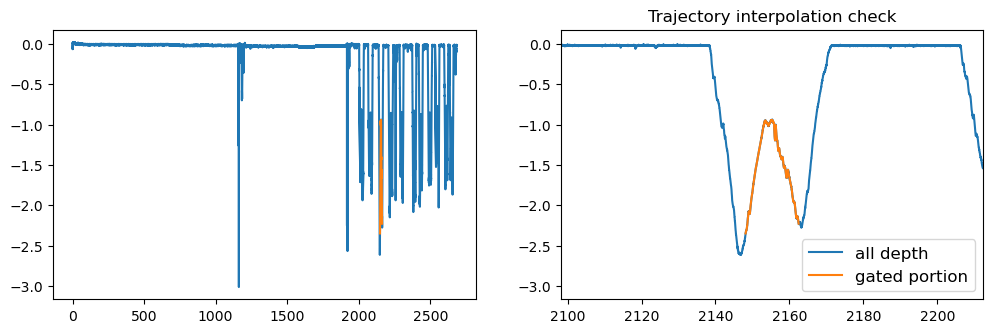

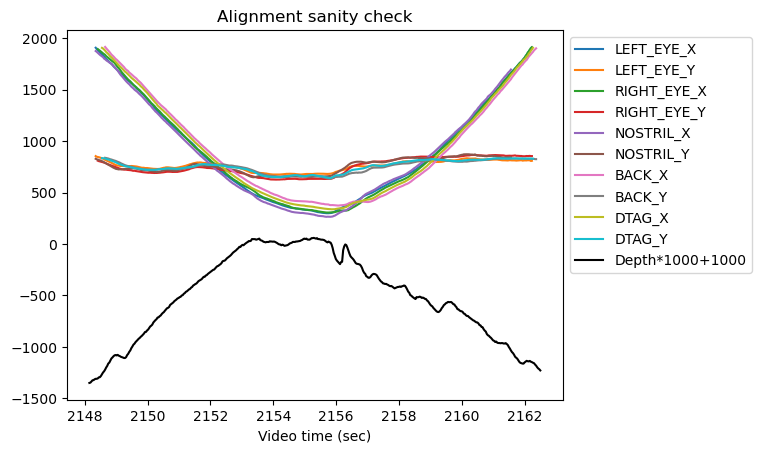

Save xypressure data to: 20190701_s2_t3_GP011479_xypressure.csv



---------------------------------------------------------
20190703_s2_t6, video: GOPR1485.MP4 + GP011485.MP4


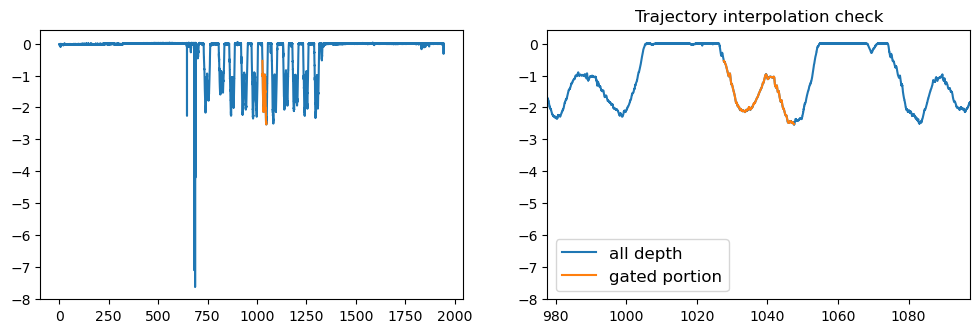

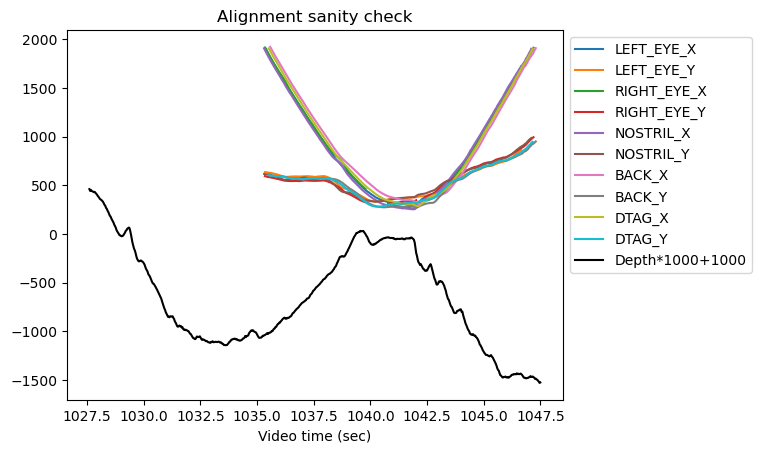

Save xypressure data to: 20190703_s2_t6_GOPR1485_xypressure.csv



---------------------------------------------------------
20190704_s3_t12, video: GOPR1489.MP4 + GP011489.MP4


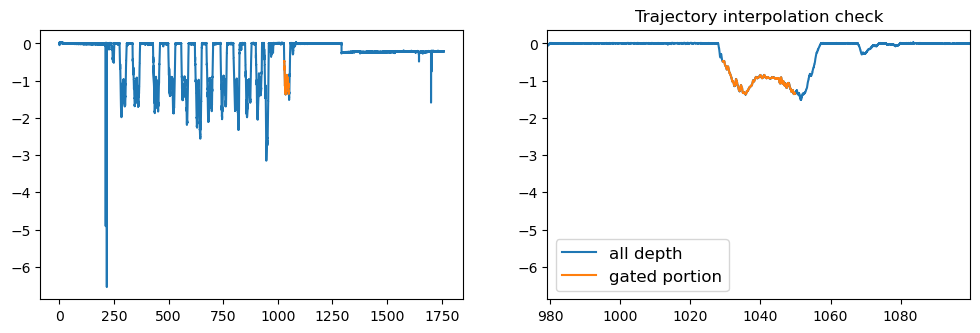

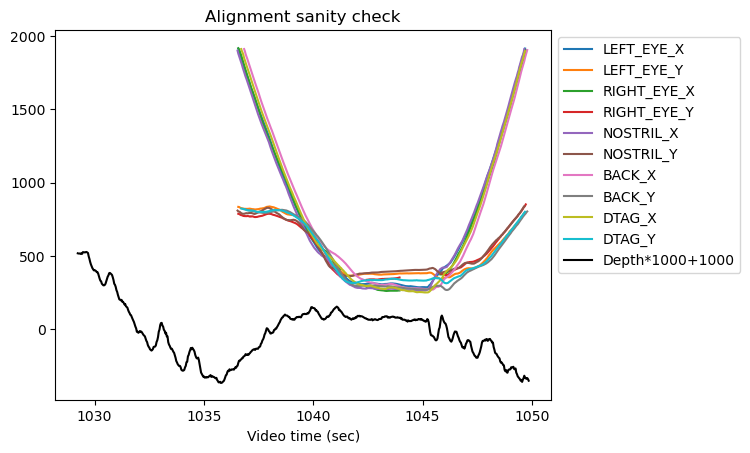

Save xypressure data to: 20190704_s3_t12_GOPR1489_xypressure.csv


In [27]:
xyzpressure_from_2videos = []

for trial_idx in df_all.index:
    
    s = df_all.loc[trial_idx, :]
    fname_prefix = '%d_s%d_t%d' % (s['DATE'], s['SESSION'], s['TRIAL'])
    fname = '%s_%s_xypressure.csv' % (fname_prefix, s['VIDEO_FILENAME'][:8])
    
    if not s['need_to_combined_videos']:
        xyzpressure_from_2videos.append(False)
#         print('Not included in wanted track with 2 videos, skipping this trial...')
        continue
        
    else:
        xyzpressure_from_2videos.append(True)
        
        # 20190702_s2 does not have syncing info
        if np.isnan(s['tap_sync_time_dtag2video']):
#             print('Dtag tap sync does not exist, skipping this trial...')
            continue

        else:
            print('')
            print('')
            print('')
            print('---------------------------------------------------------')
            print('%s, video: %s' % (fname_prefix, s['VIDEO_FILENAME']))

            dtag2vid_sync_time = s['tap_sync_time_dtag2video']

            track_fname1 = '%s_%s_xypts.csv' % (fname_prefix, s['VIDEO_FILENAME'][:8])
            track_fname2 = '%s_%s_xypts.csv' % (fname_prefix, s['VIDEO_FILENAME'][-12:-4])

            # Load trajectory
            track = pd.concat([pd.read_csv(track_path.joinpath(track_fname1)),
                               pd.read_csv(track_path.joinpath(track_fname2))]).reset_index(drop=True)

            f_start = s['FRAME_NUM_START']
            offset = 31830 * 2 if f_start > 31830 else 31830
            f_end = s['FRAME_NUM_END'] + offset

            # Load pressure
            dtag_nc_fname = Path(s['dtag_wav_file']).stem + 'sens50.nc'
            nc = xr.open_dataset(nc_path.joinpath(dtag_nc_fname))
            fs_dtag = nc.P.attrs['sampling_rate']

            # Interpolate dtag time to video time
            vid_time = np.arange(f_start, f_end) / fs_video - dtag2vid_sync_time   # [sec]
            dtag_time = np.arange(len(nc.P)) / fs_dtag
            depth = -np.interp(vid_time, dtag_time, nc.P)

            # Check pressure interp
            fig_track_interp,ax = plt.subplots(1,2,figsize=(12,3.5))
            ax[0].plot(dtag_time, -nc.P)
            ax[0].plot(vid_time, depth)
            ax[1].plot(dtag_time, -nc.P, label='all depth')
            ax[1].plot(vid_time, depth, label='gated portion')
            ax[1].set_xlim(vid_time[0]-50, vid_time[-1]+50)
            plt.legend(fontsize=12)
            plt.title('Trajectory interpolation check')
            plt.show()
            fig_track_interp.savefig(str(out_path.joinpath('fig_track_interp', 
                                                           Path(fname).stem+'_track_interp.png')), 
                                     dpi=150, bbox_inches='tight', pad_inches=0.3)

            # Get part of track corresponding to trial
            f_start_adjust = f_start - 31830 if f_start > 31830 else f_start
            f_end_adjust = f_end - 31830 if f_start > 31830 else f_end
            track_split = track[f_start_adjust:f_end_adjust].values

            # Construct df
            df_p = pd.DataFrame(depth, columns=['DTAG_PRESSURE'])
            df_t = pd.DataFrame(track_split, columns=col_list)    
            df = pd.concat([df_t, df_p], axis=1)

            # Sanity check
            assert len(track_split) > 0
            assert len(track_split) == len(depth)

            # Check alignment
            fig_alignment = plot_alignment_check()
            fig_alignment.savefig(str(out_path.joinpath('fig_alignment', Path(fname).stem+'_alignment.png')), 
                                  dpi=150, bbox_inches='tight', pad_inches=0.3)

            # Save file
            print('Save xypressure data to: ' + fname)
            df.to_csv(out_path.joinpath('csv', fname), index=False)

In [28]:
Path(fname).stem

'20190704_s3_t12_GOPR1489_xypressure'

In [29]:
# Sanity check for dimension
len(xyzpressure_from_2videos)

247

## Append column to main dataframe

In [30]:
df_main = pd.read_csv(main_csv_path, index_col=0)

In [31]:
df_all.columns

Index(['DATE', 'SESSION', 'TRIAL', 'VIDEO_FILENAME', 'WJ_COMMENTS',
       'gopro_video', 'tap_sync_time_dtag2video', 'FRAME_NUM_START',
       'FRAME_NUM_END', 'dtag_wav_file', 'DLC_labeled_h5',
       'KAVIN_TRACK_COMMENTS', 'TRACK_CHECKED', 'TARGETS_CHECKED',
       'track_csv_fname', 'need_to_combined_videos', 'track_file_exist',
       'track_file_checked', 'file_wanted_1video'],
      dtype='object')

In [32]:
df_main.columns

Index(['DATE', 'SESSION', 'PERSONNEL', 'TRIAL', 'LEFT', 'RIGHT', 'ANGLE',
       'SPHEROID', 'ASPECT_RATIO', 'SEQUENCE', 'CHOICE', 'WJ_COMMENTS',
       'VIDEO_REVIEW_COMMENTS', 'VIDEO_TIME', 'VIDEO_NUM', 'OTHER_COMMENTS',
       'DARSHAN_COMMENTS', 'VIDEO_FILENAME', 'FRAME_NUM_START',
       'FRAME_NUM_END', 'KAVIN_TRACK_COMMENTS', 'TRACK_CHECKED',
       'TARGETS_CHECKED', 'LED_flash', 'TOUCH_FRAME', 'TRIAL_TO_INCLUDE',
       'TRACK_ISSUES', 'LATE_TURN', 'EYECUP_ISSUE', 'TRACK_USED',
       'hydro_filename', 'hydro_recording_time', 'hydro_time_diff',
       'rough_chirp_time', 'dtag_trial_start_time', 'dtag_trial_end_time',
       'see_chirp_in_dtag', 'dtag_trial_comments', 'dtag_wav_file',
       'DLC_video_trial_label', 'gopro_video', 'DLC_labeled_h5',
       'tap_sync_video_num', 'tap_sync_dtag_start_time',
       'tap_sync_dtag_end_time', 'tap_sync_video_frame', 'tap_sync_comments',
       'tap_sync_time_dtag2video', 'target_marker_exist',
       'target_marker_checked', 'target

In [33]:
col_copy = ['track_csv_fname', 
            'track_file_exist', 
            'track_file_checked', 
            'need_to_combined_videos', 
            'file_wanted_1video']

In [34]:
df_main[col_copy] = df_all[col_copy]
df_main = df_main.rename(columns={'need_to_combined_videos': 'xypressure_need_two_videos', 
                                      'file_wanted_1video': 'xypressure_need_one_video'})

In [35]:
df_main['xypressure_csv_assembled'] = (df_main['xypressure_need_one_video'] 
                                         | df_main['xypressure_need_two_videos'])

In [36]:
df_main['dtag_tap_sync_exist'] = df_main['tap_sync_time_dtag2video'].apply(lambda x: not np.isnan(x))

In [37]:
# Sanity check
df_main.loc[df_main['dtag_tap_sync_exist']==False, 'tap_sync_time_dtag2video']

162   NaN
163   NaN
164   NaN
165   NaN
166   NaN
167   NaN
168   NaN
169   NaN
170   NaN
171   NaN
172   NaN
Name: tap_sync_time_dtag2video, dtype: float64

In [38]:
df_main

,DATE,SESSION,PERSONNEL,TRIAL,LEFT,RIGHT,ANGLE,SPHEROID,ASPECT_RATIO,SEQUENCE,...,targets_entry_exist,extrinsic_file_exist,cal_obj_record_exist,track_csv_fname,track_file_exist,track_file_checked,xypressure_need_two_videos,xypressure_need_one_video,xypressure_csv_assembled,dtag_tap_sync_exist
0,20190625,1,"WJ, ML",0,T,X,1,X,0.0,1,...,False,NaN,NaN,20190625_s1_t0_GOPR1466_xypts.csv,False,False,False,False,False,True
1,20190625,1,"WJ, ML",0,T,X,1,X,0.0,1,...,False,NaN,NaN,20190625_s1_t0_GOPR1466_xypts.csv,False,True,False,False,False,True
2,20190625,1,"WJ, ML",1,T,C,1,L,2.9,1,...,True,True,True,20190625_s1_t1_GOPR1466_xypts.csv,True,True,False,True,True,True
3,20190625,1,"WJ, ML",2,C,T,1,L,2.9,1,...,True,True,True,20190625_s1_t2_GOPR1466_xypts.csv,True,True,False,True,True,True
4,20190625,1,"WJ, ML",3,T,C,1,L,2.9,1,...,True,True,True,20190625_s1_t3_GOPR1466_xypts.csv,True,True,False,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242,20190704,3,ML,8,T,C,1,M,1.3,24,...,True,True,True,20190704_s3_t8_GOPR1489_xypts.csv,True,True,False,True,True,True
243,20190704,3,ML,9,C,T,3,M,1.3,24,...,True,True,True,20190704_s3_t9_GOPR1489_xypts.csv,True,True,False,True,True,True
244,20190704,3,ML,10,T,C,3,M,1.3,24,...,True,True,True,20190704_s3_t10_GOPR1489_xypts.csv,True,True,False,True,True,True
245,20190704,3,ML,11,T,C,3,M,1.3,24,...,True,True,True,20190704_s3_t11_GOPR1489_xypts.csv,True,True,False,True,True,True


In [39]:
df_main.to_csv(analysis_path.joinpath('all_info_csv/main_info_append_04.csv'))